In [1]:
import tensorflow as tf
physical_devices = tf.config.experimental.list_physical_devices('GPU')
assert len(physical_devices) > 0, "Not enough GPU hardware devices available"
#import tensorflow as tf
#tf.config.experimental.set_memory_growth(tf.config.list_physical_devices('GPU')[0], True)

In [2]:
import tensorflow as tf
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)

2 Physical GPUs, 2 Logical GPUs


In [3]:
import tensorflow as tf
tf.debugging.set_log_device_placement(True)

#import tensorflow as tf
#devices= tf.config.experimental.list_physical_devices('GPU')
#tf.config.experimental.set_memory_growth(devices[0], True)

In [4]:
tf.debugging.set_log_device_placement(True)

# 텐서 생성
a = tf.constant([[1.0, 2.0, 3.0], [4.0, 5.0, 6.0]])
b = tf.constant([[1.0, 2.0], [3.0, 4.0], [5.0, 6.0]])
c = tf.matmul(a, b)

print(c)

tf.Tensor(
[[22. 28.]
 [49. 64.]], shape=(2, 2), dtype=float32)


In [5]:
from tensorflow.python.client import device_lib
device_lib.list_local_devices()

[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 14296655008016780249,
 name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 23394648064
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 626469535640732388
 physical_device_desc: "device: 0, name: GeForce RTX 3090, pci bus id: 0000:17:00.0, compute capability: 8.6",
 name: "/device:GPU:1"
 device_type: "GPU"
 memory_limit: 23385997312
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 6703730637446023812
 physical_device_desc: "device: 1, name: GeForce RTX 3090, pci bus id: 0000:65:00.0, compute capability: 8.6"]

In [6]:
tf.__version__

'2.5.0'

In [7]:
import matplotlib.pylab as plt
#!pip install netCDF4
#!pip install -U matplotlib==3.2
#!pip uninstall -y numpy
#!pip install numpy
#!pip install pyproj==1.9.6
#!apt-get install libgeos-3.5.0
#!apt-get install libgeos-dev
#!pip install https://github.com/matplotlib/basemap/archive/master.zip
#!pip install sdv
from netCDF4 import Dataset, num2date
import pandas as pd
#from matplotlib.cbook import dedent
#from mpl_toolkits.basemap import Basemap
import numpy as np
%matplotlib inline
import xarray
import netCDF4 as nc
#conda install xarray or pip install xarray

In [8]:
import xarray as xr
sst_dataset=xr.open_dataset('sst_east_sea_month_198311.nc')

sst_merge_month_198201.nc
sst_east_sea_month_198201.nc
sst_merge_month_198202.nc
sst_east_sea_month_198202.nc
sst_merge_month_198203.nc
sst_east_sea_month_198203.nc
sst_merge_month_198204.nc
sst_east_sea_month_198204.nc
sst_merge_month_198205.nc
sst_east_sea_month_198205.nc
sst_merge_month_198206.nc
sst_east_sea_month_198206.nc
sst_merge_month_198207.nc
sst_east_sea_month_198207.nc
sst_merge_month_198208.nc
sst_east_sea_month_198208.nc
sst_merge_month_198209.nc
sst_east_sea_month_198209.nc
sst_merge_month_198210.nc
sst_east_sea_month_198210.nc
sst_merge_month_198211.nc
sst_east_sea_month_198211.nc
sst_merge_month_198212.nc
sst_east_sea_month_198212.nc
sst_merge_month_198301.nc
sst_east_sea_month_198301.nc
sst_merge_month_198302.nc
sst_east_sea_month_198302.nc
sst_merge_month_198303.nc
sst_east_sea_month_198303.nc
sst_merge_month_198304.nc
sst_east_sea_month_198304.nc
sst_merge_month_198305.nc
sst_east_sea_month_198305.nc
sst_merge_month_198306.nc
sst_east_sea_month_198306.nc
sst_merge_

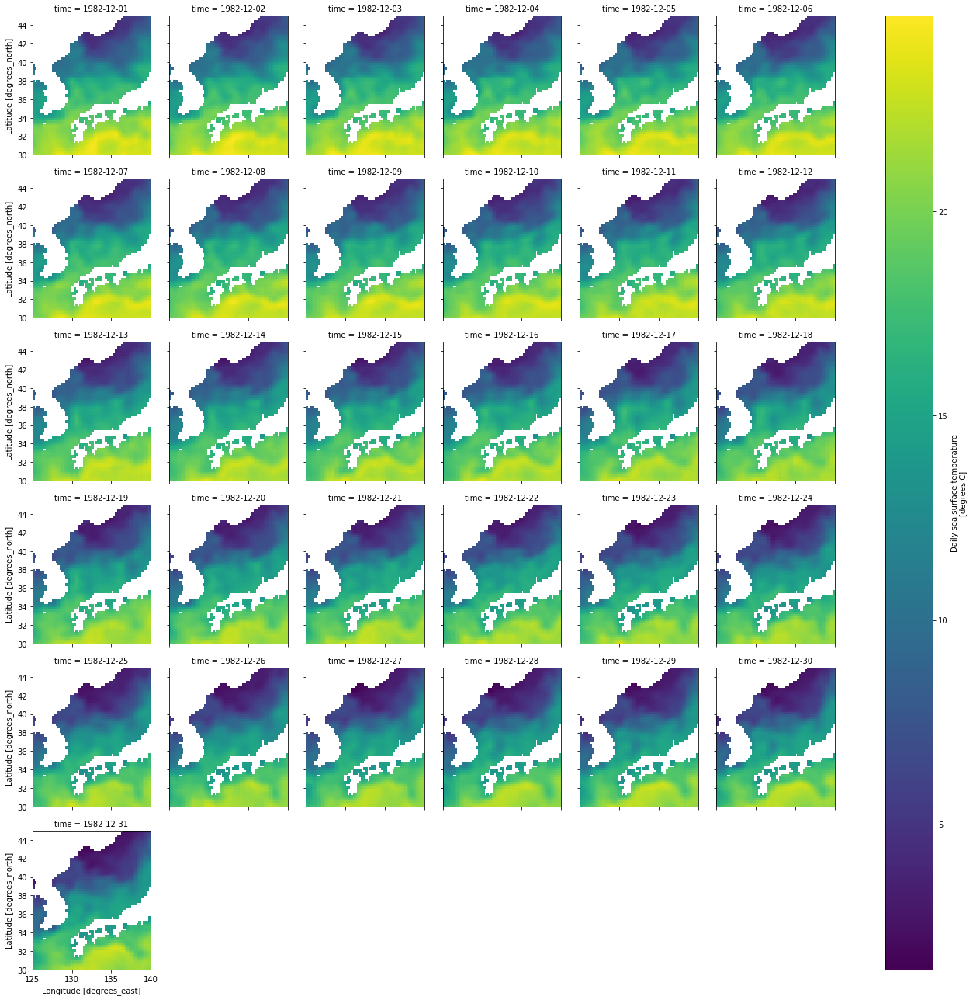

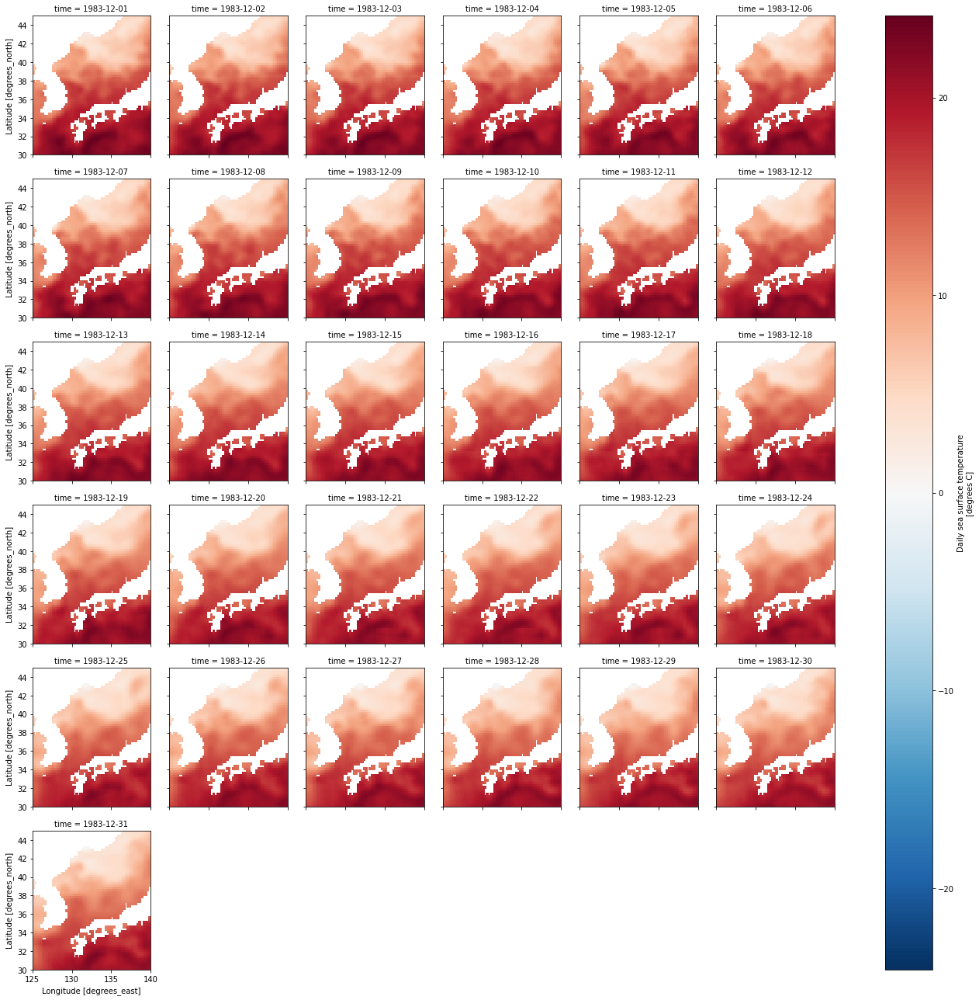

In [9]:
#dataset_sst_lp=sst_dataset.sst.sel(lon=114.125,lat=14.125, method='nearest',time='1993-03-01')
#dataset_sst_lp
#dataset_sst_lp.plot()

import datetime
from pandas import DataFrame
import matplotlib.pyplot as plt
import netCDF4 as nc
import xarray as xr
import numpy as np
month=['01','02','03','04','05','06','07','08','09','10','11','12']
for year in range (1982,1984):
        for mo in month:
            sst_nc_file ='sst_merge_month_'+str(year)+mo+'.nc'
            print(sst_nc_file)
            sst_dataset=xr.open_dataset(sst_nc_file)
            #sst_dataset
            dataset_sst=sst_dataset.sst
            dataset_sst_lp = sst_dataset.sst.sel(lon=slice(125, 140), lat=slice(30, 45))
            output_file='sst_east_sea_month_'+str(year)+mo+'.nc'
            print(output_file)
            dataset_sst_lp.to_netcdf(output_file)
            #dataset_sst_lp.plot()
        dataset_sst_lp.plot(col="time",col_wrap=6)

In [10]:
df_sst=dataset_sst_lp.to_dataframe()
np_sst=df_sst.to_numpy()
print(np_sst.shape)
print(np_sst)
#sst_numpy_array = np.stack([data_array.values for data_array in df_sst['sst'].values])

(111600, 1)
[[19.109999]
 [19.43    ]
 [19.859999]
 ...
 [ 4.97    ]
 [ 5.41    ]
 [ 5.69    ]]


In [11]:
type(dataset_sst_lp)

xarray.core.dataarray.DataArray

In [12]:
dataset_sst_lp

<xarray.DataArray 'sst' (time: 31, zlev: 1, lat: 60, lon: 60)>
[111600 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 1983-12-01 1983-12-02 ... 1983-12-31
  * zlev     (zlev) float32 0.0
  * lat      (lat) float32 30.12 30.38 30.62 30.88 ... 44.12 44.38 44.62 44.88
  * lon      (lon) float32 125.1 125.4 125.6 125.9 ... 139.1 139.4 139.6 139.9
Attributes:
    long_name:  Daily sea surface temperature
    units:      degrees C
    valid_min:  -300
    valid_max:  4500

In [13]:
df_sst

sst
time       zlev lat    lon               
1983-12-01 0.0  30.125 125.125  19.109999
                       125.375  19.430000
                       125.625  19.859999
                       125.875  20.219999
                       126.125  20.359999
...                                   ...
1983-12-31 0.0  44.875 138.875   4.120000
                       139.125   4.430000
                       139.375   4.970000
                       139.625   5.410000
                       139.875   5.690000

[111600 rows x 1 columns]

In [14]:
import pandas as pd
df_sst.to_csv('sst.csv')
df_sst=pd.read_csv('sst.csv')
df_sst[['lat','lon']]

,lat,lon
0,30.125,125.125
1,30.125,125.375
2,30.125,125.625
3,30.125,125.875
4,30.125,126.125
...,...,...
111595,44.875,138.875
111596,44.875,139.125
111597,44.875,139.375
111598,44.875,139.625


In [15]:
for x, y in zip (df_sst['lon'], df_sst['lat']):
  print(x,y)

125.125 30.125
125.375 30.125
125.625 30.125
125.875 30.125
126.125 30.125
126.375 30.125
126.625 30.125
126.875 30.125
127.125 30.125
127.375 30.125
127.625 30.125
127.875 30.125
128.125 30.125
128.375 30.125
128.625 30.125
128.875 30.125
129.125 30.125
129.375 30.125
129.625 30.125
129.875 30.125
130.125 30.125
130.375 30.125
130.625 30.125
130.875 30.125
131.125 30.125
131.375 30.125
131.625 30.125
131.875 30.125
132.125 30.125
132.375 30.125
132.625 30.125
132.875 30.125
133.125 30.125
133.375 30.125
133.625 30.125
133.875 30.125
134.125 30.125
134.375 30.125
134.625 30.125
134.875 30.125
135.125 30.125
135.375 30.125
135.625 30.125
135.875 30.125
136.125 30.125
136.375 30.125
136.625 30.125
136.875 30.125
137.125 30.125
137.375 30.125
137.625 30.125
137.875 30.125
138.125 30.125
138.375 30.125
138.625 30.125
138.875 30.125
139.125 30.125
139.375 30.125
139.625 30.125
139.875 30.125
125.125 30.375
125.375 30.375
125.625 30.375
125.875 30.375
126.125 30.375
126.375 30.375
126.625 30

138.375 37.875
138.625 37.875
138.875 37.875
139.125 37.875
139.375 37.875
139.625 37.875
139.875 37.875
125.125 38.125
125.375 38.125
125.625 38.125
125.875 38.125
126.125 38.125
126.375 38.125
126.625 38.125
126.875 38.125
127.125 38.125
127.375 38.125
127.625 38.125
127.875 38.125
128.125 38.125
128.375 38.125
128.625 38.125
128.875 38.125
129.125 38.125
129.375 38.125
129.625 38.125
129.875 38.125
130.125 38.125
130.375 38.125
130.625 38.125
130.875 38.125
131.125 38.125
131.375 38.125
131.625 38.125
131.875 38.125
132.125 38.125
132.375 38.125
132.625 38.125
132.875 38.125
133.125 38.125
133.375 38.125
133.625 38.125
133.875 38.125
134.125 38.125
134.375 38.125
134.625 38.125
134.875 38.125
135.125 38.125
135.375 38.125
135.625 38.125
135.875 38.125
136.125 38.125
136.375 38.125
136.625 38.125
136.875 38.125
137.125 38.125
137.375 38.125
137.625 38.125
137.875 38.125
138.125 38.125
138.375 38.125
138.625 38.125
138.875 38.125
139.125 38.125
139.375 38.125
139.625 38.125
139.875 38

133.125 31.375
133.375 31.375
133.625 31.375
133.875 31.375
134.125 31.375
134.375 31.375
134.625 31.375
134.875 31.375
135.125 31.375
135.375 31.375
135.625 31.375
135.875 31.375
136.125 31.375
136.375 31.375
136.625 31.375
136.875 31.375
137.125 31.375
137.375 31.375
137.625 31.375
137.875 31.375
138.125 31.375
138.375 31.375
138.625 31.375
138.875 31.375
139.125 31.375
139.375 31.375
139.625 31.375
139.875 31.375
125.125 31.625
125.375 31.625
125.625 31.625
125.875 31.625
126.125 31.625
126.375 31.625
126.625 31.625
126.875 31.625
127.125 31.625
127.375 31.625
127.625 31.625
127.875 31.625
128.125 31.625
128.375 31.625
128.625 31.625
128.875 31.625
129.125 31.625
129.375 31.625
129.625 31.625
129.875 31.625
130.125 31.625
130.375 31.625
130.625 31.625
130.875 31.625
131.125 31.625
131.375 31.625
131.625 31.625
131.875 31.625
132.125 31.625
132.375 31.625
132.625 31.625
132.875 31.625
133.125 31.625
133.375 31.625
133.625 31.625
133.875 31.625
134.125 31.625
134.375 31.625
134.625 31

135.875 39.875
136.125 39.875
136.375 39.875
136.625 39.875
136.875 39.875
137.125 39.875
137.375 39.875
137.625 39.875
137.875 39.875
138.125 39.875
138.375 39.875
138.625 39.875
138.875 39.875
139.125 39.875
139.375 39.875
139.625 39.875
139.875 39.875
125.125 40.125
125.375 40.125
125.625 40.125
125.875 40.125
126.125 40.125
126.375 40.125
126.625 40.125
126.875 40.125
127.125 40.125
127.375 40.125
127.625 40.125
127.875 40.125
128.125 40.125
128.375 40.125
128.625 40.125
128.875 40.125
129.125 40.125
129.375 40.125
129.625 40.125
129.875 40.125
130.125 40.125
130.375 40.125
130.625 40.125
130.875 40.125
131.125 40.125
131.375 40.125
131.625 40.125
131.875 40.125
132.125 40.125
132.375 40.125
132.625 40.125
132.875 40.125
133.125 40.125
133.375 40.125
133.625 40.125
133.875 40.125
134.125 40.125
134.375 40.125
134.625 40.125
134.875 40.125
135.125 40.125
135.375 40.125
135.625 40.125
135.875 40.125
136.125 40.125
136.375 40.125
136.625 40.125
136.875 40.125
137.125 40.125
137.375 40

125.625 42.875
125.875 42.875
126.125 42.875
126.375 42.875
126.625 42.875
126.875 42.875
127.125 42.875
127.375 42.875
127.625 42.875
127.875 42.875
128.125 42.875
128.375 42.875
128.625 42.875
128.875 42.875
129.125 42.875
129.375 42.875
129.625 42.875
129.875 42.875
130.125 42.875
130.375 42.875
130.625 42.875
130.875 42.875
131.125 42.875
131.375 42.875
131.625 42.875
131.875 42.875
132.125 42.875
132.375 42.875
132.625 42.875
132.875 42.875
133.125 42.875
133.375 42.875
133.625 42.875
133.875 42.875
134.125 42.875
134.375 42.875
134.625 42.875
134.875 42.875
135.125 42.875
135.375 42.875
135.625 42.875
135.875 42.875
136.125 42.875
136.375 42.875
136.625 42.875
136.875 42.875
137.125 42.875
137.375 42.875
137.625 42.875
137.875 42.875
138.125 42.875
138.375 42.875
138.625 42.875
138.875 42.875
139.125 42.875
139.375 42.875
139.625 42.875
139.875 42.875
125.125 43.125
125.375 43.125
125.625 43.125
125.875 43.125
126.125 43.125
126.375 43.125
126.625 43.125
126.875 43.125
127.125 43

134.125 36.125
134.375 36.125
134.625 36.125
134.875 36.125
135.125 36.125
135.375 36.125
135.625 36.125
135.875 36.125
136.125 36.125
136.375 36.125
136.625 36.125
136.875 36.125
137.125 36.125
137.375 36.125
137.625 36.125
137.875 36.125
138.125 36.125
138.375 36.125
138.625 36.125
138.875 36.125
139.125 36.125
139.375 36.125
139.625 36.125
139.875 36.125
125.125 36.375
125.375 36.375
125.625 36.375
125.875 36.375
126.125 36.375
126.375 36.375
126.625 36.375
126.875 36.375
127.125 36.375
127.375 36.375
127.625 36.375
127.875 36.375
128.125 36.375
128.375 36.375
128.625 36.375
128.875 36.375
129.125 36.375
129.375 36.375
129.625 36.375
129.875 36.375
130.125 36.375
130.375 36.375
130.625 36.375
130.875 36.375
131.125 36.375
131.375 36.375
131.625 36.375
131.875 36.375
132.125 36.375
132.375 36.375
132.625 36.375
132.875 36.375
133.125 36.375
133.375 36.375
133.625 36.375
133.875 36.375
134.125 36.375
134.375 36.375
134.625 36.375
134.875 36.375
135.125 36.375
135.375 36.375
135.625 36

128.125 32.625
128.375 32.625
128.625 32.625
128.875 32.625
129.125 32.625
129.375 32.625
129.625 32.625
129.875 32.625
130.125 32.625
130.375 32.625
130.625 32.625
130.875 32.625
131.125 32.625
131.375 32.625
131.625 32.625
131.875 32.625
132.125 32.625
132.375 32.625
132.625 32.625
132.875 32.625
133.125 32.625
133.375 32.625
133.625 32.625
133.875 32.625
134.125 32.625
134.375 32.625
134.625 32.625
134.875 32.625
135.125 32.625
135.375 32.625
135.625 32.625
135.875 32.625
136.125 32.625
136.375 32.625
136.625 32.625
136.875 32.625
137.125 32.625
137.375 32.625
137.625 32.625
137.875 32.625
138.125 32.625
138.375 32.625
138.625 32.625
138.875 32.625
139.125 32.625
139.375 32.625
139.625 32.625
139.875 32.625
125.125 32.875
125.375 32.875
125.625 32.875
125.875 32.875
126.125 32.875
126.375 32.875
126.625 32.875
126.875 32.875
127.125 32.875
127.375 32.875
127.625 32.875
127.875 32.875
128.125 32.875
128.375 32.875
128.625 32.875
128.875 32.875
129.125 32.875
129.375 32.875
129.625 32

135.875 41.375
136.125 41.375
136.375 41.375
136.625 41.375
136.875 41.375
137.125 41.375
137.375 41.375
137.625 41.375
137.875 41.375
138.125 41.375
138.375 41.375
138.625 41.375
138.875 41.375
139.125 41.375
139.375 41.375
139.625 41.375
139.875 41.375
125.125 41.625
125.375 41.625
125.625 41.625
125.875 41.625
126.125 41.625
126.375 41.625
126.625 41.625
126.875 41.625
127.125 41.625
127.375 41.625
127.625 41.625
127.875 41.625
128.125 41.625
128.375 41.625
128.625 41.625
128.875 41.625
129.125 41.625
129.375 41.625
129.625 41.625
129.875 41.625
130.125 41.625
130.375 41.625
130.625 41.625
130.875 41.625
131.125 41.625
131.375 41.625
131.625 41.625
131.875 41.625
132.125 41.625
132.375 41.625
132.625 41.625
132.875 41.625
133.125 41.625
133.375 41.625
133.625 41.625
133.875 41.625
134.125 41.625
134.375 41.625
134.625 41.625
134.875 41.625
135.125 41.625
135.375 41.625
135.625 41.625
135.875 41.625
136.125 41.625
136.375 41.625
136.625 41.625
136.875 41.625
137.125 41.625
137.375 41

127.875 36.375
128.125 36.375
128.375 36.375
128.625 36.375
128.875 36.375
129.125 36.375
129.375 36.375
129.625 36.375
129.875 36.375
130.125 36.375
130.375 36.375
130.625 36.375
130.875 36.375
131.125 36.375
131.375 36.375
131.625 36.375
131.875 36.375
132.125 36.375
132.375 36.375
132.625 36.375
132.875 36.375
133.125 36.375
133.375 36.375
133.625 36.375
133.875 36.375
134.125 36.375
134.375 36.375
134.625 36.375
134.875 36.375
135.125 36.375
135.375 36.375
135.625 36.375
135.875 36.375
136.125 36.375
136.375 36.375
136.625 36.375
136.875 36.375
137.125 36.375
137.375 36.375
137.625 36.375
137.875 36.375
138.125 36.375
138.375 36.375
138.625 36.375
138.875 36.375
139.125 36.375
139.375 36.375
139.625 36.375
139.875 36.375
125.125 36.625
125.375 36.625
125.625 36.625
125.875 36.625
126.125 36.625
126.375 36.625
126.625 36.625
126.875 36.625
127.125 36.625
127.375 36.625
127.625 36.625
127.875 36.625
128.125 36.625
128.375 36.625
128.625 36.625
128.875 36.625
129.125 36.625
129.375 36

137.875 44.125
138.125 44.125
138.375 44.125
138.625 44.125
138.875 44.125
139.125 44.125
139.375 44.125
139.625 44.125
139.875 44.125
125.125 44.375
125.375 44.375
125.625 44.375
125.875 44.375
126.125 44.375
126.375 44.375
126.625 44.375
126.875 44.375
127.125 44.375
127.375 44.375
127.625 44.375
127.875 44.375
128.125 44.375
128.375 44.375
128.625 44.375
128.875 44.375
129.125 44.375
129.375 44.375
129.625 44.375
129.875 44.375
130.125 44.375
130.375 44.375
130.625 44.375
130.875 44.375
131.125 44.375
131.375 44.375
131.625 44.375
131.875 44.375
132.125 44.375
132.375 44.375
132.625 44.375
132.875 44.375
133.125 44.375
133.375 44.375
133.625 44.375
133.875 44.375
134.125 44.375
134.375 44.375
134.625 44.375
134.875 44.375
135.125 44.375
135.375 44.375
135.625 44.375
135.875 44.375
136.125 44.375
136.375 44.375
136.625 44.375
136.875 44.375
137.125 44.375
137.375 44.375
137.625 44.375
137.875 44.375
138.125 44.375
138.375 44.375
138.625 44.375
138.875 44.375
139.125 44.375
139.375 44

134.625 39.125
134.875 39.125
135.125 39.125
135.375 39.125
135.625 39.125
135.875 39.125
136.125 39.125
136.375 39.125
136.625 39.125
136.875 39.125
137.125 39.125
137.375 39.125
137.625 39.125
137.875 39.125
138.125 39.125
138.375 39.125
138.625 39.125
138.875 39.125
139.125 39.125
139.375 39.125
139.625 39.125
139.875 39.125
125.125 39.375
125.375 39.375
125.625 39.375
125.875 39.375
126.125 39.375
126.375 39.375
126.625 39.375
126.875 39.375
127.125 39.375
127.375 39.375
127.625 39.375
127.875 39.375
128.125 39.375
128.375 39.375
128.625 39.375
128.875 39.375
129.125 39.375
129.375 39.375
129.625 39.375
129.875 39.375
130.125 39.375
130.375 39.375
130.625 39.375
130.875 39.375
131.125 39.375
131.375 39.375
131.625 39.375
131.875 39.375
132.125 39.375
132.375 39.375
132.625 39.375
132.875 39.375
133.125 39.375
133.375 39.375
133.625 39.375
133.875 39.375
134.125 39.375
134.375 39.375
134.625 39.375
134.875 39.375
135.125 39.375
135.375 39.375
135.625 39.375
135.875 39.375
136.125 39

132.875 33.375
133.125 33.375
133.375 33.375
133.625 33.375
133.875 33.375
134.125 33.375
134.375 33.375
134.625 33.375
134.875 33.375
135.125 33.375
135.375 33.375
135.625 33.375
135.875 33.375
136.125 33.375
136.375 33.375
136.625 33.375
136.875 33.375
137.125 33.375
137.375 33.375
137.625 33.375
137.875 33.375
138.125 33.375
138.375 33.375
138.625 33.375
138.875 33.375
139.125 33.375
139.375 33.375
139.625 33.375
139.875 33.375
125.125 33.625
125.375 33.625
125.625 33.625
125.875 33.625
126.125 33.625
126.375 33.625
126.625 33.625
126.875 33.625
127.125 33.625
127.375 33.625
127.625 33.625
127.875 33.625
128.125 33.625
128.375 33.625
128.625 33.625
128.875 33.625
129.125 33.625
129.375 33.625
129.625 33.625
129.875 33.625
130.125 33.625
130.375 33.625
130.625 33.625
130.875 33.625
131.125 33.625
131.375 33.625
131.625 33.625
131.875 33.625
132.125 33.625
132.375 33.625
132.625 33.625
132.875 33.625
133.125 33.625
133.375 33.625
133.625 33.625
133.875 33.625
134.125 33.625
134.375 33

135.625 40.375
135.875 40.375
136.125 40.375
136.375 40.375
136.625 40.375
136.875 40.375
137.125 40.375
137.375 40.375
137.625 40.375
137.875 40.375
138.125 40.375
138.375 40.375
138.625 40.375
138.875 40.375
139.125 40.375
139.375 40.375
139.625 40.375
139.875 40.375
125.125 40.625
125.375 40.625
125.625 40.625
125.875 40.625
126.125 40.625
126.375 40.625
126.625 40.625
126.875 40.625
127.125 40.625
127.375 40.625
127.625 40.625
127.875 40.625
128.125 40.625
128.375 40.625
128.625 40.625
128.875 40.625
129.125 40.625
129.375 40.625
129.625 40.625
129.875 40.625
130.125 40.625
130.375 40.625
130.625 40.625
130.875 40.625
131.125 40.625
131.375 40.625
131.625 40.625
131.875 40.625
132.125 40.625
132.375 40.625
132.625 40.625
132.875 40.625
133.125 40.625
133.375 40.625
133.625 40.625
133.875 40.625
134.125 40.625
134.375 40.625
134.625 40.625
134.875 40.625
135.125 40.625
135.375 40.625
135.625 40.625
135.875 40.625
136.125 40.625
136.375 40.625
136.625 40.625
136.875 40.625
137.125 40

139.625 34.375
139.875 34.375
125.125 34.625
125.375 34.625
125.625 34.625
125.875 34.625
126.125 34.625
126.375 34.625
126.625 34.625
126.875 34.625
127.125 34.625
127.375 34.625
127.625 34.625
127.875 34.625
128.125 34.625
128.375 34.625
128.625 34.625
128.875 34.625
129.125 34.625
129.375 34.625
129.625 34.625
129.875 34.625
130.125 34.625
130.375 34.625
130.625 34.625
130.875 34.625
131.125 34.625
131.375 34.625
131.625 34.625
131.875 34.625
132.125 34.625
132.375 34.625
132.625 34.625
132.875 34.625
133.125 34.625
133.375 34.625
133.625 34.625
133.875 34.625
134.125 34.625
134.375 34.625
134.625 34.625
134.875 34.625
135.125 34.625
135.375 34.625
135.625 34.625
135.875 34.625
136.125 34.625
136.375 34.625
136.625 34.625
136.875 34.625
137.125 34.625
137.375 34.625
137.625 34.625
137.875 34.625
138.125 34.625
138.375 34.625
138.625 34.625
138.875 34.625
139.125 34.625
139.375 34.625
139.625 34.625
139.875 34.625
125.125 34.875
125.375 34.875
125.625 34.875
125.875 34.875
126.125 34

125.125 31.625
125.375 31.625
125.625 31.625
125.875 31.625
126.125 31.625
126.375 31.625
126.625 31.625
126.875 31.625
127.125 31.625
127.375 31.625
127.625 31.625
127.875 31.625
128.125 31.625
128.375 31.625
128.625 31.625
128.875 31.625
129.125 31.625
129.375 31.625
129.625 31.625
129.875 31.625
130.125 31.625
130.375 31.625
130.625 31.625
130.875 31.625
131.125 31.625
131.375 31.625
131.625 31.625
131.875 31.625
132.125 31.625
132.375 31.625
132.625 31.625
132.875 31.625
133.125 31.625
133.375 31.625
133.625 31.625
133.875 31.625
134.125 31.625
134.375 31.625
134.625 31.625
134.875 31.625
135.125 31.625
135.375 31.625
135.625 31.625
135.875 31.625
136.125 31.625
136.375 31.625
136.625 31.625
136.875 31.625
137.125 31.625
137.375 31.625
137.625 31.625
137.875 31.625
138.125 31.625
138.375 31.625
138.625 31.625
138.875 31.625
139.125 31.625
139.375 31.625
139.625 31.625
139.875 31.625
125.125 31.875
125.375 31.875
125.625 31.875
125.875 31.875
126.125 31.875
126.375 31.875
126.625 31

127.375 36.375
127.625 36.375
127.875 36.375
128.125 36.375
128.375 36.375
128.625 36.375
128.875 36.375
129.125 36.375
129.375 36.375
129.625 36.375
129.875 36.375
130.125 36.375
130.375 36.375
130.625 36.375
130.875 36.375
131.125 36.375
131.375 36.375
131.625 36.375
131.875 36.375
132.125 36.375
132.375 36.375
132.625 36.375
132.875 36.375
133.125 36.375
133.375 36.375
133.625 36.375
133.875 36.375
134.125 36.375
134.375 36.375
134.625 36.375
134.875 36.375
135.125 36.375
135.375 36.375
135.625 36.375
135.875 36.375
136.125 36.375
136.375 36.375
136.625 36.375
136.875 36.375
137.125 36.375
137.375 36.375
137.625 36.375
137.875 36.375
138.125 36.375
138.375 36.375
138.625 36.375
138.875 36.375
139.125 36.375
139.375 36.375
139.625 36.375
139.875 36.375
125.125 36.625
125.375 36.625
125.625 36.625
125.875 36.625
126.125 36.625
126.375 36.625
126.625 36.625
126.875 36.625
127.125 36.625
127.375 36.625
127.625 36.625
127.875 36.625
128.125 36.625
128.375 36.625
128.625 36.625
128.875 36

132.375 32.125
132.625 32.125
132.875 32.125
133.125 32.125
133.375 32.125
133.625 32.125
133.875 32.125
134.125 32.125
134.375 32.125
134.625 32.125
134.875 32.125
135.125 32.125
135.375 32.125
135.625 32.125
135.875 32.125
136.125 32.125
136.375 32.125
136.625 32.125
136.875 32.125
137.125 32.125
137.375 32.125
137.625 32.125
137.875 32.125
138.125 32.125
138.375 32.125
138.625 32.125
138.875 32.125
139.125 32.125
139.375 32.125
139.625 32.125
139.875 32.125
125.125 32.375
125.375 32.375
125.625 32.375
125.875 32.375
126.125 32.375
126.375 32.375
126.625 32.375
126.875 32.375
127.125 32.375
127.375 32.375
127.625 32.375
127.875 32.375
128.125 32.375
128.375 32.375
128.625 32.375
128.875 32.375
129.125 32.375
129.375 32.375
129.625 32.375
129.875 32.375
130.125 32.375
130.375 32.375
130.625 32.375
130.875 32.375
131.125 32.375
131.375 32.375
131.625 32.375
131.875 32.375
132.125 32.375
132.375 32.375
132.625 32.375
132.875 32.375
133.125 32.375
133.375 32.375
133.625 32.375
133.875 32

139.875 41.375
125.125 41.625
125.375 41.625
125.625 41.625
125.875 41.625
126.125 41.625
126.375 41.625
126.625 41.625
126.875 41.625
127.125 41.625
127.375 41.625
127.625 41.625
127.875 41.625
128.125 41.625
128.375 41.625
128.625 41.625
128.875 41.625
129.125 41.625
129.375 41.625
129.625 41.625
129.875 41.625
130.125 41.625
130.375 41.625
130.625 41.625
130.875 41.625
131.125 41.625
131.375 41.625
131.625 41.625
131.875 41.625
132.125 41.625
132.375 41.625
132.625 41.625
132.875 41.625
133.125 41.625
133.375 41.625
133.625 41.625
133.875 41.625
134.125 41.625
134.375 41.625
134.625 41.625
134.875 41.625
135.125 41.625
135.375 41.625
135.625 41.625
135.875 41.625
136.125 41.625
136.375 41.625
136.625 41.625
136.875 41.625
137.125 41.625
137.375 41.625
137.625 41.625
137.875 41.625
138.125 41.625
138.375 41.625
138.625 41.625
138.875 41.625
139.125 41.625
139.375 41.625
139.625 41.625
139.875 41.625
125.125 41.875
125.375 41.875
125.625 41.875
125.875 41.875
126.125 41.875
126.375 41

131.625 35.875
131.875 35.875
132.125 35.875
132.375 35.875
132.625 35.875
132.875 35.875
133.125 35.875
133.375 35.875
133.625 35.875
133.875 35.875
134.125 35.875
134.375 35.875
134.625 35.875
134.875 35.875
135.125 35.875
135.375 35.875
135.625 35.875
135.875 35.875
136.125 35.875
136.375 35.875
136.625 35.875
136.875 35.875
137.125 35.875
137.375 35.875
137.625 35.875
137.875 35.875
138.125 35.875
138.375 35.875
138.625 35.875
138.875 35.875
139.125 35.875
139.375 35.875
139.625 35.875
139.875 35.875
125.125 36.125
125.375 36.125
125.625 36.125
125.875 36.125
126.125 36.125
126.375 36.125
126.625 36.125
126.875 36.125
127.125 36.125
127.375 36.125
127.625 36.125
127.875 36.125
128.125 36.125
128.375 36.125
128.625 36.125
128.875 36.125
129.125 36.125
129.375 36.125
129.625 36.125
129.875 36.125
130.125 36.125
130.375 36.125
130.625 36.125
130.875 36.125
131.125 36.125
131.375 36.125
131.625 36.125
131.875 36.125
132.125 36.125
132.375 36.125
132.625 36.125
132.875 36.125
133.125 36

125.125 30.875
125.375 30.875
125.625 30.875
125.875 30.875
126.125 30.875
126.375 30.875
126.625 30.875
126.875 30.875
127.125 30.875
127.375 30.875
127.625 30.875
127.875 30.875
128.125 30.875
128.375 30.875
128.625 30.875
128.875 30.875
129.125 30.875
129.375 30.875
129.625 30.875
129.875 30.875
130.125 30.875
130.375 30.875
130.625 30.875
130.875 30.875
131.125 30.875
131.375 30.875
131.625 30.875
131.875 30.875
132.125 30.875
132.375 30.875
132.625 30.875
132.875 30.875
133.125 30.875
133.375 30.875
133.625 30.875
133.875 30.875
134.125 30.875
134.375 30.875
134.625 30.875
134.875 30.875
135.125 30.875
135.375 30.875
135.625 30.875
135.875 30.875
136.125 30.875
136.375 30.875
136.625 30.875
136.875 30.875
137.125 30.875
137.375 30.875
137.625 30.875
137.875 30.875
138.125 30.875
138.375 30.875
138.625 30.875
138.875 30.875
139.125 30.875
139.375 30.875
139.625 30.875
139.875 30.875
125.125 31.125
125.375 31.125
125.625 31.125
125.875 31.125
126.125 31.125
126.375 31.125
126.625 31

134.875 40.625
135.125 40.625
135.375 40.625
135.625 40.625
135.875 40.625
136.125 40.625
136.375 40.625
136.625 40.625
136.875 40.625
137.125 40.625
137.375 40.625
137.625 40.625
137.875 40.625
138.125 40.625
138.375 40.625
138.625 40.625
138.875 40.625
139.125 40.625
139.375 40.625
139.625 40.625
139.875 40.625
125.125 40.875
125.375 40.875
125.625 40.875
125.875 40.875
126.125 40.875
126.375 40.875
126.625 40.875
126.875 40.875
127.125 40.875
127.375 40.875
127.625 40.875
127.875 40.875
128.125 40.875
128.375 40.875
128.625 40.875
128.875 40.875
129.125 40.875
129.375 40.875
129.625 40.875
129.875 40.875
130.125 40.875
130.375 40.875
130.625 40.875
130.875 40.875
131.125 40.875
131.375 40.875
131.625 40.875
131.875 40.875
132.125 40.875
132.375 40.875
132.625 40.875
132.875 40.875
133.125 40.875
133.375 40.875
133.625 40.875
133.875 40.875
134.125 40.875
134.375 40.875
134.625 40.875
134.875 40.875
135.125 40.875
135.375 40.875
135.625 40.875
135.875 40.875
136.125 40.875
136.375 40

139.625 33.875
139.875 33.875
125.125 34.125
125.375 34.125
125.625 34.125
125.875 34.125
126.125 34.125
126.375 34.125
126.625 34.125
126.875 34.125
127.125 34.125
127.375 34.125
127.625 34.125
127.875 34.125
128.125 34.125
128.375 34.125
128.625 34.125
128.875 34.125
129.125 34.125
129.375 34.125
129.625 34.125
129.875 34.125
130.125 34.125
130.375 34.125
130.625 34.125
130.875 34.125
131.125 34.125
131.375 34.125
131.625 34.125
131.875 34.125
132.125 34.125
132.375 34.125
132.625 34.125
132.875 34.125
133.125 34.125
133.375 34.125
133.625 34.125
133.875 34.125
134.125 34.125
134.375 34.125
134.625 34.125
134.875 34.125
135.125 34.125
135.375 34.125
135.625 34.125
135.875 34.125
136.125 34.125
136.375 34.125
136.625 34.125
136.875 34.125
137.125 34.125
137.375 34.125
137.625 34.125
137.875 34.125
138.125 34.125
138.375 34.125
138.625 34.125
138.875 34.125
139.125 34.125
139.375 34.125
139.625 34.125
139.875 34.125
125.125 34.375
125.375 34.375
125.625 34.375
125.875 34.375
126.125 34

137.125 30.375
137.375 30.375
137.625 30.375
137.875 30.375
138.125 30.375
138.375 30.375
138.625 30.375
138.875 30.375
139.125 30.375
139.375 30.375
139.625 30.375
139.875 30.375
125.125 30.625
125.375 30.625
125.625 30.625
125.875 30.625
126.125 30.625
126.375 30.625
126.625 30.625
126.875 30.625
127.125 30.625
127.375 30.625
127.625 30.625
127.875 30.625
128.125 30.625
128.375 30.625
128.625 30.625
128.875 30.625
129.125 30.625
129.375 30.625
129.625 30.625
129.875 30.625
130.125 30.625
130.375 30.625
130.625 30.625
130.875 30.625
131.125 30.625
131.375 30.625
131.625 30.625
131.875 30.625
132.125 30.625
132.375 30.625
132.625 30.625
132.875 30.625
133.125 30.625
133.375 30.625
133.625 30.625
133.875 30.625
134.125 30.625
134.375 30.625
134.625 30.625
134.875 30.625
135.125 30.625
135.375 30.625
135.625 30.625
135.875 30.625
136.125 30.625
136.375 30.625
136.625 30.625
136.875 30.625
137.125 30.625
137.375 30.625
137.625 30.625
137.875 30.625
138.125 30.625
138.375 30.625
138.625 30

136.875 35.875
137.125 35.875
137.375 35.875
137.625 35.875
137.875 35.875
138.125 35.875
138.375 35.875
138.625 35.875
138.875 35.875
139.125 35.875
139.375 35.875
139.625 35.875
139.875 35.875
125.125 36.125
125.375 36.125
125.625 36.125
125.875 36.125
126.125 36.125
126.375 36.125
126.625 36.125
126.875 36.125
127.125 36.125
127.375 36.125
127.625 36.125
127.875 36.125
128.125 36.125
128.375 36.125
128.625 36.125
128.875 36.125
129.125 36.125
129.375 36.125
129.625 36.125
129.875 36.125
130.125 36.125
130.375 36.125
130.625 36.125
130.875 36.125
131.125 36.125
131.375 36.125
131.625 36.125
131.875 36.125
132.125 36.125
132.375 36.125
132.625 36.125
132.875 36.125
133.125 36.125
133.375 36.125
133.625 36.125
133.875 36.125
134.125 36.125
134.375 36.125
134.625 36.125
134.875 36.125
135.125 36.125
135.375 36.125
135.625 36.125
135.875 36.125
136.125 36.125
136.375 36.125
136.625 36.125
136.875 36.125
137.125 36.125
137.375 36.125
137.625 36.125
137.875 36.125
138.125 36.125
138.375 36

131.875 32.125
132.125 32.125
132.375 32.125
132.625 32.125
132.875 32.125
133.125 32.125
133.375 32.125
133.625 32.125
133.875 32.125
134.125 32.125
134.375 32.125
134.625 32.125
134.875 32.125
135.125 32.125
135.375 32.125
135.625 32.125
135.875 32.125
136.125 32.125
136.375 32.125
136.625 32.125
136.875 32.125
137.125 32.125
137.375 32.125
137.625 32.125
137.875 32.125
138.125 32.125
138.375 32.125
138.625 32.125
138.875 32.125
139.125 32.125
139.375 32.125
139.625 32.125
139.875 32.125
125.125 32.375
125.375 32.375
125.625 32.375
125.875 32.375
126.125 32.375
126.375 32.375
126.625 32.375
126.875 32.375
127.125 32.375
127.375 32.375
127.625 32.375
127.875 32.375
128.125 32.375
128.375 32.375
128.625 32.375
128.875 32.375
129.125 32.375
129.375 32.375
129.625 32.375
129.875 32.375
130.125 32.375
130.375 32.375
130.625 32.375
130.875 32.375
131.125 32.375
131.375 32.375
131.625 32.375
131.875 32.375
132.125 32.375
132.375 32.375
132.625 32.375
132.875 32.375
133.125 32.375
133.375 32

131.125 39.375
131.375 39.375
131.625 39.375
131.875 39.375
132.125 39.375
132.375 39.375
132.625 39.375
132.875 39.375
133.125 39.375
133.375 39.375
133.625 39.375
133.875 39.375
134.125 39.375
134.375 39.375
134.625 39.375
134.875 39.375
135.125 39.375
135.375 39.375
135.625 39.375
135.875 39.375
136.125 39.375
136.375 39.375
136.625 39.375
136.875 39.375
137.125 39.375
137.375 39.375
137.625 39.375
137.875 39.375
138.125 39.375
138.375 39.375
138.625 39.375
138.875 39.375
139.125 39.375
139.375 39.375
139.625 39.375
139.875 39.375
125.125 39.625
125.375 39.625
125.625 39.625
125.875 39.625
126.125 39.625
126.375 39.625
126.625 39.625
126.875 39.625
127.125 39.625
127.375 39.625
127.625 39.625
127.875 39.625
128.125 39.625
128.375 39.625
128.625 39.625
128.875 39.625
129.125 39.625
129.375 39.625
129.625 39.625
129.875 39.625
130.125 39.625
130.375 39.625
130.625 39.625
130.875 39.625
131.125 39.625
131.375 39.625
131.625 39.625
131.875 39.625
132.125 39.625
132.375 39.625
132.625 39

126.375 31.875
126.625 31.875
126.875 31.875
127.125 31.875
127.375 31.875
127.625 31.875
127.875 31.875
128.125 31.875
128.375 31.875
128.625 31.875
128.875 31.875
129.125 31.875
129.375 31.875
129.625 31.875
129.875 31.875
130.125 31.875
130.375 31.875
130.625 31.875
130.875 31.875
131.125 31.875
131.375 31.875
131.625 31.875
131.875 31.875
132.125 31.875
132.375 31.875
132.625 31.875
132.875 31.875
133.125 31.875
133.375 31.875
133.625 31.875
133.875 31.875
134.125 31.875
134.375 31.875
134.625 31.875
134.875 31.875
135.125 31.875
135.375 31.875
135.625 31.875
135.875 31.875
136.125 31.875
136.375 31.875
136.625 31.875
136.875 31.875
137.125 31.875
137.375 31.875
137.625 31.875
137.875 31.875
138.125 31.875
138.375 31.875
138.625 31.875
138.875 31.875
139.125 31.875
139.375 31.875
139.625 31.875
139.875 31.875
125.125 32.125
125.375 32.125
125.625 32.125
125.875 32.125
126.125 32.125
126.375 32.125
126.625 32.125
126.875 32.125
127.125 32.125
127.375 32.125
127.625 32.125
127.875 32

126.875 40.125
127.125 40.125
127.375 40.125
127.625 40.125
127.875 40.125
128.125 40.125
128.375 40.125
128.625 40.125
128.875 40.125
129.125 40.125
129.375 40.125
129.625 40.125
129.875 40.125
130.125 40.125
130.375 40.125
130.625 40.125
130.875 40.125
131.125 40.125
131.375 40.125
131.625 40.125
131.875 40.125
132.125 40.125
132.375 40.125
132.625 40.125
132.875 40.125
133.125 40.125
133.375 40.125
133.625 40.125
133.875 40.125
134.125 40.125
134.375 40.125
134.625 40.125
134.875 40.125
135.125 40.125
135.375 40.125
135.625 40.125
135.875 40.125
136.125 40.125
136.375 40.125
136.625 40.125
136.875 40.125
137.125 40.125
137.375 40.125
137.625 40.125
137.875 40.125
138.125 40.125
138.375 40.125
138.625 40.125
138.875 40.125
139.125 40.125
139.375 40.125
139.625 40.125
139.875 40.125
125.125 40.375
125.375 40.375
125.625 40.375
125.875 40.375
126.125 40.375
126.375 40.375
126.625 40.375
126.875 40.375
127.125 40.375
127.375 40.375
127.625 40.375
127.875 40.375
128.125 40.375
128.375 40

126.625 37.625
126.875 37.625
127.125 37.625
127.375 37.625
127.625 37.625
127.875 37.625
128.125 37.625
128.375 37.625
128.625 37.625
128.875 37.625
129.125 37.625
129.375 37.625
129.625 37.625
129.875 37.625
130.125 37.625
130.375 37.625
130.625 37.625
130.875 37.625
131.125 37.625
131.375 37.625
131.625 37.625
131.875 37.625
132.125 37.625
132.375 37.625
132.625 37.625
132.875 37.625
133.125 37.625
133.375 37.625
133.625 37.625
133.875 37.625
134.125 37.625
134.375 37.625
134.625 37.625
134.875 37.625
135.125 37.625
135.375 37.625
135.625 37.625
135.875 37.625
136.125 37.625
136.375 37.625
136.625 37.625
136.875 37.625
137.125 37.625
137.375 37.625
137.625 37.625
137.875 37.625
138.125 37.625
138.375 37.625
138.625 37.625
138.875 37.625
139.125 37.625
139.375 37.625
139.625 37.625
139.875 37.625
125.125 37.875
125.375 37.875
125.625 37.875
125.875 37.875
126.125 37.875
126.375 37.875
126.625 37.875
126.875 37.875
127.125 37.875
127.375 37.875
127.625 37.875
127.875 37.875
128.125 37

126.625 33.375
126.875 33.375
127.125 33.375
127.375 33.375
127.625 33.375
127.875 33.375
128.125 33.375
128.375 33.375
128.625 33.375
128.875 33.375
129.125 33.375
129.375 33.375
129.625 33.375
129.875 33.375
130.125 33.375
130.375 33.375
130.625 33.375
130.875 33.375
131.125 33.375
131.375 33.375
131.625 33.375
131.875 33.375
132.125 33.375
132.375 33.375
132.625 33.375
132.875 33.375
133.125 33.375
133.375 33.375
133.625 33.375
133.875 33.375
134.125 33.375
134.375 33.375
134.625 33.375
134.875 33.375
135.125 33.375
135.375 33.375
135.625 33.375
135.875 33.375
136.125 33.375
136.375 33.375
136.625 33.375
136.875 33.375
137.125 33.375
137.375 33.375
137.625 33.375
137.875 33.375
138.125 33.375
138.375 33.375
138.625 33.375
138.875 33.375
139.125 33.375
139.375 33.375
139.625 33.375
139.875 33.375
125.125 33.625
125.375 33.625
125.625 33.625
125.875 33.625
126.125 33.625
126.375 33.625
126.625 33.625
126.875 33.625
127.125 33.625
127.375 33.625
127.625 33.625
127.875 33.625
128.125 33

137.375 44.125
137.625 44.125
137.875 44.125
138.125 44.125
138.375 44.125
138.625 44.125
138.875 44.125
139.125 44.125
139.375 44.125
139.625 44.125
139.875 44.125
125.125 44.375
125.375 44.375
125.625 44.375
125.875 44.375
126.125 44.375
126.375 44.375
126.625 44.375
126.875 44.375
127.125 44.375
127.375 44.375
127.625 44.375
127.875 44.375
128.125 44.375
128.375 44.375
128.625 44.375
128.875 44.375
129.125 44.375
129.375 44.375
129.625 44.375
129.875 44.375
130.125 44.375
130.375 44.375
130.625 44.375
130.875 44.375
131.125 44.375
131.375 44.375
131.625 44.375
131.875 44.375
132.125 44.375
132.375 44.375
132.625 44.375
132.875 44.375
133.125 44.375
133.375 44.375
133.625 44.375
133.875 44.375
134.125 44.375
134.375 44.375
134.625 44.375
134.875 44.375
135.125 44.375
135.375 44.375
135.625 44.375
135.875 44.375
136.125 44.375
136.375 44.375
136.625 44.375
136.875 44.375
137.125 44.375
137.375 44.375
137.625 44.375
137.875 44.375
138.125 44.375
138.375 44.375
138.625 44.375
138.875 44

133.625 38.375
133.875 38.375
134.125 38.375
134.375 38.375
134.625 38.375
134.875 38.375
135.125 38.375
135.375 38.375
135.625 38.375
135.875 38.375
136.125 38.375
136.375 38.375
136.625 38.375
136.875 38.375
137.125 38.375
137.375 38.375
137.625 38.375
137.875 38.375
138.125 38.375
138.375 38.375
138.625 38.375
138.875 38.375
139.125 38.375
139.375 38.375
139.625 38.375
139.875 38.375
125.125 38.625
125.375 38.625
125.625 38.625
125.875 38.625
126.125 38.625
126.375 38.625
126.625 38.625
126.875 38.625
127.125 38.625
127.375 38.625
127.625 38.625
127.875 38.625
128.125 38.625
128.375 38.625
128.625 38.625
128.875 38.625
129.125 38.625
129.375 38.625
129.625 38.625
129.875 38.625
130.125 38.625
130.375 38.625
130.625 38.625
130.875 38.625
131.125 38.625
131.375 38.625
131.625 38.625
131.875 38.625
132.125 38.625
132.375 38.625
132.625 38.625
132.875 38.625
133.125 38.625
133.375 38.625
133.625 38.625
133.875 38.625
134.125 38.625
134.375 38.625
134.625 38.625
134.875 38.625
135.125 38

131.375 32.625
131.625 32.625
131.875 32.625
132.125 32.625
132.375 32.625
132.625 32.625
132.875 32.625
133.125 32.625
133.375 32.625
133.625 32.625
133.875 32.625
134.125 32.625
134.375 32.625
134.625 32.625
134.875 32.625
135.125 32.625
135.375 32.625
135.625 32.625
135.875 32.625
136.125 32.625
136.375 32.625
136.625 32.625
136.875 32.625
137.125 32.625
137.375 32.625
137.625 32.625
137.875 32.625
138.125 32.625
138.375 32.625
138.625 32.625
138.875 32.625
139.125 32.625
139.375 32.625
139.625 32.625
139.875 32.625
125.125 32.875
125.375 32.875
125.625 32.875
125.875 32.875
126.125 32.875
126.375 32.875
126.625 32.875
126.875 32.875
127.125 32.875
127.375 32.875
127.625 32.875
127.875 32.875
128.125 32.875
128.375 32.875
128.625 32.875
128.875 32.875
129.125 32.875
129.375 32.875
129.625 32.875
129.875 32.875
130.125 32.875
130.375 32.875
130.625 32.875
130.875 32.875
131.125 32.875
131.375 32.875
131.625 32.875
131.875 32.875
132.125 32.875
132.375 32.875
132.625 32.875
132.875 32

125.375 43.125
125.625 43.125
125.875 43.125
126.125 43.125
126.375 43.125
126.625 43.125
126.875 43.125
127.125 43.125
127.375 43.125
127.625 43.125
127.875 43.125
128.125 43.125
128.375 43.125
128.625 43.125
128.875 43.125
129.125 43.125
129.375 43.125
129.625 43.125
129.875 43.125
130.125 43.125
130.375 43.125
130.625 43.125
130.875 43.125
131.125 43.125
131.375 43.125
131.625 43.125
131.875 43.125
132.125 43.125
132.375 43.125
132.625 43.125
132.875 43.125
133.125 43.125
133.375 43.125
133.625 43.125
133.875 43.125
134.125 43.125
134.375 43.125
134.625 43.125
134.875 43.125
135.125 43.125
135.375 43.125
135.625 43.125
135.875 43.125
136.125 43.125
136.375 43.125
136.625 43.125
136.875 43.125
137.125 43.125
137.375 43.125
137.625 43.125
137.875 43.125
138.125 43.125
138.375 43.125
138.625 43.125
138.875 43.125
139.125 43.125
139.375 43.125
139.625 43.125
139.875 43.125
125.125 43.375
125.375 43.375
125.625 43.375
125.875 43.375
126.125 43.375
126.375 43.375
126.625 43.375
126.875 43

138.125 39.375
138.375 39.375
138.625 39.375
138.875 39.375
139.125 39.375
139.375 39.375
139.625 39.375
139.875 39.375
125.125 39.625
125.375 39.625
125.625 39.625
125.875 39.625
126.125 39.625
126.375 39.625
126.625 39.625
126.875 39.625
127.125 39.625
127.375 39.625
127.625 39.625
127.875 39.625
128.125 39.625
128.375 39.625
128.625 39.625
128.875 39.625
129.125 39.625
129.375 39.625
129.625 39.625
129.875 39.625
130.125 39.625
130.375 39.625
130.625 39.625
130.875 39.625
131.125 39.625
131.375 39.625
131.625 39.625
131.875 39.625
132.125 39.625
132.375 39.625
132.625 39.625
132.875 39.625
133.125 39.625
133.375 39.625
133.625 39.625
133.875 39.625
134.125 39.625
134.375 39.625
134.625 39.625
134.875 39.625
135.125 39.625
135.375 39.625
135.625 39.625
135.875 39.625
136.125 39.625
136.375 39.625
136.625 39.625
136.875 39.625
137.125 39.625
137.375 39.625
137.625 39.625
137.875 39.625
138.125 39.625
138.375 39.625
138.625 39.625
138.875 39.625
139.125 39.625
139.375 39.625
139.625 39

136.375 32.875
136.625 32.875
136.875 32.875
137.125 32.875
137.375 32.875
137.625 32.875
137.875 32.875
138.125 32.875
138.375 32.875
138.625 32.875
138.875 32.875
139.125 32.875
139.375 32.875
139.625 32.875
139.875 32.875
125.125 33.125
125.375 33.125
125.625 33.125
125.875 33.125
126.125 33.125
126.375 33.125
126.625 33.125
126.875 33.125
127.125 33.125
127.375 33.125
127.625 33.125
127.875 33.125
128.125 33.125
128.375 33.125
128.625 33.125
128.875 33.125
129.125 33.125
129.375 33.125
129.625 33.125
129.875 33.125
130.125 33.125
130.375 33.125
130.625 33.125
130.875 33.125
131.125 33.125
131.375 33.125
131.625 33.125
131.875 33.125
132.125 33.125
132.375 33.125
132.625 33.125
132.875 33.125
133.125 33.125
133.375 33.125
133.625 33.125
133.875 33.125
134.125 33.125
134.375 33.125
134.625 33.125
134.875 33.125
135.125 33.125
135.375 33.125
135.625 33.125
135.875 33.125
136.125 33.125
136.375 33.125
136.625 33.125
136.875 33.125
137.125 33.125
137.375 33.125
137.625 33.125
137.875 33

133.125 43.125
133.375 43.125
133.625 43.125
133.875 43.125
134.125 43.125
134.375 43.125
134.625 43.125
134.875 43.125
135.125 43.125
135.375 43.125
135.625 43.125
135.875 43.125
136.125 43.125
136.375 43.125
136.625 43.125
136.875 43.125
137.125 43.125
137.375 43.125
137.625 43.125
137.875 43.125
138.125 43.125
138.375 43.125
138.625 43.125
138.875 43.125
139.125 43.125
139.375 43.125
139.625 43.125
139.875 43.125
125.125 43.375
125.375 43.375
125.625 43.375
125.875 43.375
126.125 43.375
126.375 43.375
126.625 43.375
126.875 43.375
127.125 43.375
127.375 43.375
127.625 43.375
127.875 43.375
128.125 43.375
128.375 43.375
128.625 43.375
128.875 43.375
129.125 43.375
129.375 43.375
129.625 43.375
129.875 43.375
130.125 43.375
130.375 43.375
130.625 43.375
130.875 43.375
131.125 43.375
131.375 43.375
131.625 43.375
131.875 43.375
132.125 43.375
132.375 43.375
132.625 43.375
132.875 43.375
133.125 43.375
133.375 43.375
133.625 43.375
133.875 43.375
134.125 43.375
134.375 43.375
134.625 43

134.375 38.125
134.625 38.125
134.875 38.125
135.125 38.125
135.375 38.125
135.625 38.125
135.875 38.125
136.125 38.125
136.375 38.125
136.625 38.125
136.875 38.125
137.125 38.125
137.375 38.125
137.625 38.125
137.875 38.125
138.125 38.125
138.375 38.125
138.625 38.125
138.875 38.125
139.125 38.125
139.375 38.125
139.625 38.125
139.875 38.125
125.125 38.375
125.375 38.375
125.625 38.375
125.875 38.375
126.125 38.375
126.375 38.375
126.625 38.375
126.875 38.375
127.125 38.375
127.375 38.375
127.625 38.375
127.875 38.375
128.125 38.375
128.375 38.375
128.625 38.375
128.875 38.375
129.125 38.375
129.375 38.375
129.625 38.375
129.875 38.375
130.125 38.375
130.375 38.375
130.625 38.375
130.875 38.375
131.125 38.375
131.375 38.375
131.625 38.375
131.875 38.375
132.125 38.375
132.375 38.375
132.625 38.375
132.875 38.375
133.125 38.375
133.375 38.375
133.625 38.375
133.875 38.375
134.125 38.375
134.375 38.375
134.625 38.375
134.875 38.375
135.125 38.375
135.375 38.375
135.625 38.375
135.875 38

131.125 34.625
131.375 34.625
131.625 34.625
131.875 34.625
132.125 34.625
132.375 34.625
132.625 34.625
132.875 34.625
133.125 34.625
133.375 34.625
133.625 34.625
133.875 34.625
134.125 34.625
134.375 34.625
134.625 34.625
134.875 34.625
135.125 34.625
135.375 34.625
135.625 34.625
135.875 34.625
136.125 34.625
136.375 34.625
136.625 34.625
136.875 34.625
137.125 34.625
137.375 34.625
137.625 34.625
137.875 34.625
138.125 34.625
138.375 34.625
138.625 34.625
138.875 34.625
139.125 34.625
139.375 34.625
139.625 34.625
139.875 34.625
125.125 34.875
125.375 34.875
125.625 34.875
125.875 34.875
126.125 34.875
126.375 34.875
126.625 34.875
126.875 34.875
127.125 34.875
127.375 34.875
127.625 34.875
127.875 34.875
128.125 34.875
128.375 34.875
128.625 34.875
128.875 34.875
129.125 34.875
129.375 34.875
129.625 34.875
129.875 34.875
130.125 34.875
130.375 34.875
130.625 34.875
130.875 34.875
131.125 34.875
131.375 34.875
131.625 34.875
131.875 34.875
132.125 34.875
132.375 34.875
132.625 34

127.375 30.875
127.625 30.875
127.875 30.875
128.125 30.875
128.375 30.875
128.625 30.875
128.875 30.875
129.125 30.875
129.375 30.875
129.625 30.875
129.875 30.875
130.125 30.875
130.375 30.875
130.625 30.875
130.875 30.875
131.125 30.875
131.375 30.875
131.625 30.875
131.875 30.875
132.125 30.875
132.375 30.875
132.625 30.875
132.875 30.875
133.125 30.875
133.375 30.875
133.625 30.875
133.875 30.875
134.125 30.875
134.375 30.875
134.625 30.875
134.875 30.875
135.125 30.875
135.375 30.875
135.625 30.875
135.875 30.875
136.125 30.875
136.375 30.875
136.625 30.875
136.875 30.875
137.125 30.875
137.375 30.875
137.625 30.875
137.875 30.875
138.125 30.875
138.375 30.875
138.625 30.875
138.875 30.875
139.125 30.875
139.375 30.875
139.625 30.875
139.875 30.875
125.125 31.125
125.375 31.125
125.625 31.125
125.875 31.125
126.125 31.125
126.375 31.125
126.625 31.125
126.875 31.125
127.125 31.125
127.375 31.125
127.625 31.125
127.875 31.125
128.125 31.125
128.375 31.125
128.625 31.125
128.875 31

138.875 39.625
139.125 39.625
139.375 39.625
139.625 39.625
139.875 39.625
125.125 39.875
125.375 39.875
125.625 39.875
125.875 39.875
126.125 39.875
126.375 39.875
126.625 39.875
126.875 39.875
127.125 39.875
127.375 39.875
127.625 39.875
127.875 39.875
128.125 39.875
128.375 39.875
128.625 39.875
128.875 39.875
129.125 39.875
129.375 39.875
129.625 39.875
129.875 39.875
130.125 39.875
130.375 39.875
130.625 39.875
130.875 39.875
131.125 39.875
131.375 39.875
131.625 39.875
131.875 39.875
132.125 39.875
132.375 39.875
132.625 39.875
132.875 39.875
133.125 39.875
133.375 39.875
133.625 39.875
133.875 39.875
134.125 39.875
134.375 39.875
134.625 39.875
134.875 39.875
135.125 39.875
135.375 39.875
135.625 39.875
135.875 39.875
136.125 39.875
136.375 39.875
136.625 39.875
136.875 39.875
137.125 39.875
137.375 39.875
137.625 39.875
137.875 39.875
138.125 39.875
138.375 39.875
138.625 39.875
138.875 39.875
139.125 39.875
139.375 39.875
139.625 39.875
139.875 39.875
125.125 40.125
125.375 40

130.875 35.875
131.125 35.875
131.375 35.875
131.625 35.875
131.875 35.875
132.125 35.875
132.375 35.875
132.625 35.875
132.875 35.875
133.125 35.875
133.375 35.875
133.625 35.875
133.875 35.875
134.125 35.875
134.375 35.875
134.625 35.875
134.875 35.875
135.125 35.875
135.375 35.875
135.625 35.875
135.875 35.875
136.125 35.875
136.375 35.875
136.625 35.875
136.875 35.875
137.125 35.875
137.375 35.875
137.625 35.875
137.875 35.875
138.125 35.875
138.375 35.875
138.625 35.875
138.875 35.875
139.125 35.875
139.375 35.875
139.625 35.875
139.875 35.875
125.125 36.125
125.375 36.125
125.625 36.125
125.875 36.125
126.125 36.125
126.375 36.125
126.625 36.125
126.875 36.125
127.125 36.125
127.375 36.125
127.625 36.125
127.875 36.125
128.125 36.125
128.375 36.125
128.625 36.125
128.875 36.125
129.125 36.125
129.375 36.125
129.625 36.125
129.875 36.125
130.125 36.125
130.375 36.125
130.625 36.125
130.875 36.125
131.125 36.125
131.375 36.125
131.625 36.125
131.875 36.125
132.125 36.125
132.375 36

126.625 30.625
126.875 30.625
127.125 30.625
127.375 30.625
127.625 30.625
127.875 30.625
128.125 30.625
128.375 30.625
128.625 30.625
128.875 30.625
129.125 30.625
129.375 30.625
129.625 30.625
129.875 30.625
130.125 30.625
130.375 30.625
130.625 30.625
130.875 30.625
131.125 30.625
131.375 30.625
131.625 30.625
131.875 30.625
132.125 30.625
132.375 30.625
132.625 30.625
132.875 30.625
133.125 30.625
133.375 30.625
133.625 30.625
133.875 30.625
134.125 30.625
134.375 30.625
134.625 30.625
134.875 30.625
135.125 30.625
135.375 30.625
135.625 30.625
135.875 30.625
136.125 30.625
136.375 30.625
136.625 30.625
136.875 30.625
137.125 30.625
137.375 30.625
137.625 30.625
137.875 30.625
138.125 30.625
138.375 30.625
138.625 30.625
138.875 30.625
139.125 30.625
139.375 30.625
139.625 30.625
139.875 30.625
125.125 30.875
125.375 30.875
125.625 30.875
125.875 30.875
126.125 30.875
126.375 30.875
126.625 30.875
126.875 30.875
127.125 30.875
127.375 30.875
127.625 30.875
127.875 30.875
128.125 30

135.875 41.625
136.125 41.625
136.375 41.625
136.625 41.625
136.875 41.625
137.125 41.625
137.375 41.625
137.625 41.625
137.875 41.625
138.125 41.625
138.375 41.625
138.625 41.625
138.875 41.625
139.125 41.625
139.375 41.625
139.625 41.625
139.875 41.625
125.125 41.875
125.375 41.875
125.625 41.875
125.875 41.875
126.125 41.875
126.375 41.875
126.625 41.875
126.875 41.875
127.125 41.875
127.375 41.875
127.625 41.875
127.875 41.875
128.125 41.875
128.375 41.875
128.625 41.875
128.875 41.875
129.125 41.875
129.375 41.875
129.625 41.875
129.875 41.875
130.125 41.875
130.375 41.875
130.625 41.875
130.875 41.875
131.125 41.875
131.375 41.875
131.625 41.875
131.875 41.875
132.125 41.875
132.375 41.875
132.625 41.875
132.875 41.875
133.125 41.875
133.375 41.875
133.625 41.875
133.875 41.875
134.125 41.875
134.375 41.875
134.625 41.875
134.875 41.875
135.125 41.875
135.375 41.875
135.625 41.875
135.875 41.875
136.125 41.875
136.375 41.875
136.625 41.875
136.875 41.875
137.125 41.875
137.375 41

131.625 36.875
131.875 36.875
132.125 36.875
132.375 36.875
132.625 36.875
132.875 36.875
133.125 36.875
133.375 36.875
133.625 36.875
133.875 36.875
134.125 36.875
134.375 36.875
134.625 36.875
134.875 36.875
135.125 36.875
135.375 36.875
135.625 36.875
135.875 36.875
136.125 36.875
136.375 36.875
136.625 36.875
136.875 36.875
137.125 36.875
137.375 36.875
137.625 36.875
137.875 36.875
138.125 36.875
138.375 36.875
138.625 36.875
138.875 36.875
139.125 36.875
139.375 36.875
139.625 36.875
139.875 36.875
125.125 37.125
125.375 37.125
125.625 37.125
125.875 37.125
126.125 37.125
126.375 37.125
126.625 37.125
126.875 37.125
127.125 37.125
127.375 37.125
127.625 37.125
127.875 37.125
128.125 37.125
128.375 37.125
128.625 37.125
128.875 37.125
129.125 37.125
129.375 37.125
129.625 37.125
129.875 37.125
130.125 37.125
130.375 37.125
130.625 37.125
130.875 37.125
131.125 37.125
131.375 37.125
131.625 37.125
131.875 37.125
132.125 37.125
132.375 37.125
132.625 37.125
132.875 37.125
133.125 37

125.625 32.625
125.875 32.625
126.125 32.625
126.375 32.625
126.625 32.625
126.875 32.625
127.125 32.625
127.375 32.625
127.625 32.625
127.875 32.625
128.125 32.625
128.375 32.625
128.625 32.625
128.875 32.625
129.125 32.625
129.375 32.625
129.625 32.625
129.875 32.625
130.125 32.625
130.375 32.625
130.625 32.625
130.875 32.625
131.125 32.625
131.375 32.625
131.625 32.625
131.875 32.625
132.125 32.625
132.375 32.625
132.625 32.625
132.875 32.625
133.125 32.625
133.375 32.625
133.625 32.625
133.875 32.625
134.125 32.625
134.375 32.625
134.625 32.625
134.875 32.625
135.125 32.625
135.375 32.625
135.625 32.625
135.875 32.625
136.125 32.625
136.375 32.625
136.625 32.625
136.875 32.625
137.125 32.625
137.375 32.625
137.625 32.625
137.875 32.625
138.125 32.625
138.375 32.625
138.625 32.625
138.875 32.625
139.125 32.625
139.375 32.625
139.625 32.625
139.875 32.625
125.125 32.875
125.375 32.875
125.625 32.875
125.875 32.875
126.125 32.875
126.375 32.875
126.625 32.875
126.875 32.875
127.125 32

137.375 43.375
137.625 43.375
137.875 43.375
138.125 43.375
138.375 43.375
138.625 43.375
138.875 43.375
139.125 43.375
139.375 43.375
139.625 43.375
139.875 43.375
125.125 43.625
125.375 43.625
125.625 43.625
125.875 43.625
126.125 43.625
126.375 43.625
126.625 43.625
126.875 43.625
127.125 43.625
127.375 43.625
127.625 43.625
127.875 43.625
128.125 43.625
128.375 43.625
128.625 43.625
128.875 43.625
129.125 43.625
129.375 43.625
129.625 43.625
129.875 43.625
130.125 43.625
130.375 43.625
130.625 43.625
130.875 43.625
131.125 43.625
131.375 43.625
131.625 43.625
131.875 43.625
132.125 43.625
132.375 43.625
132.625 43.625
132.875 43.625
133.125 43.625
133.375 43.625
133.625 43.625
133.875 43.625
134.125 43.625
134.375 43.625
134.625 43.625
134.875 43.625
135.125 43.625
135.375 43.625
135.625 43.625
135.875 43.625
136.125 43.625
136.375 43.625
136.625 43.625
136.875 43.625
137.125 43.625
137.375 43.625
137.625 43.625
137.875 43.625
138.125 43.625
138.375 43.625
138.625 43.625
138.875 43

131.375 34.875
131.625 34.875
131.875 34.875
132.125 34.875
132.375 34.875
132.625 34.875
132.875 34.875
133.125 34.875
133.375 34.875
133.625 34.875
133.875 34.875
134.125 34.875
134.375 34.875
134.625 34.875
134.875 34.875
135.125 34.875
135.375 34.875
135.625 34.875
135.875 34.875
136.125 34.875
136.375 34.875
136.625 34.875
136.875 34.875
137.125 34.875
137.375 34.875
137.625 34.875
137.875 34.875
138.125 34.875
138.375 34.875
138.625 34.875
138.875 34.875
139.125 34.875
139.375 34.875
139.625 34.875
139.875 34.875
125.125 35.125
125.375 35.125
125.625 35.125
125.875 35.125
126.125 35.125
126.375 35.125
126.625 35.125
126.875 35.125
127.125 35.125
127.375 35.125
127.625 35.125
127.875 35.125
128.125 35.125
128.375 35.125
128.625 35.125
128.875 35.125
129.125 35.125
129.375 35.125
129.625 35.125
129.875 35.125
130.125 35.125
130.375 35.125
130.625 35.125
130.875 35.125
131.125 35.125
131.375 35.125
131.625 35.125
131.875 35.125
132.125 35.125
132.375 35.125
132.625 35.125
132.875 35

139.375 44.875
139.625 44.875
139.875 44.875
125.125 30.125
125.375 30.125
125.625 30.125
125.875 30.125
126.125 30.125
126.375 30.125
126.625 30.125
126.875 30.125
127.125 30.125
127.375 30.125
127.625 30.125
127.875 30.125
128.125 30.125
128.375 30.125
128.625 30.125
128.875 30.125
129.125 30.125
129.375 30.125
129.625 30.125
129.875 30.125
130.125 30.125
130.375 30.125
130.625 30.125
130.875 30.125
131.125 30.125
131.375 30.125
131.625 30.125
131.875 30.125
132.125 30.125
132.375 30.125
132.625 30.125
132.875 30.125
133.125 30.125
133.375 30.125
133.625 30.125
133.875 30.125
134.125 30.125
134.375 30.125
134.625 30.125
134.875 30.125
135.125 30.125
135.375 30.125
135.625 30.125
135.875 30.125
136.125 30.125
136.375 30.125
136.625 30.125
136.875 30.125
137.125 30.125
137.375 30.125
137.625 30.125
137.875 30.125
138.125 30.125
138.375 30.125
138.625 30.125
138.875 30.125
139.125 30.125
139.375 30.125
139.625 30.125
139.875 30.125
125.125 30.375
125.375 30.375
125.625 30.375
125.875 30

130.375 42.125
130.625 42.125
130.875 42.125
131.125 42.125
131.375 42.125
131.625 42.125
131.875 42.125
132.125 42.125
132.375 42.125
132.625 42.125
132.875 42.125
133.125 42.125
133.375 42.125
133.625 42.125
133.875 42.125
134.125 42.125
134.375 42.125
134.625 42.125
134.875 42.125
135.125 42.125
135.375 42.125
135.625 42.125
135.875 42.125
136.125 42.125
136.375 42.125
136.625 42.125
136.875 42.125
137.125 42.125
137.375 42.125
137.625 42.125
137.875 42.125
138.125 42.125
138.375 42.125
138.625 42.125
138.875 42.125
139.125 42.125
139.375 42.125
139.625 42.125
139.875 42.125
125.125 42.375
125.375 42.375
125.625 42.375
125.875 42.375
126.125 42.375
126.375 42.375
126.625 42.375
126.875 42.375
127.125 42.375
127.375 42.375
127.625 42.375
127.875 42.375
128.125 42.375
128.375 42.375
128.625 42.375
128.875 42.375
129.125 42.375
129.375 42.375
129.625 42.375
129.875 42.375
130.125 42.375
130.375 42.375
130.625 42.375
130.875 42.375
131.125 42.375
131.375 42.375
131.625 42.375
131.875 42

In [16]:
print(sst_dataset.sst.sel(time='1983-12-31').values)

[[[  nan   nan   nan ...   nan   nan   nan]
  [  nan   nan   nan ...   nan   nan   nan]
  [  nan   nan   nan ...   nan   nan   nan]
  ...
  [-1.73 -1.73 -1.73 ... -1.73 -1.73 -1.73]
  [-1.73 -1.73 -1.73 ... -1.73 -1.73 -1.73]
  [-1.73 -1.73 -1.73 ... -1.73 -1.73 -1.73]]]


In [17]:
df_sst_point=(df_sst.dropna())[['lat','lon','sst']]
station_point=pd.read_excel('/gpu_deep/Deep_Ocean/station_104_107_loc.xls',header=0)
print(station_point)
print(station_point.shape)

df_station_point=station_point[['latitude','longitude']]
print(df_station_point)
df_station_point_38=station_point[(df_station_point['latitude']<38) & (df_station_point['longitude']>130)]

print(df_station_point_38)

#conda install xlrd

        Area   Point  latitude  longitude
0   east-sea  104-00   37.0567   129.4600
1   east-sea  104-04   37.0567   129.4800
2   east-sea  104-05   37.0567   129.5600
3   east-sea  104-06   37.0567   129.7933
4   east-sea  104-07   37.0567   130.0000
5   east-sea  104-08   37.0567   130.3117
6   east-sea  104-09   37.0567   130.6267
7   east-sea  104-10   37.0567   130.9400
8   east-sea  104-11   37.0567   131.2550
9   east-sea  104-12   37.0567   131.5633
10  east-sea  104-13   37.0567   131.8767
11  east-sea  104-14   37.0567   132.1933
12  east-sea  105-00   37.5533   129.1500
13  east-sea  105-03   37.5533   129.1717
14  east-sea  105-04   37.5533   129.2583
15  east-sea  105-05   37.5533   129.3767
16  east-sea  105-06   37.5533   129.6883
17  east-sea  105-07   37.5533   130.0000
18  east-sea  105-08   37.5533   130.3117
19  east-sea  105-09   37.5533   130.6250
20  east-sea  105-10   37.5533   130.9317
21  east-sea  105-11   37.5533   131.2433
22  east-sea  105-12   37.5533   1

In [18]:
lst = [0, 1, 2]
num_ls=[num for num in lst if num != 0]

        Area   Point  latitude  longitude
0   east-sea  104-00   37.0567   129.4600
1   east-sea  104-04   37.0567   129.4800
2   east-sea  104-05   37.0567   129.5600
3   east-sea  104-06   37.0567   129.7933
4   east-sea  104-07   37.0567   130.0000
5   east-sea  104-08   37.0567   130.3117
6   east-sea  104-09   37.0567   130.6267
7   east-sea  104-10   37.0567   130.9400
8   east-sea  104-11   37.0567   131.2550
9   east-sea  104-12   37.0567   131.5633
10  east-sea  104-13   37.0567   131.8767
11  east-sea  104-14   37.0567   132.1933
12  east-sea  105-00   37.5533   129.1500
13  east-sea  105-03   37.5533   129.1717
14  east-sea  105-04   37.5533   129.2583
15  east-sea  105-05   37.5533   129.3767
16  east-sea  105-06   37.5533   129.6883
17  east-sea  105-07   37.5533   130.0000
18  east-sea  105-08   37.5533   130.3117
19  east-sea  105-09   37.5533   130.6250
20  east-sea  105-10   37.5533   130.9317
21  east-sea  105-11   37.5533   131.2433
22  east-sea  105-12   37.5533   1

104-08
104-09
104-10
104-11
104-12
104-13
105-07
105-08
105-09
105-10
105-11
105-12
105-13
106-07
106-08
106-09
106-10
106-11
107-07
     AREA  Station  Point Station-Point  Latitude  Longitude  \
850    동해      104      7        104-07   37.0567      130.0   
851    동해      104      7        104-07   37.0567      130.0   
852    동해      104      7        104-07   37.0567      130.0   
853    동해      104      7        104-07   37.0567      130.0   
854    동해      104      7        104-07   37.0567      130.0   
...   ...      ...    ...           ...       ...        ...   
3610   동해      107      7        107-07   38.2100      130.0   
3611   동해      107      7        107-07   38.2100      130.0   
3612   동해      107      7        107-07   38.2100      130.0   
3613   동해      107      7        107-07   38.2100      130.0   
3614   동해      107      7        107-07   38.2100      130.0   

                  DATE  DEPTH  TEMPERATURE  TEMP/QC  ...  DISOLVED-OXYGEN/QC  \
850   1965-02-26 2

<ipython-input-19-a58f1f39f35d>:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ocean_df['DATE']=pd.to_datetime(ocean_df['DATE'],format='%Y-%m-%d %H:%M')
<ipython-input-19-a58f1f39f35d>:84: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ocean_df['DATE']=ocean_df['DATE'].dt.strftime('%Y-%m-%d')


            DATE Station-Point  DEPTH  TEMPERATURE
850   1965-02-26        104-07      0      10.8200
851   1965-02-26        104-07     10      10.6400
852   1965-02-26        104-07     25       9.8300
853   1965-02-26        104-07     50       8.8100
854   1965-02-26        104-07    100       6.3100
...          ...           ...    ...          ...
3540  2019-02-12        107-07    200       1.4313
3541  2019-02-12        107-07    250       1.0478
3542  2019-02-12        107-07    300       0.9515
3543  2019-02-12        107-07    400       0.8133
3544  2019-02-12        107-07    500       0.6823

[12733 rows x 4 columns]
['104-07' '104-08' '104-09' '104-10' '104-11' '104-12' '104-13' '105-07'
 '105-08' '105-09' '105-10' '105-11' '105-12' '105-13' '106-07' '106-08'
 '106-09' '106-10' '106-11' '107-07']
--------DF Station Point-------
     Point  latitude  longitude
0   104-00   37.0567   129.4600
1   104-04   37.0567   129.4800
2   104-05   37.0567   129.5600
3   104-06   37.05

<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 1999-01-01 1999-01-02 ... 1999-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.5764]])
Coordinates:
    time       datetime64[ns] 1999-02-15
  * latitude   (latitude) float32 37.12
  * longitude  (longitude) float32 130.1
Attributes:
    comment:        The absolute dynamic topography is the sea surface height...
    grid_mapping:   crs
    long_name:      Absolute dynamic topography
    standard_name:  sea_surface_height_above_geoid
    units:          m
    _ChunkSizes:    [ 1 50 50]
         DATE Station-Point  Latitude  Longitude      0     10     20     30  \
0  1999-02-15        104-07   37.0567      130.0

         DATE Station-Point  Latitude  Longitude        0       10       20  \
0  2014-02-26        104-07   37.0567      130.0  12.9716  12.9674  12.9667   

        30       50       75     100     125     150     200     250     300  \
0  12.9479  12.3483  10.0966  9.8722  9.1007  7.1873  2.1594  1.1966  1.0668   

     400     500    SSH  
0  0.867  0.7287  0.625  
2015-02-12 104-07
02 12
LAT,LON: [37.0567] [130.]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2015.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 2015-01-01 2015-01-02 ... 2015-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.6824]])
Coordinates:
    time       datetime64[ns] 2015-02

         DATE Station-Point  Latitude  Longitude      0     10     20     30  \
0  1996-02-14        104-08   37.0567   130.3117  10.08  10.08  10.08  10.08   

     50    75   100  125   150   200   250  300   400   500     SSH  
0  9.95  9.18  8.25  6.9  4.37  1.99  1.31  1.0  0.69  0.43  0.4655  
1997-02-14 104-08
02 14
LAT,LON: [37.0567] [130.3117]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_1997.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 1997-01-01 1997-01-02 ... 1997-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.5049]])
Coordinates:
    time       datetime64[ns] 1997-02-14
  * latitude   (latitude) float32 37.12
  * longitude  (longitu

         DATE Station-Point  Latitude  Longitude        0       10       20  \
0  2012-02-13        104-08   37.0567   130.3117  10.3293  10.3258  10.3192   

        30       50       75     100     125     150     200     250     300  \
0  10.3102  10.3083  10.3006  9.9684  9.4006  7.7073  3.1006  1.6355  1.3024   

      400     500     SSH  
0  0.9123  0.6714  0.5838  
2013-02-26 104-08
02 26
LAT,LON: [37.0567] [130.3117]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2013.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 2013-01-01 2013-01-02 ... 2013-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.6743]])
Coordinates:
    time       datetime64[ns]

         DATE Station-Point  Latitude  Longitude      0     10     20     30  \
0  1999-02-15        104-09   37.0567   130.6267  11.32  11.32  11.31  11.32   

      50     75    100    125    150    200   250   300  400   500     SSH  
0  11.34  11.35  11.34  11.34  11.32  10.53  5.67  2.16  1.0  0.67  0.6523  
2000-03-01 104-09
03 01
LAT,LON: [37.0567] [130.6267]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2000.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 366)
Coordinates:
  * time       (time) datetime64[ns] 2000-01-01 2000-01-02 ... 2000-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.7279]])
Coordinates:
    time       datetime64[ns] 2000-03-01
  * latitude   (latitude) float32 37.12
  * longi

         DATE Station-Point  Latitude  Longitude        0       10       20  \
0  2014-02-26        104-09   37.0567   130.6267  11.0065  11.0027  11.0042   

        30       50       75      100      125      150      200     250  \
0  11.0057  11.0027  10.9969  11.0312  10.9603  10.9842  10.9029  6.3329   

     300    400     500     SSH  
0  3.224  1.063  0.8423  0.6869  
2015-02-12 104-09
02 12
LAT,LON: [37.0567] [130.6267]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2015.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 2015-01-01 2015-01-02 ... 2015-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.7412]])
Coordinates:
    time       datetime64

         DATE Station-Point  Latitude  Longitude      0     10     20     30  \
0  1994-02-20        104-10   37.0567     130.94  12.16  12.15  12.15  12.15   

      50    75   100   125   150   200   250   300   400   500     SSH  
0  11.19  9.29  8.26  7.78  7.71  6.43  3.63  2.84  1.77  1.19  0.4618  
1996-02-14 104-10
02 14
LAT,LON: [37.0567] [130.94]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_1996.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 366)
Coordinates:
  * time       (time) datetime64[ns] 1996-01-01 1996-01-02 ... 1996-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.471]])
Coordinates:
    time       datetime64[ns] 1996-02-14
  * latitude   (latitude) float32 37.12
  * longitude  (long

         DATE Station-Point  Latitude  Longitude        0       10       20  \
0  2012-02-13        104-10   37.0567     130.94  10.9376  10.7901  10.2085   

       30      50      75     100     125     150     200     250     300  \
0  9.8473  8.4101  7.8435  7.5666  4.1196  2.6927  1.8715  1.2379  0.9908   

      400     500     SSH  
0  0.7541  0.6108  0.5158  
2013-02-26 104-10
02 26
LAT,LON: [37.0567] [130.94]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2013.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 2013-01-01 2013-01-02 ... 2013-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.7475]])
Coordinates:
    time       datetime64[ns] 2013-02

         DATE Station-Point  Latitude  Longitude      0     10     20     30  \
0  1999-02-14        104-11   37.0567    131.255  11.05  11.05  11.06  11.06   

      50     75    100    125    150   200   250   300  400   500     SSH  
0  11.06  11.07  11.07  11.08  11.08  8.85  3.02  1.51  0.9  0.63  0.5176  
2000-03-01 104-11
03 01
LAT,LON: [37.0567] [131.255]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2000.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 366)
Coordinates:
  * time       (time) datetime64[ns] 2000-01-01 2000-01-02 ... 2000-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.6778]])
Coordinates:
    time       datetime64[ns] 2000-03-01
  * latitude   (latitude) float32 37.12
  * longitud

         DATE Station-Point  Latitude  Longitude      0     10     20     30  \
0  2013-02-26        104-11   37.0567    131.255  10.18  10.22  10.22  10.22   

      50     75    100    125    150    200   250   300   400   500     SSH  
0  10.23  10.22  10.23  10.23  10.23  10.03  6.55  3.35  1.32  0.82  0.5494  
2014-02-26 104-11
02 26
LAT,LON: [37.0567] [131.255]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2014.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 2014-01-01 2014-01-02 ... 2014-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.6486]])
Coordinates:
    time       datetime64[ns] 2014-02-26
  * latitude   (latitude) float32 37.12
  * long

         DATE Station-Point  Latitude  Longitude      0     10     20     30  \
0  1998-02-24        104-12   37.0567   131.5633  11.86  11.86  11.86  11.82   

      50    75   100   125   150   200   250   300   400   500     SSH  
0  11.27  8.91  5.02  3.61  2.49  1.33  0.99  0.81  0.57  0.45  0.5207  
1999-02-14 104-12
02 14
LAT,LON: [37.0567] [131.5633]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_1999.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 1999-01-01 1999-01-02 ... 1999-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.5035]])
Coordinates:
    time       datetime64[ns] 1999-02-14
  * latitude   (latitude) float32 37.12
  * longitude  (l

         DATE Station-Point  Latitude  Longitude       0       10       20  \
0  2011-02-19        104-12   37.0567   131.5633  11.003  11.0379  10.9131   

        30       50      75     100     125    150     200     250     300  \
0  10.8631  10.7883  9.6312  6.8684  4.1547  3.017  1.5323  1.2237  0.9176   

      400     500     SSH  
0  0.7075  0.5599  0.4642  
2012-02-13 104-12
02 13
LAT,LON: [37.0567] [131.5633]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2012.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 366)
Coordinates:
  * time       (time) datetime64[ns] 2012-01-01 2012-01-02 ... 2012-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.5073]])
Coordinates:
    time       datetime64[ns] 2012-

         DATE Station-Point  Latitude  Longitude     0     10     20     30  \
0  2003-02-25        104-13   37.0567   131.8767  10.6  10.64  10.65  10.68   

      50    75   100   125   150   200   250   300   400   500     SSH  
0  10.09  9.47  6.45  3.24  2.05  1.11  0.89  0.75  0.54  0.44  0.5089  
2005-03-14 104-13
03 14
LAT,LON: [37.0567] [131.8767]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2005.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 2005-01-01 2005-01-02 ... 2005-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.4315]])
Coordinates:
    time       datetime64[ns] 2005-03-14
  * latitude   (latitude) float32 37.12
  * longitude  (lon

         DATE Station-Point  Latitude  Longitude        0       10       20  \
0  2016-02-22        104-13   37.0567   131.8767  10.7669  10.7623  10.7575   

        30       50       75      100     125     150     200     250     300  \
0  10.7722  10.7717  10.7579  10.7429  10.726  10.358  5.5572  1.6528  1.2861   

      400     500     SSH  
0  0.9376  0.7933  0.6289  
2017-02-13 104-13
02 13
LAT,LON: [37.0567] [131.8767]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2017.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 2017-01-01 2017-01-02 ... 2017-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.6159]])
Coordinates:
    time       datetime64[n

         DATE Station-Point  Latitude  Longitude     0    10    20    30  \
0  1996-02-15        105-07   37.5533      130.0  6.79  6.79  6.78  6.55   

     50    75   100   125   150   200   250   300   400   500     SSH  
0  6.08  5.12  4.51  3.15  2.85  2.11  1.75  0.95  0.71  0.42  0.3804  
1997-02-15 105-07
02 15
LAT,LON: [37.5533] [130.]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_1997.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 1997-01-01 1997-01-02 ... 1997-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.4538]])
Coordinates:
    time       datetime64[ns] 1997-02-15
  * latitude   (latitude) float32 37.62
  * longitude  (longitude) floa

         DATE Station-Point  Latitude  Longitude        0       10       20  \
0  2009-02-26        105-07   37.5533      130.0  12.7212  12.7233  12.7267   

        30       50       75     100      125     150     200     250     300  \
0  12.7287  12.7081  12.5026  12.489  10.5386  7.3074  2.4208  1.3748  1.0356   

      400    500     SSH  
0  0.7582  0.623  0.5346  
2010-02-22 105-07
02 22
LAT,LON: [37.5533] [130.]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2010.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 2010-01-01 2010-01-02 ... 2010-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.6287]])
Coordinates:
    time       datetime64[ns] 201

         DATE Station-Point  Latitude  Longitude      0     10     20     30  \
0  1995-03-08        105-08   37.5533   130.3117  12.21  12.26  12.26  12.14   

      50     75    100   125   150   200   250   300   400   500     SSH  
0  11.67  11.56  11.52  11.5  8.91  3.16  1.54  1.21  0.81  0.53  0.5331  
1996-02-15 105-08
02 15
LAT,LON: [37.5533] [130.3117]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_1996.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 366)
Coordinates:
  * time       (time) datetime64[ns] 1996-01-01 1996-01-02 ... 1996-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.3993]])
Coordinates:
    time       datetime64[ns] 1996-02-15
  * latitude   (latitude) float32 37.62
  * longitude

         DATE Station-Point  Latitude  Longitude        0       10       20  \
0  2007-02-06        105-08   37.5533   130.3117  12.5693  12.5761  12.5766   

        30       50       75      100      125     150     200     250    300  \
0  12.5778  12.5914  12.5801  12.5848  12.5932  11.067  4.8902  2.4831  1.482   

      400     500     SSH  
0  0.9073  0.6874  0.6098  
2008-02-19 105-08
02 19
LAT,LON: [37.5533] [130.3117]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2008.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 366)
Coordinates:
  * time       (time) datetime64[ns] 2008-01-01 2008-01-02 ... 2008-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.6947]])
Coordinates:
    time       datetime64[n

         DATE Station-Point  Latitude  Longitude       0      10      20  \
0  2018-02-26        105-08   37.5533   130.3117  9.7394  9.7425  9.6078   

       30      50      75     100     125    150    200     250     300  \
0  9.5104  9.3678  9.3166  8.6931  7.2638  6.662  2.707  1.5941  1.1867   

      400     500     SSH  
0  0.8997  0.7381  0.4412  
['1993-02-12' '1994-02-19' '1995-03-08' '1996-02-14' '1997-02-15'
 '1998-02-24' '1999-02-09' '2000-02-23' '2001-02-17' '2002-02-14'
 '2003-02-25' '2004-02-12' '2005-03-15' '2006-02-24' '2007-02-06'
 '2008-02-19' '2009-02-26' '2010-02-22' '2011-02-19' '2012-02-12'
 '2013-02-25' '2014-02-27' '2015-02-11' '2016-02-22' '2017-02-12'
 '2018-02-26']
1993-02-12 105-09
02 12
LAT,LON: [37.5533] [130.625]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_1993.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 1993-01-01 1993-01-02 ... 1993-12-31
  * latitude   (latitu

         DATE Station-Point  Latitude  Longitude     0    10    20    30  \
0  2005-03-15        105-09   37.5533    130.625  9.32  9.34  9.35  9.35   

     50    75   100   125   150   200   250   300  400   500     SSH  
0  9.32  9.33  9.29  7.92  6.58  3.66  1.65  1.19  0.8  0.61  0.4994  
2006-02-24 105-09
02 24
LAT,LON: [37.5533] [130.625]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2006.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 2006-01-01 2006-01-02 ... 2006-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.5411]])
Coordinates:
    time       datetime64[ns] 2006-02-24
  * latitude   (latitude) float32 37.62
  * longitude  (longitude) flo

         DATE Station-Point  Latitude  Longitude        0       10       20  \
0  2017-02-12        105-09   37.5533    130.625  11.9746  11.9767  11.9735   

        30       50       75      100    125     150     200     250     300  \
0  11.9834  11.9829  11.9668  11.8343  11.73  9.7576  3.6547  1.8988  1.2792   

      400     500     SSH  
0  0.9134  0.7268  0.6929  
2018-02-26 105-09
02 26
LAT,LON: [37.5533] [130.625]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2018.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 2018-01-01 2018-01-02 ... 2018-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.4421]])
Coordinates:
    time       datetime64[ns] 

         DATE Station-Point  Latitude  Longitude      0     10    20     30  \
0  2006-02-24        105-10   37.5533   130.9317  10.11  10.05  10.1  10.06   

     50    75    100   125   150   200   250   300   400  500     SSH  
0  9.99  9.99  10.01  8.11  5.79  2.38  1.49  1.08  0.79  0.6  0.5188  
2007-02-07 105-10
02 07
LAT,LON: [37.5533] [130.9317]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2007.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 2007-01-01 2007-01-02 ... 2007-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.5163]])
Coordinates:
    time       datetime64[ns] 2007-02-07
  * latitude   (latitude) float32 37.62
  * longitude  (longi

         DATE Station-Point  Latitude  Longitude      0     10     20     30  \
0  1993-02-10        105-11   37.5533   131.2433  10.42  10.52  10.61  10.61   

      50     75   100  125   150   200   250   300   400   500     SSH  
0  10.61  10.61  10.2  9.6  7.46  3.39  2.28  1.39  0.91  0.56  0.4423  
1994-02-18 105-11
02 18
LAT,LON: [37.5533] [131.2433]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_1994.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 1994-01-01 1994-01-02 ... 1994-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.4107]])
Coordinates:
    time       datetime64[ns] 1994-02-18
  * latitude   (latitude) float32 37.62
  * longitude  (l

         DATE Station-Point  Latitude  Longitude    0    10    20    30    50  \
0  2005-03-15        105-11   37.5533   131.2433  7.6  7.64  7.64  7.63  7.55   

     75   100   125   150   200  250   300   400   500     SSH  
0  5.41  5.01  4.34  3.08  1.42  1.0  0.81  0.64  0.52  0.4376  
2006-02-24 105-11
02 24
LAT,LON: [37.5533] [131.2433]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2006.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 2006-01-01 2006-01-02 ... 2006-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.4828]])
Coordinates:
    time       datetime64[ns] 2006-02-24
  * latitude   (latitude) float32 37.62
  * longitude  (longitude) floa

         DATE Station-Point  Latitude  Longitude        0       10       20  \
0  2017-02-13        105-11   37.5533   131.2433  11.3671  11.3681  11.3419   

        30       50       75     100     125    150     200     250     300  \
0  11.2914  10.5327  10.1154  9.4508  5.6426  3.237  2.0432  1.4169  1.1932   

     400     500     SSH  
0  0.853  0.7001  0.6269  
2018-02-26 105-11
02 26
LAT,LON: [37.5533] [131.2433]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2018.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 2018-01-01 2018-01-02 ... 2018-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.4612]])
Coordinates:
    time       datetime64[ns] 201

         DATE Station-Point  Latitude  Longitude        0      10       20  \
0  2008-02-19        105-12   37.5533   131.5633  11.5259  11.528  11.5221   

        30      50       75     100      125     150     200     250     300  \
0  11.5117  11.245  11.0281  10.708  10.5152  9.2848  4.2937  2.0752  1.3188   

      400     500     SSH  
0  0.8339  0.6554  0.5945  
2009-02-26 105-12
02 26
LAT,LON: [37.5533] [131.5633]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2009.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 2009-01-01 2009-01-02 ... 2009-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.5236]])
Coordinates:
    time       datetime64[ns] 2

         DATE Station-Point  Latitude  Longitude      0     10     20     30  \
0  1999-02-14        105-13   37.5533     131.87  11.08  11.08  11.09  11.08   

      50     75    100  125   150  200   250   300   400   500     SSH  
0  11.08  11.08  11.07  8.2  7.78  2.9  1.59  1.25  0.81  0.58  0.4762  
2000-02-29 105-13
02 29
LAT,LON: [37.5533] [131.87]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2000.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 366)
Coordinates:
  * time       (time) datetime64[ns] 2000-01-01 2000-01-02 ... 2000-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.5437]])
Coordinates:
    time       datetime64[ns] 2000-02-29
  * latitude   (latitude) float32 37.62
  * longitude  (lon

         DATE Station-Point  Latitude  Longitude       0      10      20  \
0  2011-02-19        105-13   37.5533     131.87  9.0905  8.8989  8.6705   

       30      50      75     100     125     150     200     250     300  \
0  8.5209  8.0062  7.3975  7.0063  4.5427  3.6347  1.9304  1.2636  0.9881   

      400     500     SSH  
0  0.7893  0.6445  0.4485  
2012-02-12 105-13
02 12
LAT,LON: [37.5533] [131.87]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2012.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 366)
Coordinates:
  * time       (time) datetime64[ns] 2012-01-01 2012-01-02 ... 2012-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.5388]])
Coordinates:
    time       datetime64[ns] 2012-02-12
  

         DATE Station-Point  Latitude  Longitude     0    10    20    30  \
0  1997-02-18        106-07    37.895      130.0  6.71  6.72  6.72  6.63   

     50    75   100   125   150   200   250   300   400   500     SSH  
0  6.48  6.37  5.62  3.62  2.83  1.64  1.25  1.01  0.75  0.57  0.4449  
1998-02-26 106-07
02 26
LAT,LON: [37.895] [130.]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_1998.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 1998-01-01 1998-01-02 ... 1998-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.5363]])
Coordinates:
    time       datetime64[ns] 1998-02-26
  * latitude   (latitude) float32 37.88
  * longitude  (longitude) float

         DATE Station-Point  Latitude  Longitude     0      10      20  \
0  2010-02-21        106-07    37.895      130.0  9.41  9.4054  9.4014   

       30     50      75     100     125     150     200     250    300  \
0  9.4062  9.409  9.4122  9.4121  9.4094  9.3969  9.2949  5.0653  4.794   

      400     500     SSH  
0  2.3251  0.9357  0.6603  
2011-02-17 106-07
02 17
LAT,LON: [37.895] [130.]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2011.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 2011-01-01 2011-01-02 ... 2011-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.4166]])
Coordinates:
    time       datetime64[ns] 2011-02-17
  * latitude 

LAT,LON: [37.895] [130.315]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_1996.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 366)
Coordinates:
  * time       (time) datetime64[ns] 1996-01-01 1996-01-02 ... 1996-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.3808]])
Coordinates:
    time       datetime64[ns] 1996-02-21
  * latitude   (latitude) float32 37.88
  * longitude  (longitude) float32 130.4
Attributes:
    comment:        The absolute dynamic topography is the sea surface height...
    grid_mapping:   crs
    long_name:      Absolute dynamic topography
    standard_name:  sea_surface_height_above_geoid
    units:          m
    _ChunkSizes:    [ 1 50 50]
         DATE Station-Point  Latitude  L

         DATE Station-Point  Latitude  Longitude      0     10    20     30  \
0  2006-03-16        106-08    37.895    130.315  10.99  10.99  11.0  10.99   

      50     75    100   125   150   200   250   300   400   500     SSH  
0  10.94  10.87  10.78  9.54  7.13  2.45  1.64  1.11  0.85  0.68  0.4625  
2007-02-06 106-08
02 06
LAT,LON: [37.895] [130.315]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2007.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 2007-01-01 2007-01-02 ... 2007-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.5831]])
Coordinates:
    time       datetime64[ns] 2007-02-06
  * latitude   (latitude) float32 37.88
  * longitude  (l

         DATE Station-Point  Latitude  Longitude        0       10      20  \
0  2017-02-05        106-08    37.895    130.315  13.4966  13.4922  13.493   

        30       50       75      100      125     150     200    250     300  \
0  13.4922  13.4987  13.3335  13.3064  12.5252  8.8307  3.2179  1.854  1.2664   

      400     500    SSH  
0  0.9265  0.7591  0.637  
2018-02-22 106-08
02 22
LAT,LON: [37.895] [130.315]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2018.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 2018-01-01 2018-01-02 ... 2018-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.4312]])
Coordinates:
    time       datetime64[ns] 201

         DATE Station-Point  Latitude  Longitude     0    10    20   30    50  \
0  2003-02-26        106-09    37.895   130.6283  8.91  9.08  9.05  9.0  8.87   

     75   100   125  150   200   250   300   400   500     SSH  
0  8.19  7.06  5.24  3.6  1.94  1.17  0.88  0.67  0.53  0.5033  
2004-02-11 106-09
02 11
LAT,LON: [37.895] [130.6283]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2004.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 366)
Coordinates:
  * time       (time) datetime64[ns] 2004-01-01 2004-01-02 ... 2004-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.7039]])
Coordinates:
    time       datetime64[ns] 2004-02-11
  * latitude   (latitude) float32 37.88
  * longitude  (longitude) float

         DATE Station-Point  Latitude  Longitude        0       10       20  \
0  2015-02-04        106-09    37.895   130.6283  11.7246  11.7417  11.7478   

        30       50       75      100      125      150     200   250     300  \
0  11.7479  11.7528  11.7553  11.7578  11.7606  11.7637  11.273  4.78  2.0152   

     400     500     SSH  
0  1.092  0.8691  0.7265  
2016-02-20 106-09
02 20
LAT,LON: [37.895] [130.6283]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2016.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 366)
Coordinates:
  * time       (time) datetime64[ns] 2016-01-01 2016-01-02 ... 2016-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.4888]])
Coordinates:
    time       datetime64[ns] 

         DATE Station-Point  Latitude  Longitude      0     10     20     30  \
0  1995-03-07        106-10    37.895   130.9417  10.88  10.85  10.72  10.58   

      50    75   100   125   150   200   250   300   400   500     SSH  
0  10.15  6.39  3.94  2.88  2.36  1.57  1.23  0.99  0.61  0.47  0.4922  
1996-02-21 106-10
02 21
LAT,LON: [37.895] [130.9417]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_1996.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 366)
Coordinates:
  * time       (time) datetime64[ns] 1996-01-01 1996-01-02 ... 1996-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.3867]])
Coordinates:
    time       datetime64[ns] 1996-02-21
  * latitude   (latitude) float32 37.88
  * longitude  (lo

         DATE Station-Point  Latitude  Longitude        0       10       20  \
0  2008-02-18        106-10    37.895   130.9417  11.0898  11.0733  11.0708   

        30       50     75      100      125    150     200     250     300  \
0  11.0691  11.0645  11.06  11.0601  11.0532  11.05  8.4833  3.0702  1.5083   

      400     500     SSH  
0  0.9483  0.7627  0.6607  
2009-02-18 106-10
02 18
LAT,LON: [37.895] [130.9417]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2009.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 2009-01-01 2009-01-02 ... 2009-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.5392]])
Coordinates:
    time       datetime64[ns] 20

         DATE Station-Point  Latitude  Longitude    0    10    20    30    50  \
0  1994-02-18        106-11    37.895   131.2517  9.2  8.91  8.24  7.41  7.19   

     75   100   125   150   200   250   300   400   500     SSH  
0  7.02  6.49  5.18  4.11  2.78  2.16  1.34  0.56  0.52  0.4179  
1995-03-07 106-11
03 07
LAT,LON: [37.895] [131.2517]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_1995.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 1995-01-01 1995-01-02 ... 1995-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.5295]])
Coordinates:
    time       datetime64[ns] 1995-03-07
  * latitude   (latitude) float32 37.88
  * longitude  (longitude) flo

         DATE Station-Point  Latitude  Longitude      0     10     20     30  \
0  2006-03-16        106-11    37.895   131.2517  10.42  10.66  10.68  10.65   

     50     75   100   125  150   200  250   300   400   500     SSH  
0  10.6  10.42  8.89  6.03  4.6  2.78  1.6  1.13  0.79  0.62  0.3949  
2007-02-05 106-11
02 05
LAT,LON: [37.895] [131.2517]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2007.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 2007-01-01 2007-01-02 ... 2007-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.4523]])
Coordinates:
    time       datetime64[ns] 2007-02-05
  * latitude   (latitude) float32 37.88
  * longitude  (longit

         DATE Station-Point  Latitude  Longitude       0      10      20  \
0  2018-02-22        106-11    37.895   131.2517  7.7248  7.5861  7.2166   

       30      50     75     100     125     150     200     250     300  \
0  7.1205  6.8213  6.563  5.5945  3.2974  2.5841  1.4229  1.2509  0.9419   

      400     500     SSH  
0  0.7824  0.6268  0.4152  
['1993-02-14' '1994-02-17' '1995-02-22' '1996-02-22' '1997-02-23'
 '1998-02-27' '1999-02-06' '2000-02-11' '2001-02-09' '2002-02-05'
 '2003-02-28' '2004-02-10' '2005-03-16' '2006-03-17' '2007-02-05'
 '2008-02-14' '2009-02-18' '2010-02-20' '2011-02-16' '2012-02-05'
 '2013-02-17' '2014-03-04' '2015-02-03' '2016-02-19' '2017-02-04'
 '2018-02-22']
1993-02-14 107-07
02 14
LAT,LON: [38.21] [130.]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_1993.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 1993-01-01 1993-01-02 ... 1993-12-31
  * latitude   (latitude)

         DATE Station-Point  Latitude  Longitude     0     10     20     30  \
0  2004-02-10        107-07     38.21      130.0  11.7  11.15  11.19  11.18   

      50     75    100    125    150    200   250   300   400   500     SSH  
0  11.18  11.18  11.18  11.18  11.18  11.19  8.72  5.27  1.12  0.73  0.7078  
2005-03-16 107-07
03 16
LAT,LON: [38.21] [130.]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2005.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 2005-01-01 2005-01-02 ... 2005-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.4663]])
Coordinates:
    time       datetime64[ns] 2005-03-16
  * latitude   (latitude) float32 38.12
  * longitude  

         DATE Station-Point  Latitude  Longitude       0       10       20  \
0  2017-02-04        107-07     38.21      130.0  11.666  11.5261  11.5137   

        30       50       75      100      125     150     200     250  \
0  11.5075  11.5034  11.4429  10.8755  10.2334  8.0006  3.1148  1.8199   

      300     400     500     SSH  
0  1.3689  0.9366  0.7623  0.6625  
2018-02-22 107-07
02 22
LAT,LON: [38.21] [130.]
/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_2018.nc
<xarray.Dataset>
Dimensions:    (latitude: 40, longitude: 80, time: 365)
Coordinates:
  * time       (time) datetime64[ns] 2018-01-01 2018-01-02 ... 2018-12-31
  * latitude   (latitude) float32 30.12 30.38 30.62 30.88 ... 39.38 39.62 39.88
  * longitude  (longitude) float32 120.1 120.4 120.6 120.9 ... 139.4 139.6 139.9
Data variables:
    adt        (time, latitude, longitude) float64 ...
SSH: <xarray.DataArray 'adt' (latitude: 1, longitude: 1)>
array([[0.5168]])
Coordinates:
    time       datetime64[ns] 201

(20,)
['104-07', '104-08', '104-09', '104-10', '104-11', '104-12', '104-13', '105-07', '105-08', '105-09', '105-10', '105-11', '105-12', '105-13', '106-07', '106-08', '106-09', '106-10', '106-11', '107-07']


<ipython-input-19-a58f1f39f35d>:239: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  m = Basemap(projection='lcc', resolution='f',
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


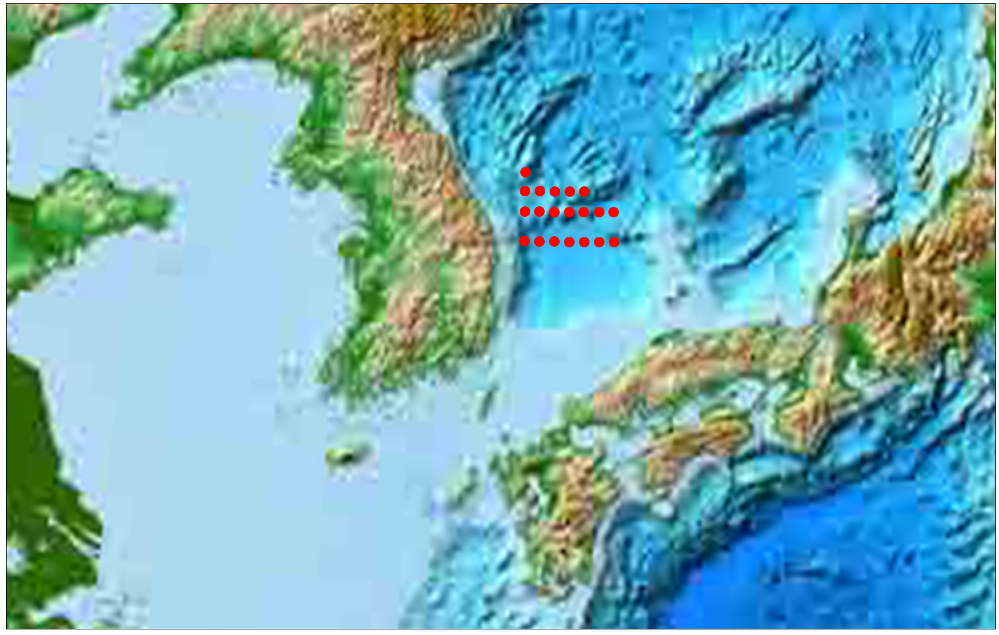

In [19]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "-1"  # Force TF to use only the CPU

#plot obs station
df_sst_point=(df_sst.dropna())[['lat','lon','sst']]
station_point=pd.read_excel('/gpu_deep/Deep_Ocean/AVHRR/station_104_107_loc.xls',header=0)
print(station_point)




df_station_point=station_point[['Point','latitude','longitude']]


print(df_station_point)
print(df_station_point[['latitude']])

df_station_point_38=station_point[(df_station_point['latitude']<39) & (df_station_point['longitude']>129.8) & (df_station_point['longitude']<132)]


lat_ls=df_station_point_38[['latitude']].values.flatten()
lon_ls=df_station_point_38[['longitude']].values.flatten()


# Read Temperature Profile

import glob
from pandas import DataFrame
import pandas as pd
col_names=['AREA','Station','Point','Station-Point','Latitude','Longitude','DATE','DEPTH','TEMPERATURE','TEMP/QC','SALINITY','SALINITY/QC','DISOLVED-OXYGEN','DISOLVED-OXYGEN/QC','QC Level','PHOROSPATE',' nitrite nitrogen','nitric acid nitrogen','silicic acid silicon','pH','Transparency','Pressure','Ship']

path = '/gpu_deep/Deep_Ocean/obs_east/obs_*_east.xls'

df=pd.DataFrame()

files=glob.glob(path)
for file in sorted(files):
    with open(file, 'r') as f:
        #print(file[30:43])
        Name=file[30:43]
        #print(Name)
        statement='/gpu_deep/Deep_Ocean/obs_east/'+ Name + '.xls'
        print(statement)
#        pd.read_excel('/content/drive/My Drive/Deep_Ocean/obs_east/obs_1965_east.xls', header=1,names=col_names)
        df=df.append(pd.read_excel(statement, header=1,names=col_names))

station_point=pd.read_excel('/gpu_deep/Deep_Ocean/AVHRR/station_104_107_loc.xls',header=0)
print(station_point)
print(station_point.shape)

df_station_point=station_point[['Point','latitude','longitude']]

df_station_point_38=station_point[(df_station_point['latitude']<39) & (df_station_point['longitude']>129.8) & (df_station_point['longitude']<132)]

print(df_station_point_38)

df_station_point=df_station_point_38['Point'].to_list()

print(df_station_point)

df_38=pd.DataFrame()

print("------------------------DF_STATION_POINT_38----------------------------------------------")
for i in df_station_point:
    #print(df[df["Station-Point"]==i])
    print(i)
    df_38=df_38.append(df[df["Station-Point"]==i])

#print(df)
temp=df_38
print(temp)



import datetime
from pandas import DataFrame
import matplotlib.pyplot as plt
import numpy as np
#ocean_df=temp[['DATE','Station','Point','Station-Point','Latitude','Longitude','DEPTH','TEMPERATURE','SALINITY']]
ocean_df=temp[['DATE','Station-Point','DEPTH','TEMPERATURE']]
ocean_df['DATE']=pd.to_datetime(ocean_df['DATE'],format='%Y-%m-%d %H:%M')
#ocean_df['DATE']=ocean_df['DATE'].dt.strftime('%Y-%m-%d')
#ocean_df['DATE']=ocean_df['DATE'].dt.strftime('%Y-%m')
ocean_df['DATE']=ocean_df['DATE'].dt.strftime('%Y-%m-%d')

#select Feb
#ocean_df=ocean_df[ocean_df['DATE'].str.contains("-02|-03|-04|-06")]
ocean_df=ocean_df[ocean_df['DATE'].str.contains("-02-|-03-")]

print(ocean_df)


#ocean_df.pivot(index=['DATE','Station-Point'],columns='DEPTH',values='TEMPERATURE')

ocean_grouped = ocean_df["DATE"].unique()

#np.unique(ocean_df[['DATE', 'Station-Point']].values)

#print(np.unique(ocean_df[['DATE', 'Station-Point']].values))



##2중 Loop
reshape_ocean_df = pd.DataFrame(columns=['DATE','Station-Point','Latitude','Longitude','0','10','20','30','50','75','100','125','150','200','250','300','400','500'])

obs_station= ocean_df["Station-Point"].unique()

#depth_criteria=[0,10,25,50,100,200,250,300,400,500]

depth_criteria=[0,10,20,30,50,75,100,125,150,200,250,300,400,500]
print(obs_station)

#DEPTH=ocean_df_temp['DEPTH'][ocean_df_temp["DATE"]==i].to_list()


#tempDf = pd.DataFrame(columns=['PRODUCT','CAT_ID','MARKET_ID'])
#tempDf['PRODUCT'] = df['PRODUCT']
#tempDf['CAT_ID'] = catid
#tempDf['MARKET_ID'] = 13

#finalDf = pd.concat([finalDf,tempDf])

temp_df = pd.DataFrame(columns=['DATE','Station-Point','Latitude','Longitude','0','10','20','30','50','75','100','125','150','200','250','300','400','500'])


df_station_point=station_point[['Point','latitude','longitude']]

df_station_point=pd.DataFrame(df_station_point)


print("--------DF Station Point-------")

print(df_station_point)

from datetime import date
#f_date = date(2014, 7, 2)
#l_date = date(2014, 7, 11)
#delta = l_date - f_date
#print(delta.days)

for i in obs_station :
        obs_station_date=ocean_df.loc[(ocean_df["Station-Point"]==i) & (ocean_df["DATE"]>'1992-01-01') & (ocean_df["DATE"]<'2019-01-01'), "DATE"].unique()
        print(obs_station_date)
        for j in obs_station_date :
                    DEPTH=ocean_df['DEPTH'][(ocean_df["DATE"]==j) & (ocean_df["Station-Point"]==i)].to_list()
                    DEPTH.sort()
                    if DEPTH==depth_criteria:
                        print(j,i)
                        start_dt=date(int(j[0:4]),1,1)
                        print(j[5:7], j[8:10])
                        end_dt=date(int(j[0:4]),int(j[5:7]), int(j[8:10]))
                        delta=end_dt-start_dt
                        ssh_days=delta.days
                        obs_lat=df_station_point.loc[(df_station_point['Point']==i),"latitude"].values
                        obs_lon=df_station_point.loc[(df_station_point['Point']==i),"longitude"].values
                        print("LAT,LON:",obs_lat,obs_lon)
                        #sst_nc_file ='/gpu_deep/Deep_Ocean/CMEMS/cmems_ssh_east_sea_point_'+str(j[0:4])+'.nc'
                        sst_nc_file ='/gpu_deep/Deep_Ocean/CMEMS/cmems_adt_east_sea_point_'+str(j[0:4])+'.nc'
                        print(sst_nc_file)
                        ssh_dataset=xr.open_dataset(sst_nc_file)
                        print(ssh_dataset)
                        #dataset_ssh=ssh_dataset.sla
                        dataset_ssh=ssh_dataset.adt
                        #dataset_ssh_lp = ssh_dataset.sla.sel(longitude=slice(120, 140), latitude=slice(30, 40))
                        dataset_ssh_lp = ssh_dataset.adt.sel(time=j, latitude=obs_lat, longitude=obs_lon, method="nearest")
                        print("SSH:", dataset_ssh_lp)
                        #output_file='/gpu_deep/Deep_Ocean/CMEMS/cmems_ssh_east_sea_point_'+str(year)+'.nc'
                        #print(output_file)
                        #dataset_ssh_lp.to_netcdf(output_file)                                                
                        temp_df["DATE"]=j
                        temp_df["Station-Point"]=i
                        temp_df["Latitude"]=obs_lat
                        temp_df["Longitude"]=obs_lon
                        temp_df["SSH"]=dataset_ssh_lp.values
                        temp_df["0"]=ocean_df.loc[(ocean_df["Station-Point"]==i) & (ocean_df["DATE"]==j) & (ocean_df["DEPTH"]==0),"TEMPERATURE"].values 
                        temp_df["10"]=ocean_df.loc[(ocean_df["Station-Point"]==i) & (ocean_df["DATE"]==j) & (ocean_df["DEPTH"]==10),"TEMPERATURE"].values
                        temp_df["20"]=ocean_df.loc[(ocean_df["Station-Point"]==i) & (ocean_df["DATE"]==j) & (ocean_df["DEPTH"]==20),"TEMPERATURE"].values
                        temp_df["30"]=ocean_df.loc[(ocean_df["Station-Point"]==i) & (ocean_df["DATE"]==j) & (ocean_df["DEPTH"]==30),"TEMPERATURE"].values
                        temp_df["50"]=ocean_df.loc[(ocean_df["Station-Point"]==i) & (ocean_df["DATE"]==j) & (ocean_df["DEPTH"]==50),"TEMPERATURE"].values
                        temp_df["75"]=ocean_df.loc[(ocean_df["Station-Point"]==i) & (ocean_df["DATE"]==j) & (ocean_df["DEPTH"]==75),"TEMPERATURE"].values
                        temp_df["100"]=ocean_df.loc[(ocean_df["Station-Point"]==i) & (ocean_df["DATE"]==j) & (ocean_df["DEPTH"]==100),"TEMPERATURE"].values
                        temp_df["125"]=ocean_df.loc[(ocean_df["Station-Point"]==i) & (ocean_df["DATE"]==j) & (ocean_df["DEPTH"]==125),"TEMPERATURE"].values
                        temp_df["150"]=ocean_df.loc[(ocean_df["Station-Point"]==i) & (ocean_df["DATE"]==j) & (ocean_df["DEPTH"]==150),"TEMPERATURE"].values
                        temp_df["200"]=ocean_df.loc[(ocean_df["Station-Point"]==i) & (ocean_df["DATE"]==j) & (ocean_df["DEPTH"]==200),"TEMPERATURE"].values
                        temp_df["250"]=ocean_df.loc[(ocean_df["Station-Point"]==i) & (ocean_df["DATE"]==j) & (ocean_df["DEPTH"]==250),"TEMPERATURE"].values
                        temp_df["300"]=ocean_df.loc[(ocean_df["Station-Point"]==i) & (ocean_df["DATE"]==j) & (ocean_df["DEPTH"]==300),"TEMPERATURE"].values
                        temp_df["400"]=ocean_df.loc[(ocean_df["Station-Point"]==i) & (ocean_df["DATE"]==j) & (ocean_df["DEPTH"]==400),"TEMPERATURE"].values
                        temp_df["500"]=ocean_df.loc[(ocean_df["Station-Point"]==i) & (ocean_df["DATE"]==j) & (ocean_df["DEPTH"]==500),"TEMPERATURE"].values
                        print(temp_df)
                        reshape_ocean_df=pd.concat([reshape_ocean_df,temp_df])
                        
print(reshape_ocean_df[reshape_ocean_df['DATE']!=reshape_ocean_df['DATE']])

reshape_ocean_df.reset_index()
                        
                        
#                    for k in depth_criteria:
#                        if DEPTH==depth_criteria:
#                            temp_depth=ocean_df.loc[(ocean_df["Station-Point"]==i) & (ocean_df["DATE"]==j) & (ocean_df["DEPTH"]==k)]
#                            print(temp_depth)
#                            #print(i,j,k,temp_depth)
                    

print(reshape_ocean_df)

reshape_ocean_df.to_csv('reshape_ocean_df.csv',index=False)

reshape_ocean_df=pd.read_csv('reshape_ocean_df.csv')  

pd.set_option('display.max_rows', None) 
print(reshape_ocean_df.drop([0,0]))


reshape_ocean_df_1993=reshape_ocean_df[reshape_ocean_df["DATE"]>'1993-01-01']

reshape_ocean_df_1993.reset_index(drop=True,inplace=True)

print(reshape_ocean_df_1993)

#ls_ocean_dt=ocean_df['DATE'].unique()
ls_station_df=ocean_df['Station-Point'].unique()
print(ls_station_df.shape)
obs_station_lst=ls_station_df.tolist()
print(obs_station_lst)





import numpy as np
import matplotlib.pyplot as plt
from matplotlib.cbook import dedent
from mpl_toolkits.basemap import Basemap
fig = plt.figure(figsize=(32, 32))
#m = Basemap(projection='lcc', resolution='f',
#            width=1E6, height=1E6, 
#            lat_0=37, lon_0=132,)
#m.etopo(scale=0.5, alpha=0.5)
m = Basemap(projection='lcc', resolution='f',
          lat_0=37, lon_0=132, 
          llcrnrlon=120.25, llcrnrlat=30.0,
          urcrnrlon=140.25, urcrnrlat=40.75)
m.etopo(scale=3.0, alpha=2.0)


lons, lats = m(lon_ls, lat_ls)
#m.scatter(lons, lats, marker = 'o', color='r', zorder=5)
m.plot(lons,lats,'ro',markersize=18)
plt.show()

# Map (long, lat) to (x, y) for plotting
#x, y = m(132, 37)
#plt.plot(x, y, 'ok', markersize=10)
#plt.text(x, y, ' Seoul', fontsize=12);

#m.scatter(lon, lat, marker = 'o', color='r', zorder=5)

#m.scatter(lon, lat, latlon=True,
#          c=np.log10(population), s=area,
#          cmap='Reds', alpha=0.5)

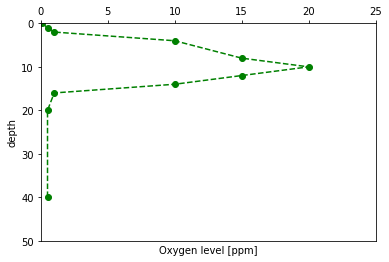

In [20]:
import matplotlib.pyplot as plt

# define data

Oxygen = [ 0.1 , 0.5, 1, 10, 15, 20, 15, 10, 1, 0.5, 0.5]
Depth  = [ 0,     1,  2,  4,  8, 10, 12, 14, 16, 20, 40 ]

fig = plt.figure()
ax = fig.add_subplot(111)

ax.plot(Oxygen, Depth, 'go--')
ax.xaxis.tick_top()

ax.set_ylabel('depth')
ax.set_ylim(50, 0)
ax.set_xlim(0, 25)
ax.set_xlabel('Oxygen level [ppm]')

plt.show()

In [21]:
df_sst=dataset_sst_lp.to_dataframe()
np_sst=df_sst.to_numpy()
print(np_sst.shape)
print(np_sst)
#sst_numpy_array = np.stack([data_array.values for data_array in df_sst['sst'].values])

(111600, 1)
[[19.109999]
 [19.43    ]
 [19.859999]
 ...
 [ 4.97    ]
 [ 5.41    ]
 [ 5.69    ]]


In [22]:
import pandas as pd
reshape_ocean_df=pd.read_csv('reshape_ocean_df.csv')
reshape_ocean_df

,DATE,Station-Point,Latitude,Longitude,0,10,20,30,50,75,100,125,150,200,250,300,400,500,SSH
0,NaN,NaN,37.0567,130.0000,11.6200,11.6200,11.6100,11.7100,11.6000,11.7000,11.6500,11.6500,10.7900,10.8000,5.4000,1.9300,1.5300,1.0400,0.5571
1,1994-02-20,104-07,37.0567,130.0000,9.2200,8.3500,7.5800,6.4400,6.3000,6.0800,4.7100,3.8900,3.2000,2.3300,1.8900,1.7200,1.2400,0.7400,0.4169
2,1996-02-14,104-07,37.0567,130.0000,8.8700,8.8800,8.8700,8.8600,7.6000,6.6800,4.4900,4.6700,4.6300,2.8600,1.3900,1.1200,0.7700,0.4900,0.4374
3,1997-02-14,104-07,37.0567,130.0000,10.0300,9.8900,9.3100,9.2300,7.7900,5.7300,3.7800,2.4200,1.8600,1.4100,0.9500,0.7900,0.5700,0.4300,0.4916
4,1998-02-23,104-07,37.0567,130.0000,12.8400,12.8400,12.8300,12.8100,12.8000,12.8000,9.8900,6.2900,3.2500,1.6700,1.1400,0.9100,0.6400,0.4800,0.5317
5,1999-02-15,104-07,37.0567,130.0000,11.1800,11.1800,11.1900,11.1900,11.1900,11.1900,11.1900,11.1900,10.9300,6.5800,2.5900,1.4500,0.9700,0.6900,0.5764
6,2000-03-01,104-07,37.0567,130.0000,10.7500,10.7100,10.7100,10.7100,10.7100,10.6900,9.3900,6.7300,3.4800,1.8900,1.1600,0.9200,0.6900,0.5100,0.5952
7,2001-02-19,104-07,37.0567,130.0000,11.0800,11.0900,11.0900,11.0900,11.1000,11.1000,11.1000,11.0800,10.4700,4.6200,1.8600,1.0800,0.8200,0.5900,0.6360
8,2003-02-24,104-07,37.0567,130.0000,9.5400,9.5900,9.6000,9.6100,9.5700,9.4800,9.3200,5.7700,5.5700,2.5900,1.4600,0.9900,0.7300,0.6100,0.5276
9,2005-03-08,104-07,37.0567,130.0000,11.0500,11.0600,11.0700,11.0400,10.2300,9.6200,8.3100,7.5200,5.2600,4.1300,2.2000,1.2900,0.8600,0.6500,0.4679


In [23]:
reshape_ocean_df_1993
reshape_ocean_df_1993_104_07=reshape_ocean_df_1993[reshape_ocean_df_1993['Station-Point']=='104-07']

In [24]:
reshape_ocean_df_1993_104_07

,DATE,Station-Point,Latitude,Longitude,0,10,20,30,50,75,100,125,150,200,250,300,400,500,SSH
0,1994-02-20,104-07,37.0567,130.0,9.2200,8.3500,7.5800,6.4400,6.3000,6.0800,4.7100,3.8900,3.2000,2.3300,1.8900,1.7200,1.2400,0.7400,0.4169
1,1996-02-14,104-07,37.0567,130.0,8.8700,8.8800,8.8700,8.8600,7.6000,6.6800,4.4900,4.6700,4.6300,2.8600,1.3900,1.1200,0.7700,0.4900,0.4374
2,1997-02-14,104-07,37.0567,130.0,10.0300,9.8900,9.3100,9.2300,7.7900,5.7300,3.7800,2.4200,1.8600,1.4100,0.9500,0.7900,0.5700,0.4300,0.4916
3,1998-02-23,104-07,37.0567,130.0,12.8400,12.8400,12.8300,12.8100,12.8000,12.8000,9.8900,6.2900,3.2500,1.6700,1.1400,0.9100,0.6400,0.4800,0.5317
4,1999-02-15,104-07,37.0567,130.0,11.1800,11.1800,11.1900,11.1900,11.1900,11.1900,11.1900,11.1900,10.9300,6.5800,2.5900,1.4500,0.9700,0.6900,0.5764
5,2000-03-01,104-07,37.0567,130.0,10.7500,10.7100,10.7100,10.7100,10.7100,10.6900,9.3900,6.7300,3.4800,1.8900,1.1600,0.9200,0.6900,0.5100,0.5952
6,2001-02-19,104-07,37.0567,130.0,11.0800,11.0900,11.0900,11.0900,11.1000,11.1000,11.1000,11.0800,10.4700,4.6200,1.8600,1.0800,0.8200,0.5900,0.6360
7,2003-02-24,104-07,37.0567,130.0,9.5400,9.5900,9.6000,9.6100,9.5700,9.4800,9.3200,5.7700,5.5700,2.5900,1.4600,0.9900,0.7300,0.6100,0.5276
8,2005-03-08,104-07,37.0567,130.0,11.0500,11.0600,11.0700,11.0400,10.2300,9.6200,8.3100,7.5200,5.2600,4.1300,2.2000,1.2900,0.8600,0.6500,0.4679
9,2008-02-21,104-07,37.0567,130.0,11.3191,11.2773,11.2625,11.2566,11.2532,11.2207,11.0594,10.8106,9.2827,3.9302,1.9558,1.2376,0.8049,0.6579,0.5822


In [25]:
reshape_ocean_cnn=reshape_ocean_df[["DATE","Station-Point","SSH","0","10","20","30","50","75","100","125","150","200","250","300"]]

In [26]:
reshape_ocean_cnn

,DATE,Station-Point,SSH,0,10,20,30,50,75,100,125,150,200,250,300
0,NaN,NaN,0.5571,11.6200,11.6200,11.6100,11.7100,11.6000,11.7000,11.6500,11.6500,10.7900,10.8000,5.4000,1.9300
1,1994-02-20,104-07,0.4169,9.2200,8.3500,7.5800,6.4400,6.3000,6.0800,4.7100,3.8900,3.2000,2.3300,1.8900,1.7200
2,1996-02-14,104-07,0.4374,8.8700,8.8800,8.8700,8.8600,7.6000,6.6800,4.4900,4.6700,4.6300,2.8600,1.3900,1.1200
3,1997-02-14,104-07,0.4916,10.0300,9.8900,9.3100,9.2300,7.7900,5.7300,3.7800,2.4200,1.8600,1.4100,0.9500,0.7900
4,1998-02-23,104-07,0.5317,12.8400,12.8400,12.8300,12.8100,12.8000,12.8000,9.8900,6.2900,3.2500,1.6700,1.1400,0.9100
5,1999-02-15,104-07,0.5764,11.1800,11.1800,11.1900,11.1900,11.1900,11.1900,11.1900,11.1900,10.9300,6.5800,2.5900,1.4500
6,2000-03-01,104-07,0.5952,10.7500,10.7100,10.7100,10.7100,10.7100,10.6900,9.3900,6.7300,3.4800,1.8900,1.1600,0.9200
7,2001-02-19,104-07,0.6360,11.0800,11.0900,11.0900,11.0900,11.1000,11.1000,11.1000,11.0800,10.4700,4.6200,1.8600,1.0800
8,2003-02-24,104-07,0.5276,9.5400,9.5900,9.6000,9.6100,9.5700,9.4800,9.3200,5.7700,5.5700,2.5900,1.4600,0.9900
9,2005-03-08,104-07,0.4679,11.0500,11.0600,11.0700,11.0400,10.2300,9.6200,8.3100,7.5200,5.2600,4.1300,2.2000,1.2900


In [27]:
reshape_104_07_temp=reshape_ocean_cnn[reshape_ocean_cnn["Station-Point"]=='104-07']
reshape_104_08_temp=reshape_ocean_cnn[reshape_ocean_cnn["Station-Point"]=='104-08']
reshape_104_09_temp=reshape_ocean_cnn[reshape_ocean_cnn["Station-Point"]=='104-09']
reshape_104_10_temp=reshape_ocean_cnn[reshape_ocean_cnn["Station-Point"]=='104-10']
reshape_104_11_temp=reshape_ocean_cnn[reshape_ocean_cnn["Station-Point"]=='104-11']
reshape_105_07_temp=reshape_ocean_cnn[reshape_ocean_cnn["Station-Point"]=='105-07']
reshape_105_08_temp=reshape_ocean_cnn[reshape_ocean_cnn["Station-Point"]=='105-08']
reshape_105_09_temp=reshape_ocean_cnn[reshape_ocean_cnn["Station-Point"]=='105-09']
reshape_105_10_temp=reshape_ocean_cnn[reshape_ocean_cnn["Station-Point"]=='105-10']
reshape_105_11_temp=reshape_ocean_cnn[reshape_ocean_cnn["Station-Point"]=='105-11']
reshape_106_07_temp=reshape_ocean_cnn[reshape_ocean_cnn["Station-Point"]=='106-07']
reshape_106_08_temp=reshape_ocean_cnn[reshape_ocean_cnn["Station-Point"]=='106-08']
reshape_106_09_temp=reshape_ocean_cnn[reshape_ocean_cnn["Station-Point"]=='106-09']
reshape_106_10_temp=reshape_ocean_cnn[reshape_ocean_cnn["Station-Point"]=='106-10']
reshape_106_11_temp=reshape_ocean_cnn[reshape_ocean_cnn["Station-Point"]=='106-11']

In [28]:
year_mon_104_07=reshape_104_07_temp["DATE"].str.slice(0,7)
year_mon_104_08=reshape_104_08_temp["DATE"].str.slice(0,7)
year_mon_104_09=reshape_104_09_temp["DATE"].str.slice(0,7)
year_mon_104_10=reshape_104_10_temp["DATE"].str.slice(0,7)
year_mon_104_11=reshape_104_11_temp["DATE"].str.slice(0,7)
year_mon_105_07=reshape_105_07_temp["DATE"].str.slice(0,7)
year_mon_105_08=reshape_105_08_temp["DATE"].str.slice(0,7)
year_mon_105_09=reshape_105_09_temp["DATE"].str.slice(0,7)
year_mon_105_10=reshape_105_10_temp["DATE"].str.slice(0,7)
year_mon_105_11=reshape_105_11_temp["DATE"].str.slice(0,7)
year_mon_106_07=reshape_106_07_temp["DATE"].str.slice(0,7)
year_mon_106_08=reshape_106_08_temp["DATE"].str.slice(0,7)
year_mon_106_09=reshape_106_09_temp["DATE"].str.slice(0,7)
year_mon_106_10=reshape_106_10_temp["DATE"].str.slice(0,7)
year_mon_106_11=reshape_106_11_temp["DATE"].str.slice(0,7)

In [29]:
set_104_07=set(year_mon_104_07)
set_104_08=set(year_mon_104_08)
set_104_09=set(year_mon_104_09)
set_104_10=set(year_mon_104_10)
set_104_11=set(year_mon_104_11)

set_105_07=set(year_mon_105_07)
set_105_08=set(year_mon_105_08)
set_105_09=set(year_mon_105_09)
set_105_10=set(year_mon_105_10)
set_105_11=set(year_mon_105_11)

set_106_07=set(year_mon_106_07)
set_106_08=set(year_mon_106_08)
set_106_09=set(year_mon_106_09)
set_106_10=set(year_mon_106_10)
set_106_11=set(year_mon_106_11)

In [30]:
set_104_08

{'1993-02',
 '1994-02',
 '1996-02',
 '1997-02',
 '1998-02',
 '1999-02',
 '2000-03',
 '2001-02',
 '2003-02',
 '2004-02',
 '2006-02',
 '2009-02',
 '2010-02',
 '2011-02',
 '2012-02',
 '2013-02',
 '2014-02',
 '2015-02',
 '2016-02',
 '2017-02',
 '2018-02'}

In [31]:
set_common_104=(set_104_07&set_104_08&set_104_09&set_104_10&set_104_11)
set_common_105=(set_105_07&set_105_08&set_105_09&set_105_10&set_105_11)
set_common_106=(set_106_07&set_106_08&set_106_09&set_106_10&set_106_11)
#set_common=set(set_common&set_104_09)

set_common=(set_common_104&set_common_105&set_common_106)

In [32]:
year_mon=list(set_common)

In [33]:
set_common

{'1994-02',
 '1996-02',
 '1997-02',
 '1999-02',
 '2009-02',
 '2011-02',
 '2012-02',
 '2013-02',
 '2015-02',
 '2016-02',
 '2017-02'}

In [34]:
import numpy as np
reshape_ocean_cnn.dropna()
type(reshape_ocean_cnn)
reshape_ocean_cnn=reshape_ocean_cnn.dropna()

In [35]:
reshape_ocean_cnn

,DATE,Station-Point,SSH,0,10,20,30,50,75,100,125,150,200,250,300
1,1994-02-20,104-07,0.4169,9.2200,8.3500,7.5800,6.4400,6.3000,6.0800,4.7100,3.8900,3.2000,2.3300,1.8900,1.7200
2,1996-02-14,104-07,0.4374,8.8700,8.8800,8.8700,8.8600,7.6000,6.6800,4.4900,4.6700,4.6300,2.8600,1.3900,1.1200
3,1997-02-14,104-07,0.4916,10.0300,9.8900,9.3100,9.2300,7.7900,5.7300,3.7800,2.4200,1.8600,1.4100,0.9500,0.7900
4,1998-02-23,104-07,0.5317,12.8400,12.8400,12.8300,12.8100,12.8000,12.8000,9.8900,6.2900,3.2500,1.6700,1.1400,0.9100
5,1999-02-15,104-07,0.5764,11.1800,11.1800,11.1900,11.1900,11.1900,11.1900,11.1900,11.1900,10.9300,6.5800,2.5900,1.4500
6,2000-03-01,104-07,0.5952,10.7500,10.7100,10.7100,10.7100,10.7100,10.6900,9.3900,6.7300,3.4800,1.8900,1.1600,0.9200
7,2001-02-19,104-07,0.6360,11.0800,11.0900,11.0900,11.0900,11.1000,11.1000,11.1000,11.0800,10.4700,4.6200,1.8600,1.0800
8,2003-02-24,104-07,0.5276,9.5400,9.5900,9.6000,9.6100,9.5700,9.4800,9.3200,5.7700,5.5700,2.5900,1.4600,0.9900
9,2005-03-08,104-07,0.4679,11.0500,11.0600,11.0700,11.0400,10.2300,9.6200,8.3100,7.5200,5.2600,4.1300,2.2000,1.2900
10,2008-02-21,104-07,0.5822,11.3191,11.2773,11.2625,11.2566,11.2532,11.2207,11.0594,10.8106,9.2827,3.9302,1.9558,1.2376


In [36]:
reshape_ocean_cnn_common=pd.DataFrame()

for year in year_mon:
    reshape_ocean_cnn_temp=reshape_ocean_cnn[reshape_ocean_cnn["DATE"].str.contains(year)]
    reshape_ocean_cnn_common=pd.concat([reshape_ocean_cnn_temp,reshape_ocean_cnn_common])

    
pd.set_option('display.max_rows', None)

reshape_ocean_cnn_common.shape
reshape_ocean_cnn_common
reshape_ocean_cnn_common.to_csv('reshape_ocean_cnn_common.csv')

In [37]:
depth_list=['10','20','30','50','75','100','125','150','200','250','300']
for depth in depth_list:
    print(depth)
    reshape_ocean_cnn_common=pd.DataFrame()
    reshape_ocean_cnn_temp=pd.DataFrame()
    for year in year_mon:
        print(year)
        reshape_ocean_cnn_temp['DATE']=year
        reshape_ocean_cnn_temp["104-07"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='104-07'),depth].values
        reshape_ocean_cnn_temp["104-08"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='104-08'),depth].values
        reshape_ocean_cnn_temp["104-09"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='104-09'),depth].values
        reshape_ocean_cnn_temp["104-10"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='104-10'),depth].values
        reshape_ocean_cnn_temp["104-11"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='104-11'),depth].values
        reshape_ocean_cnn_temp["105-07"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='105-07'),depth].values
        reshape_ocean_cnn_temp["105-08"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='105-08'),depth].values
        reshape_ocean_cnn_temp["105-09"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='105-09'),depth].values
        reshape_ocean_cnn_temp["105-10"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='105-10'),depth].values
        reshape_ocean_cnn_temp["105-11"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='105-11'),depth].values
        reshape_ocean_cnn_temp["106-07"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='106-07'),depth].values
        reshape_ocean_cnn_temp["106-08"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='106-08'),depth].values
        reshape_ocean_cnn_temp["106-09"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='106-09'),depth].values
        reshape_ocean_cnn_temp["106-10"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='106-10'),depth].values
        reshape_ocean_cnn_temp["106-11"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='106-11'),depth].values
        reshape_ocean_cnn_common=pd.concat([reshape_ocean_cnn_temp,reshape_ocean_cnn_common])
        #print(reshape_ocean_cnn_common)
    reshape_ocean_cnn_common.reset_index()
    #print(depth)
    reshape_ocean_cnn_common.to_csv('reshape_ocean_common_sub_'+depth+'.csv',index=False)
    reshape_ocean_cnn_common_sub=pd.read_csv('reshape_ocean_common_sub_'+depth+'.csv')
    reshape_ocean_cnn_common_sub=reshape_ocean_cnn_common_sub[['106-07','106-08','106-09','106-10','106-11','105-07','105-08','105-09','105-10','105-11','104-07','104-08','104-09','104-10','104-11']]
    globals()['reshape_ocean_cnn_common_sub_'+depth]=reshape_ocean_cnn_common_sub.dropna()
    
reshape_ocean_cnn_common_sub_10

10
2016-02
1999-02
1994-02
2011-02
2009-02
2017-02
1997-02
2013-02
2015-02
1996-02
2012-02
20
2016-02
1999-02
1994-02
2011-02
2009-02
2017-02
1997-02
2013-02
2015-02
1996-02
2012-02
30
2016-02
1999-02
1994-02
2011-02
2009-02
2017-02
1997-02
2013-02
2015-02
1996-02
2012-02
50
2016-02
1999-02
1994-02
2011-02
2009-02
2017-02
1997-02
2013-02
2015-02
1996-02
2012-02
75
2016-02
1999-02
1994-02
2011-02
2009-02
2017-02
1997-02
2013-02
2015-02
1996-02
2012-02
100
2016-02
1999-02
1994-02
2011-02
2009-02
2017-02
1997-02
2013-02
2015-02
1996-02
2012-02
125
2016-02
1999-02
1994-02
2011-02
2009-02
2017-02
1997-02
2013-02
2015-02
1996-02
2012-02
150
2016-02
1999-02
1994-02
2011-02
2009-02
2017-02
1997-02
2013-02
2015-02
1996-02
2012-02
200
2016-02
1999-02
1994-02
2011-02
2009-02
2017-02
1997-02
2013-02
2015-02
1996-02
2012-02
250
2016-02
1999-02
1994-02
2011-02
2009-02
2017-02
1997-02
2013-02
2015-02
1996-02
2012-02
300
2016-02
1999-02
1994-02
2011-02
2009-02
2017-02
1997-02
2013-02
2015-02
1996-02
2

,106-07,106-08,106-09,106-10,106-11,105-07,105-08,105-09,105-10,105-11,104-07,104-08,104-09,104-10,104-11
0,10.2844,9.8374,7.9420,7.8732,10.0159,10.4389,10.4228,10.5554,9.2350,9.9577,10.3655,10.3258,8.5046,10.7901,11.5325
1,6.4300,6.9700,6.4800,6.1500,8.3600,6.7900,7.4600,8.4100,8.3000,8.1000,8.8800,10.0800,10.4200,10.3400,9.7600
2,11.6480,11.7140,11.7417,11.7874,11.7063,11.2798,11.1942,11.2452,11.3753,10.9854,11.1192,11.2731,11.3062,11.3094,11.1852
3,10.9900,10.5900,10.5600,10.4500,6.9700,10.6700,10.0900,10.2800,10.3000,10.3600,10.2000,10.2600,10.2300,10.2500,10.2200
4,6.7200,6.3100,6.3200,6.2700,7.1700,8.9400,8.3700,8.4700,8.0400,8.2800,9.8900,10.6100,11.3400,12.0700,12.9900
5,13.1251,13.4922,11.6800,9.9682,8.7968,12.0326,11.8136,11.9767,11.6038,11.3681,11.9003,12.3213,12.3105,12.1152,11.9061
6,10.9264,10.3863,10.2071,10.8507,9.0564,12.7233,12.3900,10.4058,11.5394,10.3060,14.0760,12.5803,12.6735,10.7522,12.5111
7,9.6004,10.8033,10.4854,10.4921,10.3952,10.2779,10.2023,10.3453,10.3885,10.2267,10.2173,10.1785,10.1949,10.3614,10.0868
8,8.2200,9.1400,8.1100,7.1000,8.9100,8.3700,8.5900,11.3000,12.0000,7.0100,8.3500,10.9000,11.9200,12.1500,11.8600
9,11.3400,11.5900,11.4300,11.8200,10.0600,11.0700,10.9400,11.5200,11.4200,11.1700,11.1800,11.2900,11.3200,11.3800,11.0500


In [38]:
reshape_ocean_cnn_common=pd.DataFrame()
reshape_ocean_cnn_temp=pd.DataFrame()
for year in year_mon:
    print(year)
    reshape_ocean_cnn_temp['DATE']=year
    reshape_ocean_cnn_temp["104-07"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='104-07'),"SSH"].values
    reshape_ocean_cnn_temp["104-08"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='104-08'),"SSH"].values
    reshape_ocean_cnn_temp["104-09"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='104-09'),"SSH"].values
    reshape_ocean_cnn_temp["104-10"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='104-10'),"SSH"].values
    reshape_ocean_cnn_temp["104-11"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='104-11'),"SSH"].values
    reshape_ocean_cnn_temp["105-07"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='105-07'),"SSH"].values
    reshape_ocean_cnn_temp["105-08"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='105-08'),"SSH"].values
    reshape_ocean_cnn_temp["105-09"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='105-09'),"SSH"].values
    reshape_ocean_cnn_temp["105-10"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='105-10'),"SSH"].values
    reshape_ocean_cnn_temp["105-11"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='105-11'),"SSH"].values
    reshape_ocean_cnn_temp["106-07"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='106-07'),"SSH"].values
    reshape_ocean_cnn_temp["106-08"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='106-08'),"SSH"].values
    reshape_ocean_cnn_temp["106-09"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='106-09'),"SSH"].values
    reshape_ocean_cnn_temp["106-10"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='106-10'),"SSH"].values
    reshape_ocean_cnn_temp["106-11"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='106-11'),"SSH"].values
    reshape_ocean_cnn_common=pd.concat([reshape_ocean_cnn_temp,reshape_ocean_cnn_common])
    print(reshape_ocean_cnn_common)

reshape_ocean_cnn_common.reset_index()
reshape_ocean_cnn_common.to_csv('reshape_ocean_common_ssh.csv',index=False)
reshape_ocean_cnn_common_ssh=pd.read_csv('reshape_ocean_common_ssh.csv')
reshape_ocean_cnn_common_ssh=reshape_ocean_cnn_common_ssh[['106-07','106-08','106-09','106-10','106-11','105-07','105-08','105-09','105-10','105-11','104-07','104-08','104-09','104-10','104-11']]
globals()['reshape_ocean_cnn_common_ssh']=reshape_ocean_cnn_common_sub.dropna()
#reshape_ocean_cnn_common_ssh=reshape_ocean_cnn_common_ssh.dropna()
reshape_ocean_cnn_common_ssh
#reshape_ocean_cnn_common_ssh=reshape_ocean_cnn_common_ssh[['106-07','106-08','106-09','106-10','106-11','105-07','105-08','105-09','105-10','105-11','104-07','104-08','104-09','104-10','104-11']]
#reshape_ocean_cnn_common_ssh

2016-02
  DATE  104-07  104-08  104-09  104-10  104-11  105-07  105-08  105-09  \
0  NaN  0.6519  0.7152  0.7545  0.7595  0.7095  0.5318  0.5607  0.5835   

   105-10  105-11  106-07  106-08  106-09  106-10  106-11  
0  0.5937  0.6008  0.4876  0.4815  0.4888  0.5045  0.5212  
1999-02
      DATE  104-07  104-08  104-09  104-10  104-11  105-07  105-08  105-09  \
0  1999-02  0.5764  0.6374  0.6523  0.6188  0.5176  0.4998  0.5445  0.5819   
0      NaN  0.6519  0.7152  0.7545  0.7595  0.7095  0.5318  0.5607  0.5835   

   105-10  105-11  106-07  106-08  106-09  106-10  106-11  
0  0.5910  0.5622  0.5021  0.5249  0.5529  0.5492  0.4952  
0  0.5937  0.6008  0.4876  0.4815  0.4888  0.5045  0.5212  
1994-02
      DATE  104-07  104-08  104-09  104-10  104-11  105-07  105-08  105-09  \
0  1994-02  0.4169  0.4363  0.4577  0.4618  0.4525  0.5016  0.4600  0.4246   
0  1999-02  0.5764  0.6374  0.6523  0.6188  0.5176  0.4998  0.5445  0.5819   
0      NaN  0.6519  0.7152  0.7545  0.7595  0.7095  0.5318

,106-07,106-08,106-09,106-10,106-11,105-07,105-08,105-09,105-10,105-11,104-07,104-08,104-09,104-10,104-11
0,1.1638,1.0855,1.0407,0.9958,0.9960,1.8758,1.6542,1.3236,1.0888,1.0187,1.3907,1.3024,1.0201,0.9908,1.0649
1,1.0900,1.0700,1.0500,1.0300,1.0400,0.9500,0.8000,0.8100,0.8000,0.9100,1.1200,1.0000,1.0800,1.0600,1.0800
2,1.1013,1.5554,2.0152,1.8657,1.3131,1.7987,2.2353,2.6397,2.7722,1.4137,1.2907,2.0489,2.5667,2.2208,1.2900
3,0.9700,1.1100,1.6300,1.2400,0.8900,1.4700,1.9000,2.2500,3.1500,1.7800,1.3400,2.4500,5.2400,5.2000,3.3500
4,1.0100,0.9800,1.0800,0.9900,0.9700,0.8600,0.9400,1.0200,0.7400,0.7500,0.7900,0.8300,0.8900,0.9900,1.1100
5,0.9863,1.2664,1.2383,1.1243,0.9418,1.0859,1.2448,1.2792,1.3076,1.1932,1.4564,2.5897,2.2269,1.5202,1.3881
6,1.4794,1.2410,1.0209,0.9480,0.9266,1.0356,1.0756,0.9411,0.9038,0.9343,0.9485,1.0609,1.2495,0.9788,1.0281
7,0.8572,1.1644,3.0464,5.9628,2.6509,1.2779,1.4728,2.9362,4.6544,2.0724,1.1565,1.2204,1.5527,1.5537,1.2547
8,1.7900,1.9900,1.3800,1.0400,1.3400,2.5000,2.6800,1.6400,1.2000,1.2700,1.7200,1.1200,1.0100,2.8400,2.1800
9,1.0200,1.2500,1.2100,1.1300,1.0100,1.0000,1.1700,1.2800,1.3200,1.3400,1.4500,2.6100,2.1600,2.1700,1.5100


In [39]:
from sdv.tabular import CopulaGAN
#model_upper = CopulaGAN(constraints=constraints_upper)
model=CopulaGAN()
#model_upper.fit(ocean_train_upper)
model.fit(reshape_ocean_cnn_common_ssh)
#model_upper.sample(100, max_retries=100000, conditions=conditions)
model.sample(1000, max_retries=1000000)

/home/gisuser/.conda/envs/ocean-conv2d/lib/python3.8/site-packages/scipy/stats/_continuous_distns.py:621: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/gisuser/.conda/envs/ocean-conv2d/lib/python3.8/site-packages/scipy/stats/_continuous_distns.py:5003: RuntimeWarning: divide by zero encountered in true_divide
  return c**2 / (c**2 - n**2)
/home/gisuser/.conda/envs/ocean-conv2d/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:2494: RuntimeWarning: invalid value encountered in double_scalars
  Lhat = muhat - Shat*mu
/home/gisuser/.conda/envs/ocean-conv2d/lib/python3.8/site-packages/copulas/univariate/truncated_gaussian.py:43: RuntimeWarning: invalid value encountered in double_scalars
  a = (self.min - loc) / scale
/home/gisuser/.conda/envs/ocean-conv2d/lib/python3.8/site-packages/copulas/univariate/truncated_gaussian.py:44: RuntimeWarning: divide by zero encountered in double_scalars
  b = (self.max

,106-07,106-08,106-09,106-10,106-11,105-07,105-08,105-09,105-10,105-11,104-07,104-08,104-09,104-10,104-11
0,1.017464,2.486510,1.372692,1.251889,4.998425,1.394977,8.000596e-01,1.302810,2.252642e+01,1.033815,1.609288,1.082327,0.336593,3.944473,1.182858
1,1.069223,1.433907,0.836884,1.101510,0.890008,1.796770,1.072395e+00,1.852702,4.158894e+02,0.756879,1.680193,0.844000,0.901313,0.978800,1.456402
2,0.845785,1.251233,1.093475,0.600085,1.416404,0.283302,1.219161e+00,2.983115,1.371243e+00,1.211985,1.335014,0.873059,2.161454,3.864168,1.798867
3,0.999486,1.238775,1.408444,1.316471,0.962570,1.744634,1.435713e+00,2.678859,1.002561e+00,1.364221,1.167790,2.599550,1.350593,0.978800,1.371138
4,0.921099,1.690531,0.830899,27.165996,0.890000,0.354999,1.211706e+00,1.698852,2.427728e+01,1.202051,1.551772,1.358383,1.580925,1.992432,1.429881
5,1.058256,1.636903,0.833447,1.808380,0.917081,0.993718,1.261765e+00,3.040342,9.660453e-01,1.090782,0.958446,0.877425,1.543991,1.931728,1.597452
6,1.039994,1.907090,1.213315,0.972328,0.894977,0.853665,1.911265e+00,1.308702,1.375560e+00,0.931689,1.222571,0.830332,0.944179,0.985981,1.309306
7,1.300960,1.569014,1.297213,0.970952,0.966543,0.510175,2.521144e+00,2.212324,1.483743e+00,0.702847,1.400018,2.493745,3.965530,0.999071,1.444633
8,1.010265,1.316058,0.873886,0.923842,0.890000,1.131847,2.857487e+00,1.501738,2.982618e+01,1.250714,1.299698,1.973505,1.816928,5.198148,1.419475
9,1.528452,0.968144,1.057066,0.978977,0.985330,1.017601,8.159590e-01,1.936055,3.843136e+00,1.044642,1.317779,0.830085,3.986634,1.645911,1.437107


In [40]:
reshape_ocean_cnn_common_sst=pd.DataFrame()
reshape_ocean_cnn_temp=pd.DataFrame()
for year in year_mon:
    reshape_ocean_cnn_temp["DATE"]=year
    reshape_ocean_cnn_temp["104-07"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='104-07'),"0"].values
    reshape_ocean_cnn_temp["104-08"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='104-08'),"0"].values
    reshape_ocean_cnn_temp["104-09"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='104-09'),"0"].values
    reshape_ocean_cnn_temp["104-10"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='104-10'),"0"].values
    reshape_ocean_cnn_temp["104-11"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='104-11'),"0"].values
    reshape_ocean_cnn_temp["105-07"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='105-07'),"0"].values
    reshape_ocean_cnn_temp["105-08"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='105-08'),"0"].values
    reshape_ocean_cnn_temp["105-09"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='105-09'),"0"].values
    reshape_ocean_cnn_temp["105-10"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='105-10'),"0"].values
    reshape_ocean_cnn_temp["105-11"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='105-11'),"0"].values
    reshape_ocean_cnn_temp["106-07"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='106-07'),"0"].values
    reshape_ocean_cnn_temp["106-08"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='106-08'),"0"].values
    reshape_ocean_cnn_temp["106-09"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='106-09'),"0"].values
    reshape_ocean_cnn_temp["106-10"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='106-10'),"0"].values
    reshape_ocean_cnn_temp["106-11"]=reshape_ocean_cnn.loc[(reshape_ocean_cnn["DATE"].str.contains(year)) & (reshape_ocean_cnn["Station-Point"]=='106-11'),"0"].values
    reshape_ocean_cnn_common_sst=pd.concat([reshape_ocean_cnn_temp,reshape_ocean_cnn_common_sst])
    #reshape_ocean_cnn_common_sst=pd.concat([reshape_ocean_cnn_temp,reshape_ocean_cnn_common_sst])

reshape_ocean_cnn_common_sst.reset_index()
reshape_ocean_cnn_common_sst.to_csv('reshape_ocean_cnn_common_sst.csv',index=False)
reshape_ocean_cnn_common_sst=pd.read_csv('reshape_ocean_cnn_common_sst.csv')
#reshape_ocean_cnn_common_sst=reshape_ocean_cnn_common_sst.dropna()
reshape_ocean_cnn_common_sst=reshape_ocean_cnn_common_sst[['106-07','106-08','106-09','106-10','106-11','105-07','105-08','105-09','105-10','105-11','104-07','104-08','104-09','104-10','104-11']]
#reshape_ocean_cnn_common_sst
globals()['reshape_ocean_cnn_common_sst']=reshape_ocean_cnn_common_sst.dropna()
#reshape_ocean_cnn_common_sst=reshape_ocean_cnn_common_sst[['106-07','106-08','106-09','106-10','106-11','105-07','105-08','105-09','105-10','105-11','104-07','104-08','104-09','104-10','104-11']]
reshape_ocean_cnn_common_sst
#reshape_ocean_cnn_common_sst=reshape_ocean_cnn_common_sst[['106-07','106-08','106-09','106-10','106-11','105-07','105-08','105-09','105-10','105-11','104-07','104-08','104-09','104-10','104-11']]
reshape_ocean_cnn_common_sst
#reshape_ocean_cnn_common_sst['DATE','106-07','106-08','106-09','106-10','106-11','105-07','105-08','105-09','105-10','105-11','104-07','104-8','104-09','104-10','104-11']

,106-07,106-08,106-09,106-10,106-11,105-07,105-08,105-09,105-10,105-11,104-07,104-08,104-09,104-10,104-11
0,10.2844,9.8335,8.0795,7.8689,10.0162,10.5308,10.5188,10.6358,9.2497,9.9518,10.3738,10.3293,8.5054,10.9376,11.5492
1,6.4600,6.9700,6.4900,6.1500,8.3600,6.7900,7.4600,8.4200,8.3200,8.1100,8.8700,10.0800,10.1400,10.4000,9.7600
2,11.6495,11.7022,11.7246,11.7797,11.7694,11.3174,11.2265,11.2440,11.3828,10.9946,11.1282,11.2695,11.3009,11.3088,11.1831
3,10.9800,10.5900,10.6000,10.4500,7.0500,10.6100,10.1200,10.2800,10.2800,10.3700,10.2100,10.2600,10.2200,10.2400,10.1800
4,6.7100,6.3100,6.3200,6.2700,7.1300,8.9500,8.3700,8.4700,8.0600,8.2600,10.0300,10.6300,11.5300,12.0500,12.9900
5,13.1314,13.4966,11.6664,10.0240,8.8743,12.0217,11.8115,11.9746,11.6184,11.3671,11.8946,12.3169,12.3392,12.1048,11.9103
6,10.9180,10.3790,10.2072,10.8102,10.7208,12.7212,12.4076,10.4041,11.5412,10.3027,14.2185,12.5851,12.6657,11.8040,12.5164
7,9.5992,10.7878,10.1522,10.4576,10.3939,9.6928,10.1996,10.3856,10.3820,9.4151,10.1231,10.1733,10.0352,10.3710,9.9376
8,8.2900,9.1300,8.0200,7.1200,9.2000,8.6000,8.8700,11.8900,12.0000,7.0100,9.2200,11.6300,11.9300,12.1600,11.8900
9,11.3400,11.5900,11.4300,11.8200,10.0700,11.0700,10.9300,11.5100,11.4100,11.1700,11.1800,11.2800,11.3200,11.3700,11.0500


In [41]:
reshape_ocean_common_sub_10

NameError: name 'reshape_ocean_common_sub_10' is not defined

In [42]:
x = np.array([1, 2, 3])

# row vector via reshape
x.reshape((1, 3))

reshape_ocean_cnn_sst_array=reshape_ocean_cnn_common_sst.to_numpy()
reshape_ocean_cnn_sst_array.shape
reshape_ocean_cnn_sst_array.reshape(11,3,5)

reshape_ocean_cnn_ssh_array=reshape_ocean_cnn_common_ssh.to_numpy()
reshape_ocean_cnn_ssh_array.shape
reshape_ocean_cnn_ssh_array.reshape(11,3,5)


reshape_ocean_cnn_sub_10_array=reshape_ocean_cnn_common_sub_10.to_numpy()
reshape_ocean_cnn_sub_10_array.shape
reshape_ocean_cnn_sub_10_array.reshape(11,3,5)


reshape_ocean_cnn_sub_250_array=reshape_ocean_cnn_common_sub_250.to_numpy()
reshape_ocean_cnn_sub_250_array.shape
reshape_ocean_cnn_sub_250_array.reshape(11,3,5)

array([[[ 1.4034,  1.3175,  1.2342,  1.1743,  1.2057],
        [ 3.651 ,  3.0501,  1.5279,  1.3742,  1.3136],
        [ 2.0377,  1.6355,  1.2009,  1.2379,  1.3265]],

       [[ 1.43  ,  1.12  ,  1.25  ,  1.32  ,  1.26  ],
        [ 1.75  ,  1.8   ,  1.91  ,  1.72  ,  1.91  ],
        [ 1.39  ,  1.31  ,  1.9   ,  1.5   ,  1.62  ]],

       [[ 1.2687,  2.1711,  4.78  ,  4.9677,  2.0062],
        [ 3.6643,  4.9957,  4.8172,  7.3709,  3.0759],
        [ 2.1702,  2.9224,  6.5195,  4.3149,  1.6845]],

       [[ 1.2   ,  1.42  ,  3.27  ,  1.9   ,  1.1   ],
        [ 2.69  ,  3.48  ,  4.84  ,  6.72  ,  3.99  ],
        [ 1.98  ,  4.21  ,  8.14  ,  8.73  ,  6.55  ]],

       [[ 1.25  ,  1.27  ,  1.43  ,  1.17  ,  1.17  ],
        [ 1.07  ,  1.12  ,  1.22  ,  0.97  ,  0.88  ],
        [ 0.95  ,  0.96  ,  1.05  ,  1.32  ,  1.45  ]],

       [[ 1.2726,  1.854 ,  1.5111,  1.353 ,  1.0645],
        [ 1.321 ,  1.6938,  1.8988,  1.5668,  1.4169],
        [ 1.9039,  7.18  ,  7.6325,  2.1619,  2.1487]],

In [43]:
import numpy as np
from keras.layers import Input, Conv2D
from keras.models import Model

#red   = np.array([1]*9).reshape((3,3))
#green = np.array([100]*9).reshape((3,3))
#blue  = np.array([10000]*9).reshape((3,3))

inputs = Input((2,5,3))
conv = Conv2D(filters=1, 
              strides=1, 
              padding='valid', 
              activation='relu',
              kernel_size=2, 
              kernel_initializer='ones', 
              bias_initializer='zeros', )(inputs)
model = Model(inputs,conv)


In [44]:
from sdv.constraints import GreaterThan
depth_temp_0_10_const = GreaterThan(
low='10',
high='0',
handling_strategy='reject_sampling')
#0	10	20	30	50	75	100	125	150	200	250	300	400	500
depth_temp_20_10_const = GreaterThan(
low='20',
high='10',
handling_strategy='reject_sampling')

depth_temp_30_20_const = GreaterThan(
low='30',
high='20',
handling_strategy='reject_sampling')

depth_temp_50_30_const = GreaterThan(
low='50',
high='30',
handling_strategy='reject_sampling')

depth_temp_75_50_const = GreaterThan(
low='75',
high='50',
handling_strategy='reject_sampling')

depth_temp_100_75_const = GreaterThan(
low='100',
high='75',
handling_strategy='reject_sampling')

depth_temp_125_100_const = GreaterThan(
low='125',
high='100',
handling_strategy='reject_sampling')

depth_temp_150_125_const = GreaterThan(
low='150',
high='125',
handling_strategy='reject_sampling')


depth_temp_200_150_const = GreaterThan(
low='200',
high='150',
handling_strategy='reject_sampling')


depth_temp_250_200_const = GreaterThan(
low='250',
high='200',
handling_strategy='reject_sampling')

depth_temp_300_250_const = GreaterThan(
low='300',
high='250',
handling_strategy='reject_sampling')

depth_temp_400_300_const = GreaterThan(
low='400',
high='300',
handling_strategy='reject_sampling')

depth_temp_500_400_const = GreaterThan(
low='500',
high='400',
handling_strategy='reject_sampling')

constraints_upper = [depth_temp_0_10_const,
                     depth_temp_20_10_const,
                     depth_temp_30_20_const,
                     depth_temp_50_30_const,
                     depth_temp_75_50_const,
                     depth_temp_100_75_const,
                     depth_temp_125_100_const,
                     depth_temp_150_125_const,
                     depth_temp_200_150_const,
                     depth_temp_250_200_const,
                     depth_temp_300_250_const,
                     depth_temp_400_300_const,
                     depth_temp_500_400_const]

constraints_upper2 = [depth_temp_0_10_const,
                     depth_temp_20_10_const,
                     depth_temp_30_20_const,
                     depth_temp_50_30_const,
                     depth_temp_75_50_const,
                     depth_temp_100_75_const,
                     depth_temp_125_100_const,
                     depth_temp_150_125_const,
                     depth_temp_200_150_const,
                     depth_temp_250_200_const,
                     depth_temp_300_250_const]

In [45]:
reshape_ocean_cnn_common_sst

,106-07,106-08,106-09,106-10,106-11,105-07,105-08,105-09,105-10,105-11,104-07,104-08,104-09,104-10,104-11
0,10.2844,9.8335,8.0795,7.8689,10.0162,10.5308,10.5188,10.6358,9.2497,9.9518,10.3738,10.3293,8.5054,10.9376,11.5492
1,6.4600,6.9700,6.4900,6.1500,8.3600,6.7900,7.4600,8.4200,8.3200,8.1100,8.8700,10.0800,10.1400,10.4000,9.7600
2,11.6495,11.7022,11.7246,11.7797,11.7694,11.3174,11.2265,11.2440,11.3828,10.9946,11.1282,11.2695,11.3009,11.3088,11.1831
3,10.9800,10.5900,10.6000,10.4500,7.0500,10.6100,10.1200,10.2800,10.2800,10.3700,10.2100,10.2600,10.2200,10.2400,10.1800
4,6.7100,6.3100,6.3200,6.2700,7.1300,8.9500,8.3700,8.4700,8.0600,8.2600,10.0300,10.6300,11.5300,12.0500,12.9900
5,13.1314,13.4966,11.6664,10.0240,8.8743,12.0217,11.8115,11.9746,11.6184,11.3671,11.8946,12.3169,12.3392,12.1048,11.9103
6,10.9180,10.3790,10.2072,10.8102,10.7208,12.7212,12.4076,10.4041,11.5412,10.3027,14.2185,12.5851,12.6657,11.8040,12.5164
7,9.5992,10.7878,10.1522,10.4576,10.3939,9.6928,10.1996,10.3856,10.3820,9.4151,10.1231,10.1733,10.0352,10.3710,9.9376
8,8.2900,9.1300,8.0200,7.1200,9.2000,8.6000,8.8700,11.8900,12.0000,7.0100,9.2200,11.6300,11.9300,12.1600,11.8900
9,11.3400,11.5900,11.4300,11.8200,10.0700,11.0700,10.9300,11.5100,11.4100,11.1700,11.1800,11.2800,11.3200,11.3700,11.0500


In [46]:
reshape_ocean_cnn_common_sub_20

,106-07,106-08,106-09,106-10,106-11,105-07,105-08,105-09,105-10,105-11,104-07,104-08,104-09,104-10,104-11
0,10.2346,9.8252,7.8643,7.8031,10.0268,10.4213,10.4096,10.5349,9.1685,9.8037,10.3686,10.3192,8.5033,10.2085,11.5347
1,6.4000,6.7200,6.4500,6.1500,7.9700,6.7800,7.4500,8.4100,8.3100,8.1100,8.8700,10.0800,10.4000,10.2500,9.6800
2,11.6503,11.7312,11.7478,11.7866,11.7018,11.2788,11.1893,11.2470,11.3757,10.9892,11.1243,11.2767,11.3070,11.3141,11.1970
3,10.9900,10.6100,10.5700,10.4500,6.4700,10.6200,10.0900,10.2900,10.3000,10.3700,10.2100,10.2700,10.2300,10.2600,10.2200
4,6.7200,6.3100,6.3300,6.3000,6.5900,8.9400,8.1700,8.4600,7.9800,8.2700,9.3100,10.6100,10.9000,12.0600,12.9900
5,13.1439,13.4930,11.6547,9.9289,8.7203,12.0245,11.8347,11.9735,11.5545,11.3419,11.9083,12.3226,12.3150,12.1133,11.9010
6,10.9209,10.3860,10.2082,10.8488,10.9568,12.7267,12.2321,10.4004,10.7714,10.3085,13.7760,12.5744,12.6725,10.3637,12.5117
7,9.5979,10.8001,10.4888,10.4918,10.4033,10.2811,10.2096,10.3624,10.3940,10.2310,10.2176,10.1553,10.1836,10.3678,10.0206
8,8.2000,9.1600,7.8800,7.0800,8.2400,8.3500,8.5000,9.8700,12.0000,6.9000,7.5800,9.2800,11.9400,12.1500,11.8200
9,11.3300,11.5900,11.4500,11.8400,10.0700,11.0600,10.9400,11.5200,11.4300,11.1800,11.1900,11.2900,11.3100,11.3600,11.0600


In [47]:
from sdv.tabular import GaussianCopula
model = GaussianCopula(constraints=constraints_upper2)
model.fit(reshape_ocean_cnn)
model_ctn_output = model.sample(1000, max_retries=1000000)

/home/gisuser/.conda/envs/ocean-conv2d/lib/python3.8/site-packages/scipy/stats/_continuous_distns.py:621: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/home/gisuser/.conda/envs/ocean-conv2d/lib/python3.8/site-packages/scipy/stats/_continuous_distns.py:5003: RuntimeWarning: divide by zero encountered in true_divide
  return c**2 / (c**2 - n**2)
/home/gisuser/.conda/envs/ocean-conv2d/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:2494: RuntimeWarning: invalid value encountered in double_scalars
  Lhat = muhat - Shat*mu
/home/gisuser/.conda/envs/ocean-conv2d/lib/python3.8/site-packages/scipy/stats/_continuous_distns.py:4994: RuntimeWarning: divide by zero encountered in power
  return cd2*x**(c-1)
/home/gisuser/.conda/envs/ocean-conv2d/lib/python3.8/site-packages/scipy/optimize/optimize.py:282: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Val

In [48]:
model_ctn_output

,DATE,Station-Point,SSH,0,10,20,30,50,75,100,125,150,200,250,300
98,2010-02-23,104-08,0.523727,11.160424,11.130228,10.805300,10.737230,10.628950,9.993935,9.803255,8.022678,4.472428,1.962017,1.301164,1.019041
141,2013-02-25,104-13,0.432677,10.934128,10.815649,10.285977,9.825202,8.021592,6.813769,4.961232,3.470049,1.977475,1.587740,1.108382,0.816112
233,2000-03-01,104-10,0.481976,11.619178,11.583165,11.560494,11.310728,10.928484,10.445968,9.510216,7.210873,4.718977,2.142293,1.238336,0.864447
323,2017-02-05,106-11,0.513337,8.742907,8.703465,8.017232,7.538665,6.888479,5.459442,4.098359,2.203777,1.933276,1.394694,1.318165,1.008658
481,2018-02-22,104-12,0.399943,6.644367,6.466296,6.255659,6.231450,5.897500,5.661476,3.919119,2.723803,1.855929,1.202111,0.938947,0.762783
519,2005-03-17,104-11,0.473221,10.718389,10.617579,10.462810,10.433307,10.214011,9.255339,7.869681,6.598898,5.020373,2.563907,1.383185,1.091110
637,2009-02-27,105-11,0.542810,11.200900,11.145861,10.939668,10.731495,9.666239,6.941612,4.123161,3.430719,2.257328,1.353232,1.147748,0.990933
659,1997-02-14,104-07,0.682311,10.948784,10.944546,10.662112,10.589600,10.525626,9.405358,8.951851,8.164182,7.242795,5.481233,3.673732,1.289193
691,1996-02-14,106-11,0.446157,12.429331,12.402124,11.387691,11.249955,10.436179,8.428917,7.644607,3.961613,2.593808,1.422222,1.059228,0.787226
709,2001-02-18,106-11,0.388826,8.214519,7.991746,7.868734,7.851482,7.308302,6.562349,4.917616,3.326179,2.142579,1.057343,0.959626,0.767624


In [51]:
reshape_104_07_temp=model_ctn_output[model_ctn_output["Station-Point"]=='104-07']
reshape_104_08_temp=model_ctn_output[model_ctn_output["Station-Point"]=='104-08']
reshape_104_09_temp=model_ctn_output[model_ctn_output["Station-Point"]=='104-09']
reshape_104_10_temp=model_ctn_output[model_ctn_output["Station-Point"]=='104-10']
reshape_104_11_temp=model_ctn_output[model_ctn_output["Station-Point"]=='104-11']
reshape_105_07_temp=model_ctn_output[model_ctn_output["Station-Point"]=='105-07']
reshape_105_08_temp=model_ctn_output[model_ctn_output["Station-Point"]=='105-08']
reshape_105_09_temp=model_ctn_output[model_ctn_output["Station-Point"]=='105-09']
reshape_105_10_temp=model_ctn_output[model_ctn_output["Station-Point"]=='105-10']
reshape_105_11_temp=model_ctn_output[model_ctn_output["Station-Point"]=='105-11']
reshape_106_07_temp=model_ctn_output[model_ctn_output["Station-Point"]=='106-07']
reshape_106_08_temp=model_ctn_output[model_ctn_output["Station-Point"]=='106-08']
reshape_106_09_temp=model_ctn_output[model_ctn_output["Station-Point"]=='106-09']
reshape_106_10_temp=model_ctn_output[model_ctn_output["Station-Point"]=='106-10']
reshape_106_11_temp=model_ctn_output[model_ctn_output["Station-Point"]=='106-11']

In [60]:
year_mon_104_07=reshape_104_07_temp["DATE"].str.slice(0,7)
year_mon_104_08=reshape_104_08_temp["DATE"].str.slice(0,7)
year_mon_104_09=reshape_104_09_temp["DATE"].str.slice(0,7)
year_mon_104_10=reshape_104_10_temp["DATE"].str.slice(0,7)
year_mon_104_11=reshape_104_11_temp["DATE"].str.slice(0,7)
year_mon_105_07=reshape_105_07_temp["DATE"].str.slice(0,7)
year_mon_105_08=reshape_105_08_temp["DATE"].str.slice(0,7)
year_mon_105_09=reshape_105_09_temp["DATE"].str.slice(0,7)
year_mon_105_10=reshape_105_10_temp["DATE"].str.slice(0,7)
year_mon_105_11=reshape_105_11_temp["DATE"].str.slice(0,7)
year_mon_106_07=reshape_106_07_temp["DATE"].str.slice(0,7)
year_mon_106_08=reshape_106_08_temp["DATE"].str.slice(0,7)
year_mon_106_09=reshape_106_09_temp["DATE"].str.slice(0,7)
year_mon_106_10=reshape_106_10_temp["DATE"].str.slice(0,7)
year_mon_106_11=reshape_106_11_temp["DATE"].str.slice(0,7)

In [67]:
set_104_07=set(year_mon_104_07)
set_104_08=set(year_mon_104_08)
set_104_09=set(year_mon_104_09)
set_104_10=set(year_mon_104_10)
set_104_11=set(year_mon_104_11)

set_105_07=set(year_mon_105_07)
set_105_08=set(year_mon_105_08)
set_105_09=set(year_mon_105_09)
set_105_10=set(year_mon_105_10)
set_105_11=set(year_mon_105_11)

set_106_07=set(year_mon_106_07)
set_106_08=set(year_mon_106_08)
set_106_09=set(year_mon_106_09)
set_106_10=set(year_mon_106_10)
set_106_11=set(year_mon_106_11)

In [76]:
set_105_08

set()

In [54]:
set_common_104=(set_104_07&set_104_08&set_104_09&set_104_10&set_104_11)
set_common_105=(set_105_07&set_105_08&set_105_09&set_105_10&set_105_11)
set_common_106=(set_106_07&set_106_08&set_106_09&set_106_10&set_106_11)
#set_common=set(set_common&set_104_09)

set_common=(set_common_104&set_common_105&set_common_106)

In [71]:
print(set_104_09)

set()


In [55]:
year_mon=list(set_common)

In [56]:
year_mon

[]

In [49]:
depth_list=['10','20','30','50','75','100','125','150','200','250','300']
for depth in depth_list:
    print(depth)
    reshape_ocean_ctn_common=pd.DataFrame()
    reshape_ocean_ctn_temp=pd.DataFrame()
    for year in year_mon:
        print(year)
        reshape_ocean_ctn_temp['DATE']=year
        reshape_ocean_ctn_temp["104-07"]=model_ctn_output.loc[(model_ctn_output["DATE"].str.contains(year)) & (model_ctn_output["Station-Point"]=='104-07'),depth].values
        reshape_ocean_ctn_temp["104-08"]=model_ctn_output.loc[(model_ctn_output["DATE"].str.contains(year)) & (model_ctn_output["Station-Point"]=='104-08'),depth].values
        reshape_ocean_ctn_temp["104-09"]=model_ctn_output.loc[(model_ctn_output["DATE"].str.contains(year)) & (model_ctn_output["Station-Point"]=='104-09'),depth].values
        reshape_ocean_ctn_temp["104-10"]=model_ctn_output.loc[(model_ctn_output["DATE"].str.contains(year)) & (model_ctn_output["Station-Point"]=='104-10'),depth].values
        reshape_ocean_ctn_temp["104-11"]=model_ctn_output.loc[(model_ctn_output["DATE"].str.contains(year)) & (model_ctn_output["Station-Point"]=='104-11'),depth].values
        reshape_ocean_ctn_temp["105-07"]=model_ctn_output.loc[(model_ctn_output["DATE"].str.contains(year)) & (model_ctn_output["Station-Point"]=='105-07'),depth].values
        reshape_ocean_ctn_temp["105-08"]=model_ctn_output.loc[(model_ctn_output["DATE"].str.contains(year)) & (model_ctn_output["Station-Point"]=='105-08'),depth].values
        reshape_ocean_ctn_temp["105-09"]=model_ctn_output.loc[(model_ctn_output["DATE"].str.contains(year)) & (model_ctn_output["Station-Point"]=='105-09'),depth].values
        reshape_ocean_ctn_temp["105-10"]=model_ctn_output.loc[(model_ctn_output["DATE"].str.contains(year)) & (model_ctn_output["Station-Point"]=='105-10'),depth].values
        reshape_ocean_ctn_temp["105-11"]=model_ctn_output.loc[(model_ctn_output["DATE"].str.contains(year)) & (model_ctn_output["Station-Point"]=='105-11'),depth].values
        reshape_ocean_ctn_temp["106-07"]=model_ctn_output.loc[(model_ctn_output["DATE"].str.contains(year)) & (model_ctn_output["Station-Point"]=='106-07'),depth].values
        reshape_ocean_ctn_temp["106-08"]=model_ctn_output.loc[(model_ctn_output["DATE"].str.contains(year)) & (model_ctn_output["Station-Point"]=='106-08'),depth].values
        reshape_ocean_ctn_temp["106-09"]=model_ctn_output.loc[(model_ctn_output["DATE"].str.contains(year)) & (model_ctn_output["Station-Point"]=='106-09'),depth].values
        reshape_ocean_ctn_temp["106-10"]=model_ctn_output.loc[(model_ctn_output["DATE"].str.contains(year)) & (model_ctn_output["Station-Point"]=='106-10'),depth].values
        reshape_ocean_ctn_temp["106-11"]=model_ctn_output.loc[(model_ctn_output["DATE"].str.contains(year)) & (model_ctn_output["Station-Point"]=='106-11'),depth].values
        reshape_ocean_ctn_common=pd.concat([reshape_ocean_ctn_temp,reshape_ocean_ctn_common])
        #print(reshape_ocean_cnn_common)
    reshape_ocean_ctn_common.reset_index()
    #print(depth)
    reshape_ocean_ctn_common.to_csv('reshape_ocean_ctn_common_sub_'+depth+'.csv',index=False)
    reshape_ocean_ctn_common_sub=pd.read_csv('reshape_ocean_ctn_common_sub_'+depth+'.csv')
    reshape_ocean_ctn_common_sub=reshape_ocean_ctn_common_sub[['106-07','106-08','106-09','106-10','106-11','105-07','105-08','105-09','105-10','105-11','104-07','104-08','104-09','104-10','104-11']]
    globals()['reshape_ocean_ctn_common_sub_'+depth]=reshape_ocean_ctn_common_sub.dropna()
    
reshape_ocean_ctn_common_sub_10

10
2016-02


ValueError: Length of values (4) does not match length of index (3)

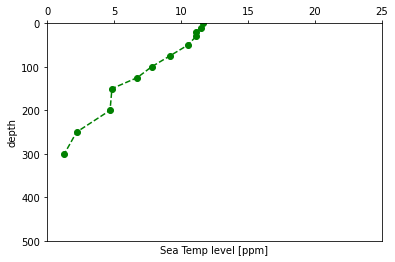

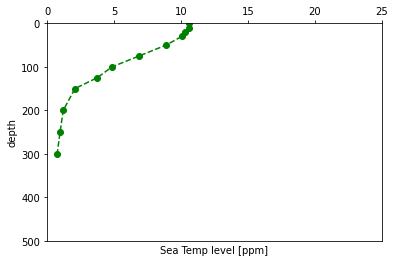

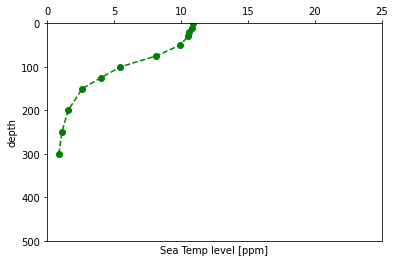

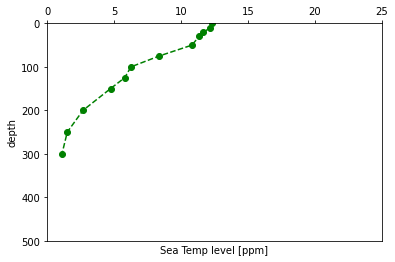

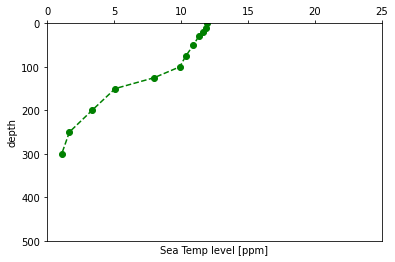

...

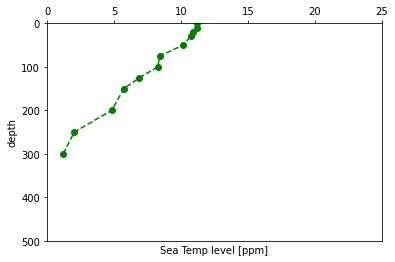

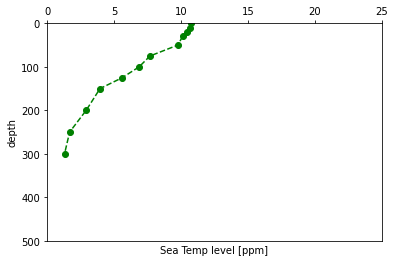

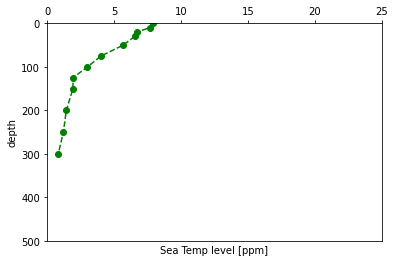

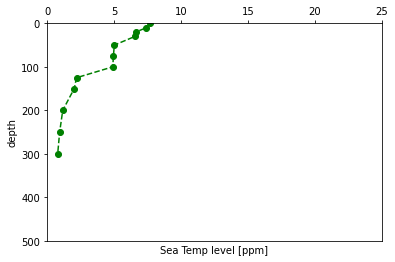

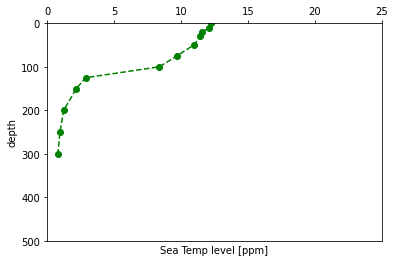

In [201]:
model_ctn_output
df=pd.DataFrame(model_ctn_output)
tmp=[]
for index, row in df.iterrows():
    tmp.append(row['0'])
    tmp.append(row['10'])
    tmp.append(row['20'])
    tmp.append(row['30'])
    tmp.append(row['50'])
    tmp.append(row['75'])
    tmp.append(row['100'])
    tmp.append(row['125'])
    tmp.append(row['150'])
    tmp.append(row['200'])
    tmp.append(row['250'])
    tmp.append(row['300'])
    Depth  = [ 0, 10,  20,  30,  50, 75, 100, 125, 150, 200, 250, 300 ]
    fig = plt.figure()
    ax = fig.add_subplot(111)
    ax.plot(tmp, Depth, 'go--')
    ax.xaxis.tick_top()
    ax.set_ylabel('depth')
    ax.set_ylim(500, 0)
    ax.set_xlim(0, 25)
    ax.set_xlabel('Sea Temp level [ppm]')
    plt.show()
    tmp=[]

[             10
34    11.487372
78    10.580083
98    10.805847
170   12.202951
172   11.854806
297   10.628419
814    8.165243
822   11.003162
908   11.331126
911   11.137735
12    11.524918
49    11.349823
93    11.852017
397   10.954734
427    8.229872
469   11.036938
747   11.445195
754   11.269113
821   11.260426
1037  11.061290
1039  10.628513
1073   9.231289
1090  11.468258
1109  11.122602
1122  10.715625
1175  11.546484
1250  10.955568
1274  10.695946
1308   8.334644
1359  10.706545
1440  10.635455
1446  10.875415
1684  12.167178
1745   9.406127
1859  10.835396
2018  10.781463
2156  10.851702
2191   9.848904
2260  10.553670
2284   9.076041
2293  11.297599
2296  11.918797
2438  11.066543
2467  10.174319
2526   9.469471
2538  10.735448
2579   8.458881
2604  11.103649
2667  10.832050
2707  12.153357
2728  10.735417
2752   8.327535
2770  11.217065
2776  10.673322
2821   7.143453
2937   9.571901
2962  12.452516
3009  10.986611
3071  10.427186
3074   8.152431
3184  10.945407
3188  1

ValueError: x and y can be no greater than 2-D, but have shapes (11, 1000, 1) and (11,)

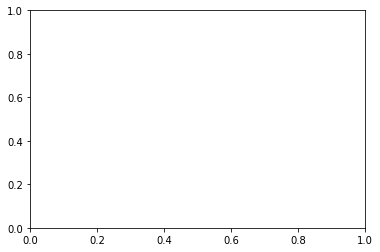

In [202]:
model_ctn_output.shape
height_list=[0,1,2,3,4]
weight_list=[0,1,2]
list=[0,1,2,3,4,5]
for case in list:
    for height in height_list:
        for weight in weight_list:
            temp_list=[]
            for depth in depth_list:
                temp=model_ctn_output[[depth]]
                temp_list.append(temp)
        
    #print(temp_list)
        print(temp_list)
        Depth  = [ 10,  20,  30,  50, 75, 100, 125, 150, 200, 250, 300 ]
        fig = plt.figure()
        ax = fig.add_subplot(111)
        ax.plot(temp_list, Depth, 'go--')
        ax.xaxis.tick_top()
        ax.set_ylabel('depth')
        ax.set_ylim(500, 0)
        ax.set_xlim(0, 25)
        ax.set_xlabel('Sea Temp level [ppm]')
        plt.show()

In [178]:
reshape_ocean_cnn_common_sst

,106-07,106-08,106-09,106-10,106-11,105-07,105-08,105-09,105-10,105-11,104-07,104-08,104-09,104-10,104-11
0,10.9800,10.5900,10.6000,10.4500,7.0500,10.6100,10.1200,10.2800,10.2800,10.3700,10.2100,10.2600,10.2200,10.2400,10.1800
1,10.9180,10.3790,10.2072,10.8102,10.7208,12.7212,12.4076,10.4041,11.5412,10.3027,14.2185,12.5851,12.6657,11.8040,12.5164
2,11.3400,11.5900,11.4300,11.8200,10.0700,11.0700,10.9300,11.5100,11.4100,11.1700,11.1800,11.2800,11.3200,11.3700,11.0500
3,6.7100,6.3100,6.3200,6.2700,7.1300,8.9500,8.3700,8.4700,8.0600,8.2600,10.0300,10.6300,11.5300,12.0500,12.9900
4,13.1314,13.4966,11.6664,10.0240,8.8743,12.0217,11.8115,11.9746,11.6184,11.3671,11.8946,12.3169,12.3392,12.1048,11.9103
5,8.2900,9.1300,8.0200,7.1200,9.2000,8.6000,8.8700,11.8900,12.0000,7.0100,9.2200,11.6300,11.9300,12.1600,11.8900
6,8.5875,9.7881,6.0956,7.4343,8.1013,10.9066,11.1304,10.4999,10.8449,10.9486,10.8104,11.1396,11.3011,11.0970,11.1666
7,10.2844,9.8335,8.0795,7.8689,10.0162,10.5308,10.5188,10.6358,9.2497,9.9518,10.3738,10.3293,8.5054,10.9376,11.5492
8,6.4600,6.9700,6.4900,6.1500,8.3600,6.7900,7.4600,8.4200,8.3200,8.1100,8.8700,10.0800,10.1400,10.4000,9.7600
9,9.5992,10.7878,10.1522,10.4576,10.3939,9.6928,10.1996,10.3856,10.3820,9.4151,10.1231,10.1733,10.0352,10.3710,9.9376


In [177]:
#from sdv.tabular import CopulaGAN
#model_upper = CopulaGAN(constraints=constraints_upper)
#model=CopulaGAN()
from sdv.tabular import CTGAN
#model_upper.fit(ocean_train_upper)
model=CTGAN()
model.fit(reshape_ocean_cnn_common_sst)
#model_upper.sample(100, max_retries=100000, conditions=conditions)
#model.sample(1000, max_retries=1000000)
model_ctn_output_sst=model.sample(1000, max_retries=1000000)

from sdv.tabular import GaussianCopula
model = GaussianCopula()
model.fit(reshape_ocean_cnn_common_ssh)
model_ctn_output_ssh= model.sample(1000, max_retries=1000000)

/home/gisuser/.conda/envs/ocean-conv2d/lib/python3.8/site-packages/sklearn/utils/validation.py:70: FutureWarning: Pass n_components=10 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
/home/gisuser/.conda/envs/ocean-conv2d/lib/python3.8/site-packages/sklearn/utils/validation.py:70: FutureWarning: Pass n_components=10 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
/home/gisuser/.conda/envs/ocean-conv2d/lib/python3.8/site-packages/sklearn/utils/validation.py:70: FutureWarning: Pass n_components=10 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
/home/gisuser/.conda/envs/ocean-conv2d/lib/python3.8

In [174]:
df = pd.DataFrame(model_ctn_output,columns=['104-07','104-08','104-09','104-10','104-11','105-07','105-08','105-09','105-10','105-11','106-07','106-08','106-09','106-10','106-11'])

In [176]:
df

,104-07,104-08,104-09,104-10,104-11,105-07,105-08,105-09,105-10,105-11,106-07,106-08,106-09,106-10,106-11
0,12.104435,12.077372,8.756845,10.266314,11.155580,14.010164,8.606480,11.700814,13.500479,7.828267,5.471073,11.803200,7.698107,5.066575,11.621518
1,10.811333,10.663783,8.883327,11.803028,10.187805,10.090512,11.333393,10.481288,9.760597,8.406991,11.513762,8.895384,7.508662,9.411784,10.480703
2,8.602235,11.763967,10.787004,10.332286,9.266581,11.321853,6.630678,9.466145,12.474520,9.716809,7.453530,11.902708,5.376337,6.074308,11.561818
3,12.820645,12.252727,10.995692,12.690221,9.901103,10.542028,9.487328,9.936004,12.160469,7.770373,8.050229,11.421856,8.621134,6.102085,13.346659
4,15.902890,11.272270,9.949032,12.230319,12.380092,11.269419,5.924204,9.311365,12.575352,11.921429,11.252926,6.694231,6.036145,6.831839,10.672029
5,9.200251,9.695514,10.003231,12.445295,11.586914,11.444085,9.960610,10.737755,10.630712,12.369542,11.121014,9.734303,6.740635,10.018120,10.948368
6,8.687610,9.521949,8.192612,11.525284,12.519004,7.004681,9.515128,11.052835,8.886282,9.931976,11.096751,5.735658,8.974048,10.949509,7.975210
7,13.320363,12.461274,11.327663,11.744514,13.464380,12.133929,10.005840,11.100409,12.888492,10.742797,7.965030,5.943492,9.666098,5.266675,7.977941
8,10.389100,11.909616,10.722569,9.672291,13.764145,10.063994,8.330940,10.777797,10.089688,9.471581,8.405077,8.291876,6.017714,8.907227,11.980270
9,9.455471,10.439368,10.511199,11.516854,10.734504,11.465889,8.525523,12.955531,8.478619,7.792825,6.558240,6.864706,4.407658,8.923389,9.892090


In [175]:
model_ctn_output

,106-07,106-08,106-09,106-10,106-11,105-07,105-08,105-09,105-10,105-11,104-07,104-08,104-09,104-10,104-11
0,5.471073,11.803200,7.698107,5.066575,11.621518,14.010164,8.606480,11.700814,13.500479,7.828267,12.104435,12.077372,8.756845,10.266314,11.155580
1,11.513762,8.895384,7.508662,9.411784,10.480703,10.090512,11.333393,10.481288,9.760597,8.406991,10.811333,10.663783,8.883327,11.803028,10.187805
2,7.453530,11.902708,5.376337,6.074308,11.561818,11.321853,6.630678,9.466145,12.474520,9.716809,8.602235,11.763967,10.787004,10.332286,9.266581
3,8.050229,11.421856,8.621134,6.102085,13.346659,10.542028,9.487328,9.936004,12.160469,7.770373,12.820645,12.252727,10.995692,12.690221,9.901103
4,11.252926,6.694231,6.036145,6.831839,10.672029,11.269419,5.924204,9.311365,12.575352,11.921429,15.902890,11.272270,9.949032,12.230319,12.380092
5,11.121014,9.734303,6.740635,10.018120,10.948368,11.444085,9.960610,10.737755,10.630712,12.369542,9.200251,9.695514,10.003231,12.445295,11.586914
6,11.096751,5.735658,8.974048,10.949509,7.975210,7.004681,9.515128,11.052835,8.886282,9.931976,8.687610,9.521949,8.192612,11.525284,12.519004
7,7.965030,5.943492,9.666098,5.266675,7.977941,12.133929,10.005840,11.100409,12.888492,10.742797,13.320363,12.461274,11.327663,11.744514,13.464380
8,8.405077,8.291876,6.017714,8.907227,11.980270,10.063994,8.330940,10.777797,10.089688,9.471581,10.389100,11.909616,10.722569,9.672291,13.764145
9,6.558240,6.864706,4.407658,8.923389,9.892090,11.465889,8.525523,12.955531,8.478619,7.792825,9.455471,10.439368,10.511199,11.516854,10.734504


In [46]:
red   = np.array([1]*9).reshape((3,3))
green = np.array([100]*9).reshape((3,3))
blue  = np.array([10000]*9).reshape((3,3))
img = np.stack([red, green, blue], axis=-1)
img = np.expand_dims(img, axis=0)

In [47]:
red
green
blue

array([[10000, 10000, 10000],
       [10000, 10000, 10000],
       [10000, 10000, 10000]])

In [48]:
img
inputs = Input((3,3,3))
conv = Conv2D(filters=1, 
              strides=1, 
              padding='valid', 
              activation='relu',
              kernel_size=2, 
              kernel_initializer='ones', 
              bias_initializer='zeros', )(inputs)
model = Model(inputs,conv)
img

array([[[[    1,   100, 10000],
         [    1,   100, 10000],
         [    1,   100, 10000]],

        [[    1,   100, 10000],
         [    1,   100, 10000],
         [    1,   100, 10000]],

        [[    1,   100, 10000],
         [    1,   100, 10000],
         [    1,   100, 10000]]]])

In [49]:
import os
os.environ['CUDA_VISIBLE_DEVICES']='1'

In [133]:
#import tensorflow as tf
#tf.config.experimental.set_memory_growth(tf.config.list_physical_devices('GPU')[0], True)

In [134]:
import tensorflow as tf
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)

2 Physical GPUs, 2 Logical GPUs


In [135]:
import tensorflow as tf
from tensorflow.keras import datasets, layers, models

gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
    except RuntimeError as e:
         print(e)

In [50]:
model.predict(img)
# array([[[[40404.],
#          [40404.]],

#         [[40404.],
#          [40404.]]]], dtype=float32)

array([[[[40404.],
         [40404.]],

        [[40404.],
         [40404.]]]], dtype=float32)

In [51]:
model.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 3, 3, 3)]         0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 2, 2, 1)           13        
Total params: 13
Trainable params: 13
Non-trainable params: 0
_________________________________________________________________


In [52]:
a = np.array([[1, 2, 3],[6,7,8],[9,10,11]])
b = np.array([[2, 3, 4],[11,12,13],[15,16,17]])
np.stack((a, b),axis=-1)

array([[[ 1,  2],
        [ 2,  3],
        [ 3,  4]],

       [[ 6, 11],
        [ 7, 12],
        [ 8, 13]],

       [[ 9, 15],
        [10, 16],
        [11, 17]]])

In [53]:
reshape_sst=reshape_ocean_cnn_sst_array.reshape(11,3,5)
reshape_ssh=reshape_ocean_cnn_ssh_array.reshape(11,3,5)
reshape_sub_10=reshape_ocean_cnn_sub_10_array.reshape(11,3,5)
reshape_sub_250=reshape_ocean_cnn_sub_250_array.reshape(11,3,5)
img_profile = np.stack([reshape_sst, reshape_ssh], axis=-1)
#img_profile= np.expand_dims(img, axis=0)

In [92]:
for depth in depth_list:
    globals()['reshape_ocean_cnn_sub_'+str(depth)+'_array']=globals()['reshape_ocean_cnn_common_sub_'+str(depth)].to_numpy()
    globals()['reshape_ocean_cnn_sub_'+str(10)+'_array'].shape
    globals()['reshape_sub_'+str(depth)]=globals()['reshape_ocean_cnn_sub_'+str(depth)+'_array'].reshape(11,3,5)

In [93]:
img_profile.shape
img_profile

array([[[[10.98  ,  0.97  ],
         [10.59  ,  1.11  ],
         [10.6   ,  1.63  ],
         [10.45  ,  1.24  ],
         [ 7.05  ,  0.89  ]],

        [[10.61  ,  1.47  ],
         [10.12  ,  1.9   ],
         [10.28  ,  2.25  ],
         [10.28  ,  3.15  ],
         [10.37  ,  1.78  ]],

        [[10.21  ,  1.34  ],
         [10.26  ,  2.45  ],
         [10.22  ,  5.24  ],
         [10.24  ,  5.2   ],
         [10.18  ,  3.35  ]]],


       [[[10.918 ,  1.4794],
         [10.379 ,  1.241 ],
         [10.2072,  1.0209],
         [10.8102,  0.948 ],
         [10.7208,  0.9266]],

        [[12.7212,  1.0356],
         [12.4076,  1.0756],
         [10.4041,  0.9411],
         [11.5412,  0.9038],
         [10.3027,  0.9343]],

        [[14.2185,  0.9485],
         [12.5851,  1.0609],
         [12.6657,  1.2495],
         [11.804 ,  0.9788],
         [12.5164,  1.0281]]],


       [[[11.34  ,  1.02  ],
         [11.59  ,  1.25  ],
         [11.43  ,  1.21  ],
         [11.82  ,  1.13  ]

In [94]:
inputs = Input((3,5,2))
conv = Conv2D(filters=1, 
              strides=1, 
              padding='same', 
              activation='relu',
              kernel_size=2, 
              kernel_initializer='ones', 
              bias_initializer='zeros', )(inputs)
model = Model(inputs,conv)
model.compile (optimizer='adam',loss='mse')

In [95]:
model.predict(img_profile)

array([[[[47.750004],
         [48.480003],
         [49.88    ],
         [45.21    ],
         [20.09    ]],

        [[48.36    ],
         [52.72    ],
         [56.859997],
         [54.55    ],
         [25.68    ]],

        [[24.260002],
         [28.17    ],
         [30.899998],
         [28.97    ],
         [13.530001]]],


       [[[51.2574  ],
         [47.676506],
         [46.776505],
         [47.087605],
         [22.8844  ]],

        [[56.052998],
         [52.389603],
         [50.488205],
         [50.0093  ],
         [24.781498]],

        [[28.813   ],
         [27.561201],
         [26.698   ],
         [26.327301],
         [13.5445  ]]],


       [[[49.37    ],
         [50.369995],
         [51.11    ],
         [49.27    ],
         [23.59    ]],

        [[50.69    ],
         [52.26    ],
         [52.539993],
         [51.34    ],
         [25.070002]],

        [[26.52    ],
         [27.369999],
         [27.019999],
         [26.1     ],
         [12

In [96]:
model.summary()

Model: "model_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_12 (InputLayer)        [(None, 3, 5, 2)]         0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 3, 5, 1)           9         
Total params: 9
Trainable params: 9
Non-trainable params: 0
_________________________________________________________________


In [97]:
import tensorflow as tf
tf.config.list_physical_devices(
device_type=None)

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'),
 PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU'),
 PhysicalDevice(name='/physical_device:GPU:1', device_type='GPU')]

In [98]:
import tensorflow as tf 
from tensorflow.python.client import device_lib
device_lib.list_local_devices() 

[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 5565294781941334292,
 name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 23394648064
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 11132616049606055584
 physical_device_desc: "device: 0, name: GeForce RTX 3090, pci bus id: 0000:17:00.0, compute capability: 8.6",
 name: "/device:GPU:1"
 device_type: "GPU"
 memory_limit: 23385997312
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 5706588712314902484
 physical_device_desc: "device: 1, name: GeForce RTX 3090, pci bus id: 0000:65:00.0, compute capability: 8.6"]

In [60]:
import tensorflow as tf 
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

Num GPUs Available:  2


In [73]:
import tensorflow as tf
print("GPUs: ", len(tf.config.experimental.list_physical_devices('GPU')))
model.fit(img_profile,reshape_sub_10,epochs=7000,verbose=1)

GPUs:  2
Epoch 1/7000
1/1 [==============================] - 0s 4ms/step - loss: 62.9349
Epoch 2/7000
1/1 [==============================] - 0s 4ms/step - loss: 62.4240
Epoch 3/7000
1/1 [==============================] - 0s 3ms/step - loss: 61.4982
Epoch 4/7000
1/1 [==============================] - 0s 4ms/step - loss: 60.2413
Epoch 5/7000
1/1 [==============================] - 0s 4ms/step - loss: 58.7253
Epoch 6/7000
1/1 [==============================] - 0s 4ms/step - loss: 57.0116
Epoch 7/7000
1/1 [==============================] - 0s 4ms/step - loss: 55.1525
Epoch 8/7000
1/1 [==============================] - 0s 3ms/step - loss: 53.1917
Epoch 9/7000
1/1 [==============================] - 0s 4ms/step - loss: 51.1662
Epoch 10/7000
1/1 [==============================] - 0s 4ms/step - loss: 49.1065
Epoch 11/7000
1/1 [==============================] - 0s 4ms/step - loss: 47.0381
Epoch 12/7000
1/1 [==============================] - 0s 4ms/step - loss: 44.9818
Epoch 13/7000
1/1 [=========

1/1 [==============================] - 0s 5ms/step - loss: 5.6296
Epoch 204/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6148
Epoch 205/7000
1/1 [==============================] - 0s 6ms/step - loss: 5.6001
Epoch 206/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5855
Epoch 207/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5709
Epoch 208/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5563
Epoch 209/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5419
Epoch 210/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5275
Epoch 211/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5131
Epoch 212/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4989
Epoch 213/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4847
Epoch 214/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4705
Epoch 215/7000
1/1 [=======================

1/1 [==============================] - 0s 4ms/step - loss: 3.5602
Epoch 406/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5531
Epoch 407/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5461
Epoch 408/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5390
Epoch 409/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.5320
Epoch 410/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.5251
Epoch 411/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5181
Epoch 412/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.5112
Epoch 413/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5042
Epoch 414/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4973
Epoch 415/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4905
Epoch 416/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4836
Epoch 417/7000
1/1 [=======================

1/1 [==============================] - 0s 4ms/step - loss: 2.4671
Epoch 608/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4629
Epoch 609/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.4588
Epoch 610/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.4547
Epoch 611/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4506
Epoch 612/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.4465
Epoch 613/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.4424
Epoch 614/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.4384
Epoch 615/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4343
Epoch 616/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4302
Epoch 617/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4262
Epoch 618/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.4222
Epoch 619/7000
1/1 [=======================

1/1 [==============================] - 0s 4ms/step - loss: 1.7933
Epoch 810/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7906
Epoch 811/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7879
Epoch 812/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7853
Epoch 813/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7826
Epoch 814/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7799
Epoch 815/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7773
Epoch 816/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7746
Epoch 817/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7720
Epoch 818/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7694
Epoch 819/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7667
Epoch 820/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7641
Epoch 821/7000
1/1 [=======================

1/1 [==============================] - 0s 5ms/step - loss: 1.3424
Epoch 1012/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3406
Epoch 1013/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3387
Epoch 1014/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3369
Epoch 1015/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3350
Epoch 1016/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3332
Epoch 1017/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3314
Epoch 1018/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3295
Epoch 1019/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3277
Epoch 1020/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3259
Epoch 1021/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3241
Epoch 1022/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3222
Epoch 1023/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.1719
Epoch 1112/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1703
Epoch 1113/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1687
Epoch 1114/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1672
Epoch 1115/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1656
Epoch 1116/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1641
Epoch 1117/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1625
Epoch 1118/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1609
Epoch 1119/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1594
Epoch 1120/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1578
Epoch 1121/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1563
Epoch 1122/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1548
Epoch 1123/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.0267
Epoch 1212/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0253
Epoch 1213/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0240
Epoch 1214/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0227
Epoch 1215/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0213
Epoch 1216/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0200
Epoch 1217/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0187
Epoch 1218/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0173
Epoch 1219/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0160
Epoch 1220/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0147
Epoch 1221/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0134
Epoch 1222/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0120
Epoch 1223/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.9020
Epoch 1312/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9009
Epoch 1313/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8997
Epoch 1314/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8986
Epoch 1315/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8974
Epoch 1316/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8963
Epoch 1317/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8951
Epoch 1318/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8940
Epoch 1319/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8928
Epoch 1320/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8917
Epoch 1321/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8905
Epoch 1322/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8894
Epoch 1323/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.7943
Epoch 1412/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7933
Epoch 1413/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7923
Epoch 1414/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7913
Epoch 1415/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7903
Epoch 1416/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7893
Epoch 1417/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7883
Epoch 1418/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7873
Epoch 1419/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7863
Epoch 1420/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7853
Epoch 1421/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7843
Epoch 1422/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7833
Epoch 1423/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.7006
Epoch 1512/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6998
Epoch 1513/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6989
Epoch 1514/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6980
Epoch 1515/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6971
Epoch 1516/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6963
Epoch 1517/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6954
Epoch 1518/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6945
Epoch 1519/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6937
Epoch 1520/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6928
Epoch 1521/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6920
Epoch 1522/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6911
Epoch 1523/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.6190
Epoch 1612/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6182
Epoch 1613/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6174
Epoch 1614/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6167
Epoch 1615/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6159
Epoch 1616/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6152
Epoch 1617/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6144
Epoch 1618/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6137
Epoch 1619/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6129
Epoch 1620/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6121
Epoch 1621/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6114
Epoch 1622/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6106
Epoch 1623/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.5475
Epoch 1712/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5469
Epoch 1713/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5462
Epoch 1714/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5455
Epoch 1715/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5449
Epoch 1716/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5442
Epoch 1717/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5436
Epoch 1718/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5429
Epoch 1719/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5422
Epoch 1720/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5416
Epoch 1721/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5409
Epoch 1722/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5402
Epoch 1723/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.4850
Epoch 1812/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4844
Epoch 1813/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4838
Epoch 1814/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4832
Epoch 1815/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4826
Epoch 1816/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4820
Epoch 1817/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4815
Epoch 1818/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4809
Epoch 1819/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4803
Epoch 1820/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4797
Epoch 1821/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4791
Epoch 1822/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4786
Epoch 1823/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.4301
Epoch 1912/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4295
Epoch 1913/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4290
Epoch 1914/7000
1/1 [==============================] - 0s 6ms/step - loss: 0.4285
Epoch 1915/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4280
Epoch 1916/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4275
Epoch 1917/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4270
Epoch 1918/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4265
Epoch 1919/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4260
Epoch 1920/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4255
Epoch 1921/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4250
Epoch 1922/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4244
Epoch 1923/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.3819
Epoch 2012/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3814
Epoch 2013/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3810
Epoch 2014/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3805
Epoch 2015/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3801
Epoch 2016/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3796
Epoch 2017/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3792
Epoch 2018/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3787
Epoch 2019/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3783
Epoch 2020/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3778
Epoch 2021/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3774
Epoch 2022/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3769
Epoch 2023/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.3396
Epoch 2112/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3392
Epoch 2113/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3388
Epoch 2114/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3384
Epoch 2115/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3380
Epoch 2116/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3376
Epoch 2117/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3372
Epoch 2118/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3368
Epoch 2119/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3364
Epoch 2120/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3360
Epoch 2121/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3356
Epoch 2122/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3352
Epoch 2123/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.3024
Epoch 2212/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3020
Epoch 2213/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3017
Epoch 2214/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3014
Epoch 2215/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3010
Epoch 2216/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3007
Epoch 2217/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3003
Epoch 2218/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3000
Epoch 2219/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2996
Epoch 2220/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2993
Epoch 2221/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2989
Epoch 2222/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2986
Epoch 2223/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.2698
Epoch 2312/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2695
Epoch 2313/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2692
Epoch 2314/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2689
Epoch 2315/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2686
Epoch 2316/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2682
Epoch 2317/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2679
Epoch 2318/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2676
Epoch 2319/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2673
Epoch 2320/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2670
Epoch 2321/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2667
Epoch 2322/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2664
Epoch 2323/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.2411
Epoch 2412/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2409
Epoch 2413/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2406
Epoch 2414/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2403
Epoch 2415/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2401
Epoch 2416/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2398
Epoch 2417/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2395
Epoch 2418/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2393
Epoch 2419/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2390
Epoch 2420/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2387
Epoch 2421/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2385
Epoch 2422/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2382
Epoch 2423/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.2160
Epoch 2512/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2158
Epoch 2513/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2156
Epoch 2514/7000
1/1 [==============================] - 0s 6ms/step - loss: 0.2153
Epoch 2515/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2151
Epoch 2516/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2149
Epoch 2517/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2146
Epoch 2518/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2144
Epoch 2519/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2142
Epoch 2520/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2139
Epoch 2521/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2137
Epoch 2522/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2135
Epoch 2523/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.1940
Epoch 2612/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1938
Epoch 2613/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1936
Epoch 2614/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1934
Epoch 2615/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1932
Epoch 2616/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1930
Epoch 2617/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1928
Epoch 2618/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1926
Epoch 2619/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1924
Epoch 2620/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1922
Epoch 2621/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1920
Epoch 2622/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1918
Epoch 2623/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.1747
Epoch 2712/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1745
Epoch 2713/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1744
Epoch 2714/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1742
Epoch 2715/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1740
Epoch 2716/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1738
Epoch 2717/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1736
Epoch 2718/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1735
Epoch 2719/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1733
Epoch 2720/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1731
Epoch 2721/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1729
Epoch 2722/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1727
Epoch 2723/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.1432
Epoch 2911/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1431
Epoch 2912/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1429
Epoch 2913/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1428
Epoch 2914/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1427
Epoch 2915/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1425
Epoch 2916/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1424
Epoch 2917/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1422
Epoch 2918/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1421
Epoch 2919/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1420
Epoch 2920/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1418
Epoch 2921/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1417
Epoch 2922/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.1303
Epoch 3011/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1301
Epoch 3012/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1300
Epoch 3013/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1299
Epoch 3014/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1298
Epoch 3015/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1297
Epoch 3016/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1295
Epoch 3017/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1294
Epoch 3018/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1293
Epoch 3019/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1292
Epoch 3020/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1291
Epoch 3021/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1289
Epoch 3022/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.1190
Epoch 3111/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1189
Epoch 3112/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1188
Epoch 3113/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1186
Epoch 3114/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1185
Epoch 3115/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1184
Epoch 3116/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1183
Epoch 3117/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1182
Epoch 3118/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1181
Epoch 3119/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1180
Epoch 3120/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1179
Epoch 3121/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1178
Epoch 3122/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.1091
Epoch 3211/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1090
Epoch 3212/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1089
Epoch 3213/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1088
Epoch 3214/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1087
Epoch 3215/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1086
Epoch 3216/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1085
Epoch 3217/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1084
Epoch 3218/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1083
Epoch 3219/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1083
Epoch 3220/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1082
Epoch 3221/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1081
Epoch 3222/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.1004
Epoch 3311/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1004
Epoch 3312/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1003
Epoch 3313/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1002
Epoch 3314/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1001
Epoch 3315/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1000
Epoch 3316/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1000
Epoch 3317/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0999
Epoch 3318/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0998
Epoch 3319/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0997
Epoch 3320/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0996
Epoch 3321/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0996
Epoch 3322/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0929
Epoch 3411/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0928
Epoch 3412/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0927
Epoch 3413/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0927
Epoch 3414/7000
1/1 [==============================] - ETA: 0s - loss: 0.092 - 0s 5ms/step - loss: 0.0926
Epoch 3415/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0925
Epoch 3416/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0924
Epoch 3417/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0924
Epoch 3418/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0923
Epoch 3419/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0922
Epoch 3420/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0922
Epoch 3421/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0921
Epoch 34

1/1 [==============================] - 0s 5ms/step - loss: 0.0805
Epoch 3610/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0805
Epoch 3611/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0804
Epoch 3612/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0803
Epoch 3613/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0803
Epoch 3614/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0802
Epoch 3615/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0802
Epoch 3616/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0801
Epoch 3617/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0801
Epoch 3618/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0800
Epoch 3619/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0800
Epoch 3620/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0799
Epoch 3621/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0754
Epoch 3710/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0754
Epoch 3711/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0753
Epoch 3712/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0753
Epoch 3713/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0752
Epoch 3714/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0752
Epoch 3715/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0751
Epoch 3716/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0751
Epoch 3717/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0750
Epoch 3718/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0750
Epoch 3719/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0749
Epoch 3720/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0749
Epoch 3721/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0670
Epoch 3909/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0670
Epoch 3910/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0670
Epoch 3911/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0669
Epoch 3912/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0669
Epoch 3913/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0669
Epoch 3914/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0668
Epoch 3915/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0668
Epoch 3916/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0668
Epoch 3917/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0667
Epoch 3918/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0667
Epoch 3919/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0666
Epoch 3920/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0636
Epoch 4009/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0636
Epoch 4010/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0635
Epoch 4011/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0635
Epoch 4012/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0635
Epoch 4013/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0634
Epoch 4014/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0634
Epoch 4015/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0634
Epoch 4016/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0633
Epoch 4017/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0633
Epoch 4018/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0633
Epoch 4019/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0632
Epoch 4020/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.0579
Epoch 4208/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0579
Epoch 4209/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0578
Epoch 4210/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0578
Epoch 4211/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0578
Epoch 4212/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0578
Epoch 4213/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0577
Epoch 4214/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0577
Epoch 4215/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0577
Epoch 4216/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0577
Epoch 4217/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0576
Epoch 4218/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0576
Epoch 4219/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0555
Epoch 4308/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0555
Epoch 4309/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0555
Epoch 4310/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0555
Epoch 4311/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0554
Epoch 4312/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0554
Epoch 4313/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0554
Epoch 4314/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0554
Epoch 4315/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0554
Epoch 4316/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0553
Epoch 4317/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0553
Epoch 4318/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0553
Epoch 4319/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.0517
Epoch 4507/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0516
Epoch 4508/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0516
Epoch 4509/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0516
Epoch 4510/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0516
Epoch 4511/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0516
Epoch 4512/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0516
Epoch 4513/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0515
Epoch 4514/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0515
Epoch 4515/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0515
Epoch 4516/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0515
Epoch 4517/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0515
Epoch 4518/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0501
Epoch 4607/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0501
Epoch 4608/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0500
Epoch 4609/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0500
Epoch 4610/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0500
Epoch 4611/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0500
Epoch 4612/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0500
Epoch 4613/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0500
Epoch 4614/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0500
Epoch 4615/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0499
Epoch 4616/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0499
Epoch 4617/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0499
Epoch 4618/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.0487
Epoch 4707/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0487
Epoch 4708/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0487
Epoch 4709/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0486
Epoch 4710/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0486
Epoch 4711/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0486
Epoch 4712/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0486
Epoch 4713/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0486
Epoch 4714/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0486
Epoch 4715/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0486
Epoch 4716/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0486
Epoch 4717/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0485
Epoch 4718/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0475
Epoch 4807/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0475
Epoch 4808/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0474
Epoch 4809/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0474
Epoch 4810/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0474
Epoch 4811/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0474
Epoch 4812/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0474
Epoch 4813/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0474
Epoch 4814/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0474
Epoch 4815/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0474
Epoch 4816/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0474
Epoch 4817/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0473
Epoch 4818/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.0464
Epoch 4907/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0464
Epoch 4908/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0464
Epoch 4909/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0464
Epoch 4910/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0464
Epoch 4911/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0464
Epoch 4912/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0464
Epoch 4913/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0463
Epoch 4914/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0463
Epoch 4915/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0463
Epoch 4916/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0463
Epoch 4917/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0463
Epoch 4918/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.0455
Epoch 5007/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0455
Epoch 5008/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0455
Epoch 5009/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0455
Epoch 5010/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0455
Epoch 5011/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0455
Epoch 5012/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0455
Epoch 5013/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0454
Epoch 5014/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0454
Epoch 5015/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0454
Epoch 5016/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0454
Epoch 5017/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0454
Epoch 5018/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0447
Epoch 5107/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0447
Epoch 5108/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0447
Epoch 5109/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0447
Epoch 5110/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0447
Epoch 5111/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0447
Epoch 5112/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0447
Epoch 5113/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0447
Epoch 5114/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0447
Epoch 5115/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0447
Epoch 5116/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0446
Epoch 5117/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0446
Epoch 5118/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0440
Epoch 5207/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0440
Epoch 5208/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0440
Epoch 5209/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0440
Epoch 5210/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0440
Epoch 5211/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0440
Epoch 5212/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0440
Epoch 5213/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0440
Epoch 5214/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0440
Epoch 5215/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0440
Epoch 5216/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0440
Epoch 5217/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0440
Epoch 5218/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0435
Epoch 5307/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0435
Epoch 5308/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0435
Epoch 5309/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0435
Epoch 5310/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0434
Epoch 5311/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0434
Epoch 5312/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0434
Epoch 5313/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0434
Epoch 5314/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0434
Epoch 5315/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0434
Epoch 5316/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0434
Epoch 5317/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0434
Epoch 5318/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.0430
Epoch 5407/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0430
Epoch 5408/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0430
Epoch 5409/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0430
Epoch 5410/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0430
Epoch 5411/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0430
Epoch 5412/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0430
Epoch 5413/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0430
Epoch 5414/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0429
Epoch 5415/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0429
Epoch 5416/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0429
Epoch 5417/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0429
Epoch 5418/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.0426
Epoch 5507/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0426
Epoch 5508/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0426
Epoch 5509/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0426
Epoch 5510/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0426
Epoch 5511/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0426
Epoch 5512/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0426
Epoch 5513/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0426
Epoch 5514/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0425
Epoch 5515/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0425
Epoch 5516/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0425
Epoch 5517/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0425
Epoch 5518/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0422
Epoch 5607/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0422
Epoch 5608/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0422
Epoch 5609/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0422
Epoch 5610/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0422
Epoch 5611/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0422
Epoch 5612/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0422
Epoch 5613/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0422
Epoch 5614/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0422
Epoch 5615/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0422
Epoch 5616/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0422
Epoch 5617/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0422
Epoch 5618/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0420
Epoch 5707/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0420
Epoch 5708/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0420
Epoch 5709/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0419
Epoch 5710/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0419
Epoch 5711/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0419
Epoch 5712/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0419
Epoch 5713/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0419
Epoch 5714/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0419
Epoch 5715/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0419
Epoch 5716/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0419
Epoch 5717/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0419
Epoch 5718/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0417
Epoch 5807/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0417
Epoch 5808/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0417
Epoch 5809/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0417
Epoch 5810/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0417
Epoch 5811/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0417
Epoch 5812/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0417
Epoch 5813/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0417
Epoch 5814/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0417
Epoch 5815/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0417
Epoch 5816/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0417
Epoch 5817/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0417
Epoch 5818/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0415
Epoch 5907/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0415
Epoch 5908/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0415
Epoch 5909/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0415
Epoch 5910/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0415
Epoch 5911/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0415
Epoch 5912/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0415
Epoch 5913/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0415
Epoch 5914/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0415
Epoch 5915/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0415
Epoch 5916/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0415
Epoch 5917/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0415
Epoch 5918/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.0414
Epoch 6007/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0414
Epoch 6008/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0414
Epoch 6009/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0414
Epoch 6010/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0414
Epoch 6011/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0414
Epoch 6012/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0414
Epoch 6013/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0414
Epoch 6014/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0414
Epoch 6015/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0414
Epoch 6016/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0414
Epoch 6017/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0414
Epoch 6018/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0413
Epoch 6107/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0413
Epoch 6108/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0413
Epoch 6109/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0413
Epoch 6110/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0413
Epoch 6111/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0413
Epoch 6112/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0413
Epoch 6113/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0413
Epoch 6114/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0413
Epoch 6115/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0413
Epoch 6116/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0413
Epoch 6117/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0413
Epoch 6118/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0412
Epoch 6207/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0412
Epoch 6208/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0412
Epoch 6209/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0412
Epoch 6210/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0412
Epoch 6211/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0412
Epoch 6212/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0412
Epoch 6213/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0412
Epoch 6214/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0412
Epoch 6215/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0412
Epoch 6216/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0412
Epoch 6217/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0412
Epoch 6218/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0411
Epoch 6307/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0411
Epoch 6308/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0411
Epoch 6309/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0411
Epoch 6310/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0411
Epoch 6311/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0411
Epoch 6312/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0411
Epoch 6313/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0411
Epoch 6314/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0411
Epoch 6315/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0411
Epoch 6316/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0411
Epoch 6317/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0411
Epoch 6318/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.0410
Epoch 6407/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0410
Epoch 6408/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0410
Epoch 6409/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0410
Epoch 6410/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0410
Epoch 6411/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0410
Epoch 6412/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0410
Epoch 6413/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0410
Epoch 6414/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0410
Epoch 6415/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0410
Epoch 6416/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0410
Epoch 6417/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0410
Epoch 6418/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0410
Epoch 6606/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0410
Epoch 6607/7000
1/1 [==============================] - 0s 6ms/step - loss: 0.0410
Epoch 6608/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0410
Epoch 6609/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0410
Epoch 6610/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6611/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6612/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6613/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6614/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6615/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6616/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0409
Epoch 6617/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6706/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6707/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6708/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0409
Epoch 6709/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6710/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0409
Epoch 6711/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0409
Epoch 6712/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6713/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6714/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6715/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0409
Epoch 6716/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6717/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6806/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6807/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6808/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6809/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6810/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6811/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6812/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0409
Epoch 6813/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6814/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6815/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6816/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6817/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6906/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0409
Epoch 6907/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6908/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6909/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6910/7000
1/1 [==============================] - 0s 6ms/step - loss: 0.0409
Epoch 6911/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0409
Epoch 6912/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0409
Epoch 6913/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6914/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0409
Epoch 6915/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0409
Epoch 6916/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0409
Epoch 6917/7000
1/1 [===========

In [74]:
predicted_value=model.predict(img_profile)

In [75]:
reshape_sub_10.shape

(11, 3, 5)

In [76]:
reshape_sub_10

array([[[10.99  , 10.59  , 10.56  , 10.45  ,  6.97  ],
        [10.67  , 10.09  , 10.28  , 10.3   , 10.36  ],
        [10.2   , 10.26  , 10.23  , 10.25  , 10.22  ]],

       [[10.9264, 10.3863, 10.2071, 10.8507,  9.0564],
        [12.7233, 12.39  , 10.4058, 11.5394, 10.306 ],
        [14.076 , 12.5803, 12.6735, 10.7522, 12.5111]],

       [[11.34  , 11.59  , 11.43  , 11.82  , 10.06  ],
        [11.07  , 10.94  , 11.52  , 11.42  , 11.17  ],
        [11.18  , 11.29  , 11.32  , 11.38  , 11.05  ]],

       [[ 6.72  ,  6.31  ,  6.32  ,  6.27  ,  7.17  ],
        [ 8.94  ,  8.37  ,  8.47  ,  8.04  ,  8.28  ],
        [ 9.89  , 10.61  , 11.34  , 12.07  , 12.99  ]],

       [[13.1251, 13.4922, 11.68  ,  9.9682,  8.7968],
        [12.0326, 11.8136, 11.9767, 11.6038, 11.3681],
        [11.9003, 12.3213, 12.3105, 12.1152, 11.9061]],

       [[ 8.22  ,  9.14  ,  8.11  ,  7.1   ,  8.91  ],
        [ 8.37  ,  8.59  , 11.3   , 12.    ,  7.01  ],
        [ 8.35  , 10.9   , 11.92  , 12.15  , 11.86  ]],

In [77]:
predicted_value.shape

(11, 3, 5, 1)

In [78]:
predicted_value

array([[[[10.940388 ],
         [10.573507 ],
         [10.568863 ],
         [10.467418 ],
         [ 6.9976373]],

        [[10.601797 ],
         [10.106085 ],
         [10.332574 ],
         [10.308684 ],
         [10.3506775]],

        [[10.16711  ],
         [10.322709 ],
         [10.300549 ],
         [10.256509 ],
         [10.180822 ]]],


       [[[10.907105 ],
         [10.341427 ],
         [10.178633 ],
         [10.763682 ],
         [10.668564 ]],

        [[12.677231 ],
         [12.388632 ],
         [10.360662 ],
         [11.523268 ],
         [10.240239 ]],

        [[14.108294 ],
         [12.477306 ],
         [12.559657 ],
         [11.6876545],
         [12.506732 ]]],


       [[[11.304245 ],
         [11.564429 ],
         [11.3936405],
         [11.797648 ],
         [10.017274 ]],

        [[11.03096  ],
         [10.90697  ],
         [11.48686  ],
         [11.393806 ],
         [11.124786 ]],

        [[11.1344185],
         [11.226665 ],
         [11.2

In [103]:
inputs = Input((3,5,2))
conv = Conv2D(filters=1, 
              strides=1, 
              padding='same', 
              activation='relu',
              kernel_size=2, 
              kernel_initializer='ones', 
              bias_initializer='zeros', )(inputs)
model = Model(inputs,conv)
model.compile (optimizer='adam',loss='mse')

In [104]:
from tensorflow.python.client import device_lib
device_lib.list_local_devices()

[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 1056322569986804643,
 name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 23394648064
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 15976407044904730667
 physical_device_desc: "device: 0, name: GeForce RTX 3090, pci bus id: 0000:17:00.0, compute capability: 8.6",
 name: "/device:GPU:1"
 device_type: "GPU"
 memory_limit: 23385997312
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 3768177473930234876
 physical_device_desc: "device: 1, name: GeForce RTX 3090, pci bus id: 0000:65:00.0, compute capability: 8.6"]

In [105]:
import tensorflow as tf
print("GPUs: ", len(tf.config.experimental.list_physical_devices('GPU')))

depth_list=['10','20','30','50','75','100','125','150','200','250','300']
for depth in depth_list:
    inputs = Input((3,5,2))
    conv = Conv2D(filters=1, 
                  strides=1, 
                  padding='same', 
                  activation='relu',
                  kernel_size=2, 
                  kernel_initializer='ones', 
                  bias_initializer='zeros', )(inputs)
    model = Model(inputs,conv)
    model.compile (optimizer='adam',loss='mse')
    train_y=globals()['reshape_sub_'+str(depth)]
    print(train_y)
    model.fit(img_profile,train_y,epochs=7000,verbose=1)
    globals()['predicted_value'+str(depth)]=model.predict(img_profile)


GPUs:  2
[[[10.99   10.59   10.56   10.45    6.97  ]
  [10.67   10.09   10.28   10.3    10.36  ]
  [10.2    10.26   10.23   10.25   10.22  ]]

 [[10.9264 10.3863 10.2071 10.8507  9.0564]
  [12.7233 12.39   10.4058 11.5394 10.306 ]
  [14.076  12.5803 12.6735 10.7522 12.5111]]

 [[11.34   11.59   11.43   11.82   10.06  ]
  [11.07   10.94   11.52   11.42   11.17  ]
  [11.18   11.29   11.32   11.38   11.05  ]]

 [[ 6.72    6.31    6.32    6.27    7.17  ]
  [ 8.94    8.37    8.47    8.04    8.28  ]
  [ 9.89   10.61   11.34   12.07   12.99  ]]

 [[13.1251 13.4922 11.68    9.9682  8.7968]
  [12.0326 11.8136 11.9767 11.6038 11.3681]
  [11.9003 12.3213 12.3105 12.1152 11.9061]]

 [[ 8.22    9.14    8.11    7.1     8.91  ]
  [ 8.37    8.59   11.3    12.      7.01  ]
  [ 8.35   10.9    11.92   12.15   11.86  ]]

 [[ 8.577   9.7702  6.0959  7.4801  8.1187]
  [10.9039 11.1375 10.5026 10.8321 10.9463]
  [10.8129 11.1419 11.3026 11.0954 11.1655]]

 [[10.2844  9.8374  7.942   7.8732 10.0159]
  [10.438

1/1 [==============================] - 0s 4ms/step - loss: 505.6041
Epoch 182/7000
1/1 [==============================] - 0s 4ms/step - loss: 504.0609
Epoch 183/7000
1/1 [==============================] - 0s 4ms/step - loss: 502.5212
Epoch 184/7000
1/1 [==============================] - 0s 4ms/step - loss: 500.9854
Epoch 185/7000
1/1 [==============================] - 0s 4ms/step - loss: 499.4531
Epoch 186/7000
1/1 [==============================] - 0s 4ms/step - loss: 497.9246
Epoch 187/7000
1/1 [==============================] - 0s 5ms/step - loss: 496.3999
Epoch 188/7000
1/1 [==============================] - 0s 5ms/step - loss: 494.8788
Epoch 189/7000
1/1 [==============================] - 0s 5ms/step - loss: 493.3613
Epoch 190/7000
1/1 [==============================] - 0s 5ms/step - loss: 491.8476
Epoch 191/7000
1/1 [==============================] - 0s 4ms/step - loss: 490.3376
Epoch 192/7000
1/1 [==============================] - 0s 5ms/step - loss: 488.8312
Epoch 193/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 267.3148
Epoch 378/7000
1/1 [==============================] - 0s 6ms/step - loss: 266.3947
Epoch 379/7000
1/1 [==============================] - 0s 5ms/step - loss: 265.4772
Epoch 380/7000
1/1 [==============================] - 0s 4ms/step - loss: 264.5625
Epoch 381/7000
1/1 [==============================] - 0s 5ms/step - loss: 263.6503
Epoch 382/7000
1/1 [==============================] - 0s 5ms/step - loss: 262.7408
Epoch 383/7000
1/1 [==============================] - 0s 5ms/step - loss: 261.8339
Epoch 384/7000
1/1 [==============================] - 0s 5ms/step - loss: 260.9296
Epoch 385/7000
1/1 [==============================] - 0s 5ms/step - loss: 260.0280
Epoch 386/7000
1/1 [==============================] - 0s 5ms/step - loss: 259.1289
Epoch 387/7000
1/1 [==============================] - 0s 4ms/step - loss: 258.2324
Epoch 388/7000
1/1 [==============================] - 0s 4ms/step - loss: 257.3386
Epoch 389/7000
1/1 

1/1 [==============================] - 0s 5ms/step - loss: 131.4076
Epoch 574/7000
1/1 [==============================] - 0s 5ms/step - loss: 130.9123
Epoch 575/7000
1/1 [==============================] - 0s 4ms/step - loss: 130.4187
Epoch 576/7000
1/1 [==============================] - 0s 4ms/step - loss: 129.9268
Epoch 577/7000
1/1 [==============================] - 0s 4ms/step - loss: 129.4366
Epoch 578/7000
1/1 [==============================] - 0s 4ms/step - loss: 128.9480
Epoch 579/7000
1/1 [==============================] - 0s 5ms/step - loss: 128.4613
Epoch 580/7000
1/1 [==============================] - 0s 4ms/step - loss: 127.9761
Epoch 581/7000
1/1 [==============================] - 0s 4ms/step - loss: 127.4927
Epoch 582/7000
1/1 [==============================] - 0s 4ms/step - loss: 127.0109
Epoch 583/7000
1/1 [==============================] - 0s 5ms/step - loss: 126.5308
Epoch 584/7000
1/1 [==============================] - 0s 4ms/step - loss: 126.0524
Epoch 585/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 61.2388
Epoch 773/7000
1/1 [==============================] - 0s 4ms/step - loss: 61.0053
Epoch 774/7000
1/1 [==============================] - 0s 4ms/step - loss: 60.7728
Epoch 775/7000
1/1 [==============================] - 0s 4ms/step - loss: 60.5412
Epoch 776/7000
1/1 [==============================] - 0s 4ms/step - loss: 60.3105
Epoch 777/7000
1/1 [==============================] - 0s 5ms/step - loss: 60.0808
Epoch 778/7000
1/1 [==============================] - 0s 5ms/step - loss: 59.8521
Epoch 779/7000
1/1 [==============================] - 0s 4ms/step - loss: 59.6243
Epoch 780/7000
1/1 [==============================] - 0s 5ms/step - loss: 59.3974
Epoch 781/7000
1/1 [==============================] - 0s 4ms/step - loss: 59.1715
Epoch 782/7000
1/1 [==============================] - 0s 4ms/step - loss: 58.9465
Epoch 783/7000
1/1 [==============================] - 0s 4ms/step - loss: 58.7224
Epoch 784/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 42.1453
Epoch 873/7000
1/1 [==============================] - 0s 4ms/step - loss: 41.9930
Epoch 874/7000
1/1 [==============================] - 0s 5ms/step - loss: 41.8414
Epoch 875/7000
1/1 [==============================] - 0s 4ms/step - loss: 41.6905
Epoch 876/7000
1/1 [==============================] - 0s 5ms/step - loss: 41.5402
Epoch 877/7000
1/1 [==============================] - 0s 4ms/step - loss: 41.3906
Epoch 878/7000
1/1 [==============================] - 0s 4ms/step - loss: 41.2416
Epoch 879/7000
1/1 [==============================] - 0s 4ms/step - loss: 41.0934
Epoch 880/7000
1/1 [==============================] - 0s 4ms/step - loss: 40.9457
Epoch 881/7000
1/1 [==============================] - 0s 4ms/step - loss: 40.7988
Epoch 882/7000
1/1 [==============================] - 0s 5ms/step - loss: 40.6525
Epoch 883/7000
1/1 [==============================] - 0s 5ms/step - loss: 40.5068
Epoch 884/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 29.8703
Epoch 973/7000
1/1 [==============================] - 0s 5ms/step - loss: 29.7739
Epoch 974/7000
1/1 [==============================] - 0s 4ms/step - loss: 29.6780
Epoch 975/7000
1/1 [==============================] - 0s 4ms/step - loss: 29.5826
Epoch 976/7000
1/1 [==============================] - 0s 4ms/step - loss: 29.4876
Epoch 977/7000
1/1 [==============================] - 0s 5ms/step - loss: 29.3931
Epoch 978/7000
1/1 [==============================] - 0s 5ms/step - loss: 29.2990
Epoch 979/7000
1/1 [==============================] - 0s 4ms/step - loss: 29.2053
Epoch 980/7000
1/1 [==============================] - 0s 4ms/step - loss: 29.1121
Epoch 981/7000
1/1 [==============================] - 0s 4ms/step - loss: 29.0193
Epoch 982/7000
1/1 [==============================] - 0s 5ms/step - loss: 28.9270
Epoch 983/7000
1/1 [==============================] - 0s 4ms/step - loss: 28.8351
Epoch 984/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 17.5757
Epoch 1170/7000
1/1 [==============================] - 0s 4ms/step - loss: 17.5386
Epoch 1171/7000
1/1 [==============================] - 0s 4ms/step - loss: 17.5016
Epoch 1172/7000
1/1 [==============================] - 0s 4ms/step - loss: 17.4648
Epoch 1173/7000
1/1 [==============================] - 0s 5ms/step - loss: 17.4282
Epoch 1174/7000
1/1 [==============================] - 0s 4ms/step - loss: 17.3918
Epoch 1175/7000
1/1 [==============================] - 0s 4ms/step - loss: 17.3555
Epoch 1176/7000
1/1 [==============================] - 0s 4ms/step - loss: 17.3194
Epoch 1177/7000
1/1 [==============================] - 0s 5ms/step - loss: 17.2835
Epoch 1178/7000
1/1 [==============================] - 0s 5ms/step - loss: 17.2478
Epoch 1179/7000
1/1 [==============================] - 0s 4ms/step - loss: 17.2122
Epoch 1180/7000
1/1 [==============================] - 0s 4ms/step - loss: 17.1768
Epoch 1181/7000
1/1 

1/1 [==============================] - 0s 5ms/step - loss: 12.7713
Epoch 1366/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.7556
Epoch 1367/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.7400
Epoch 1368/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.7245
Epoch 1369/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.7090
Epoch 1370/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.6935
Epoch 1371/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.6781
Epoch 1372/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.6628
Epoch 1373/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.6475
Epoch 1374/7000
1/1 [==============================] - 0s 5ms/step - loss: 12.6323
Epoch 1375/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.6172
Epoch 1376/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.6020
Epoch 1377/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 10.4706
Epoch 1562/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.4614
Epoch 1563/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.4523
Epoch 1564/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.4433
Epoch 1565/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.4342
Epoch 1566/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.4251
Epoch 1567/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.4161
Epoch 1568/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.4071
Epoch 1569/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.3981
Epoch 1570/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.3891
Epoch 1571/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.3801
Epoch 1572/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.3712
Epoch 1573/7000
1/1 

1/1 [==============================] - 0s 5ms/step - loss: 8.8835
Epoch 1761/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.8763
Epoch 1762/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.8691
Epoch 1763/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.8620
Epoch 1764/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.8548
Epoch 1765/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.8476
Epoch 1766/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.8405
Epoch 1767/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.8333
Epoch 1768/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.8262
Epoch 1769/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.8190
Epoch 1770/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.8119
Epoch 1771/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.8048
Epoch 1772/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 8.1894
Epoch 1861/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.1827
Epoch 1862/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.1760
Epoch 1863/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.1693
Epoch 1864/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.1626
Epoch 1865/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.1559
Epoch 1866/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.1492
Epoch 1867/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.1425
Epoch 1868/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.1358
Epoch 1869/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.1292
Epoch 1870/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.1225
Epoch 1871/7000
1/1 [==============================] - 0s 6ms/step - loss: 8.1158
Epoch 1872/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 7.5369
Epoch 1961/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5306
Epoch 1962/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.5243
Epoch 1963/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5179
Epoch 1964/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5116
Epoch 1965/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.5053
Epoch 1966/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4989
Epoch 1967/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4926
Epoch 1968/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4863
Epoch 1969/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.4800
Epoch 1970/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4737
Epoch 1971/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4674
Epoch 1972/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.9205
Epoch 2061/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.9145
Epoch 2062/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.9085
Epoch 2063/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9026
Epoch 2064/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.8966
Epoch 2065/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8906
Epoch 2066/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8846
Epoch 2067/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8787
Epoch 2068/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8727
Epoch 2069/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8667
Epoch 2070/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8608
Epoch 2071/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8548
Epoch 2072/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.3389
Epoch 2161/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3333
Epoch 2162/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3276
Epoch 2163/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3220
Epoch 2164/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3164
Epoch 2165/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3107
Epoch 2166/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3051
Epoch 2167/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2995
Epoch 2168/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.2939
Epoch 2169/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.2883
Epoch 2170/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.2827
Epoch 2171/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.2771
Epoch 2172/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.7922
Epoch 2261/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.7869
Epoch 2262/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7817
Epoch 2263/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7764
Epoch 2264/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.7711
Epoch 2265/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.7658
Epoch 2266/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7606
Epoch 2267/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7553
Epoch 2268/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7500
Epoch 2269/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.7448
Epoch 2270/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7395
Epoch 2271/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.7342
Epoch 2272/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.2808
Epoch 2361/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2758
Epoch 2362/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2709
Epoch 2363/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2660
Epoch 2364/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2611
Epoch 2365/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2561
Epoch 2366/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2512
Epoch 2367/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2463
Epoch 2368/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2414
Epoch 2369/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2365
Epoch 2370/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2316
Epoch 2371/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2267
Epoch 2372/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.8046
Epoch 2461/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.8000
Epoch 2462/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.7954
Epoch 2463/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.7909
Epoch 2464/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.7863
Epoch 2465/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.7817
Epoch 2466/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.7771
Epoch 2467/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.7726
Epoch 2468/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.7680
Epoch 2469/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.7635
Epoch 2470/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.7589
Epoch 2471/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.7544
Epoch 2472/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.3634
Epoch 2561/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.3591
Epoch 2562/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.3549
Epoch 2563/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.3507
Epoch 2564/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.3465
Epoch 2565/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.3422
Epoch 2566/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.3380
Epoch 2567/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.3338
Epoch 2568/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.3296
Epoch 2569/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.3254
Epoch 2570/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.3212
Epoch 2571/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.3170
Epoch 2572/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 3.5863
Epoch 2760/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5827
Epoch 2761/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5791
Epoch 2762/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5756
Epoch 2763/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5720
Epoch 2764/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5684
Epoch 2765/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5649
Epoch 2766/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5613
Epoch 2767/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5578
Epoch 2768/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5542
Epoch 2769/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.5507
Epoch 2770/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5471
Epoch 2771/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 3.2441
Epoch 2860/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.2409
Epoch 2861/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.2376
Epoch 2862/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.2343
Epoch 2863/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.2311
Epoch 2864/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.2278
Epoch 2865/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.2246
Epoch 2866/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.2213
Epoch 2867/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.2181
Epoch 2868/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.2148
Epoch 2869/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.2116
Epoch 2870/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.2084
Epoch 2871/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.9323
Epoch 2960/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.9293
Epoch 2961/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9264
Epoch 2962/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9234
Epoch 2963/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.9204
Epoch 2964/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.9175
Epoch 2965/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9145
Epoch 2966/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.9116
Epoch 2967/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9086
Epoch 2968/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.9057
Epoch 2969/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9027
Epoch 2970/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8998
Epoch 2971/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.6490
Epoch 3060/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.6463
Epoch 3061/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6436
Epoch 3062/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6410
Epoch 3063/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.6383
Epoch 3064/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.6356
Epoch 3065/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6329
Epoch 3066/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.6302
Epoch 3067/7000
1/1 [==============================] - 0s 3ms/step - loss: 2.6276
Epoch 3068/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6249
Epoch 3069/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6222
Epoch 3070/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6195
Epoch 3071/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.3925
Epoch 3160/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3900
Epoch 3161/7000
1/1 [==============================] - ETA: 0s - loss: 2.387 - 0s 4ms/step - loss: 2.3876
Epoch 3162/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.3852
Epoch 3163/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3827
Epoch 3164/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3803
Epoch 3165/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3779
Epoch 3166/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3755
Epoch 3167/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3731
Epoch 3168/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3706
Epoch 3169/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.3682
Epoch 3170/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3658
Epoch 31

1/1 [==============================] - 0s 5ms/step - loss: 1.9538
Epoch 3359/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9518
Epoch 3360/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9498
Epoch 3361/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9479
Epoch 3362/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9459
Epoch 3363/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9439
Epoch 3364/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9419
Epoch 3365/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9400
Epoch 3366/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9380
Epoch 3367/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9360
Epoch 3368/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9341
Epoch 3369/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9321
Epoch 3370/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.7657
Epoch 3459/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7639
Epoch 3460/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7621
Epoch 3461/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7603
Epoch 3462/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7585
Epoch 3463/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7568
Epoch 3464/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7550
Epoch 3465/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7532
Epoch 3466/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7515
Epoch 3467/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7497
Epoch 3468/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7479
Epoch 3469/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7462
Epoch 3470/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.4465
Epoch 3658/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.4451
Epoch 3659/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4436
Epoch 3660/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4422
Epoch 3661/7000
1/1 [==============================] - 0s 3ms/step - loss: 1.4408
Epoch 3662/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4393
Epoch 3663/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4379
Epoch 3664/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.4365
Epoch 3665/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.4351
Epoch 3666/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4336
Epoch 3667/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4322
Epoch 3668/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4308
Epoch 3669/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.3105
Epoch 3758/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3092
Epoch 3759/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3080
Epoch 3760/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3067
Epoch 3761/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3054
Epoch 3762/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3041
Epoch 3763/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3028
Epoch 3764/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3016
Epoch 3765/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3003
Epoch 3766/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.2990
Epoch 3767/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2977
Epoch 3768/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2965
Epoch 3769/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.0811
Epoch 3957/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0800
Epoch 3958/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0790
Epoch 3959/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0780
Epoch 3960/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0769
Epoch 3961/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0759
Epoch 3962/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0749
Epoch 3963/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0739
Epoch 3964/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0729
Epoch 3965/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0718
Epoch 3966/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0708
Epoch 3967/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0698
Epoch 3968/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.8985
Epoch 4155/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8977
Epoch 4156/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8969
Epoch 4157/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8961
Epoch 4158/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8953
Epoch 4159/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8945
Epoch 4160/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8936
Epoch 4161/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8928
Epoch 4162/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8920
Epoch 4163/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8912
Epoch 4164/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8904
Epoch 4165/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8896
Epoch 4166/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.7524
Epoch 4354/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7518
Epoch 4355/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7511
Epoch 4356/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7505
Epoch 4357/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7498
Epoch 4358/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7492
Epoch 4359/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7485
Epoch 4360/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7479
Epoch 4361/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7472
Epoch 4362/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7466
Epoch 4363/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7459
Epoch 4364/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7453
Epoch 4365/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.6908
Epoch 4454/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6902
Epoch 4455/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6896
Epoch 4456/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6890
Epoch 4457/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6884
Epoch 4458/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6879
Epoch 4459/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6873
Epoch 4460/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6867
Epoch 4461/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6861
Epoch 4462/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6856
Epoch 4463/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6850
Epoch 4464/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6844
Epoch 4465/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.6358
Epoch 4554/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6353
Epoch 4555/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6348
Epoch 4556/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6343
Epoch 4557/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6338
Epoch 4558/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6333
Epoch 4559/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6328
Epoch 4560/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6322
Epoch 4561/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6317
Epoch 4562/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6312
Epoch 4563/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6307
Epoch 4564/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6302
Epoch 4565/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.5869
Epoch 4654/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5865
Epoch 4655/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5860
Epoch 4656/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5856
Epoch 4657/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5851
Epoch 4658/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5846
Epoch 4659/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5842
Epoch 4660/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5837
Epoch 4661/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5833
Epoch 4662/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5828
Epoch 4663/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5823
Epoch 4664/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5819
Epoch 4665/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.5433
Epoch 4754/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5429
Epoch 4755/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5425
Epoch 4756/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5421
Epoch 4757/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5417
Epoch 4758/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5413
Epoch 4759/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5409
Epoch 4760/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5404
Epoch 4761/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5400
Epoch 4762/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5396
Epoch 4763/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5392
Epoch 4764/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5388
Epoch 4765/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.5044
Epoch 4854/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5040
Epoch 4855/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5036
Epoch 4856/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5033
Epoch 4857/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5029
Epoch 4858/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5025
Epoch 4859/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5022
Epoch 4860/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5018
Epoch 4861/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5014
Epoch 4862/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5011
Epoch 4863/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5007
Epoch 4864/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5003
Epoch 4865/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.4695
Epoch 4954/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4691
Epoch 4955/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4688
Epoch 4956/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4685
Epoch 4957/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4681
Epoch 4958/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4678
Epoch 4959/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4675
Epoch 4960/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4672
Epoch 4961/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4668
Epoch 4962/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4665
Epoch 4963/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4662
Epoch 4964/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4658
Epoch 4965/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.4381
Epoch 5054/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4378
Epoch 5055/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4375
Epoch 5056/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4372
Epoch 5057/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4369
Epoch 5058/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4366
Epoch 5059/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4363
Epoch 5060/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4360
Epoch 5061/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4357
Epoch 5062/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4354
Epoch 5063/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4351
Epoch 5064/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4348
Epoch 5065/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.3843
Epoch 5253/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3840
Epoch 5254/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3838
Epoch 5255/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3835
Epoch 5256/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3833
Epoch 5257/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3830
Epoch 5258/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3828
Epoch 5259/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3825
Epoch 5260/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3823
Epoch 5261/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3821
Epoch 5262/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3818
Epoch 5263/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3816
Epoch 5264/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.3607
Epoch 5353/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3605
Epoch 5354/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3603
Epoch 5355/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3600
Epoch 5356/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3598
Epoch 5357/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3596
Epoch 5358/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3594
Epoch 5359/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3591
Epoch 5360/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3589
Epoch 5361/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3587
Epoch 5362/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3585
Epoch 5363/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3583
Epoch 5364/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.3391
Epoch 5453/7000
1/1 [==============================] - 0s 6ms/step - loss: 0.3389
Epoch 5454/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3387
Epoch 5455/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3384
Epoch 5456/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3382
Epoch 5457/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3380
Epoch 5458/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3378
Epoch 5459/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3376
Epoch 5460/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3374
Epoch 5461/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3372
Epoch 5462/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3370
Epoch 5463/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3368
Epoch 5464/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.3190
Epoch 5553/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3188
Epoch 5554/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3186
Epoch 5555/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3184
Epoch 5556/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3182
Epoch 5557/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3180
Epoch 5558/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3179
Epoch 5559/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3177
Epoch 5560/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3175
Epoch 5561/7000
1/1 [==============================] - 0s 3ms/step - loss: 0.3173
Epoch 5562/7000
1/1 [==============================] - 0s 3ms/step - loss: 0.3171
Epoch 5563/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3169
Epoch 5564/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.3003
Epoch 5653/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3001
Epoch 5654/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3000
Epoch 5655/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2998
Epoch 5656/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2996
Epoch 5657/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2994
Epoch 5658/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2992
Epoch 5659/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2991
Epoch 5660/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2989
Epoch 5661/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2987
Epoch 5662/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2985
Epoch 5663/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2983
Epoch 5664/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.2828
Epoch 5753/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2826
Epoch 5754/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2825
Epoch 5755/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2823
Epoch 5756/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2821
Epoch 5757/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2820
Epoch 5758/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2818
Epoch 5759/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2816
Epoch 5760/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2815
Epoch 5761/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2813
Epoch 5762/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2811
Epoch 5763/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2810
Epoch 5764/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.2663
Epoch 5853/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2662
Epoch 5854/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2660
Epoch 5855/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2658
Epoch 5856/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2657
Epoch 5857/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2655
Epoch 5858/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2654
Epoch 5859/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2652
Epoch 5860/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2650
Epoch 5861/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2649
Epoch 5862/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2647
Epoch 5863/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2646
Epoch 5864/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.2507
Epoch 5953/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2506
Epoch 5954/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2504
Epoch 5955/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2503
Epoch 5956/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2501
Epoch 5957/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2500
Epoch 5958/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2498
Epoch 5959/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2497
Epoch 5960/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2495
Epoch 5961/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2494
Epoch 5962/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2492
Epoch 5963/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2490
Epoch 5964/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.2359
Epoch 6053/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2358
Epoch 6054/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2356
Epoch 6055/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2355
Epoch 6056/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2353
Epoch 6057/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2352
Epoch 6058/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2351
Epoch 6059/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2349
Epoch 6060/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2348
Epoch 6061/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2346
Epoch 6062/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2345
Epoch 6063/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2343
Epoch 6064/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.2219
Epoch 6153/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2217
Epoch 6154/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2216
Epoch 6155/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2215
Epoch 6156/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2213
Epoch 6157/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2212
Epoch 6158/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2210
Epoch 6159/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2209
Epoch 6160/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2208
Epoch 6161/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2206
Epoch 6162/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2205
Epoch 6163/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2204
Epoch 6164/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.2085
Epoch 6253/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2084
Epoch 6254/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2082
Epoch 6255/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2081
Epoch 6256/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2080
Epoch 6257/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2078
Epoch 6258/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2077
Epoch 6259/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2076
Epoch 6260/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2075
Epoch 6261/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2073
Epoch 6262/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2072
Epoch 6263/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2071
Epoch 6264/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.1958
Epoch 6353/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1957
Epoch 6354/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1955
Epoch 6355/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1954
Epoch 6356/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1953
Epoch 6357/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1952
Epoch 6358/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1950
Epoch 6359/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1949
Epoch 6360/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1948
Epoch 6361/7000
1/1 [==============================] - 0s 3ms/step - loss: 0.1947
Epoch 6362/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1945
Epoch 6363/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1944
Epoch 6364/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.1723
Epoch 6552/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1722
Epoch 6553/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1721
Epoch 6554/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1720
Epoch 6555/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1719
Epoch 6556/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1718
Epoch 6557/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1717
Epoch 6558/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1716
Epoch 6559/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1714
Epoch 6560/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1713
Epoch 6561/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1712
Epoch 6562/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1711
Epoch 6563/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.1615
Epoch 6652/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1614
Epoch 6653/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1613
Epoch 6654/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1611
Epoch 6655/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1610
Epoch 6656/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1609
Epoch 6657/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1608
Epoch 6658/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1607
Epoch 6659/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1606
Epoch 6660/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1605
Epoch 6661/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1604
Epoch 6662/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1603
Epoch 6663/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.1512
Epoch 6752/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1511
Epoch 6753/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1510
Epoch 6754/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1509
Epoch 6755/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1508
Epoch 6756/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1507
Epoch 6757/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1506
Epoch 6758/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1505
Epoch 6759/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1504
Epoch 6760/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1503
Epoch 6761/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1502
Epoch 6762/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1501
Epoch 6763/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.1415
Epoch 6852/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1414
Epoch 6853/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1413
Epoch 6854/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1412
Epoch 6855/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1411
Epoch 6856/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1410
Epoch 6857/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1409
Epoch 6858/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1408
Epoch 6859/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1407
Epoch 6860/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1407
Epoch 6861/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1406
Epoch 6862/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1405
Epoch 6863/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.1324
Epoch 6952/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1323
Epoch 6953/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1322
Epoch 6954/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1321
Epoch 6955/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1320
Epoch 6956/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1319
Epoch 6957/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1319
Epoch 6958/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1318
Epoch 6959/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1317
Epoch 6960/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1316
Epoch 6961/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1315
Epoch 6962/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1314
Epoch 6963/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 588.3390
Epoch 133/7000
1/1 [==============================] - 0s 4ms/step - loss: 586.6021
Epoch 134/7000
1/1 [==============================] - 0s 5ms/step - loss: 584.8691
Epoch 135/7000
1/1 [==============================] - 0s 4ms/step - loss: 583.1403
Epoch 136/7000
1/1 [==============================] - 0s 4ms/step - loss: 581.4153
Epoch 137/7000
1/1 [==============================] - 0s 4ms/step - loss: 579.6943
Epoch 138/7000
1/1 [==============================] - 0s 4ms/step - loss: 577.9773
Epoch 139/7000
1/1 [==============================] - 0s 4ms/step - loss: 576.2645
Epoch 140/7000
1/1 [==============================] - 0s 5ms/step - loss: 574.5554
Epoch 141/7000
1/1 [==============================] - 0s 5ms/step - loss: 572.8503
Epoch 142/7000
1/1 [==============================] - 0s 4ms/step - loss: 571.1494
Epoch 143/7000
1/1 [==============================] - 0s 4ms/step - loss: 569.4521
Epoch 144/7000
1/1 

1/1 [==============================] - 0s 5ms/step - loss: 317.4038
Epoch 329/7000
1/1 [==============================] - 0s 4ms/step - loss: 316.3437
Epoch 330/7000
1/1 [==============================] - 0s 4ms/step - loss: 315.2866
Epoch 331/7000
1/1 [==============================] - 0s 4ms/step - loss: 314.2324
Epoch 332/7000
1/1 [==============================] - 0s 5ms/step - loss: 313.1810
Epoch 333/7000
1/1 [==============================] - 0s 4ms/step - loss: 312.1326
Epoch 334/7000
1/1 [==============================] - 0s 4ms/step - loss: 311.0871
Epoch 335/7000
1/1 [==============================] - 0s 5ms/step - loss: 310.0444
Epoch 336/7000
1/1 [==============================] - 0s 4ms/step - loss: 309.0046
Epoch 337/7000
1/1 [==============================] - 0s 5ms/step - loss: 307.9677
Epoch 338/7000
1/1 [==============================] - 0s 4ms/step - loss: 306.9336
Epoch 339/7000
1/1 [==============================] - 0s 4ms/step - loss: 305.9024
Epoch 340/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 158.8528
Epoch 525/7000
1/1 [==============================] - 0s 4ms/step - loss: 158.2654
Epoch 526/7000
1/1 [==============================] - 0s 4ms/step - loss: 157.6799
Epoch 527/7000
1/1 [==============================] - 0s 4ms/step - loss: 157.0963
Epoch 528/7000
1/1 [==============================] - 0s 4ms/step - loss: 156.5146
Epoch 529/7000
1/1 [==============================] - 0s 5ms/step - loss: 155.9349
Epoch 530/7000
1/1 [==============================] - 0s 5ms/step - loss: 155.3571
Epoch 531/7000
1/1 [==============================] - 0s 4ms/step - loss: 154.7812
Epoch 532/7000
1/1 [==============================] - 0s 5ms/step - loss: 154.2073
Epoch 533/7000
1/1 [==============================] - 0s 5ms/step - loss: 153.6351
Epoch 534/7000
1/1 [==============================] - 0s 4ms/step - loss: 153.0649
Epoch 535/7000
1/1 [==============================] - 0s 5ms/step - loss: 152.4966
Epoch 536/7000
1/1 

1/1 [==============================] - 0s 5ms/step - loss: 74.9938
Epoch 722/7000
1/1 [==============================] - 0s 5ms/step - loss: 74.7050
Epoch 723/7000
1/1 [==============================] - 0s 4ms/step - loss: 74.4174
Epoch 724/7000
1/1 [==============================] - 0s 4ms/step - loss: 74.1310
Epoch 725/7000
1/1 [==============================] - 0s 4ms/step - loss: 73.8457
Epoch 726/7000
1/1 [==============================] - 0s 4ms/step - loss: 73.5614
Epoch 727/7000
1/1 [==============================] - 0s 5ms/step - loss: 73.2784
Epoch 728/7000
1/1 [==============================] - 0s 4ms/step - loss: 72.9964
Epoch 729/7000
1/1 [==============================] - 0s 4ms/step - loss: 72.7155
Epoch 730/7000
1/1 [==============================] - 0s 4ms/step - loss: 72.4358
Epoch 731/7000
1/1 [==============================] - 0s 4ms/step - loss: 72.1571
Epoch 732/7000
1/1 [==============================] - 0s 4ms/step - loss: 71.8796
Epoch 733/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 51.1896
Epoch 822/7000
1/1 [==============================] - 0s 5ms/step - loss: 50.9979
Epoch 823/7000
1/1 [==============================] - 0s 4ms/step - loss: 50.8071
Epoch 824/7000
1/1 [==============================] - 0s 4ms/step - loss: 50.6170
Epoch 825/7000
1/1 [==============================] - 0s 4ms/step - loss: 50.4278
Epoch 826/7000
1/1 [==============================] - 0s 4ms/step - loss: 50.2393
Epoch 827/7000
1/1 [==============================] - 0s 4ms/step - loss: 50.0517
Epoch 828/7000
1/1 [==============================] - 0s 5ms/step - loss: 49.8649
Epoch 829/7000
1/1 [==============================] - 0s 4ms/step - loss: 49.6788
Epoch 830/7000
1/1 [==============================] - 0s 4ms/step - loss: 49.4936
Epoch 831/7000
1/1 [==============================] - 0s 4ms/step - loss: 49.3092
Epoch 832/7000
1/1 [==============================] - 0s 4ms/step - loss: 49.1255
Epoch 833/7000
1/1 [===========

1/1 [==============================] - ETA: 0s - loss: 35.62 - 0s 4ms/step - loss: 35.6226
Epoch 922/7000
1/1 [==============================] - 0s 5ms/step - loss: 35.4994
Epoch 923/7000
1/1 [==============================] - 0s 5ms/step - loss: 35.3767
Epoch 924/7000
1/1 [==============================] - 0s 4ms/step - loss: 35.2546
Epoch 925/7000
1/1 [==============================] - 0s 5ms/step - loss: 35.1331
Epoch 926/7000
1/1 [==============================] - 0s 4ms/step - loss: 35.0121
Epoch 927/7000
1/1 [==============================] - 0s 5ms/step - loss: 34.8917
Epoch 928/7000
1/1 [==============================] - 0s 4ms/step - loss: 34.7719
Epoch 929/7000
1/1 [==============================] - 0s 5ms/step - loss: 34.6525
Epoch 930/7000
1/1 [==============================] - 0s 5ms/step - loss: 34.5338
Epoch 931/7000
1/1 [==============================] - 0s 4ms/step - loss: 34.4156
Epoch 932/7000
1/1 [==============================] - 0s 4ms/step - loss: 34.2979
Epoch 9

1/1 [==============================] - 0s 3ms/step - loss: 19.7741
Epoch 1119/7000
1/1 [==============================] - 0s 4ms/step - loss: 19.7260
Epoch 1120/7000
1/1 [==============================] - 0s 4ms/step - loss: 19.6782
Epoch 1121/7000
1/1 [==============================] - 0s 4ms/step - loss: 19.6306
Epoch 1122/7000
1/1 [==============================] - 0s 4ms/step - loss: 19.5832
Epoch 1123/7000
1/1 [==============================] - 0s 4ms/step - loss: 19.5361
Epoch 1124/7000
1/1 [==============================] - 0s 4ms/step - loss: 19.4892
Epoch 1125/7000
1/1 [==============================] - 0s 5ms/step - loss: 19.4426
Epoch 1126/7000
1/1 [==============================] - 0s 4ms/step - loss: 19.3961
Epoch 1127/7000
1/1 [==============================] - 0s 5ms/step - loss: 19.3499
Epoch 1128/7000
1/1 [==============================] - 0s 5ms/step - loss: 19.3039
Epoch 1129/7000
1/1 [==============================] - 0s 5ms/step - loss: 19.2582
Epoch 1130/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 13.6501
Epoch 1315/7000
1/1 [==============================] - 0s 4ms/step - loss: 13.6308
Epoch 1316/7000
1/1 [==============================] - 0s 4ms/step - loss: 13.6116
Epoch 1317/7000
1/1 [==============================] - 0s 4ms/step - loss: 13.5925
Epoch 1318/7000
1/1 [==============================] - 0s 4ms/step - loss: 13.5735
Epoch 1319/7000
1/1 [==============================] - 0s 5ms/step - loss: 13.5545
Epoch 1320/7000
1/1 [==============================] - 0s 4ms/step - loss: 13.5357
Epoch 1321/7000
1/1 [==============================] - 0s 5ms/step - loss: 13.5169
Epoch 1322/7000
1/1 [==============================] - 0s 4ms/step - loss: 13.4981
Epoch 1323/7000
1/1 [==============================] - 0s 4ms/step - loss: 13.4795
Epoch 1324/7000
1/1 [==============================] - 0s 4ms/step - loss: 13.4609
Epoch 1325/7000
1/1 [==============================] - 0s 4ms/step - loss: 13.4424
Epoch 1326/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 10.9494
Epoch 1511/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.9393
Epoch 1512/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.9293
Epoch 1513/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.9192
Epoch 1514/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.9092
Epoch 1515/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.8992
Epoch 1516/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.8893
Epoch 1517/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.8793
Epoch 1518/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.8694
Epoch 1519/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.8595
Epoch 1520/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.8497
Epoch 1521/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.8398
Epoch 1522/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 9.2674
Epoch 1709/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.2600
Epoch 1710/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.2525
Epoch 1711/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.2451
Epoch 1712/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.2377
Epoch 1713/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.2303
Epoch 1714/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.2229
Epoch 1715/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.2155
Epoch 1716/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.2082
Epoch 1717/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.2008
Epoch 1718/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.1934
Epoch 1719/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.1861
Epoch 1720/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 7.8959
Epoch 1908/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.8894
Epoch 1909/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.8830
Epoch 1910/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.8765
Epoch 1911/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.8701
Epoch 1912/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.8636
Epoch 1913/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.8572
Epoch 1914/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.8508
Epoch 1915/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.8443
Epoch 1916/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.8379
Epoch 1917/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.8315
Epoch 1918/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.8251
Epoch 1919/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 7.2680
Epoch 2008/7000
1/1 [==============================] - 0s 6ms/step - loss: 7.2619
Epoch 2009/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2558
Epoch 2010/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2497
Epoch 2011/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2436
Epoch 2012/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2376
Epoch 2013/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2315
Epoch 2014/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2254
Epoch 2015/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2193
Epoch 2016/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.2132
Epoch 2017/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.2072
Epoch 2018/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2011
Epoch 2019/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.6747
Epoch 2108/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6690
Epoch 2109/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6632
Epoch 2110/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6575
Epoch 2111/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6517
Epoch 2112/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6460
Epoch 2113/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.6402
Epoch 2114/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6345
Epoch 2115/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.6287
Epoch 2116/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6230
Epoch 2117/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6173
Epoch 2118/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6116
Epoch 2119/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.5958
Epoch 2307/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5907
Epoch 2308/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5857
Epoch 2309/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5806
Epoch 2310/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5755
Epoch 2311/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5705
Epoch 2312/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5654
Epoch 2313/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5603
Epoch 2314/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5553
Epoch 2315/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5502
Epoch 2316/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5452
Epoch 2317/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5402
Epoch 2318/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.1053
Epoch 2407/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.1005
Epoch 2408/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0958
Epoch 2409/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0911
Epoch 2410/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0864
Epoch 2411/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0816
Epoch 2412/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0769
Epoch 2413/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0722
Epoch 2414/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0675
Epoch 2415/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0628
Epoch 2416/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0581
Epoch 2417/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0534
Epoch 2418/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.2314
Epoch 2606/7000
1/1 [==============================] - 0s 3ms/step - loss: 4.2273
Epoch 2607/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2233
Epoch 2608/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2192
Epoch 2609/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2152
Epoch 2610/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2112
Epoch 2611/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2071
Epoch 2612/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2031
Epoch 2613/7000
1/1 [==============================] - 0s 3ms/step - loss: 4.1991
Epoch 2614/7000
1/1 [==============================] - 0s 3ms/step - loss: 4.1950
Epoch 2615/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1910
Epoch 2616/7000
1/1 [==============================] - 0s 3ms/step - loss: 4.1870
Epoch 2617/7000
1/1 [===========

1/1 [==============================] - 0s 3ms/step - loss: 3.8424
Epoch 2706/7000
1/1 [==============================] - 0s 3ms/step - loss: 3.8387
Epoch 2707/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8350
Epoch 2708/7000
1/1 [==============================] - 0s 3ms/step - loss: 3.8313
Epoch 2709/7000
1/1 [==============================] - 0s 3ms/step - loss: 3.8275
Epoch 2710/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8238
Epoch 2711/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8201
Epoch 2712/7000
1/1 [==============================] - 0s 3ms/step - loss: 3.8164
Epoch 2713/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8127
Epoch 2714/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8090
Epoch 2715/7000
1/1 [==============================] - 0s 3ms/step - loss: 3.8053
Epoch 2716/7000
1/1 [==============================] - 0s 3ms/step - loss: 3.8016
Epoch 2717/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.4856
Epoch 2806/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4822
Epoch 2807/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4788
Epoch 2808/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4754
Epoch 2809/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4720
Epoch 2810/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4686
Epoch 2811/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4652
Epoch 2812/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4618
Epoch 2813/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4584
Epoch 2814/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4550
Epoch 2815/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4517
Epoch 2816/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4483
Epoch 2817/7000
1/1 [===========

1/1 [==============================] - 0s 6ms/step - loss: 3.1596
Epoch 2906/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1565
Epoch 2907/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1534
Epoch 2908/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1502
Epoch 2909/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1471
Epoch 2910/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1440
Epoch 2911/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1410
Epoch 2912/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1379
Epoch 2913/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.1348
Epoch 2914/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1317
Epoch 2915/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.1286
Epoch 2916/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1255
Epoch 2917/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.8627
Epoch 3006/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8599
Epoch 3007/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8570
Epoch 3008/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8542
Epoch 3009/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.8514
Epoch 3010/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8486
Epoch 3011/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8458
Epoch 3012/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.8430
Epoch 3013/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8401
Epoch 3014/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8373
Epoch 3015/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8345
Epoch 3016/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8317
Epoch 3017/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.5932
Epoch 3106/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5907
Epoch 3107/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5881
Epoch 3108/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.5855
Epoch 3109/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.5830
Epoch 3110/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5804
Epoch 3111/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5779
Epoch 3112/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5753
Epoch 3113/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.5728
Epoch 3114/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5702
Epoch 3115/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.5677
Epoch 3116/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5652
Epoch 3117/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.3493
Epoch 3206/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3470
Epoch 3207/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3447
Epoch 3208/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3424
Epoch 3209/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3401
Epoch 3210/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3378
Epoch 3211/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3354
Epoch 3212/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3331
Epoch 3213/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3308
Epoch 3214/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.3285
Epoch 3215/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3263
Epoch 3216/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3240
Epoch 3217/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.1291
Epoch 3306/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1270
Epoch 3307/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.1249
Epoch 3308/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1228
Epoch 3309/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1208
Epoch 3310/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.1187
Epoch 3311/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1166
Epoch 3312/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1145
Epoch 3313/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.1124
Epoch 3314/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1104
Epoch 3315/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.1083
Epoch 3316/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1062
Epoch 3317/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.9307
Epoch 3406/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9288
Epoch 3407/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9269
Epoch 3408/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9251
Epoch 3409/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9232
Epoch 3410/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9213
Epoch 3411/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9194
Epoch 3412/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9176
Epoch 3413/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9157
Epoch 3414/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9138
Epoch 3415/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9120
Epoch 3416/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9101
Epoch 3417/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.5936
Epoch 3605/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5921
Epoch 3606/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5906
Epoch 3607/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5890
Epoch 3608/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5875
Epoch 3609/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5860
Epoch 3610/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5845
Epoch 3611/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5830
Epoch 3612/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5815
Epoch 3613/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5800
Epoch 3614/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5785
Epoch 3615/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5770
Epoch 3616/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.4498
Epoch 3705/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.4484
Epoch 3706/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.4471
Epoch 3707/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4457
Epoch 3708/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4444
Epoch 3709/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4430
Epoch 3710/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4417
Epoch 3711/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.4403
Epoch 3712/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4390
Epoch 3713/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.4376
Epoch 3714/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4363
Epoch 3715/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4349
Epoch 3716/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.3210
Epoch 3805/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3198
Epoch 3806/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3186
Epoch 3807/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3174
Epoch 3808/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3162
Epoch 3809/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3150
Epoch 3810/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3138
Epoch 3811/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3126
Epoch 3812/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3113
Epoch 3813/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3101
Epoch 3814/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3089
Epoch 3815/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3077
Epoch 3816/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.2059
Epoch 3905/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.2048
Epoch 3906/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2037
Epoch 3907/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2026
Epoch 3908/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2015
Epoch 3909/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2005
Epoch 3910/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1994
Epoch 3911/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1983
Epoch 3912/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1972
Epoch 3913/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1961
Epoch 3914/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1951
Epoch 3915/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1940
Epoch 3916/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.1030
Epoch 4005/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1020
Epoch 4006/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1010
Epoch 4007/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1001
Epoch 4008/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0991
Epoch 4009/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0981
Epoch 4010/7000
1/1 [==============================] - 0s 3ms/step - loss: 1.0972
Epoch 4011/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0962
Epoch 4012/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0953
Epoch 4013/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0943
Epoch 4014/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0933
Epoch 4015/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0924
Epoch 4016/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.0112
Epoch 4105/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0103
Epoch 4106/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0094
Epoch 4107/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0086
Epoch 4108/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0077
Epoch 4109/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0068
Epoch 4110/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0060
Epoch 4111/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0051
Epoch 4112/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0043
Epoch 4113/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0034
Epoch 4114/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0025
Epoch 4115/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0017
Epoch 4116/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.9293
Epoch 4205/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9285
Epoch 4206/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9277
Epoch 4207/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9270
Epoch 4208/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9262
Epoch 4209/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9254
Epoch 4210/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9247
Epoch 4211/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9239
Epoch 4212/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9231
Epoch 4213/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9224
Epoch 4214/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9216
Epoch 4215/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9208
Epoch 4216/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.8564
Epoch 4305/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8557
Epoch 4306/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8550
Epoch 4307/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8543
Epoch 4308/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8536
Epoch 4309/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8529
Epoch 4310/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8523
Epoch 4311/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8516
Epoch 4312/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8509
Epoch 4313/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8502
Epoch 4314/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8495
Epoch 4315/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8489
Epoch 4316/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.7915
Epoch 4405/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7909
Epoch 4406/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7902
Epoch 4407/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7896
Epoch 4408/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7890
Epoch 4409/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7884
Epoch 4410/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7878
Epoch 4411/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7872
Epoch 4412/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7866
Epoch 4413/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7860
Epoch 4414/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7854
Epoch 4415/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7848
Epoch 4416/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.7337
Epoch 4505/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7332
Epoch 4506/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7326
Epoch 4507/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7321
Epoch 4508/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7316
Epoch 4509/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7310
Epoch 4510/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7305
Epoch 4511/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7299
Epoch 4512/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7294
Epoch 4513/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7289
Epoch 4514/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7283
Epoch 4515/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7278
Epoch 4516/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.6824
Epoch 4605/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6819
Epoch 4606/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6814
Epoch 4607/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6809
Epoch 4608/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6804
Epoch 4609/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6799
Epoch 4610/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6795
Epoch 4611/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6790
Epoch 4612/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6785
Epoch 4613/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6780
Epoch 4614/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6775
Epoch 4615/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6771
Epoch 4616/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.6366
Epoch 4705/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6362
Epoch 4706/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6358
Epoch 4707/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6353
Epoch 4708/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6349
Epoch 4709/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6345
Epoch 4710/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6341
Epoch 4711/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6336
Epoch 4712/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6332
Epoch 4713/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6328
Epoch 4714/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6323
Epoch 4715/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6319
Epoch 4716/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.5959
Epoch 4805/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5955
Epoch 4806/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5951
Epoch 4807/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5947
Epoch 4808/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5943
Epoch 4809/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5940
Epoch 4810/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5936
Epoch 4811/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5932
Epoch 4812/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5928
Epoch 4813/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5924
Epoch 4814/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5920
Epoch 4815/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5917
Epoch 4816/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.5594
Epoch 4905/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5591
Epoch 4906/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5588
Epoch 4907/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5584
Epoch 4908/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5581
Epoch 4909/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5577
Epoch 4910/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5574
Epoch 4911/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5570
Epoch 4912/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5567
Epoch 4913/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5564
Epoch 4914/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5560
Epoch 4915/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5557
Epoch 4916/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.5268
Epoch 5005/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5265
Epoch 5006/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5262
Epoch 5007/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5259
Epoch 5008/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5256
Epoch 5009/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5253
Epoch 5010/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5249
Epoch 5011/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5246
Epoch 5012/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5243
Epoch 5013/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5240
Epoch 5014/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5237
Epoch 5015/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5234
Epoch 5016/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.4974
Epoch 5105/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4971
Epoch 5106/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4968
Epoch 5107/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4966
Epoch 5108/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4963
Epoch 5109/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4960
Epoch 5110/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4957
Epoch 5111/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4954
Epoch 5112/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4952
Epoch 5113/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4949
Epoch 5114/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4946
Epoch 5115/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4943
Epoch 5116/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.4468
Epoch 5304/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4465
Epoch 5305/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4463
Epoch 5306/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4461
Epoch 5307/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4458
Epoch 5308/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4456
Epoch 5309/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4454
Epoch 5310/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4451
Epoch 5311/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4449
Epoch 5312/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4447
Epoch 5313/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4444
Epoch 5314/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4442
Epoch 5315/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.4041
Epoch 5503/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4039
Epoch 5504/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4037
Epoch 5505/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4035
Epoch 5506/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4033
Epoch 5507/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4031
Epoch 5508/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4029
Epoch 5509/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4027
Epoch 5510/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4025
Epoch 5511/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4023
Epoch 5512/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4021
Epoch 5513/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4019
Epoch 5514/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.3849
Epoch 5603/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3848
Epoch 5604/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3846
Epoch 5605/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3844
Epoch 5606/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3842
Epoch 5607/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3840
Epoch 5608/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3838
Epoch 5609/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3837
Epoch 5610/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3835
Epoch 5611/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3833
Epoch 5612/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3831
Epoch 5613/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3829
Epoch 5614/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.3670
Epoch 5703/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3668
Epoch 5704/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3667
Epoch 5705/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3665
Epoch 5706/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3663
Epoch 5707/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3661
Epoch 5708/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3660
Epoch 5709/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3658
Epoch 5710/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3656
Epoch 5711/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3654
Epoch 5712/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3653
Epoch 5713/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3651
Epoch 5714/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.3343
Epoch 5902/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3341
Epoch 5903/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3340
Epoch 5904/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3338
Epoch 5905/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3336
Epoch 5906/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3335
Epoch 5907/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3333
Epoch 5908/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3332
Epoch 5909/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3330
Epoch 5910/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3329
Epoch 5911/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3327
Epoch 5912/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3326
Epoch 5913/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.3047
Epoch 6101/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3046
Epoch 6102/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3044
Epoch 6103/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3043
Epoch 6104/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3042
Epoch 6105/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3040
Epoch 6106/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3039
Epoch 6107/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3037
Epoch 6108/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3036
Epoch 6109/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3035
Epoch 6110/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3033
Epoch 6111/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3032
Epoch 6112/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.2909
Epoch 6201/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2908
Epoch 6202/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2906
Epoch 6203/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2905
Epoch 6204/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2904
Epoch 6205/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2902
Epoch 6206/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2901
Epoch 6207/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2900
Epoch 6208/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2898
Epoch 6209/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2897
Epoch 6210/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2896
Epoch 6211/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2894
Epoch 6212/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.2777
Epoch 6301/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2776
Epoch 6302/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2775
Epoch 6303/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2773
Epoch 6304/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2772
Epoch 6305/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2771
Epoch 6306/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2769
Epoch 6307/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2768
Epoch 6308/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2767
Epoch 6309/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2766
Epoch 6310/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2764
Epoch 6311/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2763
Epoch 6312/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.2651
Epoch 6401/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2650
Epoch 6402/7000
1/1 [==============================] - 0s 6ms/step - loss: 0.2649
Epoch 6403/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2648
Epoch 6404/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2646
Epoch 6405/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2645
Epoch 6406/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2644
Epoch 6407/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2643
Epoch 6408/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2641
Epoch 6409/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2640
Epoch 6410/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2639
Epoch 6411/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2638
Epoch 6412/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.2531
Epoch 6501/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2530
Epoch 6502/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2529
Epoch 6503/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2528
Epoch 6504/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2527
Epoch 6505/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2525
Epoch 6506/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2524
Epoch 6507/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2523
Epoch 6508/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2522
Epoch 6509/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2521
Epoch 6510/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2520
Epoch 6511/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2518
Epoch 6512/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.2417
Epoch 6601/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2416
Epoch 6602/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2415
Epoch 6603/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2414
Epoch 6604/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2413
Epoch 6605/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2411
Epoch 6606/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2410
Epoch 6607/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2409
Epoch 6608/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2408
Epoch 6609/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2407
Epoch 6610/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2406
Epoch 6611/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2405
Epoch 6612/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.2308
Epoch 6701/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2307
Epoch 6702/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2306
Epoch 6703/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2305
Epoch 6704/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2304
Epoch 6705/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2303
Epoch 6706/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2302
Epoch 6707/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2301
Epoch 6708/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2300
Epoch 6709/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2299
Epoch 6710/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2298
Epoch 6711/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2297
Epoch 6712/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.2109
Epoch 6900/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2108
Epoch 6901/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2107
Epoch 6902/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2106
Epoch 6903/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2105
Epoch 6904/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2104
Epoch 6905/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2103
Epoch 6906/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2102
Epoch 6907/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2102
Epoch 6908/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2101
Epoch 6909/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2100
Epoch 6910/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2099
Epoch 6911/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.2017
Epoch 7000/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2016
[[[10.77   10.61   10.55   10.45    6.42  ]
  [10.27   10.05   10.29   10.3    10.37  ]
  [10.21   10.27   10.23   10.26   10.22  ]]

 [[10.9134 10.3835 10.2075 10.8504 10.9533]
  [12.7287 11.152  10.3081 10.6431 10.3121]
  [13.0991 12.5716 12.6676 10.2351 12.5126]]

 [[11.32   11.6    11.45   11.84    9.94  ]
  [11.06   10.94   11.51   11.5    11.18  ]
  [11.19   11.3    11.32   11.36   11.06  ]]

 [[ 6.63    6.32    6.32    6.29    6.    ]
  [ 8.82    8.12    8.45    7.68    8.24  ]
  [ 9.23   10.54   10.78   12.07   12.99  ]]

 [[13.1389 13.4922 11.2144  9.8814  8.6294]
  [11.9304 11.8185 11.9834 11.5251 11.2914]
  [11.9082 12.3192 12.3243 12.0875 11.9005]]

 [[ 8.15    9.08    7.5     7.01    7.41  ]
  [ 8.3     8.51    8.97   11.62    6.68  ]
  [ 6.44    8.06   11.1    12.15   11.78  ]]

 [[ 7.9511  8.1641  5.9237  7.3845  8.1267]
  [1

1/1 [==============================] - 0s 5ms/step - loss: 513.6795
Epoch 181/7000
1/1 [==============================] - 0s 5ms/step - loss: 512.1208
Epoch 182/7000
1/1 [==============================] - 0s 4ms/step - loss: 510.5658
Epoch 183/7000
1/1 [==============================] - 0s 4ms/step - loss: 509.0144
Epoch 184/7000
1/1 [==============================] - 0s 4ms/step - loss: 507.4666
Epoch 185/7000
1/1 [==============================] - 0s 4ms/step - loss: 505.9229
Epoch 186/7000
1/1 [==============================] - 0s 4ms/step - loss: 504.3827
Epoch 187/7000
1/1 [==============================] - 0s 4ms/step - loss: 502.8462
Epoch 188/7000
1/1 [==============================] - 0s 5ms/step - loss: 501.3134
Epoch 189/7000
1/1 [==============================] - 0s 4ms/step - loss: 499.7843
Epoch 190/7000
1/1 [==============================] - 0s 4ms/step - loss: 498.2589
Epoch 191/7000
1/1 [==============================] - 0s 5ms/step - loss: 496.7373
Epoch 192/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 272.5987
Epoch 377/7000
1/1 [==============================] - 0s 4ms/step - loss: 271.6657
Epoch 378/7000
1/1 [==============================] - 0s 4ms/step - loss: 270.7356
Epoch 379/7000
1/1 [==============================] - 0s 5ms/step - loss: 269.8079
Epoch 380/7000
1/1 [==============================] - 0s 4ms/step - loss: 268.8828
Epoch 381/7000
1/1 [==============================] - 0s 5ms/step - loss: 267.9605
Epoch 382/7000
1/1 [==============================] - 0s 4ms/step - loss: 267.0408
Epoch 383/7000
1/1 [==============================] - 0s 5ms/step - loss: 266.1237
Epoch 384/7000
1/1 [==============================] - 0s 5ms/step - loss: 265.2094
Epoch 385/7000
1/1 [==============================] - 0s 4ms/step - loss: 264.2976
Epoch 386/7000
1/1 [==============================] - 0s 4ms/step - loss: 263.3884
Epoch 387/7000
1/1 [==============================] - 0s 4ms/step - loss: 262.4819
Epoch 388/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 134.4830
Epoch 573/7000
1/1 [==============================] - 0s 4ms/step - loss: 133.9781
Epoch 574/7000
1/1 [==============================] - 0s 5ms/step - loss: 133.4749
Epoch 575/7000
1/1 [==============================] - 0s 4ms/step - loss: 132.9735
Epoch 576/7000
1/1 [==============================] - 0s 5ms/step - loss: 132.4738
Epoch 577/7000
1/1 [==============================] - 0s 5ms/step - loss: 131.9758
Epoch 578/7000
1/1 [==============================] - 0s 4ms/step - loss: 131.4795
Epoch 579/7000
1/1 [==============================] - 0s 5ms/step - loss: 130.9849
Epoch 580/7000
1/1 [==============================] - 0s 4ms/step - loss: 130.4920
Epoch 581/7000
1/1 [==============================] - 0s 5ms/step - loss: 130.0008
Epoch 582/7000
1/1 [==============================] - 0s 5ms/step - loss: 129.5113
Epoch 583/7000
1/1 [==============================] - 0s 4ms/step - loss: 129.0235
Epoch 584/7000
1/1 

1/1 [==============================] - 0s 5ms/step - loss: 92.2141
Epoch 672/7000
1/1 [==============================] - 0s 4ms/step - loss: 91.8599
Epoch 673/7000
1/1 [==============================] - 0s 5ms/step - loss: 91.5071
Epoch 674/7000
1/1 [==============================] - 0s 4ms/step - loss: 91.1556
Epoch 675/7000
1/1 [==============================] - 0s 4ms/step - loss: 90.8054
Epoch 676/7000
1/1 [==============================] - 0s 4ms/step - loss: 90.4565
Epoch 677/7000
1/1 [==============================] - 0s 5ms/step - loss: 90.1089
Epoch 678/7000
1/1 [==============================] - 0s 5ms/step - loss: 89.7626
Epoch 679/7000
1/1 [==============================] - 0s 4ms/step - loss: 89.4176
Epoch 680/7000
1/1 [==============================] - 0s 4ms/step - loss: 89.0740
Epoch 681/7000
1/1 [==============================] - 0s 4ms/step - loss: 88.7316
Epoch 682/7000
1/1 [==============================] - 0s 5ms/step - loss: 88.3905
Epoch 683/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 62.7605
Epoch 772/7000
1/1 [==============================] - 0s 5ms/step - loss: 62.5209
Epoch 773/7000
1/1 [==============================] - 0s 4ms/step - loss: 62.2823
Epoch 774/7000
1/1 [==============================] - 0s 5ms/step - loss: 62.0447
Epoch 775/7000
1/1 [==============================] - 0s 4ms/step - loss: 61.8080
Epoch 776/7000
1/1 [==============================] - 0s 4ms/step - loss: 61.5723
Epoch 777/7000
1/1 [==============================] - 0s 4ms/step - loss: 61.3376
Epoch 778/7000
1/1 [==============================] - 0s 5ms/step - loss: 61.1038
Epoch 779/7000
1/1 [==============================] - 0s 5ms/step - loss: 60.8710
Epoch 780/7000
1/1 [==============================] - 0s 5ms/step - loss: 60.6391
Epoch 781/7000
1/1 [==============================] - 0s 6ms/step - loss: 60.4082
Epoch 782/7000
1/1 [==============================] - 0s 5ms/step - loss: 60.1782
Epoch 783/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 43.1396
Epoch 872/7000
1/1 [==============================] - 0s 4ms/step - loss: 42.9828
Epoch 873/7000
1/1 [==============================] - 0s 4ms/step - loss: 42.8268
Epoch 874/7000
1/1 [==============================] - 0s 5ms/step - loss: 42.6713
Epoch 875/7000
1/1 [==============================] - 0s 4ms/step - loss: 42.5166
Epoch 876/7000
1/1 [==============================] - 0s 4ms/step - loss: 42.3626
Epoch 877/7000
1/1 [==============================] - 0s 4ms/step - loss: 42.2092
Epoch 878/7000
1/1 [==============================] - 0s 4ms/step - loss: 42.0565
Epoch 879/7000
1/1 [==============================] - 0s 4ms/step - loss: 41.9045
Epoch 880/7000
1/1 [==============================] - 0s 4ms/step - loss: 41.7532
Epoch 881/7000
1/1 [==============================] - 0s 4ms/step - loss: 41.6025
Epoch 882/7000
1/1 [==============================] - 0s 5ms/step - loss: 41.4525
Epoch 883/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 30.4842
Epoch 972/7000
1/1 [==============================] - 0s 4ms/step - loss: 30.3847
Epoch 973/7000
1/1 [==============================] - 0s 4ms/step - loss: 30.2857
Epoch 974/7000
1/1 [==============================] - 0s 4ms/step - loss: 30.1872
Epoch 975/7000
1/1 [==============================] - 0s 4ms/step - loss: 30.0891
Epoch 976/7000
1/1 [==============================] - 0s 5ms/step - loss: 29.9914
Epoch 977/7000
1/1 [==============================] - 0s 4ms/step - loss: 29.8942
Epoch 978/7000
1/1 [==============================] - 0s 5ms/step - loss: 29.7975
Epoch 979/7000
1/1 [==============================] - 0s 5ms/step - loss: 29.7013
Epoch 980/7000
1/1 [==============================] - 0s 4ms/step - loss: 29.6054
Epoch 981/7000
1/1 [==============================] - 0s 4ms/step - loss: 29.5101
Epoch 982/7000
1/1 [==============================] - 0s 4ms/step - loss: 29.4151
Epoch 983/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 17.7724
Epoch 1169/7000
1/1 [==============================] - 0s 5ms/step - loss: 17.7340
Epoch 1170/7000
1/1 [==============================] - 0s 5ms/step - loss: 17.6957
Epoch 1171/7000
1/1 [==============================] - 0s 4ms/step - loss: 17.6577
Epoch 1172/7000
1/1 [==============================] - 0s 5ms/step - loss: 17.6199
Epoch 1173/7000
1/1 [==============================] - 0s 4ms/step - loss: 17.5822
Epoch 1174/7000
1/1 [==============================] - 0s 4ms/step - loss: 17.5447
Epoch 1175/7000
1/1 [==============================] - 0s 4ms/step - loss: 17.5074
Epoch 1176/7000
1/1 [==============================] - 0s 4ms/step - loss: 17.4703
Epoch 1177/7000
1/1 [==============================] - 0s 5ms/step - loss: 17.4333
Epoch 1178/7000
1/1 [==============================] - 0s 5ms/step - loss: 17.3966
Epoch 1179/7000
1/1 [==============================] - 0s 5ms/step - loss: 17.3600
Epoch 1180/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 12.8262
Epoch 1365/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.8102
Epoch 1366/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.7943
Epoch 1367/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.7785
Epoch 1368/7000
1/1 [==============================] - 0s 5ms/step - loss: 12.7626
Epoch 1369/7000
1/1 [==============================] - 0s 5ms/step - loss: 12.7469
Epoch 1370/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.7312
Epoch 1371/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.7156
Epoch 1372/7000
1/1 [==============================] - 0s 5ms/step - loss: 12.7000
Epoch 1373/7000
1/1 [==============================] - 0s 5ms/step - loss: 12.6845
Epoch 1374/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.6691
Epoch 1375/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.6537
Epoch 1376/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 10.5061
Epoch 1561/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.4970
Epoch 1562/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.4880
Epoch 1563/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.4789
Epoch 1564/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.4699
Epoch 1565/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.4609
Epoch 1566/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.4520
Epoch 1567/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.4430
Epoch 1568/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.4341
Epoch 1569/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.4251
Epoch 1570/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.4162
Epoch 1571/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.4073
Epoch 1572/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 8.9404
Epoch 1760/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.9334
Epoch 1761/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.9263
Epoch 1762/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.9193
Epoch 1763/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.9123
Epoch 1764/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.9053
Epoch 1765/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.8982
Epoch 1766/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.8912
Epoch 1767/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.8842
Epoch 1768/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.8772
Epoch 1769/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.8702
Epoch 1770/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.8632
Epoch 1771/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 8.2609
Epoch 1860/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2543
Epoch 1861/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2477
Epoch 1862/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2412
Epoch 1863/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2346
Epoch 1864/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.2281
Epoch 1865/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2215
Epoch 1866/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2150
Epoch 1867/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2084
Epoch 1868/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2019
Epoch 1869/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.1953
Epoch 1870/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.1888
Epoch 1871/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 7.6228
Epoch 1960/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.6166
Epoch 1961/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.6104
Epoch 1962/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.6042
Epoch 1963/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5980
Epoch 1964/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.5918
Epoch 1965/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5857
Epoch 1966/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5795
Epoch 1967/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5733
Epoch 1968/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.5671
Epoch 1969/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5610
Epoch 1970/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5548
Epoch 1971/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 7.0201
Epoch 2060/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0142
Epoch 2061/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0084
Epoch 2062/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0025
Epoch 2063/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.9967
Epoch 2064/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.9908
Epoch 2065/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9850
Epoch 2066/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.9791
Epoch 2067/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9733
Epoch 2068/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.9675
Epoch 2069/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9617
Epoch 2070/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9558
Epoch 2071/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.4511
Epoch 2160/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.4456
Epoch 2161/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.4400
Epoch 2162/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.4345
Epoch 2163/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.4290
Epoch 2164/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.4235
Epoch 2165/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.4180
Epoch 2166/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.4125
Epoch 2167/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.4070
Epoch 2168/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.4015
Epoch 2169/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3960
Epoch 2170/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3905
Epoch 2171/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 5.9158
Epoch 2260/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.9106
Epoch 2261/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.9055
Epoch 2262/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.9003
Epoch 2263/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8951
Epoch 2264/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8900
Epoch 2265/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8848
Epoch 2266/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8796
Epoch 2267/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8745
Epoch 2268/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8693
Epoch 2269/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8642
Epoch 2270/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8590
Epoch 2271/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.4146
Epoch 2360/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4098
Epoch 2361/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4050
Epoch 2362/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4001
Epoch 2363/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.3953
Epoch 2364/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3905
Epoch 2365/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3856
Epoch 2366/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.3808
Epoch 2367/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3760
Epoch 2368/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3712
Epoch 2369/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3664
Epoch 2370/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3616
Epoch 2371/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.9476
Epoch 2460/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9431
Epoch 2461/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9386
Epoch 2462/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.9341
Epoch 2463/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9296
Epoch 2464/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9251
Epoch 2465/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.9206
Epoch 2466/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9162
Epoch 2467/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9117
Epoch 2468/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.9072
Epoch 2469/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.9027
Epoch 2470/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8983
Epoch 2471/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.5144
Epoch 2560/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.5103
Epoch 2561/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.5061
Epoch 2562/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.5020
Epoch 2563/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4978
Epoch 2564/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4937
Epoch 2565/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4895
Epoch 2566/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4854
Epoch 2567/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4812
Epoch 2568/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4771
Epoch 2569/7000
1/1 [==============================] - 0s 3ms/step - loss: 4.4730
Epoch 2570/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4688
Epoch 2571/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 4.1146
Epoch 2660/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.1108
Epoch 2661/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.1069
Epoch 2662/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1031
Epoch 2663/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0993
Epoch 2664/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0955
Epoch 2665/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0917
Epoch 2666/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.0878
Epoch 2667/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.0840
Epoch 2668/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0802
Epoch 2669/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0764
Epoch 2670/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0726
Epoch 2671/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.7471
Epoch 2760/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7436
Epoch 2761/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.7401
Epoch 2762/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.7366
Epoch 2763/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7331
Epoch 2764/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7296
Epoch 2765/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7261
Epoch 2766/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7226
Epoch 2767/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7191
Epoch 2768/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7156
Epoch 2769/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7121
Epoch 2770/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7086
Epoch 2771/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 3.4107
Epoch 2860/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4075
Epoch 2861/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4043
Epoch 2862/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4011
Epoch 2863/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3979
Epoch 2864/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3947
Epoch 2865/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3915
Epoch 2866/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3883
Epoch 2867/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3851
Epoch 2868/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3819
Epoch 2869/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3788
Epoch 2870/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3756
Epoch 2871/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.1040
Epoch 2960/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.1011
Epoch 2961/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.0982
Epoch 2962/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.0952
Epoch 2963/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.0923
Epoch 2964/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.0894
Epoch 2965/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.0865
Epoch 2966/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.0836
Epoch 2967/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.0807
Epoch 2968/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.0778
Epoch 2969/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.0749
Epoch 2970/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.0720
Epoch 2971/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.8252
Epoch 3060/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.8226
Epoch 3061/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.8199
Epoch 3062/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.8173
Epoch 3063/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.8146
Epoch 3064/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8120
Epoch 3065/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8093
Epoch 3066/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8067
Epoch 3067/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8041
Epoch 3068/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8014
Epoch 3069/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.7988
Epoch 3070/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.7962
Epoch 3071/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.5726
Epoch 3160/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5702
Epoch 3161/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.5678
Epoch 3162/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5654
Epoch 3163/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5630
Epoch 3164/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5606
Epoch 3165/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.5583
Epoch 3166/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5559
Epoch 3167/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5535
Epoch 3168/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5511
Epoch 3169/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5487
Epoch 3170/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5464
Epoch 3171/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.3444
Epoch 3260/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3422
Epoch 3261/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.3401
Epoch 3262/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3379
Epoch 3263/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3357
Epoch 3264/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3336
Epoch 3265/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.3314
Epoch 3266/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3293
Epoch 3267/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3271
Epoch 3268/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3250
Epoch 3269/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3228
Epoch 3270/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3207
Epoch 3271/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 2.1386
Epoch 3360/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1367
Epoch 3361/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.1347
Epoch 3362/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1328
Epoch 3363/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1308
Epoch 3364/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.1289
Epoch 3365/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1270
Epoch 3366/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1250
Epoch 3367/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1231
Epoch 3368/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1212
Epoch 3369/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1192
Epoch 3370/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.1173
Epoch 3371/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.9535
Epoch 3460/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9518
Epoch 3461/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9500
Epoch 3462/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9483
Epoch 3463/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9465
Epoch 3464/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9448
Epoch 3465/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9430
Epoch 3466/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9413
Epoch 3467/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9396
Epoch 3468/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9378
Epoch 3469/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9361
Epoch 3470/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9344
Epoch 3471/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.7873
Epoch 3560/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7857
Epoch 3561/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7842
Epoch 3562/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7826
Epoch 3563/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7810
Epoch 3564/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7795
Epoch 3565/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7779
Epoch 3566/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7763
Epoch 3567/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7748
Epoch 3568/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7732
Epoch 3569/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7717
Epoch 3570/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7701
Epoch 3571/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.6383
Epoch 3660/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6369
Epoch 3661/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6355
Epoch 3662/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6341
Epoch 3663/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6326
Epoch 3664/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6312
Epoch 3665/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6298
Epoch 3666/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6284
Epoch 3667/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6270
Epoch 3668/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6256
Epoch 3669/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6243
Epoch 3670/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6229
Epoch 3671/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.5048
Epoch 3760/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5036
Epoch 3761/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5023
Epoch 3762/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5010
Epoch 3763/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4998
Epoch 3764/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.4985
Epoch 3765/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.4973
Epoch 3766/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4960
Epoch 3767/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.4948
Epoch 3768/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4935
Epoch 3769/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.4923
Epoch 3770/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4910
Epoch 3771/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.3855
Epoch 3860/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3843
Epoch 3861/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3832
Epoch 3862/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3821
Epoch 3863/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3810
Epoch 3864/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3799
Epoch 3865/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3787
Epoch 3866/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3776
Epoch 3867/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3765
Epoch 3868/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3754
Epoch 3869/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3743
Epoch 3870/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3731
Epoch 3871/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.2789
Epoch 3960/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2779
Epoch 3961/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2769
Epoch 3962/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.2759
Epoch 3963/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2749
Epoch 3964/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2739
Epoch 3965/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2729
Epoch 3966/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2719
Epoch 3967/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2709
Epoch 3968/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2699
Epoch 3969/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2689
Epoch 3970/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.2679
Epoch 3971/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.1838
Epoch 4060/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1829
Epoch 4061/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1820
Epoch 4062/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1811
Epoch 4063/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1802
Epoch 4064/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1793
Epoch 4065/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1784
Epoch 4066/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1775
Epoch 4067/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1766
Epoch 4068/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1757
Epoch 4069/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1748
Epoch 4070/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1739
Epoch 4071/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.0990
Epoch 4160/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0982
Epoch 4161/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0974
Epoch 4162/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0966
Epoch 4163/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0958
Epoch 4164/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0950
Epoch 4165/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0942
Epoch 4166/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0934
Epoch 4167/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0926
Epoch 4168/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0918
Epoch 4169/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0910
Epoch 4170/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0903
Epoch 4171/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.0235
Epoch 4260/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0228
Epoch 4261/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0221
Epoch 4262/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0214
Epoch 4263/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0207
Epoch 4264/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0200
Epoch 4265/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0193
Epoch 4266/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0186
Epoch 4267/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0178
Epoch 4268/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0171
Epoch 4269/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0164
Epoch 4270/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0157
Epoch 4271/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.9564
Epoch 4360/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9557
Epoch 4361/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9551
Epoch 4362/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9545
Epoch 4363/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9538
Epoch 4364/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9532
Epoch 4365/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9526
Epoch 4366/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9520
Epoch 4367/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9513
Epoch 4368/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9507
Epoch 4369/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9501
Epoch 4370/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9495
Epoch 4371/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.8441
Epoch 4559/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8436
Epoch 4560/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8431
Epoch 4561/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8426
Epoch 4562/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8421
Epoch 4563/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8416
Epoch 4564/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8411
Epoch 4565/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8407
Epoch 4566/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8402
Epoch 4567/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8397
Epoch 4568/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8392
Epoch 4569/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8387
Epoch 4570/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.7553
Epoch 4758/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7549
Epoch 4759/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7545
Epoch 4760/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7541
Epoch 4761/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7537
Epoch 4762/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7533
Epoch 4763/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7529
Epoch 4764/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7525
Epoch 4765/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7521
Epoch 4766/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7518
Epoch 4767/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7514
Epoch 4768/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7510
Epoch 4769/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.7178
Epoch 4858/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7174
Epoch 4859/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7171
Epoch 4860/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7167
Epoch 4861/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7164
Epoch 4862/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7160
Epoch 4863/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7157
Epoch 4864/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7153
Epoch 4865/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7150
Epoch 4866/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7146
Epoch 4867/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7143
Epoch 4868/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7139
Epoch 4869/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.6843
Epoch 4958/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6839
Epoch 4959/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6836
Epoch 4960/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6833
Epoch 4961/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6830
Epoch 4962/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6827
Epoch 4963/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6824
Epoch 4964/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6821
Epoch 4965/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6817
Epoch 4966/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6814
Epoch 4967/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6811
Epoch 4968/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6808
Epoch 4969/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.6542
Epoch 5058/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6539
Epoch 5059/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6536
Epoch 5060/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6533
Epoch 5061/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6530
Epoch 5062/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6527
Epoch 5063/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6525
Epoch 5064/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6522
Epoch 5065/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6519
Epoch 5066/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6516
Epoch 5067/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6513
Epoch 5068/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6510
Epoch 5069/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.6270
Epoch 5158/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6267
Epoch 5159/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6265
Epoch 5160/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6262
Epoch 5161/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6260
Epoch 5162/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6257
Epoch 5163/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6254
Epoch 5164/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6252
Epoch 5165/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6249
Epoch 5166/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6247
Epoch 5167/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6244
Epoch 5168/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6242
Epoch 5169/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.6023
Epoch 5258/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6021
Epoch 5259/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6019
Epoch 5260/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6016
Epoch 5261/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6014
Epoch 5262/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6012
Epoch 5263/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6009
Epoch 5264/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6007
Epoch 5265/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6005
Epoch 5266/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6002
Epoch 5267/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6000
Epoch 5268/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5998
Epoch 5269/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.5798
Epoch 5358/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5796
Epoch 5359/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5793
Epoch 5360/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5791
Epoch 5361/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5789
Epoch 5362/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5787
Epoch 5363/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5785
Epoch 5364/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5783
Epoch 5365/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5781
Epoch 5366/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5778
Epoch 5367/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5776
Epoch 5368/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5774
Epoch 5369/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.5590
Epoch 5458/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5588
Epoch 5459/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5586
Epoch 5460/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5584
Epoch 5461/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5582
Epoch 5462/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5580
Epoch 5463/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5578
Epoch 5464/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5576
Epoch 5465/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5574
Epoch 5466/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5572
Epoch 5467/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5570
Epoch 5468/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5568
Epoch 5469/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.5397
Epoch 5558/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5396
Epoch 5559/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5394
Epoch 5560/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5392
Epoch 5561/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5390
Epoch 5562/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5388
Epoch 5563/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5386
Epoch 5564/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5385
Epoch 5565/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5383
Epoch 5566/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5381
Epoch 5567/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5379
Epoch 5568/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5377
Epoch 5569/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.5217
Epoch 5658/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5216
Epoch 5659/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5214
Epoch 5660/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5212
Epoch 5661/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5211
Epoch 5662/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5209
Epoch 5663/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5207
Epoch 5664/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5205
Epoch 5665/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5204
Epoch 5666/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5202
Epoch 5667/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5200
Epoch 5668/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5198
Epoch 5669/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.5048
Epoch 5758/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5047
Epoch 5759/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5045
Epoch 5760/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5043
Epoch 5761/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5042
Epoch 5762/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5040
Epoch 5763/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5038
Epoch 5764/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5037
Epoch 5765/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5035
Epoch 5766/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5033
Epoch 5767/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5032
Epoch 5768/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5030
Epoch 5769/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.4888
Epoch 5858/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4886
Epoch 5859/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4885
Epoch 5860/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4883
Epoch 5861/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4882
Epoch 5862/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4880
Epoch 5863/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4879
Epoch 5864/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4877
Epoch 5865/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4876
Epoch 5866/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4874
Epoch 5867/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4873
Epoch 5868/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4871
Epoch 5869/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.4736
Epoch 5958/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4734
Epoch 5959/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4733
Epoch 5960/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4732
Epoch 5961/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4730
Epoch 5962/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4729
Epoch 5963/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4727
Epoch 5964/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4726
Epoch 5965/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4724
Epoch 5966/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4723
Epoch 5967/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4721
Epoch 5968/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4720
Epoch 5969/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.4591
Epoch 6058/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4590
Epoch 6059/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4588
Epoch 6060/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4587
Epoch 6061/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4585
Epoch 6062/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4584
Epoch 6063/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4583
Epoch 6064/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4581
Epoch 6065/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4580
Epoch 6066/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4578
Epoch 6067/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4577
Epoch 6068/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4575
Epoch 6069/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.4453
Epoch 6158/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4451
Epoch 6159/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4450
Epoch 6160/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4449
Epoch 6161/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4447
Epoch 6162/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4446
Epoch 6163/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4444
Epoch 6164/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4443
Epoch 6165/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4442
Epoch 6166/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4440
Epoch 6167/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4439
Epoch 6168/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4438
Epoch 6169/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.4195
Epoch 6357/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4194
Epoch 6358/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4192
Epoch 6359/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4191
Epoch 6360/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4190
Epoch 6361/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4189
Epoch 6362/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4188
Epoch 6363/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4186
Epoch 6364/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4185
Epoch 6365/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4184
Epoch 6366/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4183
Epoch 6367/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4181
Epoch 6368/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.4074
Epoch 6457/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4073
Epoch 6458/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4072
Epoch 6459/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4070
Epoch 6460/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4069
Epoch 6461/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4068
Epoch 6462/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4067
Epoch 6463/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4066
Epoch 6464/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4065
Epoch 6465/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4063
Epoch 6466/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4062
Epoch 6467/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4061
Epoch 6468/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.3959
Epoch 6557/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3957
Epoch 6558/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3956
Epoch 6559/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3955
Epoch 6560/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3954
Epoch 6561/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3953
Epoch 6562/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3952
Epoch 6563/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3951
Epoch 6564/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3950
Epoch 6565/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3948
Epoch 6566/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3947
Epoch 6567/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3946
Epoch 6568/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.3849
Epoch 6657/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3847
Epoch 6658/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3846
Epoch 6659/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3845
Epoch 6660/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3844
Epoch 6661/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3843
Epoch 6662/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3842
Epoch 6663/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3841
Epoch 6664/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3840
Epoch 6665/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3839
Epoch 6666/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3838
Epoch 6667/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3837
Epoch 6668/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.3744
Epoch 6757/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3743
Epoch 6758/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3742
Epoch 6759/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3741
Epoch 6760/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3740
Epoch 6761/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3739
Epoch 6762/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3738
Epoch 6763/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3737
Epoch 6764/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3736
Epoch 6765/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3735
Epoch 6766/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3734
Epoch 6767/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3733
Epoch 6768/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.3645
Epoch 6857/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3644
Epoch 6858/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3643
Epoch 6859/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3642
Epoch 6860/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3641
Epoch 6861/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3640
Epoch 6862/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3639
Epoch 6863/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3638
Epoch 6864/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3637
Epoch 6865/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3636
Epoch 6866/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3635
Epoch 6867/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3634
Epoch 6868/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.3551
Epoch 6957/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3551
Epoch 6958/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3550
Epoch 6959/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3549
Epoch 6960/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3548
Epoch 6961/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3547
Epoch 6962/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3546
Epoch 6963/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3545
Epoch 6964/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3544
Epoch 6965/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3543
Epoch 6966/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3542
Epoch 6967/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3541
Epoch 6968/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 594.9868
Epoch 138/7000
1/1 [==============================] - 0s 4ms/step - loss: 593.2445
Epoch 139/7000
1/1 [==============================] - 0s 4ms/step - loss: 591.5063
Epoch 140/7000
1/1 [==============================] - 0s 4ms/step - loss: 589.7722
Epoch 141/7000
1/1 [==============================] - 0s 4ms/step - loss: 588.0420
Epoch 142/7000
1/1 [==============================] - 0s 4ms/step - loss: 586.3157
Epoch 143/7000
1/1 [==============================] - 0s 5ms/step - loss: 584.5934
Epoch 144/7000
1/1 [==============================] - 0s 4ms/step - loss: 582.8751
Epoch 145/7000
1/1 [==============================] - 0s 4ms/step - loss: 581.1608
Epoch 146/7000
1/1 [==============================] - 0s 4ms/step - loss: 579.4502
Epoch 147/7000
1/1 [==============================] - 0s 4ms/step - loss: 577.7438
Epoch 148/7000
1/1 [==============================] - 0s 4ms/step - loss: 576.0411
Epoch 149/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 322.7062
Epoch 334/7000
1/1 [==============================] - 0s 5ms/step - loss: 321.6381
Epoch 335/7000
1/1 [==============================] - 0s 5ms/step - loss: 320.5728
Epoch 336/7000
1/1 [==============================] - 0s 5ms/step - loss: 319.5106
Epoch 337/7000
1/1 [==============================] - 0s 4ms/step - loss: 318.4511
Epoch 338/7000
1/1 [==============================] - 0s 4ms/step - loss: 317.3946
Epoch 339/7000
1/1 [==============================] - 0s 5ms/step - loss: 316.3409
Epoch 340/7000
1/1 [==============================] - 0s 4ms/step - loss: 315.2901
Epoch 341/7000
1/1 [==============================] - 0s 4ms/step - loss: 314.2422
Epoch 342/7000
1/1 [==============================] - 0s 4ms/step - loss: 313.1972
Epoch 343/7000
1/1 [==============================] - 0s 5ms/step - loss: 312.1550
Epoch 344/7000
1/1 [==============================] - 0s 4ms/step - loss: 311.1156
Epoch 345/7000
1/1 

1/1 [==============================] - 0s 5ms/step - loss: 162.5077
Epoch 530/7000
1/1 [==============================] - 0s 4ms/step - loss: 161.9119
Epoch 531/7000
1/1 [==============================] - 0s 4ms/step - loss: 161.3181
Epoch 532/7000
1/1 [==============================] - 0s 5ms/step - loss: 160.7262
Epoch 533/7000
1/1 [==============================] - 0s 4ms/step - loss: 160.1362
Epoch 534/7000
1/1 [==============================] - 0s 4ms/step - loss: 159.5482
Epoch 535/7000
1/1 [==============================] - 0s 4ms/step - loss: 158.9620
Epoch 536/7000
1/1 [==============================] - 0s 4ms/step - loss: 158.3778
Epoch 537/7000
1/1 [==============================] - 0s 4ms/step - loss: 157.7955
Epoch 538/7000
1/1 [==============================] - 0s 5ms/step - loss: 157.2151
Epoch 539/7000
1/1 [==============================] - 0s 5ms/step - loss: 156.6366
Epoch 540/7000
1/1 [==============================] - 0s 4ms/step - loss: 156.0600
Epoch 541/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 77.1421
Epoch 727/7000
1/1 [==============================] - 0s 4ms/step - loss: 76.8467
Epoch 728/7000
1/1 [==============================] - 0s 4ms/step - loss: 76.5524
Epoch 729/7000
1/1 [==============================] - 0s 4ms/step - loss: 76.2593
Epoch 730/7000
1/1 [==============================] - 0s 5ms/step - loss: 75.9673
Epoch 731/7000
1/1 [==============================] - 0s 4ms/step - loss: 75.6764
Epoch 732/7000
1/1 [==============================] - 0s 4ms/step - loss: 75.3867
Epoch 733/7000
1/1 [==============================] - 0s 5ms/step - loss: 75.0981
Epoch 734/7000
1/1 [==============================] - 0s 5ms/step - loss: 74.8106
Epoch 735/7000
1/1 [==============================] - 0s 4ms/step - loss: 74.5242
Epoch 736/7000
1/1 [==============================] - 0s 4ms/step - loss: 74.2390
Epoch 737/7000
1/1 [==============================] - 0s 5ms/step - loss: 73.9549
Epoch 738/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 52.7277
Epoch 827/7000
1/1 [==============================] - 0s 4ms/step - loss: 52.5306
Epoch 828/7000
1/1 [==============================] - 0s 4ms/step - loss: 52.3343
Epoch 829/7000
1/1 [==============================] - 0s 5ms/step - loss: 52.1388
Epoch 830/7000
1/1 [==============================] - 0s 5ms/step - loss: 51.9441
Epoch 831/7000
1/1 [==============================] - 0s 5ms/step - loss: 51.7502
Epoch 832/7000
1/1 [==============================] - 0s 4ms/step - loss: 51.5572
Epoch 833/7000
1/1 [==============================] - 0s 5ms/step - loss: 51.3650
Epoch 834/7000
1/1 [==============================] - 0s 4ms/step - loss: 51.1735
Epoch 835/7000
1/1 [==============================] - 0s 5ms/step - loss: 50.9829
Epoch 836/7000
1/1 [==============================] - 0s 5ms/step - loss: 50.7931
Epoch 837/7000
1/1 [==============================] - 0s 4ms/step - loss: 50.6041
Epoch 838/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 26.6051
Epoch 1025/7000
1/1 [==============================] - 0s 5ms/step - loss: 26.5243
Epoch 1026/7000
1/1 [==============================] - 0s 4ms/step - loss: 26.4439
Epoch 1027/7000
1/1 [==============================] - 0s 5ms/step - loss: 26.3639
Epoch 1028/7000
1/1 [==============================] - 0s 4ms/step - loss: 26.2842
Epoch 1029/7000
1/1 [==============================] - 0s 5ms/step - loss: 26.2049
Epoch 1030/7000
1/1 [==============================] - 0s 4ms/step - loss: 26.1260
Epoch 1031/7000
1/1 [==============================] - 0s 4ms/step - loss: 26.0475
Epoch 1032/7000
1/1 [==============================] - 0s 5ms/step - loss: 25.9694
Epoch 1033/7000
1/1 [==============================] - 0s 4ms/step - loss: 25.8916
Epoch 1034/7000
1/1 [==============================] - 0s 5ms/step - loss: 25.8142
Epoch 1035/7000
1/1 [==============================] - 0s 4ms/step - loss: 25.7372
Epoch 1036/7000
1/1 

1/1 [==============================] - 0s 5ms/step - loss: 16.3439
Epoch 1221/7000
1/1 [==============================] - 0s 4ms/step - loss: 16.3126
Epoch 1222/7000
1/1 [==============================] - 0s 4ms/step - loss: 16.2814
Epoch 1223/7000
1/1 [==============================] - 0s 4ms/step - loss: 16.2504
Epoch 1224/7000
1/1 [==============================] - 0s 5ms/step - loss: 16.2195
Epoch 1225/7000
1/1 [==============================] - 0s 4ms/step - loss: 16.1888
Epoch 1226/7000
1/1 [==============================] - 0s 4ms/step - loss: 16.1582
Epoch 1227/7000
1/1 [==============================] - 0s 5ms/step - loss: 16.1278
Epoch 1228/7000
1/1 [==============================] - 0s 4ms/step - loss: 16.0975
Epoch 1229/7000
1/1 [==============================] - 0s 4ms/step - loss: 16.0673
Epoch 1230/7000
1/1 [==============================] - 0s 5ms/step - loss: 16.0373
Epoch 1231/7000
1/1 [==============================] - 0s 4ms/step - loss: 16.0075
Epoch 1232/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 12.2491
Epoch 1417/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.2355
Epoch 1418/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.2219
Epoch 1419/7000
1/1 [==============================] - 0s 5ms/step - loss: 12.2083
Epoch 1420/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.1948
Epoch 1421/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.1814
Epoch 1422/7000
1/1 [==============================] - 0s 5ms/step - loss: 12.1679
Epoch 1423/7000
1/1 [==============================] - 0s 5ms/step - loss: 12.1546
Epoch 1424/7000
1/1 [==============================] - 0s 5ms/step - loss: 12.1413
Epoch 1425/7000
1/1 [==============================] - 0s 5ms/step - loss: 12.1280
Epoch 1426/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.1148
Epoch 1427/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.1016
Epoch 1428/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 10.2018
Epoch 1613/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.1935
Epoch 1614/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.1852
Epoch 1615/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.1769
Epoch 1616/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.1686
Epoch 1617/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.1604
Epoch 1618/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.1521
Epoch 1619/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.1439
Epoch 1620/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.1357
Epoch 1621/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.1275
Epoch 1622/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.1193
Epoch 1623/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.1111
Epoch 1624/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 8.7350
Epoch 1812/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.7283
Epoch 1813/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7216
Epoch 1814/7000
1/1 [==============================] - 0s 3ms/step - loss: 8.7149
Epoch 1815/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7083
Epoch 1816/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7016
Epoch 1817/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6949
Epoch 1818/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6882
Epoch 1819/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.6816
Epoch 1820/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6749
Epoch 1821/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6682
Epoch 1822/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6616
Epoch 1823/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 8.0865
Epoch 1912/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.0802
Epoch 1913/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.0739
Epoch 1914/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.0676
Epoch 1915/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.0613
Epoch 1916/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.0551
Epoch 1917/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.0488
Epoch 1918/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.0425
Epoch 1919/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.0363
Epoch 1920/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.0300
Epoch 1921/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.0238
Epoch 1922/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.0175
Epoch 1923/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 7.4758
Epoch 2012/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4698
Epoch 2013/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4639
Epoch 2014/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4580
Epoch 2015/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.4521
Epoch 2016/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.4461
Epoch 2017/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4402
Epoch 2018/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.4343
Epoch 2019/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4284
Epoch 2020/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4225
Epoch 2021/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4166
Epoch 2022/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4107
Epoch 2023/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.8991
Epoch 2112/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.8935
Epoch 2113/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.8879
Epoch 2114/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.8823
Epoch 2115/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.8767
Epoch 2116/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8711
Epoch 2117/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.8655
Epoch 2118/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8600
Epoch 2119/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.8544
Epoch 2120/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8488
Epoch 2121/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8432
Epoch 2122/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8377
Epoch 2123/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 6.3556
Epoch 2212/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3503
Epoch 2213/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3450
Epoch 2214/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.3398
Epoch 2215/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.3345
Epoch 2216/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3293
Epoch 2217/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3240
Epoch 2218/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3188
Epoch 2219/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3135
Epoch 2220/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3083
Epoch 2221/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3031
Epoch 2222/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2978
Epoch 2223/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 5.8454
Epoch 2312/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8405
Epoch 2313/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8356
Epoch 2314/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8307
Epoch 2315/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8257
Epoch 2316/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8208
Epoch 2317/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8159
Epoch 2318/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8110
Epoch 2319/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8061
Epoch 2320/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8012
Epoch 2321/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7963
Epoch 2322/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7914
Epoch 2323/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.3689
Epoch 2412/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3643
Epoch 2413/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3597
Epoch 2414/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3552
Epoch 2415/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3506
Epoch 2416/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.3460
Epoch 2417/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3414
Epoch 2418/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3368
Epoch 2419/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3323
Epoch 2420/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.3277
Epoch 2421/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.3231
Epoch 2422/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3186
Epoch 2423/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.9260
Epoch 2512/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9217
Epoch 2513/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9175
Epoch 2514/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.9132
Epoch 2515/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.9090
Epoch 2516/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9047
Epoch 2517/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9005
Epoch 2518/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8963
Epoch 2519/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8920
Epoch 2520/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.8878
Epoch 2521/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8836
Epoch 2522/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8793
Epoch 2523/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 4.5163
Epoch 2612/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.5124
Epoch 2613/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.5084
Epoch 2614/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.5045
Epoch 2615/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.5006
Epoch 2616/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4967
Epoch 2617/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4928
Epoch 2618/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.4889
Epoch 2619/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4849
Epoch 2620/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4810
Epoch 2621/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4771
Epoch 2622/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.4732
Epoch 2623/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.1391
Epoch 2712/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.1355
Epoch 2713/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1319
Epoch 2714/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.1283
Epoch 2715/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1247
Epoch 2716/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.1211
Epoch 2717/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1175
Epoch 2718/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1139
Epoch 2719/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.1103
Epoch 2720/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.1067
Epoch 2721/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.1031
Epoch 2722/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.0995
Epoch 2723/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 3.4806
Epoch 2911/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4776
Epoch 2912/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4746
Epoch 2913/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4716
Epoch 2914/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4686
Epoch 2915/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4656
Epoch 2916/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4626
Epoch 2917/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4596
Epoch 2918/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4566
Epoch 2919/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4536
Epoch 2920/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4506
Epoch 2921/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4476
Epoch 2922/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.1932
Epoch 3011/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1904
Epoch 3012/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1877
Epoch 3013/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1850
Epoch 3014/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1822
Epoch 3015/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1795
Epoch 3016/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.1768
Epoch 3017/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1741
Epoch 3018/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.1714
Epoch 3019/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1686
Epoch 3020/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1659
Epoch 3021/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.1632
Epoch 3022/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.9326
Epoch 3111/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9302
Epoch 3112/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9277
Epoch 3113/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9252
Epoch 3114/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9228
Epoch 3115/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9203
Epoch 3116/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9178
Epoch 3117/7000
1/1 [==============================] - 0s 3ms/step - loss: 2.9154
Epoch 3118/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9129
Epoch 3119/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9104
Epoch 3120/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9080
Epoch 3121/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9055
Epoch 3122/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 2.6972
Epoch 3211/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6950
Epoch 3212/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.6927
Epoch 3213/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.6905
Epoch 3214/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6883
Epoch 3215/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.6861
Epoch 3216/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6838
Epoch 3217/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.6816
Epoch 3218/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.6794
Epoch 3219/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6772
Epoch 3220/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6750
Epoch 3221/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6728
Epoch 3222/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.4851
Epoch 3311/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4830
Epoch 3312/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4810
Epoch 3313/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4790
Epoch 3314/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4770
Epoch 3315/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4750
Epoch 3316/7000
1/1 [==============================] - 0s 6ms/step - loss: 2.4730
Epoch 3317/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4710
Epoch 3318/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4690
Epoch 3319/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4670
Epoch 3320/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4650
Epoch 3321/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.4631
Epoch 3322/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 2.2943
Epoch 3411/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.2925
Epoch 3412/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2907
Epoch 3413/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2889
Epoch 3414/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.2871
Epoch 3415/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2853
Epoch 3416/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2835
Epoch 3417/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2817
Epoch 3418/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2799
Epoch 3419/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2781
Epoch 3420/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2764
Epoch 3421/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.2746
Epoch 3422/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.1232
Epoch 3511/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.1216
Epoch 3512/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.1200
Epoch 3513/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.1184
Epoch 3514/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1167
Epoch 3515/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1151
Epoch 3516/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.1135
Epoch 3517/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1119
Epoch 3518/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1103
Epoch 3519/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1087
Epoch 3520/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.1071
Epoch 3521/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1055
Epoch 3522/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.9700
Epoch 3611/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9685
Epoch 3612/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9671
Epoch 3613/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9657
Epoch 3614/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9642
Epoch 3615/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9628
Epoch 3616/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9613
Epoch 3617/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9599
Epoch 3618/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9585
Epoch 3619/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9570
Epoch 3620/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9556
Epoch 3621/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9542
Epoch 3622/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.8330
Epoch 3711/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8317
Epoch 3712/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8304
Epoch 3713/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8291
Epoch 3714/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.8279
Epoch 3715/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8266
Epoch 3716/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.8253
Epoch 3717/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8240
Epoch 3718/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.8227
Epoch 3719/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.8214
Epoch 3720/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8202
Epoch 3721/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.8189
Epoch 3722/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.7107
Epoch 3811/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7096
Epoch 3812/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7084
Epoch 3813/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7073
Epoch 3814/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7061
Epoch 3815/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7050
Epoch 3816/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7038
Epoch 3817/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7027
Epoch 3818/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7016
Epoch 3819/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7004
Epoch 3820/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6993
Epoch 3821/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6981
Epoch 3822/7000
1/1 [===========

Epoch 4009/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5056
Epoch 4010/7000
1/1 [==============================] - 0s 7ms/step - loss: 1.5047
Epoch 4011/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5038
Epoch 4012/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5029
Epoch 4013/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5020
Epoch 4014/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5011
Epoch 4015/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5002
Epoch 4016/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4993
Epoch 4017/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4984
Epoch 4018/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.4974
Epoch 4019/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.4965
Epoch 4020/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4956
Epoch 4021/7000


1/1 [==============================] - 0s 4ms/step - loss: 1.3433
Epoch 4209/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3426
Epoch 4210/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3419
Epoch 4211/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3412
Epoch 4212/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3404
Epoch 4213/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3397
Epoch 4214/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3390
Epoch 4215/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3383
Epoch 4216/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3376
Epoch 4217/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3369
Epoch 4218/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3361
Epoch 4219/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3354
Epoch 4220/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.2752
Epoch 4309/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2746
Epoch 4310/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2740
Epoch 4311/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2733
Epoch 4312/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2727
Epoch 4313/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2720
Epoch 4314/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2714
Epoch 4315/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2708
Epoch 4316/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2701
Epoch 4317/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.2695
Epoch 4318/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2689
Epoch 4319/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2682
Epoch 4320/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.2149
Epoch 4409/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2144
Epoch 4410/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.2138
Epoch 4411/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.2132
Epoch 4412/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2127
Epoch 4413/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2121
Epoch 4414/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.2115
Epoch 4415/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2110
Epoch 4416/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2104
Epoch 4417/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.2099
Epoch 4418/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2093
Epoch 4419/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2087
Epoch 4420/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.1615
Epoch 4509/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1610
Epoch 4510/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1605
Epoch 4511/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1600
Epoch 4512/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1595
Epoch 4513/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1590
Epoch 4514/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1585
Epoch 4515/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1580
Epoch 4516/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1575
Epoch 4517/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1570
Epoch 4518/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1566
Epoch 4519/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1561
Epoch 4520/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.1143
Epoch 4609/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1139
Epoch 4610/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1134
Epoch 4611/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1130
Epoch 4612/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1125
Epoch 4613/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1121
Epoch 4614/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1116
Epoch 4615/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1112
Epoch 4616/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1108
Epoch 4617/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1103
Epoch 4618/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1099
Epoch 4619/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1095
Epoch 4620/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.0725
Epoch 4709/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0721
Epoch 4710/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0717
Epoch 4711/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0713
Epoch 4712/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0709
Epoch 4713/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0705
Epoch 4714/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0702
Epoch 4715/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0698
Epoch 4716/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0694
Epoch 4717/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0690
Epoch 4718/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0686
Epoch 4719/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0682
Epoch 4720/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.0355
Epoch 4809/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0351
Epoch 4810/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0348
Epoch 4811/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0344
Epoch 4812/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0341
Epoch 4813/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0337
Epoch 4814/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0334
Epoch 4815/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0330
Epoch 4816/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0327
Epoch 4817/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0324
Epoch 4818/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0320
Epoch 4819/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0317
Epoch 4820/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.0026
Epoch 4909/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0023
Epoch 4910/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0020
Epoch 4911/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0017
Epoch 4912/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0014
Epoch 4913/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0011
Epoch 4914/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0007
Epoch 4915/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0004
Epoch 4916/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0001
Epoch 4917/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9998
Epoch 4918/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9995
Epoch 4919/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9992
Epoch 4920/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.9733
Epoch 5009/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9731
Epoch 5010/7000
1/1 [==============================] - 0s 7ms/step - loss: 0.9728
Epoch 5011/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9725
Epoch 5012/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9722
Epoch 5013/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9720
Epoch 5014/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9717
Epoch 5015/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9714
Epoch 5016/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9711
Epoch 5017/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9709
Epoch 5018/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9706
Epoch 5019/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9703
Epoch 5020/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.9472
Epoch 5109/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9469
Epoch 5110/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9467
Epoch 5111/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9464
Epoch 5112/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9462
Epoch 5113/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9459
Epoch 5114/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9457
Epoch 5115/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9454
Epoch 5116/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9452
Epoch 5117/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9449
Epoch 5118/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9447
Epoch 5119/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9444
Epoch 5120/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.9236
Epoch 5209/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9234
Epoch 5210/7000
1/1 [==============================] - 0s 3ms/step - loss: 0.9232
Epoch 5211/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9229
Epoch 5212/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9227
Epoch 5213/7000
1/1 [==============================] - 0s 3ms/step - loss: 0.9225
Epoch 5214/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9223
Epoch 5215/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9220
Epoch 5216/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9218
Epoch 5217/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9216
Epoch 5218/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9214
Epoch 5219/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9212
Epoch 5220/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.9023
Epoch 5309/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9021
Epoch 5310/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9019
Epoch 5311/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9017
Epoch 5312/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9015
Epoch 5313/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9013
Epoch 5314/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9011
Epoch 5315/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9009
Epoch 5316/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9007
Epoch 5317/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9005
Epoch 5318/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9003
Epoch 5319/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9001
Epoch 5320/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.8828
Epoch 5409/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8826
Epoch 5410/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8825
Epoch 5411/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8823
Epoch 5412/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8821
Epoch 5413/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8819
Epoch 5414/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8817
Epoch 5415/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8815
Epoch 5416/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8813
Epoch 5417/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8812
Epoch 5418/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8810
Epoch 5419/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8808
Epoch 5420/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.8649
Epoch 5509/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8648
Epoch 5510/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8646
Epoch 5511/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8644
Epoch 5512/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8642
Epoch 5513/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8641
Epoch 5514/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8639
Epoch 5515/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8637
Epoch 5516/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8636
Epoch 5517/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8634
Epoch 5518/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8632
Epoch 5519/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8630
Epoch 5520/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.8483
Epoch 5609/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8482
Epoch 5610/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8480
Epoch 5611/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8478
Epoch 5612/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8477
Epoch 5613/7000
1/1 [==============================] - 0s 3ms/step - loss: 0.8475
Epoch 5614/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8474
Epoch 5615/7000
1/1 [==============================] - 0s 3ms/step - loss: 0.8472
Epoch 5616/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8471
Epoch 5617/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8469
Epoch 5618/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8467
Epoch 5619/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8466
Epoch 5620/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.8328
Epoch 5709/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8327
Epoch 5710/7000
1/1 [==============================] - 0s 3ms/step - loss: 0.8325
Epoch 5711/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8324
Epoch 5712/7000
1/1 [==============================] - 0s 3ms/step - loss: 0.8322
Epoch 5713/7000
1/1 [==============================] - 0s 3ms/step - loss: 0.8321
Epoch 5714/7000
1/1 [==============================] - 0s 3ms/step - loss: 0.8319
Epoch 5715/7000
1/1 [==============================] - 0s 3ms/step - loss: 0.8318
Epoch 5716/7000
1/1 [==============================] - 0s 3ms/step - loss: 0.8316
Epoch 5717/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8315
Epoch 5718/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8313
Epoch 5719/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8312
Epoch 5720/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.8182
Epoch 5809/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8181
Epoch 5810/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8179
Epoch 5811/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8178
Epoch 5812/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8176
Epoch 5813/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8175
Epoch 5814/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8174
Epoch 5815/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8172
Epoch 5816/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8171
Epoch 5817/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8169
Epoch 5818/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8168
Epoch 5819/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8166
Epoch 5820/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.8044
Epoch 5909/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8042
Epoch 5910/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8041
Epoch 5911/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8040
Epoch 5912/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8038
Epoch 5913/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8037
Epoch 5914/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8036
Epoch 5915/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8034
Epoch 5916/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8033
Epoch 5917/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8032
Epoch 5918/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8030
Epoch 5919/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8029
Epoch 5920/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.7912
Epoch 6009/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7911
Epoch 6010/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7910
Epoch 6011/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7908
Epoch 6012/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7907
Epoch 6013/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7906
Epoch 6014/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7904
Epoch 6015/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7903
Epoch 6016/7000
1/1 [==============================] - 0s 6ms/step - loss: 0.7902
Epoch 6017/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7901
Epoch 6018/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7899
Epoch 6019/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7898
Epoch 6020/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.7668
Epoch 6208/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7667
Epoch 6209/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7665
Epoch 6210/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7664
Epoch 6211/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7663
Epoch 6212/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7662
Epoch 6213/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7661
Epoch 6214/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7660
Epoch 6215/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7658
Epoch 6216/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7657
Epoch 6217/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7656
Epoch 6218/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7655
Epoch 6219/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.7553
Epoch 6308/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7552
Epoch 6309/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7550
Epoch 6310/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7549
Epoch 6311/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7548
Epoch 6312/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7547
Epoch 6313/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7546
Epoch 6314/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7545
Epoch 6315/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7544
Epoch 6316/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7543
Epoch 6317/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7542
Epoch 6318/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7540
Epoch 6319/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.7443
Epoch 6408/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7442
Epoch 6409/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7441
Epoch 6410/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7439
Epoch 6411/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7438
Epoch 6412/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7437
Epoch 6413/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7436
Epoch 6414/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7435
Epoch 6415/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7434
Epoch 6416/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7433
Epoch 6417/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7432
Epoch 6418/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7431
Epoch 6419/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.7337
Epoch 6508/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7336
Epoch 6509/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7335
Epoch 6510/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7334
Epoch 6511/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7333
Epoch 6512/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7332
Epoch 6513/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7331
Epoch 6514/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7330
Epoch 6515/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7329
Epoch 6516/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7328
Epoch 6517/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7327
Epoch 6518/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7326
Epoch 6519/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.7237
Epoch 6608/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7236
Epoch 6609/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7235
Epoch 6610/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7234
Epoch 6611/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7233
Epoch 6612/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7232
Epoch 6613/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7231
Epoch 6614/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7230
Epoch 6615/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7229
Epoch 6616/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7228
Epoch 6617/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7227
Epoch 6618/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7226
Epoch 6619/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.7141
Epoch 6708/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7140
Epoch 6709/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7139
Epoch 6710/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7138
Epoch 6711/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7137
Epoch 6712/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7137
Epoch 6713/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7136
Epoch 6714/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7135
Epoch 6715/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7134
Epoch 6716/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7133
Epoch 6717/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7132
Epoch 6718/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7131
Epoch 6719/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.7050
Epoch 6808/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7049
Epoch 6809/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7048
Epoch 6810/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7048
Epoch 6811/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7047
Epoch 6812/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7046
Epoch 6813/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7045
Epoch 6814/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7044
Epoch 6815/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7043
Epoch 6816/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7042
Epoch 6817/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7041
Epoch 6818/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7041
Epoch 6819/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.6964
Epoch 6908/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6963
Epoch 6909/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6962
Epoch 6910/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6962
Epoch 6911/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6961
Epoch 6912/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6960
Epoch 6913/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6959
Epoch 6914/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6958
Epoch 6915/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6957
Epoch 6916/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6957
Epoch 6917/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6956
Epoch 6918/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6955
Epoch 6919/7000
1/1 [===========

Epoch 1/7000
1/1 [==============================] - 0s 207ms/step - loss: 892.1786
Epoch 2/7000
1/1 [==============================] - 0s 3ms/step - loss: 889.8416
Epoch 3/7000
1/1 [==============================] - 0s 3ms/step - loss: 887.5076
Epoch 4/7000
1/1 [==============================] - 0s 2ms/step - loss: 885.1770
Epoch 5/7000
1/1 [==============================] - 0s 3ms/step - loss: 882.8494
Epoch 6/7000
1/1 [==============================] - 0s 4ms/step - loss: 880.5256
Epoch 7/7000
1/1 [==============================] - 0s 4ms/step - loss: 878.2050
Epoch 8/7000
1/1 [==============================] - 0s 4ms/step - loss: 875.8879
Epoch 9/7000
1/1 [==============================] - 0s 3ms/step - loss: 873.5743
Epoch 10/7000
1/1 [==============================] - 0s 4ms/step - loss: 871.2646
Epoch 11/7000
1/1 [==============================] - 0s 4ms/step - loss: 868.9582
Epoch 12/7000
1/1 [==============================] - 0s 4ms/step - loss: 866.6555
Epoch 13/7000
1/1 [====

Epoch 101/7000
1/1 [==============================] - 0s 4ms/step - loss: 678.6880
Epoch 102/7000
1/1 [==============================] - 0s 5ms/step - loss: 676.7703
Epoch 103/7000
1/1 [==============================] - 0s 4ms/step - loss: 674.8568
Epoch 104/7000
1/1 [==============================] - 0s 5ms/step - loss: 672.9473
Epoch 105/7000
1/1 [==============================] - 0s 5ms/step - loss: 671.0422
Epoch 106/7000
1/1 [==============================] - 0s 4ms/step - loss: 669.1412
Epoch 107/7000
1/1 [==============================] - 0s 4ms/step - loss: 667.2444
Epoch 108/7000
1/1 [==============================] - 0s 4ms/step - loss: 665.3517
Epoch 109/7000
1/1 [==============================] - 0s 5ms/step - loss: 663.4633
Epoch 110/7000
1/1 [==============================] - 0s 5ms/step - loss: 661.5789
Epoch 111/7000
1/1 [==============================] - 0s 5ms/step - loss: 659.6987
Epoch 112/7000
1/1 [==============================] - 0s 4ms/step - loss: 657.8228
Epoc

1/1 [==============================] - 0s 4ms/step - loss: 376.0552
Epoch 298/7000
1/1 [==============================] - 0s 4ms/step - loss: 374.8531
Epoch 299/7000
1/1 [==============================] - 0s 4ms/step - loss: 373.6540
Epoch 300/7000
1/1 [==============================] - 0s 4ms/step - loss: 372.4581
Epoch 301/7000
1/1 [==============================] - 0s 4ms/step - loss: 371.2654
Epoch 302/7000
1/1 [==============================] - 0s 4ms/step - loss: 370.0757
Epoch 303/7000
1/1 [==============================] - 0s 4ms/step - loss: 368.8891
Epoch 304/7000
1/1 [==============================] - 0s 4ms/step - loss: 367.7056
Epoch 305/7000
1/1 [==============================] - 0s 4ms/step - loss: 366.5252
Epoch 306/7000
1/1 [==============================] - 0s 4ms/step - loss: 365.3478
Epoch 307/7000
1/1 [==============================] - 0s 4ms/step - loss: 364.1735
Epoch 308/7000
1/1 [==============================] - 0s 4ms/step - loss: 363.0023
Epoch 309/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 193.5432
Epoch 494/7000
1/1 [==============================] - 0s 5ms/step - loss: 192.8535
Epoch 495/7000
1/1 [==============================] - 0s 6ms/step - loss: 192.1658
Epoch 496/7000
1/1 [==============================] - 0s 5ms/step - loss: 191.4803
Epoch 497/7000
1/1 [==============================] - 0s 5ms/step - loss: 190.7969
Epoch 498/7000
1/1 [==============================] - 0s 5ms/step - loss: 190.1157
Epoch 499/7000
1/1 [==============================] - 0s 4ms/step - loss: 189.4365
Epoch 500/7000
1/1 [==============================] - 0s 4ms/step - loss: 188.7594
Epoch 501/7000
1/1 [==============================] - 0s 4ms/step - loss: 188.0845
Epoch 502/7000
1/1 [==============================] - 0s 5ms/step - loss: 187.4116
Epoch 503/7000
1/1 [==============================] - 0s 5ms/step - loss: 186.7409
Epoch 504/7000
1/1 [==============================] - 0s 5ms/step - loss: 186.0722
Epoch 505/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 93.2335
Epoch 691/7000
1/1 [==============================] - 0s 4ms/step - loss: 92.8794
Epoch 692/7000
1/1 [==============================] - 0s 4ms/step - loss: 92.5266
Epoch 693/7000
1/1 [==============================] - 0s 5ms/step - loss: 92.1752
Epoch 694/7000
1/1 [==============================] - 0s 4ms/step - loss: 91.8250
Epoch 695/7000
1/1 [==============================] - 0s 4ms/step - loss: 91.4761
Epoch 696/7000
1/1 [==============================] - 0s 5ms/step - loss: 91.1286
Epoch 697/7000
1/1 [==============================] - 0s 4ms/step - loss: 90.7823
Epoch 698/7000
1/1 [==============================] - 0s 4ms/step - loss: 90.4373
Epoch 699/7000
1/1 [==============================] - 0s 4ms/step - loss: 90.0935
Epoch 700/7000
1/1 [==============================] - 0s 4ms/step - loss: 89.7511
Epoch 701/7000
1/1 [==============================] - 0s 4ms/step - loss: 89.4099
Epoch 702/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 44.0955
Epoch 890/7000
1/1 [==============================] - 0s 4ms/step - loss: 43.9363
Epoch 891/7000
1/1 [==============================] - 0s 5ms/step - loss: 43.7777
Epoch 892/7000
1/1 [==============================] - 0s 5ms/step - loss: 43.6198
Epoch 893/7000
1/1 [==============================] - 0s 5ms/step - loss: 43.4626
Epoch 894/7000
1/1 [==============================] - 0s 5ms/step - loss: 43.3061
Epoch 895/7000
1/1 [==============================] - 0s 4ms/step - loss: 43.1503
Epoch 896/7000
1/1 [==============================] - 0s 4ms/step - loss: 42.9952
Epoch 897/7000
1/1 [==============================] - 0s 4ms/step - loss: 42.8407
Epoch 898/7000
1/1 [==============================] - 0s 5ms/step - loss: 42.6869
Epoch 899/7000
1/1 [==============================] - 0s 4ms/step - loss: 42.5338
Epoch 900/7000
1/1 [==============================] - 0s 5ms/step - loss: 42.3813
Epoch 901/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 31.2042
Epoch 990/7000
1/1 [==============================] - 0s 4ms/step - loss: 31.1025
Epoch 991/7000
1/1 [==============================] - 0s 5ms/step - loss: 31.0013
Epoch 992/7000
1/1 [==============================] - 0s 5ms/step - loss: 30.9006
Epoch 993/7000
1/1 [==============================] - 0s 4ms/step - loss: 30.8003
Epoch 994/7000
1/1 [==============================] - 0s 4ms/step - loss: 30.7005
Epoch 995/7000
1/1 [==============================] - 0s 5ms/step - loss: 30.6011
Epoch 996/7000
1/1 [==============================] - 0s 4ms/step - loss: 30.5022
Epoch 997/7000
1/1 [==============================] - 0s 4ms/step - loss: 30.4038
Epoch 998/7000
1/1 [==============================] - 0s 4ms/step - loss: 30.3058
Epoch 999/7000
1/1 [==============================] - 0s 4ms/step - loss: 30.2083
Epoch 1000/7000
1/1 [==============================] - 0s 5ms/step - loss: 30.1112
Epoch 1001/7000
1/1 [=========

1/1 [==============================] - 0s 5ms/step - loss: 23.1368
Epoch 1089/7000
1/1 [==============================] - 0s 5ms/step - loss: 23.0732
Epoch 1090/7000
1/1 [==============================] - 0s 4ms/step - loss: 23.0099
Epoch 1091/7000
1/1 [==============================] - 0s 4ms/step - loss: 22.9469
Epoch 1092/7000
1/1 [==============================] - 0s 5ms/step - loss: 22.8842
Epoch 1093/7000
1/1 [==============================] - 0s 4ms/step - loss: 22.8219
Epoch 1094/7000
1/1 [==============================] - 0s 4ms/step - loss: 22.7598
Epoch 1095/7000
1/1 [==============================] - 0s 4ms/step - loss: 22.6980
Epoch 1096/7000
1/1 [==============================] - 0s 4ms/step - loss: 22.6365
Epoch 1097/7000
1/1 [==============================] - 0s 4ms/step - loss: 22.5753
Epoch 1098/7000
1/1 [==============================] - 0s 4ms/step - loss: 22.5144
Epoch 1099/7000
1/1 [==============================] - 0s 4ms/step - loss: 22.4538
Epoch 1100/7000
1/1 

1/1 [==============================] - 0s 5ms/step - loss: 15.0734
Epoch 1285/7000
1/1 [==============================] - 0s 5ms/step - loss: 15.0487
Epoch 1286/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.0241
Epoch 1287/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.9996
Epoch 1288/7000
1/1 [==============================] - 0s 5ms/step - loss: 14.9752
Epoch 1289/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.9509
Epoch 1290/7000
1/1 [==============================] - 0s 5ms/step - loss: 14.9267
Epoch 1291/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.9027
Epoch 1292/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.8788
Epoch 1293/7000
1/1 [==============================] - 0s 5ms/step - loss: 14.8549
Epoch 1294/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.8312
Epoch 1295/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.8076
Epoch 1296/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 11.7847
Epoch 1481/7000
1/1 [==============================] - 0s 5ms/step - loss: 11.7734
Epoch 1482/7000
1/1 [==============================] - 0s 5ms/step - loss: 11.7621
Epoch 1483/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.7509
Epoch 1484/7000
1/1 [==============================] - 0s 5ms/step - loss: 11.7397
Epoch 1485/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.7285
Epoch 1486/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.7174
Epoch 1487/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.7063
Epoch 1488/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.6952
Epoch 1489/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.6842
Epoch 1490/7000
1/1 [==============================] - 0s 5ms/step - loss: 11.6732
Epoch 1491/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.6622
Epoch 1492/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 10.0348
Epoch 1677/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.0275
Epoch 1678/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.0202
Epoch 1679/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.0128
Epoch 1680/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.0055
Epoch 1681/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.9982
Epoch 1682/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.9910
Epoch 1683/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.9837
Epoch 1684/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.9764
Epoch 1685/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.9692
Epoch 1686/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.9619
Epoch 1687/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.9547
Epoch 1688/7000
1/1 [======

1/1 [==============================] - 0s 5ms/step - loss: 9.3433
Epoch 1777/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3368
Epoch 1778/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3302
Epoch 1779/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3237
Epoch 1780/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3172
Epoch 1781/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.3106
Epoch 1782/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3041
Epoch 1783/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.2976
Epoch 1784/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.2911
Epoch 1785/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.2845
Epoch 1786/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.2780
Epoch 1787/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.2715
Epoch 1788/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 8.7133
Epoch 1877/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7072
Epoch 1878/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.7011
Epoch 1879/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6951
Epoch 1880/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6890
Epoch 1881/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6829
Epoch 1882/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6769
Epoch 1883/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6708
Epoch 1884/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6648
Epoch 1885/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.6588
Epoch 1886/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6527
Epoch 1887/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.6467
Epoch 1888/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 8.1247
Epoch 1977/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.1190
Epoch 1978/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.1133
Epoch 1979/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.1076
Epoch 1980/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.1019
Epoch 1981/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.0962
Epoch 1982/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.0905
Epoch 1983/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.0848
Epoch 1984/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.0792
Epoch 1985/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.0735
Epoch 1986/7000
1/1 [==============================] - 0s 6ms/step - loss: 8.0678
Epoch 1987/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.0621
Epoch 1988/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 7.5701
Epoch 2077/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5647
Epoch 2078/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5593
Epoch 2079/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5539
Epoch 2080/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5485
Epoch 2081/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5432
Epoch 2082/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5378
Epoch 2083/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5324
Epoch 2084/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5271
Epoch 2085/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5217
Epoch 2086/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5164
Epoch 2087/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.5110
Epoch 2088/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 7.0470
Epoch 2177/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0419
Epoch 2178/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0368
Epoch 2179/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0318
Epoch 2180/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0267
Epoch 2181/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.0216
Epoch 2182/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.0166
Epoch 2183/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0115
Epoch 2184/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0065
Epoch 2185/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0014
Epoch 2186/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9964
Epoch 2187/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.9913
Epoch 2188/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.5551
Epoch 2277/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5504
Epoch 2278/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.5456
Epoch 2279/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.5409
Epoch 2280/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5361
Epoch 2281/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.5314
Epoch 2282/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.5266
Epoch 2283/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5219
Epoch 2284/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5171
Epoch 2285/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.5124
Epoch 2286/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5077
Epoch 2287/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.5029
Epoch 2288/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 6.0947
Epoch 2377/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.0903
Epoch 2378/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0858
Epoch 2379/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0814
Epoch 2380/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0770
Epoch 2381/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.0725
Epoch 2382/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0681
Epoch 2383/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.0637
Epoch 2384/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0593
Epoch 2385/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0548
Epoch 2386/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.0504
Epoch 2387/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0460
Epoch 2388/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 5.6659
Epoch 2477/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6618
Epoch 2478/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6576
Epoch 2479/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.6535
Epoch 2480/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6494
Epoch 2481/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6453
Epoch 2482/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6412
Epoch 2483/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6371
Epoch 2484/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6329
Epoch 2485/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6288
Epoch 2486/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.6247
Epoch 2487/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6206
Epoch 2488/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.2685
Epoch 2577/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2646
Epoch 2578/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2608
Epoch 2579/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2570
Epoch 2580/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2532
Epoch 2581/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2494
Epoch 2582/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2456
Epoch 2583/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2418
Epoch 2584/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2380
Epoch 2585/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2342
Epoch 2586/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2304
Epoch 2587/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2266
Epoch 2588/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 4.9019
Epoch 2677/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.8984
Epoch 2678/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.8949
Epoch 2679/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8914
Epoch 2680/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8879
Epoch 2681/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8844
Epoch 2682/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8809
Epoch 2683/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8774
Epoch 2684/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8739
Epoch 2685/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8704
Epoch 2686/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8669
Epoch 2687/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8634
Epoch 2688/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.5654
Epoch 2777/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.5622
Epoch 2778/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.5590
Epoch 2779/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.5558
Epoch 2780/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.5526
Epoch 2781/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.5494
Epoch 2782/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.5462
Epoch 2783/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.5430
Epoch 2784/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.5398
Epoch 2785/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.5366
Epoch 2786/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.5334
Epoch 2787/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.5302
Epoch 2788/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.2579
Epoch 2877/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2549
Epoch 2878/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2520
Epoch 2879/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2491
Epoch 2880/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2462
Epoch 2881/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2432
Epoch 2882/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2403
Epoch 2883/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2374
Epoch 2884/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2345
Epoch 2885/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2316
Epoch 2886/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.2287
Epoch 2887/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.2258
Epoch 2888/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 3.9779
Epoch 2977/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9753
Epoch 2978/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9726
Epoch 2979/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9699
Epoch 2980/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9673
Epoch 2981/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9646
Epoch 2982/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9620
Epoch 2983/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9593
Epoch 2984/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.9567
Epoch 2985/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9540
Epoch 2986/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9514
Epoch 2987/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9488
Epoch 2988/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 3.7241
Epoch 3077/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7217
Epoch 3078/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7193
Epoch 3079/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7168
Epoch 3080/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7144
Epoch 3081/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.7120
Epoch 3082/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7096
Epoch 3083/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7072
Epoch 3084/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7048
Epoch 3085/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7025
Epoch 3086/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7001
Epoch 3087/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6977
Epoch 3088/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.4947
Epoch 3177/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4925
Epoch 3178/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4903
Epoch 3179/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4881
Epoch 3180/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4860
Epoch 3181/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4838
Epoch 3182/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4816
Epoch 3183/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4795
Epoch 3184/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4773
Epoch 3185/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4752
Epoch 3186/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4730
Epoch 3187/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4708
Epoch 3188/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 3.2880
Epoch 3277/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.2860
Epoch 3278/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.2840
Epoch 3279/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.2821
Epoch 3280/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.2801
Epoch 3281/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.2782
Epoch 3282/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.2762
Epoch 3283/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.2743
Epoch 3284/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.2724
Epoch 3285/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.2704
Epoch 3286/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.2685
Epoch 3287/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.2665
Epoch 3288/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.1022
Epoch 3377/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1005
Epoch 3378/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.0987
Epoch 3379/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.0970
Epoch 3380/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.0952
Epoch 3381/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.0935
Epoch 3382/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.0917
Epoch 3383/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.0900
Epoch 3384/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.0882
Epoch 3385/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.0865
Epoch 3386/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.0847
Epoch 3387/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.0830
Epoch 3388/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 2.9357
Epoch 3477/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9342
Epoch 3478/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.9326
Epoch 3479/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9310
Epoch 3480/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.9295
Epoch 3481/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.9279
Epoch 3482/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.9263
Epoch 3483/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.9248
Epoch 3484/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9232
Epoch 3485/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.9216
Epoch 3486/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9201
Epoch 3487/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9185
Epoch 3488/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.7868
Epoch 3577/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.7854
Epoch 3578/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.7840
Epoch 3579/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.7826
Epoch 3580/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.7812
Epoch 3581/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.7798
Epoch 3582/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.7784
Epoch 3583/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.7770
Epoch 3584/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.7756
Epoch 3585/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.7742
Epoch 3586/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.7728
Epoch 3587/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.7714
Epoch 3588/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.6538
Epoch 3677/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6525
Epoch 3678/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6513
Epoch 3679/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.6500
Epoch 3680/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6488
Epoch 3681/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.6475
Epoch 3682/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6463
Epoch 3683/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.6450
Epoch 3684/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6438
Epoch 3685/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.6426
Epoch 3686/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.6413
Epoch 3687/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6401
Epoch 3688/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 2.5352
Epoch 3777/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5341
Epoch 3778/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.5330
Epoch 3779/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.5319
Epoch 3780/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.5308
Epoch 3781/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5296
Epoch 3782/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5285
Epoch 3783/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5274
Epoch 3784/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.5263
Epoch 3785/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5252
Epoch 3786/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.5241
Epoch 3787/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5230
Epoch 3788/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 2.4296
Epoch 3877/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4286
Epoch 3878/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4276
Epoch 3879/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4267
Epoch 3880/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.4257
Epoch 3881/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4247
Epoch 3882/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.4237
Epoch 3883/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.4227
Epoch 3884/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.4217
Epoch 3885/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4207
Epoch 3886/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4197
Epoch 3887/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4188
Epoch 3888/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.3357
Epoch 3977/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3349
Epoch 3978/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3340
Epoch 3979/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.3331
Epoch 3980/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3322
Epoch 3981/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.3313
Epoch 3982/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3305
Epoch 3983/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3296
Epoch 3984/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3287
Epoch 3985/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3278
Epoch 3986/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3270
Epoch 3987/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3261
Epoch 3988/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.2524
Epoch 4077/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.2516
Epoch 4078/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2508
Epoch 4079/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2500
Epoch 4080/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.2492
Epoch 4081/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2484
Epoch 4082/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.2477
Epoch 4083/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2469
Epoch 4084/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.2461
Epoch 4085/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.2453
Epoch 4086/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2446
Epoch 4087/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2438
Epoch 4088/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.1135
Epoch 4276/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.1128
Epoch 4277/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1122
Epoch 4278/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1116
Epoch 4279/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1110
Epoch 4280/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1104
Epoch 4281/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1098
Epoch 4282/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.1092
Epoch 4283/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.1085
Epoch 4284/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1079
Epoch 4285/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.1073
Epoch 4286/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1067
Epoch 4287/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.0553
Epoch 4376/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.0548
Epoch 4377/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0543
Epoch 4378/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0537
Epoch 4379/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0532
Epoch 4380/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0526
Epoch 4381/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0521
Epoch 4382/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0515
Epoch 4383/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0510
Epoch 4384/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0505
Epoch 4385/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0499
Epoch 4386/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0494
Epoch 4387/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.0039
Epoch 4476/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0035
Epoch 4477/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.0030
Epoch 4478/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0025
Epoch 4479/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0020
Epoch 4480/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0015
Epoch 4481/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.0011
Epoch 4482/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0006
Epoch 4483/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0001
Epoch 4484/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9996
Epoch 4485/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9991
Epoch 4486/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9987
Epoch 4487/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.9585
Epoch 4576/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9581
Epoch 4577/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9576
Epoch 4578/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9572
Epoch 4579/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9568
Epoch 4580/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9564
Epoch 4581/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9559
Epoch 4582/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9555
Epoch 4583/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9551
Epoch 4584/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9547
Epoch 4585/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9542
Epoch 4586/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9538
Epoch 4587/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.9183
Epoch 4676/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9179
Epoch 4677/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9175
Epoch 4678/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9171
Epoch 4679/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9168
Epoch 4680/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9164
Epoch 4681/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9160
Epoch 4682/7000
1/1 [==============================] - 0s 3ms/step - loss: 1.9156
Epoch 4683/7000
1/1 [==============================] - 0s 3ms/step - loss: 1.9153
Epoch 4684/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9149
Epoch 4685/7000
1/1 [==============================] - 0s 6ms/step - loss: 1.9145
Epoch 4686/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9141
Epoch 4687/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.8827
Epoch 4776/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.8823
Epoch 4777/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8820
Epoch 4778/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8817
Epoch 4779/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8813
Epoch 4780/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8810
Epoch 4781/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8807
Epoch 4782/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8803
Epoch 4783/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8800
Epoch 4784/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8797
Epoch 4785/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8793
Epoch 4786/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8790
Epoch 4787/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.8511
Epoch 4876/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8508
Epoch 4877/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.8505
Epoch 4878/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.8502
Epoch 4879/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8499
Epoch 4880/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8496
Epoch 4881/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8493
Epoch 4882/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8490
Epoch 4883/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8487
Epoch 4884/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.8484
Epoch 4885/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8481
Epoch 4886/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8478
Epoch 4887/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.8230
Epoch 4976/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8227
Epoch 4977/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.8225
Epoch 4978/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8222
Epoch 4979/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8219
Epoch 4980/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.8217
Epoch 4981/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.8214
Epoch 4982/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8211
Epoch 4983/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8209
Epoch 4984/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8206
Epoch 4985/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8204
Epoch 4986/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8201
Epoch 4987/7000
1/1 [===========

1/1 [==============================] - 0s 6ms/step - loss: 1.7979
Epoch 5076/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7976
Epoch 5077/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7974
Epoch 5078/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7972
Epoch 5079/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7969
Epoch 5080/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7967
Epoch 5081/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7965
Epoch 5082/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7962
Epoch 5083/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7960
Epoch 5084/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7957
Epoch 5085/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7955
Epoch 5086/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7953
Epoch 5087/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.7753
Epoch 5176/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7751
Epoch 5177/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7749
Epoch 5178/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7747
Epoch 5179/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7744
Epoch 5180/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7742
Epoch 5181/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7740
Epoch 5182/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7738
Epoch 5183/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7736
Epoch 5184/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7734
Epoch 5185/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7732
Epoch 5186/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7730
Epoch 5187/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.7364
Epoch 5375/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7362
Epoch 5376/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7360
Epoch 5377/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7359
Epoch 5378/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7357
Epoch 5379/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7355
Epoch 5380/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7353
Epoch 5381/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7351
Epoch 5382/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7350
Epoch 5383/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7348
Epoch 5384/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7346
Epoch 5385/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7344
Epoch 5386/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.7192
Epoch 5475/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7190
Epoch 5476/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7189
Epoch 5477/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7187
Epoch 5478/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7186
Epoch 5479/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7184
Epoch 5480/7000
1/1 [==============================] - 0s 6ms/step - loss: 1.7182
Epoch 5481/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7181
Epoch 5482/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7179
Epoch 5483/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7177
Epoch 5484/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7176
Epoch 5485/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7174
Epoch 5486/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.7033
Epoch 5575/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7031
Epoch 5576/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7029
Epoch 5577/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7028
Epoch 5578/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7026
Epoch 5579/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7025
Epoch 5580/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7023
Epoch 5581/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7022
Epoch 5582/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7020
Epoch 5583/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7019
Epoch 5584/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7017
Epoch 5585/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7016
Epoch 5586/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.6883
Epoch 5675/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6882
Epoch 5676/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6880
Epoch 5677/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6879
Epoch 5678/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6877
Epoch 5679/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6876
Epoch 5680/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6874
Epoch 5681/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6873
Epoch 5682/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6871
Epoch 5683/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6870
Epoch 5684/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6869
Epoch 5685/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6867
Epoch 5686/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.6742
Epoch 5775/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6740
Epoch 5776/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6739
Epoch 5777/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6738
Epoch 5778/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6736
Epoch 5779/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6735
Epoch 5780/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6734
Epoch 5781/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6732
Epoch 5782/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6731
Epoch 5783/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6729
Epoch 5784/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6728
Epoch 5785/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6727
Epoch 5786/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.6607
Epoch 5875/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6606
Epoch 5876/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6605
Epoch 5877/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6604
Epoch 5878/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6602
Epoch 5879/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6601
Epoch 5880/7000
1/1 [==============================] - 0s 3ms/step - loss: 1.6600
Epoch 5881/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6598
Epoch 5882/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6597
Epoch 5883/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6596
Epoch 5884/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6594
Epoch 5885/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6593
Epoch 5886/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.6479
Epoch 5975/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6478
Epoch 5976/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6476
Epoch 5977/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6475
Epoch 5978/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6474
Epoch 5979/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6473
Epoch 5980/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6471
Epoch 5981/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6470
Epoch 5982/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6469
Epoch 5983/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6468
Epoch 5984/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6466
Epoch 5985/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6465
Epoch 5986/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.6356
Epoch 6075/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6354
Epoch 6076/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6353
Epoch 6077/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6352
Epoch 6078/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6351
Epoch 6079/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6350
Epoch 6080/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6348
Epoch 6081/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6347
Epoch 6082/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6346
Epoch 6083/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6345
Epoch 6084/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6344
Epoch 6085/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6342
Epoch 6086/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.6237
Epoch 6175/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6236
Epoch 6176/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6234
Epoch 6177/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6233
Epoch 6178/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6232
Epoch 6179/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6231
Epoch 6180/7000
1/1 [==============================] - 0s 6ms/step - loss: 1.6230
Epoch 6181/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6229
Epoch 6182/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6228
Epoch 6183/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6226
Epoch 6184/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6225
Epoch 6185/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6224
Epoch 6186/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.6122
Epoch 6275/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6121
Epoch 6276/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6120
Epoch 6277/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6119
Epoch 6278/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6118
Epoch 6279/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6117
Epoch 6280/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6116
Epoch 6281/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6114
Epoch 6282/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6113
Epoch 6283/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6112
Epoch 6284/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6111
Epoch 6285/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6110
Epoch 6286/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.6012
Epoch 6375/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6011
Epoch 6376/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6010
Epoch 6377/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6009
Epoch 6378/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6007
Epoch 6379/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6006
Epoch 6380/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6005
Epoch 6381/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6004
Epoch 6382/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6003
Epoch 6383/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6002
Epoch 6384/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6001
Epoch 6385/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6000
Epoch 6386/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.5905
Epoch 6475/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5904
Epoch 6476/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5903
Epoch 6477/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5902
Epoch 6478/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5901
Epoch 6479/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5900
Epoch 6480/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5899
Epoch 6481/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5898
Epoch 6482/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5897
Epoch 6483/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5896
Epoch 6484/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5895
Epoch 6485/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5894
Epoch 6486/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.5803
Epoch 6575/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5802
Epoch 6576/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5801
Epoch 6577/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5800
Epoch 6578/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5799
Epoch 6579/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5798
Epoch 6580/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5797
Epoch 6581/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5796
Epoch 6582/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5795
Epoch 6583/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5794
Epoch 6584/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5793
Epoch 6585/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5792
Epoch 6586/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.5704
Epoch 6675/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5703
Epoch 6676/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5702
Epoch 6677/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5701
Epoch 6678/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5701
Epoch 6679/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5700
Epoch 6680/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5699
Epoch 6681/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5698
Epoch 6682/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5697
Epoch 6683/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5696
Epoch 6684/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5695
Epoch 6685/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5694
Epoch 6686/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.5610
Epoch 6775/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5609
Epoch 6776/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5608
Epoch 6777/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5607
Epoch 6778/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5606
Epoch 6779/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5605
Epoch 6780/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5605
Epoch 6781/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5604
Epoch 6782/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5603
Epoch 6783/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5602
Epoch 6784/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5601
Epoch 6785/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5600
Epoch 6786/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.5520
Epoch 6875/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5519
Epoch 6876/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5518
Epoch 6877/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5517
Epoch 6878/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5516
Epoch 6879/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5516
Epoch 6880/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5515
Epoch 6881/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5514
Epoch 6882/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5513
Epoch 6883/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5512
Epoch 6884/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5511
Epoch 6885/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5510
Epoch 6886/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.5434
Epoch 6975/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5433
Epoch 6976/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5432
Epoch 6977/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5432
Epoch 6978/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5431
Epoch 6979/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5430
Epoch 6980/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5429
Epoch 6981/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5428
Epoch 6982/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5427
Epoch 6983/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5427
Epoch 6984/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5426
Epoch 6985/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5425
Epoch 6986/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 608.5153
Epoch 156/7000
1/1 [==============================] - 0s 5ms/step - loss: 606.7726
Epoch 157/7000
1/1 [==============================] - 0s 4ms/step - loss: 605.0339
Epoch 158/7000
1/1 [==============================] - 0s 4ms/step - loss: 603.2990
Epoch 159/7000
1/1 [==============================] - 0s 5ms/step - loss: 601.5680
Epoch 160/7000
1/1 [==============================] - 0s 5ms/step - loss: 599.8409
Epoch 161/7000
1/1 [==============================] - 0s 4ms/step - loss: 598.1177
Epoch 162/7000
1/1 [==============================] - 0s 4ms/step - loss: 596.3983
Epoch 163/7000
1/1 [==============================] - 0s 4ms/step - loss: 594.6827
Epoch 164/7000
1/1 [==============================] - 0s 4ms/step - loss: 592.9712
Epoch 165/7000
1/1 [==============================] - 0s 4ms/step - loss: 591.2634
Epoch 166/7000
1/1 [==============================] - 0s 4ms/step - loss: 589.5596
Epoch 167/7000
1/1 

1/1 [==============================] - 0s 5ms/step - loss: 334.8603
Epoch 352/7000
1/1 [==============================] - 0s 4ms/step - loss: 333.7799
Epoch 353/7000
1/1 [==============================] - 0s 5ms/step - loss: 332.7025
Epoch 354/7000
1/1 [==============================] - 0s 5ms/step - loss: 331.6278
Epoch 355/7000
1/1 [==============================] - 0s 4ms/step - loss: 330.5561
Epoch 356/7000
1/1 [==============================] - 0s 5ms/step - loss: 329.4872
Epoch 357/7000
1/1 [==============================] - 0s 4ms/step - loss: 328.4211
Epoch 358/7000
1/1 [==============================] - 0s 4ms/step - loss: 327.3578
Epoch 359/7000
1/1 [==============================] - 0s 4ms/step - loss: 326.2974
Epoch 360/7000
1/1 [==============================] - 0s 5ms/step - loss: 325.2397
Epoch 361/7000
1/1 [==============================] - 0s 4ms/step - loss: 324.1850
Epoch 362/7000
1/1 [==============================] - 0s 4ms/step - loss: 323.1331
Epoch 363/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 171.7385
Epoch 548/7000
1/1 [==============================] - 0s 5ms/step - loss: 171.1262
Epoch 549/7000
1/1 [==============================] - 0s 5ms/step - loss: 170.5160
Epoch 550/7000
1/1 [==============================] - 0s 4ms/step - loss: 169.9076
Epoch 551/7000
1/1 [==============================] - 0s 4ms/step - loss: 169.3011
Epoch 552/7000
1/1 [==============================] - 0s 4ms/step - loss: 168.6966
Epoch 553/7000
1/1 [==============================] - 0s 5ms/step - loss: 168.0940
Epoch 554/7000
1/1 [==============================] - 0s 4ms/step - loss: 167.4933
Epoch 555/7000
1/1 [==============================] - 0s 5ms/step - loss: 166.8945
Epoch 556/7000
1/1 [==============================] - 0s 4ms/step - loss: 166.2976
Epoch 557/7000
1/1 [==============================] - 0s 4ms/step - loss: 165.7026
Epoch 558/7000
1/1 [==============================] - 0s 5ms/step - loss: 165.1094
Epoch 559/7000
1/1 

1/1 [==============================] - 0s 5ms/step - loss: 83.2177
Epoch 745/7000
1/1 [==============================] - 0s 5ms/step - loss: 82.9074
Epoch 746/7000
1/1 [==============================] - 0s 5ms/step - loss: 82.5984
Epoch 747/7000
1/1 [==============================] - 0s 4ms/step - loss: 82.2906
Epoch 748/7000
1/1 [==============================] - 0s 4ms/step - loss: 81.9838
Epoch 749/7000
1/1 [==============================] - 0s 5ms/step - loss: 81.6783
Epoch 750/7000
1/1 [==============================] - 0s 4ms/step - loss: 81.3739
Epoch 751/7000
1/1 [==============================] - ETA: 0s - loss: 81.07 - 0s 6ms/step - loss: 81.0706
Epoch 752/7000
1/1 [==============================] - 0s 4ms/step - loss: 80.7685
Epoch 753/7000
1/1 [==============================] - 0s 4ms/step - loss: 80.4675
Epoch 754/7000
1/1 [==============================] - 0s 4ms/step - loss: 80.1677
Epoch 755/7000
1/1 [==============================] - 0s 4ms/step - loss: 79.8690
Epoch 7

1/1 [==============================] - 0s 4ms/step - loss: 40.3978
Epoch 944/7000
1/1 [==============================] - 0s 4ms/step - loss: 40.2599
Epoch 945/7000
1/1 [==============================] - 0s 4ms/step - loss: 40.1227
Epoch 946/7000
1/1 [==============================] - 0s 4ms/step - loss: 39.9860
Epoch 947/7000
1/1 [==============================] - 0s 5ms/step - loss: 39.8499
Epoch 948/7000
1/1 [==============================] - 0s 5ms/step - loss: 39.7145
Epoch 949/7000
1/1 [==============================] - 0s 4ms/step - loss: 39.5796
Epoch 950/7000
1/1 [==============================] - 0s 5ms/step - loss: 39.4453
Epoch 951/7000
1/1 [==============================] - 0s 4ms/step - loss: 39.3116
Epoch 952/7000
1/1 [==============================] - 0s 5ms/step - loss: 39.1785
Epoch 953/7000
1/1 [==============================] - 0s 4ms/step - loss: 39.0460
Epoch 954/7000
1/1 [==============================] - 0s 5ms/step - loss: 38.9141
Epoch 955/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 22.4248
Epoch 1141/7000
1/1 [==============================] - 0s 5ms/step - loss: 22.3696
Epoch 1142/7000
1/1 [==============================] - 0s 4ms/step - loss: 22.3146
Epoch 1143/7000
1/1 [==============================] - 0s 4ms/step - loss: 22.2599
Epoch 1144/7000
1/1 [==============================] - 0s 4ms/step - loss: 22.2054
Epoch 1145/7000
1/1 [==============================] - 0s 4ms/step - loss: 22.1513
Epoch 1146/7000
1/1 [==============================] - 0s 4ms/step - loss: 22.0973
Epoch 1147/7000
1/1 [==============================] - 0s 4ms/step - loss: 22.0437
Epoch 1148/7000
1/1 [==============================] - 0s 4ms/step - loss: 21.9903
Epoch 1149/7000
1/1 [==============================] - 0s 4ms/step - loss: 21.9371
Epoch 1150/7000
1/1 [==============================] - 0s 4ms/step - loss: 21.8842
Epoch 1151/7000
1/1 [==============================] - 0s 4ms/step - loss: 21.8316
Epoch 1152/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 15.4136
Epoch 1337/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.3920
Epoch 1338/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.3705
Epoch 1339/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.3491
Epoch 1340/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.3278
Epoch 1341/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.3066
Epoch 1342/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.2855
Epoch 1343/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.2644
Epoch 1344/7000
1/1 [==============================] - 0s 5ms/step - loss: 15.2435
Epoch 1345/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.2227
Epoch 1346/7000
1/1 [==============================] - 0s 5ms/step - loss: 15.2020
Epoch 1347/7000
1/1 [==============================] - 0s 5ms/step - loss: 15.1813
Epoch 1348/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 12.5187
Epoch 1533/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.5086
Epoch 1534/7000
1/1 [==============================] - 0s 5ms/step - loss: 12.4986
Epoch 1535/7000
1/1 [==============================] - 0s 5ms/step - loss: 12.4885
Epoch 1536/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.4786
Epoch 1537/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.4686
Epoch 1538/7000
1/1 [==============================] - 0s 5ms/step - loss: 12.4587
Epoch 1539/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.4488
Epoch 1540/7000
1/1 [==============================] - 0s 5ms/step - loss: 12.4389
Epoch 1541/7000
1/1 [==============================] - 0s 5ms/step - loss: 12.4291
Epoch 1542/7000
1/1 [==============================] - 0s 5ms/step - loss: 12.4193
Epoch 1543/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.4095
Epoch 1544/7000
1/1 

1/1 [==============================] - 0s 5ms/step - loss: 10.9456
Epoch 1729/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.9389
Epoch 1730/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.9323
Epoch 1731/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.9257
Epoch 1732/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.9190
Epoch 1733/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.9124
Epoch 1734/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.9058
Epoch 1735/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.8992
Epoch 1736/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.8926
Epoch 1737/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.8861
Epoch 1738/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.8795
Epoch 1739/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.8729
Epoch 1740/7000
1/1 

1/1 [==============================] - 0s 5ms/step - loss: 9.7619
Epoch 1926/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.7563
Epoch 1927/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.7508
Epoch 1928/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.7453
Epoch 1929/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.7398
Epoch 1930/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.7342
Epoch 1931/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.7287
Epoch 1932/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.7232
Epoch 1933/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.7177
Epoch 1934/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.7122
Epoch 1935/7000
1/1 [==============================] - ETA: 0s - loss: 9.706 - 0s 4ms/step - loss: 9.7067
Epoch 1936/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.7013
Epoch 19

1/1 [==============================] - 0s 4ms/step - loss: 8.7279
Epoch 2125/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7230
Epoch 2126/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7182
Epoch 2127/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7133
Epoch 2128/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.7084
Epoch 2129/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.7035
Epoch 2130/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6987
Epoch 2131/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6938
Epoch 2132/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.6889
Epoch 2133/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6841
Epoch 2134/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6792
Epoch 2135/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6744
Epoch 2136/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 8.2541
Epoch 2225/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2495
Epoch 2226/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2450
Epoch 2227/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2404
Epoch 2228/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2358
Epoch 2229/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.2312
Epoch 2230/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.2266
Epoch 2231/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.2221
Epoch 2232/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2175
Epoch 2233/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2129
Epoch 2234/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2084
Epoch 2235/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2038
Epoch 2236/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 7.8099
Epoch 2325/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.8056
Epoch 2326/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.8014
Epoch 2327/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7971
Epoch 2328/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.7928
Epoch 2329/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7885
Epoch 2330/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7842
Epoch 2331/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7800
Epoch 2332/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7757
Epoch 2333/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7714
Epoch 2334/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.7671
Epoch 2335/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.7629
Epoch 2336/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 7.3954
Epoch 2425/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3914
Epoch 2426/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3874
Epoch 2427/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.3835
Epoch 2428/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.3795
Epoch 2429/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3755
Epoch 2430/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3715
Epoch 2431/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3675
Epoch 2432/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3636
Epoch 2433/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3596
Epoch 2434/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.3556
Epoch 2435/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3516
Epoch 2436/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 7.0106
Epoch 2525/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.0069
Epoch 2526/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0032
Epoch 2527/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9995
Epoch 2528/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9958
Epoch 2529/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9922
Epoch 2530/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.9885
Epoch 2531/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9848
Epoch 2532/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9811
Epoch 2533/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9774
Epoch 2534/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9738
Epoch 2535/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9701
Epoch 2536/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 6.6552
Epoch 2625/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6518
Epoch 2626/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.6484
Epoch 2627/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.6450
Epoch 2628/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6416
Epoch 2629/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6382
Epoch 2630/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.6348
Epoch 2631/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6314
Epoch 2632/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6280
Epoch 2633/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6247
Epoch 2634/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.6213
Epoch 2635/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6179
Epoch 2636/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 6.3287
Epoch 2725/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3255
Epoch 2726/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.3224
Epoch 2727/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.3193
Epoch 2728/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.3162
Epoch 2729/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3131
Epoch 2730/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3100
Epoch 2731/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3069
Epoch 2732/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3038
Epoch 2733/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3007
Epoch 2734/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2976
Epoch 2735/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.2945
Epoch 2736/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.0300
Epoch 2825/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.0272
Epoch 2826/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0244
Epoch 2827/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0215
Epoch 2828/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0187
Epoch 2829/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0158
Epoch 2830/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0130
Epoch 2831/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0102
Epoch 2832/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.0073
Epoch 2833/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0045
Epoch 2834/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0017
Epoch 2835/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9989
Epoch 2836/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 5.7582
Epoch 2925/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7556
Epoch 2926/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.7530
Epoch 2927/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7505
Epoch 2928/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7479
Epoch 2929/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7453
Epoch 2930/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.7427
Epoch 2931/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7402
Epoch 2932/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7376
Epoch 2933/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7350
Epoch 2934/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7325
Epoch 2935/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7299
Epoch 2936/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.5118
Epoch 3025/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5095
Epoch 3026/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5072
Epoch 3027/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5048
Epoch 3028/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5025
Epoch 3029/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5002
Epoch 3030/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4978
Epoch 3031/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4955
Epoch 3032/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4932
Epoch 3033/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4909
Epoch 3034/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4885
Epoch 3035/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4862
Epoch 3036/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 5.2894
Epoch 3125/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2873
Epoch 3126/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2851
Epoch 3127/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2830
Epoch 3128/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2809
Epoch 3129/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2788
Epoch 3130/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2767
Epoch 3131/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2746
Epoch 3132/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2725
Epoch 3133/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2705
Epoch 3134/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2684
Epoch 3135/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2663
Epoch 3136/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.0892
Epoch 3225/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0873
Epoch 3226/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0854
Epoch 3227/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0835
Epoch 3228/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0816
Epoch 3229/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0797
Epoch 3230/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0778
Epoch 3231/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0759
Epoch 3232/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0741
Epoch 3233/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0722
Epoch 3234/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0703
Epoch 3235/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0684
Epoch 3236/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.9096
Epoch 3325/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9079
Epoch 3326/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.9062
Epoch 3327/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.9045
Epoch 3328/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.9028
Epoch 3329/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.9011
Epoch 3330/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.8994
Epoch 3331/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8977
Epoch 3332/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8960
Epoch 3333/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8944
Epoch 3334/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.8927
Epoch 3335/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8910
Epoch 3336/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.7488
Epoch 3425/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.7473
Epoch 3426/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.7458
Epoch 3427/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.7443
Epoch 3428/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.7428
Epoch 3429/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.7413
Epoch 3430/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.7398
Epoch 3431/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.7383
Epoch 3432/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.7367
Epoch 3433/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.7352
Epoch 3434/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.7337
Epoch 3435/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.7322
Epoch 3436/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.6053
Epoch 3525/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.6039
Epoch 3526/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.6026
Epoch 3527/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.6012
Epoch 3528/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.5999
Epoch 3529/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.5985
Epoch 3530/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.5972
Epoch 3531/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.5958
Epoch 3532/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.5945
Epoch 3533/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.5932
Epoch 3534/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.5918
Epoch 3535/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.5905
Epoch 3536/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.4773
Epoch 3625/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4761
Epoch 3626/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4749
Epoch 3627/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4737
Epoch 3628/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4725
Epoch 3629/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4713
Epoch 3630/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4701
Epoch 3631/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4689
Epoch 3632/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4677
Epoch 3633/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4665
Epoch 3634/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4653
Epoch 3635/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4641
Epoch 3636/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.3633
Epoch 3725/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.3622
Epoch 3726/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.3611
Epoch 3727/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.3601
Epoch 3728/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.3590
Epoch 3729/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.3579
Epoch 3730/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.3569
Epoch 3731/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.3558
Epoch 3732/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.3547
Epoch 3733/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.3537
Epoch 3734/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.3526
Epoch 3735/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.3515
Epoch 3736/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.2618
Epoch 3825/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.2608
Epoch 3826/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2599
Epoch 3827/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2589
Epoch 3828/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.2580
Epoch 3829/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2570
Epoch 3830/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.2561
Epoch 3831/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2551
Epoch 3832/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2542
Epoch 3833/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2532
Epoch 3834/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.2523
Epoch 3835/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.2513
Epoch 3836/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.1715
Epoch 3925/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1707
Epoch 3926/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1698
Epoch 3927/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1690
Epoch 3928/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1681
Epoch 3929/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1673
Epoch 3930/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1664
Epoch 3931/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1656
Epoch 3932/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1647
Epoch 3933/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1639
Epoch 3934/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1630
Epoch 3935/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1622
Epoch 3936/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 4.0912
Epoch 4025/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0904
Epoch 4026/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.0897
Epoch 4027/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.0889
Epoch 4028/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.0882
Epoch 4029/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0874
Epoch 4030/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.0866
Epoch 4031/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.0859
Epoch 4032/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0851
Epoch 4033/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0844
Epoch 4034/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0836
Epoch 4035/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0829
Epoch 4036/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.0197
Epoch 4125/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0190
Epoch 4126/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.0183
Epoch 4127/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0177
Epoch 4128/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0170
Epoch 4129/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.0163
Epoch 4130/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.0157
Epoch 4131/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.0150
Epoch 4132/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0143
Epoch 4133/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0136
Epoch 4134/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.0130
Epoch 4135/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0123
Epoch 4136/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.9560
Epoch 4225/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.9554
Epoch 4226/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9548
Epoch 4227/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.9542
Epoch 4228/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9536
Epoch 4229/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.9530
Epoch 4230/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.9524
Epoch 4231/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9518
Epoch 4232/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.9512
Epoch 4233/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9507
Epoch 4234/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9501
Epoch 4235/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9495
Epoch 4236/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.8993
Epoch 4325/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8988
Epoch 4326/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8983
Epoch 4327/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8977
Epoch 4328/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8972
Epoch 4329/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8967
Epoch 4330/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8961
Epoch 4331/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8956
Epoch 4332/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8951
Epoch 4333/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8945
Epoch 4334/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8940
Epoch 4335/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8935
Epoch 4336/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 3.8487
Epoch 4425/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8483
Epoch 4426/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8478
Epoch 4427/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8473
Epoch 4428/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8468
Epoch 4429/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8464
Epoch 4430/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8459
Epoch 4431/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8454
Epoch 4432/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8449
Epoch 4433/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8445
Epoch 4434/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8440
Epoch 4435/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8435
Epoch 4436/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.8036
Epoch 4525/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8032
Epoch 4526/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8027
Epoch 4527/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8023
Epoch 4528/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8019
Epoch 4529/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8015
Epoch 4530/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8010
Epoch 4531/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8006
Epoch 4532/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8002
Epoch 4533/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7998
Epoch 4534/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7993
Epoch 4535/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7989
Epoch 4536/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 3.7632
Epoch 4625/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7628
Epoch 4626/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7624
Epoch 4627/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.7620
Epoch 4628/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7617
Epoch 4629/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7613
Epoch 4630/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7609
Epoch 4631/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7605
Epoch 4632/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7601
Epoch 4633/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.7598
Epoch 4634/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.7594
Epoch 4635/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7590
Epoch 4636/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.7270
Epoch 4725/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7266
Epoch 4726/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7263
Epoch 4727/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7259
Epoch 4728/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7256
Epoch 4729/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7253
Epoch 4730/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7249
Epoch 4731/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7246
Epoch 4732/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.7242
Epoch 4733/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7239
Epoch 4734/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.7235
Epoch 4735/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.7232
Epoch 4736/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.6944
Epoch 4825/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6941
Epoch 4826/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6938
Epoch 4827/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6934
Epoch 4828/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6931
Epoch 4829/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6928
Epoch 4830/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6925
Epoch 4831/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6922
Epoch 4832/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.6919
Epoch 4833/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6916
Epoch 4834/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.6913
Epoch 4835/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6910
Epoch 4836/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.6649
Epoch 4925/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6647
Epoch 4926/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.6644
Epoch 4927/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6641
Epoch 4928/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6638
Epoch 4929/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6635
Epoch 4930/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.6633
Epoch 4931/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6630
Epoch 4932/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6627
Epoch 4933/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6624
Epoch 4934/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.6621
Epoch 4935/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6619
Epoch 4936/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.6382
Epoch 5025/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6379
Epoch 5026/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6377
Epoch 5027/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.6374
Epoch 5028/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.6372
Epoch 5029/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6369
Epoch 5030/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.6367
Epoch 5031/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.6364
Epoch 5032/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6362
Epoch 5033/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6359
Epoch 5034/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6357
Epoch 5035/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6354
Epoch 5036/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.6138
Epoch 5125/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6135
Epoch 5126/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6133
Epoch 5127/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6131
Epoch 5128/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.6128
Epoch 5129/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6126
Epoch 5130/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.6124
Epoch 5131/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.6122
Epoch 5132/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.6119
Epoch 5133/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6117
Epoch 5134/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6115
Epoch 5135/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6112
Epoch 5136/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.5913
Epoch 5225/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5911
Epoch 5226/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5909
Epoch 5227/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5907
Epoch 5228/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5905
Epoch 5229/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5902
Epoch 5230/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5900
Epoch 5231/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5898
Epoch 5232/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.5896
Epoch 5233/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5894
Epoch 5234/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.5892
Epoch 5235/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5890
Epoch 5236/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.5705
Epoch 5325/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5703
Epoch 5326/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5701
Epoch 5327/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.5699
Epoch 5328/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5697
Epoch 5329/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5695
Epoch 5330/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.5693
Epoch 5331/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5691
Epoch 5332/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5689
Epoch 5333/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5687
Epoch 5334/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.5685
Epoch 5335/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5683
Epoch 5336/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.5510
Epoch 5425/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5508
Epoch 5426/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5506
Epoch 5427/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5505
Epoch 5428/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.5503
Epoch 5429/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5501
Epoch 5430/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5499
Epoch 5431/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5497
Epoch 5432/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.5495
Epoch 5433/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.5493
Epoch 5434/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5491
Epoch 5435/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5489
Epoch 5436/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.5327
Epoch 5525/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.5325
Epoch 5526/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5323
Epoch 5527/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5321
Epoch 5528/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5320
Epoch 5529/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.5318
Epoch 5530/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5316
Epoch 5531/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5314
Epoch 5532/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.5312
Epoch 5533/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5311
Epoch 5534/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.5309
Epoch 5535/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5307
Epoch 5536/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.5152
Epoch 5625/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5151
Epoch 5626/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5149
Epoch 5627/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5147
Epoch 5628/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5145
Epoch 5629/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5144
Epoch 5630/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5142
Epoch 5631/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5140
Epoch 5632/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.5139
Epoch 5633/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5137
Epoch 5634/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.5135
Epoch 5635/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.5134
Epoch 5636/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.4985
Epoch 5725/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4984
Epoch 5726/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4982
Epoch 5727/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4981
Epoch 5728/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4979
Epoch 5729/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4977
Epoch 5730/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4976
Epoch 5731/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4974
Epoch 5732/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4972
Epoch 5733/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4971
Epoch 5734/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4969
Epoch 5735/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4968
Epoch 5736/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.4825
Epoch 5825/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4823
Epoch 5826/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4822
Epoch 5827/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4820
Epoch 5828/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4819
Epoch 5829/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4817
Epoch 5830/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4815
Epoch 5831/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4814
Epoch 5832/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4812
Epoch 5833/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4811
Epoch 5834/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4809
Epoch 5835/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4807
Epoch 5836/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 3.4669
Epoch 5925/7000
1/1 [==============================] - 0s 6ms/step - loss: 3.4668
Epoch 5926/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4666
Epoch 5927/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4665
Epoch 5928/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4663
Epoch 5929/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4662
Epoch 5930/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4660
Epoch 5931/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4659
Epoch 5932/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4657
Epoch 5933/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4656
Epoch 5934/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4654
Epoch 5935/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4653
Epoch 5936/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.4518
Epoch 6025/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4517
Epoch 6026/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4515
Epoch 6027/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4514
Epoch 6028/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4512
Epoch 6029/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4511
Epoch 6030/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4509
Epoch 6031/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4508
Epoch 6032/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4506
Epoch 6033/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4505
Epoch 6034/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4503
Epoch 6035/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4502
Epoch 6036/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.4371
Epoch 6125/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4370
Epoch 6126/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4368
Epoch 6127/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4367
Epoch 6128/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4365
Epoch 6129/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4364
Epoch 6130/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4363
Epoch 6131/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4361
Epoch 6132/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4360
Epoch 6133/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4358
Epoch 6134/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4357
Epoch 6135/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4355
Epoch 6136/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 3.4228
Epoch 6225/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4226
Epoch 6226/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4225
Epoch 6227/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4224
Epoch 6228/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4222
Epoch 6229/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4221
Epoch 6230/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4219
Epoch 6231/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4218
Epoch 6232/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4217
Epoch 6233/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4215
Epoch 6234/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4214
Epoch 6235/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4212
Epoch 6236/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.4088
Epoch 6325/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4087
Epoch 6326/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4085
Epoch 6327/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4084
Epoch 6328/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4082
Epoch 6329/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4081
Epoch 6330/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4080
Epoch 6331/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4078
Epoch 6332/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4077
Epoch 6333/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4075
Epoch 6334/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4074
Epoch 6335/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4073
Epoch 6336/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.3951
Epoch 6425/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3950
Epoch 6426/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3949
Epoch 6427/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3947
Epoch 6428/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3946
Epoch 6429/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3945
Epoch 6430/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3943
Epoch 6431/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3942
Epoch 6432/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3941
Epoch 6433/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3939
Epoch 6434/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3938
Epoch 6435/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3937
Epoch 6436/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.3818
Epoch 6525/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3817
Epoch 6526/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3816
Epoch 6527/7000
1/1 [==============================] - ETA: 0s - loss: 3.381 - 0s 4ms/step - loss: 3.3814
Epoch 6528/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3813
Epoch 6529/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3812
Epoch 6530/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3811
Epoch 6531/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3809
Epoch 6532/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3808
Epoch 6533/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3807
Epoch 6534/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3805
Epoch 6535/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3804
Epoch 65

1/1 [==============================] - 0s 4ms/step - loss: 3.3565
Epoch 6724/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3563
Epoch 6725/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3562
Epoch 6726/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3561
Epoch 6727/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3560
Epoch 6728/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3558
Epoch 6729/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3557
Epoch 6730/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3556
Epoch 6731/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3555
Epoch 6732/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3553
Epoch 6733/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3552
Epoch 6734/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3551
Epoch 6735/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.3443
Epoch 6824/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3442
Epoch 6825/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3440
Epoch 6826/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3439
Epoch 6827/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3438
Epoch 6828/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3437
Epoch 6829/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3436
Epoch 6830/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3434
Epoch 6831/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3433
Epoch 6832/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3432
Epoch 6833/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3431
Epoch 6834/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3430
Epoch 6835/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.3325
Epoch 6924/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3324
Epoch 6925/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3323
Epoch 6926/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3322
Epoch 6927/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3320
Epoch 6928/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3319
Epoch 6929/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3318
Epoch 6930/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3317
Epoch 6931/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3316
Epoch 6932/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3315
Epoch 6933/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3314
Epoch 6934/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3312
Epoch 6935/7000
1/1 [===========

1/1 [==============================] - 0s 3ms/step - loss: 973.2812
Epoch 6/7000
1/1 [==============================] - 0s 3ms/step - loss: 970.8402
Epoch 7/7000
1/1 [==============================] - 0s 4ms/step - loss: 968.4026
Epoch 8/7000
1/1 [==============================] - 0s 3ms/step - loss: 965.9685
Epoch 9/7000
1/1 [==============================] - 0s 4ms/step - loss: 963.5377
Epoch 10/7000
1/1 [==============================] - 0s 4ms/step - loss: 961.1108
Epoch 11/7000
1/1 [==============================] - 0s 3ms/step - loss: 958.6874
Epoch 12/7000
1/1 [==============================] - 0s 4ms/step - loss: 956.2676
Epoch 13/7000
1/1 [==============================] - 0s 4ms/step - loss: 953.8515
Epoch 14/7000
1/1 [==============================] - 0s 4ms/step - loss: 951.4391
Epoch 15/7000
1/1 [==============================] - 0s 4ms/step - loss: 949.0306
Epoch 16/7000
1/1 [==============================] - 0s 4ms/step - loss: 946.6259
Epoch 17/7000
1/1 [===============

1/1 [==============================] - 0s 4ms/step - loss: 749.7942
Epoch 106/7000
1/1 [==============================] - 0s 4ms/step - loss: 747.7773
Epoch 107/7000
1/1 [==============================] - 0s 5ms/step - loss: 745.7645
Epoch 108/7000
1/1 [==============================] - 0s 4ms/step - loss: 743.7558
Epoch 109/7000
1/1 [==============================] - 0s 4ms/step - loss: 741.7512
Epoch 110/7000
1/1 [==============================] - 0s 4ms/step - loss: 739.7509
Epoch 111/7000
1/1 [==============================] - 0s 4ms/step - loss: 737.7548
Epoch 112/7000
1/1 [==============================] - 0s 4ms/step - loss: 735.7627
Epoch 113/7000
1/1 [==============================] - 0s 4ms/step - loss: 733.7750
Epoch 114/7000
1/1 [==============================] - 0s 5ms/step - loss: 731.7914
Epoch 115/7000
1/1 [==============================] - 0s 4ms/step - loss: 729.8118
Epoch 116/7000
1/1 [==============================] - 0s 5ms/step - loss: 727.8364
Epoch 117/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 428.0163
Epoch 302/7000
1/1 [==============================] - 0s 4ms/step - loss: 426.7198
Epoch 303/7000
1/1 [==============================] - 0s 4ms/step - loss: 425.4266
Epoch 304/7000
1/1 [==============================] - 0s 4ms/step - loss: 424.1365
Epoch 305/7000
1/1 [==============================] - 0s 4ms/step - loss: 422.8496
Epoch 306/7000
1/1 [==============================] - 0s 4ms/step - loss: 421.5658
Epoch 307/7000
1/1 [==============================] - 0s 5ms/step - loss: 420.2852
Epoch 308/7000
1/1 [==============================] - 0s 4ms/step - loss: 419.0077
Epoch 309/7000
1/1 [==============================] - 0s 4ms/step - loss: 417.7333
Epoch 310/7000
1/1 [==============================] - 0s 5ms/step - loss: 416.4621
Epoch 311/7000
1/1 [==============================] - 0s 5ms/step - loss: 415.1940
Epoch 312/7000
1/1 [==============================] - 0s 5ms/step - loss: 413.9290
Epoch 313/7000
1/1 

1/1 [==============================] - 0s 5ms/step - loss: 228.2864
Epoch 498/7000
1/1 [==============================] - 0s 5ms/step - loss: 227.5167
Epoch 499/7000
1/1 [==============================] - 0s 4ms/step - loss: 226.7493
Epoch 500/7000
1/1 [==============================] - 0s 4ms/step - loss: 225.9840
Epoch 501/7000
1/1 [==============================] - 0s 5ms/step - loss: 225.2209
Epoch 502/7000
1/1 [==============================] - 0s 4ms/step - loss: 224.4600
Epoch 503/7000
1/1 [==============================] - 0s 4ms/step - loss: 223.7014
Epoch 504/7000
1/1 [==============================] - 0s 4ms/step - loss: 222.9450
Epoch 505/7000
1/1 [==============================] - 0s 5ms/step - loss: 222.1907
Epoch 506/7000
1/1 [==============================] - 0s 4ms/step - loss: 221.4386
Epoch 507/7000
1/1 [==============================] - 0s 4ms/step - loss: 220.6887
Epoch 508/7000
1/1 [==============================] - 0s 4ms/step - loss: 219.9410
Epoch 509/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 114.6006
Epoch 694/7000
1/1 [==============================] - 0s 4ms/step - loss: 114.1858
Epoch 695/7000
1/1 [==============================] - 0s 4ms/step - loss: 113.7725
Epoch 696/7000
1/1 [==============================] - 0s 4ms/step - loss: 113.3605
Epoch 697/7000
1/1 [==============================] - 0s 4ms/step - loss: 112.9500
Epoch 698/7000
1/1 [==============================] - 0s 4ms/step - loss: 112.5409
Epoch 699/7000
1/1 [==============================] - 0s 4ms/step - loss: 112.1332
Epoch 700/7000
1/1 [==============================] - 0s 4ms/step - loss: 111.7269
Epoch 701/7000
1/1 [==============================] - 0s 5ms/step - loss: 111.3220
Epoch 702/7000
1/1 [==============================] - 0s 4ms/step - loss: 110.9185
Epoch 703/7000
1/1 [==============================] - 0s 4ms/step - loss: 110.5163
Epoch 704/7000
1/1 [==============================] - 0s 4ms/step - loss: 110.1156
Epoch 705/7000
1/1 

1/1 [==============================] - 0s 5ms/step - loss: 55.8583
Epoch 892/7000
1/1 [==============================] - 0s 5ms/step - loss: 55.6602
Epoch 893/7000
1/1 [==============================] - 0s 4ms/step - loss: 55.4630
Epoch 894/7000
1/1 [==============================] - 0s 5ms/step - loss: 55.2665
Epoch 895/7000
1/1 [==============================] - 0s 5ms/step - loss: 55.0709
Epoch 896/7000
1/1 [==============================] - 0s 4ms/step - loss: 54.8760
Epoch 897/7000
1/1 [==============================] - 0s 4ms/step - loss: 54.6819
Epoch 898/7000
1/1 [==============================] - 0s 4ms/step - loss: 54.4886
Epoch 899/7000
1/1 [==============================] - 0s 5ms/step - loss: 54.2961
Epoch 900/7000
1/1 [==============================] - 0s 4ms/step - loss: 54.1044
Epoch 901/7000
1/1 [==============================] - 0s 4ms/step - loss: 53.9134
Epoch 902/7000
1/1 [==============================] - 0s 4ms/step - loss: 53.7233
Epoch 903/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 39.6089
Epoch 992/7000
1/1 [==============================] - 0s 4ms/step - loss: 39.4787
Epoch 993/7000
1/1 [==============================] - 0s 5ms/step - loss: 39.3491
Epoch 994/7000
1/1 [==============================] - 0s 6ms/step - loss: 39.2201
Epoch 995/7000
1/1 [==============================] - 0s 5ms/step - loss: 39.0916
Epoch 996/7000
1/1 [==============================] - 0s 4ms/step - loss: 38.9637
Epoch 997/7000
1/1 [==============================] - 0s 4ms/step - loss: 38.8363
Epoch 998/7000
1/1 [==============================] - 0s 4ms/step - loss: 38.7095
Epoch 999/7000
1/1 [==============================] - 0s 4ms/step - loss: 38.5832
Epoch 1000/7000
1/1 [==============================] - 0s 4ms/step - loss: 38.4575
Epoch 1001/7000
1/1 [==============================] - 0s 4ms/step - loss: 38.3324
Epoch 1002/7000
1/1 [==============================] - 0s 5ms/step - loss: 38.2077
Epoch 1003/7000
1/1 [=======

Epoch 1090/7000
1/1 [==============================] - 0s 4ms/step - loss: 29.1576
Epoch 1091/7000
1/1 [==============================] - 0s 4ms/step - loss: 29.0741
Epoch 1092/7000
1/1 [==============================] - 0s 4ms/step - loss: 28.9910
Epoch 1093/7000
1/1 [==============================] - 0s 4ms/step - loss: 28.9083
Epoch 1094/7000
1/1 [==============================] - 0s 4ms/step - loss: 28.8260
Epoch 1095/7000
1/1 [==============================] - 0s 5ms/step - loss: 28.7440
Epoch 1096/7000
1/1 [==============================] - 0s 4ms/step - loss: 28.6625
Epoch 1097/7000
1/1 [==============================] - 0s 5ms/step - loss: 28.5813
Epoch 1098/7000
1/1 [==============================] - 0s 5ms/step - loss: 28.5005
Epoch 1099/7000
1/1 [==============================] - 0s 5ms/step - loss: 28.4200
Epoch 1100/7000
1/1 [==============================] - 0s 4ms/step - loss: 28.3400
Epoch 1101/7000
1/1 [==============================] - 0s 4ms/step - loss: 28.2603
Epoc

1/1 [==============================] - 0s 4ms/step - loss: 18.4700
Epoch 1287/7000
1/1 [==============================] - 0s 5ms/step - loss: 18.4373
Epoch 1288/7000
1/1 [==============================] - 0s 4ms/step - loss: 18.4047
Epoch 1289/7000
1/1 [==============================] - 0s 5ms/step - loss: 18.3723
Epoch 1290/7000
1/1 [==============================] - 0s 5ms/step - loss: 18.3401
Epoch 1291/7000
1/1 [==============================] - 0s 5ms/step - loss: 18.3080
Epoch 1292/7000
1/1 [==============================] - 0s 4ms/step - loss: 18.2761
Epoch 1293/7000
1/1 [==============================] - 0s 4ms/step - loss: 18.2443
Epoch 1294/7000
1/1 [==============================] - 0s 4ms/step - loss: 18.2127
Epoch 1295/7000
1/1 [==============================] - 0s 4ms/step - loss: 18.1812
Epoch 1296/7000
1/1 [==============================] - 0s 4ms/step - loss: 18.1499
Epoch 1297/7000
1/1 [==============================] - 0s 4ms/step - loss: 18.1187
Epoch 1298/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 14.2725
Epoch 1483/7000
1/1 [==============================] - 0s 5ms/step - loss: 14.2591
Epoch 1484/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.2458
Epoch 1485/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.2325
Epoch 1486/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.2193
Epoch 1487/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.2062
Epoch 1488/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.1930
Epoch 1489/7000
1/1 [==============================] - 0s 5ms/step - loss: 14.1800
Epoch 1490/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.1670
Epoch 1491/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.1540
Epoch 1492/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.1411
Epoch 1493/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.1283
Epoch 1494/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 12.3784
Epoch 1679/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.3713
Epoch 1680/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.3641
Epoch 1681/7000
1/1 [==============================] - 0s 5ms/step - loss: 12.3570
Epoch 1682/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.3499
Epoch 1683/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.3428
Epoch 1684/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.3358
Epoch 1685/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.3287
Epoch 1686/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.3217
Epoch 1687/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.3147
Epoch 1688/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.3077
Epoch 1689/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.3007
Epoch 1690/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 11.1951
Epoch 1875/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.1898
Epoch 1876/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.1845
Epoch 1877/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.1793
Epoch 1878/7000
1/1 [==============================] - 0s 5ms/step - loss: 11.1740
Epoch 1879/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.1688
Epoch 1880/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.1635
Epoch 1881/7000
1/1 [==============================] - 0s 5ms/step - loss: 11.1583
Epoch 1882/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.1530
Epoch 1883/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.1478
Epoch 1884/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.1426
Epoch 1885/7000
1/1 [==============================] - 0s 5ms/step - loss: 11.1373
Epoch 1886/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 10.2411
Epoch 2071/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.2366
Epoch 2072/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.2321
Epoch 2073/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.2275
Epoch 2074/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.2230
Epoch 2075/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.2185
Epoch 2076/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.2140
Epoch 2077/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.2095
Epoch 2078/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.2049
Epoch 2079/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.2004
Epoch 2080/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.1959
Epoch 2081/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.1914
Epoch 2082/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 9.3943
Epoch 2270/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3903
Epoch 2271/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3863
Epoch 2272/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3824
Epoch 2273/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.3784
Epoch 2274/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3744
Epoch 2275/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.3704
Epoch 2276/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3665
Epoch 2277/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3625
Epoch 2278/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3585
Epoch 2279/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3546
Epoch 2280/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3506
Epoch 2281/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 9.0089
Epoch 2370/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.0051
Epoch 2371/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.0014
Epoch 2372/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.9977
Epoch 2373/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.9940
Epoch 2374/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.9903
Epoch 2375/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.9866
Epoch 2376/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.9829
Epoch 2377/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.9792
Epoch 2378/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.9755
Epoch 2379/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.9718
Epoch 2380/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.9681
Epoch 2381/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 8.6499
Epoch 2470/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6465
Epoch 2471/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6430
Epoch 2472/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6396
Epoch 2473/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6361
Epoch 2474/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.6327
Epoch 2475/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6293
Epoch 2476/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6258
Epoch 2477/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6224
Epoch 2478/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.6189
Epoch 2479/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6155
Epoch 2480/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.6121
Epoch 2481/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 8.3174
Epoch 2570/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.3142
Epoch 2571/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.3111
Epoch 2572/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.3079
Epoch 2573/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.3047
Epoch 2574/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.3015
Epoch 2575/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2983
Epoch 2576/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2951
Epoch 2577/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.2920
Epoch 2578/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.2888
Epoch 2579/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2856
Epoch 2580/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2825
Epoch 2581/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 8.0110
Epoch 2670/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.0081
Epoch 2671/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.0052
Epoch 2672/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.0022
Epoch 2673/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.9993
Epoch 2674/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.9964
Epoch 2675/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.9935
Epoch 2676/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.9905
Epoch 2677/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.9876
Epoch 2678/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.9847
Epoch 2679/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.9818
Epoch 2680/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.9789
Epoch 2681/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 7.7301
Epoch 2770/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.7275
Epoch 2771/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.7248
Epoch 2772/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7221
Epoch 2773/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7194
Epoch 2774/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.7168
Epoch 2775/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7141
Epoch 2776/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.7114
Epoch 2777/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7088
Epoch 2778/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7061
Epoch 2779/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7034
Epoch 2780/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7008
Epoch 2781/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 7.4739
Epoch 2870/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4715
Epoch 2871/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4690
Epoch 2872/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4666
Epoch 2873/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4642
Epoch 2874/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4617
Epoch 2875/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4593
Epoch 2876/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4569
Epoch 2877/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4545
Epoch 2878/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4520
Epoch 2879/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4496
Epoch 2880/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.4472
Epoch 2881/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 7.2413
Epoch 2970/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2390
Epoch 2971/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.2368
Epoch 2972/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2346
Epoch 2973/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.2324
Epoch 2974/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2302
Epoch 2975/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.2280
Epoch 2976/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2258
Epoch 2977/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.2236
Epoch 2978/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2214
Epoch 2979/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2192
Epoch 2980/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2170
Epoch 2981/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 7.0309
Epoch 3070/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.0289
Epoch 3071/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0269
Epoch 3072/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0249
Epoch 3073/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0229
Epoch 3074/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.0209
Epoch 3075/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0189
Epoch 3076/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.0169
Epoch 3077/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0150
Epoch 3078/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.0130
Epoch 3079/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.0110
Epoch 3080/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0090
Epoch 3081/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.8413
Epoch 3170/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8395
Epoch 3171/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.8377
Epoch 3172/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8359
Epoch 3173/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8342
Epoch 3174/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8324
Epoch 3175/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8306
Epoch 3176/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8288
Epoch 3177/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8270
Epoch 3178/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.8252
Epoch 3179/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8235
Epoch 3180/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8217
Epoch 3181/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 6.6711
Epoch 3270/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.6695
Epoch 3271/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.6679
Epoch 3272/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6663
Epoch 3273/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6647
Epoch 3274/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.6631
Epoch 3275/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.6614
Epoch 3276/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6599
Epoch 3277/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6583
Epoch 3278/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.6567
Epoch 3279/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.6551
Epoch 3280/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6535
Epoch 3281/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 6.5185
Epoch 3370/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5171
Epoch 3371/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5157
Epoch 3372/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5142
Epoch 3373/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5128
Epoch 3374/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.5113
Epoch 3375/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5099
Epoch 3376/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5085
Epoch 3377/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5070
Epoch 3378/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5056
Epoch 3379/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5042
Epoch 3380/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5028
Epoch 3381/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.3821
Epoch 3470/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3808
Epoch 3471/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.3795
Epoch 3472/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3782
Epoch 3473/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3769
Epoch 3474/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3756
Epoch 3475/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.3744
Epoch 3476/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.3731
Epoch 3477/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3718
Epoch 3478/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3705
Epoch 3479/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3692
Epoch 3480/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3680
Epoch 3481/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.2601
Epoch 3570/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2589
Epoch 3571/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2578
Epoch 3572/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2566
Epoch 3573/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2555
Epoch 3574/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.2543
Epoch 3575/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2532
Epoch 3576/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2520
Epoch 3577/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2509
Epoch 3578/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2498
Epoch 3579/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2486
Epoch 3580/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2475
Epoch 3581/7000
1/1 [===========

Epoch 3669/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1510
Epoch 3670/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1500
Epoch 3671/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1490
Epoch 3672/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.1480
Epoch 3673/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.1469
Epoch 3674/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1459
Epoch 3675/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1449
Epoch 3676/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.1439
Epoch 3677/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1428
Epoch 3678/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.1418
Epoch 3679/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1408
Epoch 3680/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1398
Epoch 3681/7000


1/1 [==============================] - 0s 5ms/step - loss: 5.9669
Epoch 3869/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.9661
Epoch 3870/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.9652
Epoch 3871/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9644
Epoch 3872/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9636
Epoch 3873/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9628
Epoch 3874/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9619
Epoch 3875/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9611
Epoch 3876/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9603
Epoch 3877/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9595
Epoch 3878/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9587
Epoch 3879/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9578
Epoch 3880/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.8883
Epoch 3969/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8876
Epoch 3970/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8868
Epoch 3971/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8861
Epoch 3972/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8853
Epoch 3973/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8846
Epoch 3974/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8838
Epoch 3975/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8831
Epoch 3976/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8824
Epoch 3977/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8816
Epoch 3978/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8809
Epoch 3979/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8801
Epoch 3980/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.8175
Epoch 4069/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8168
Epoch 4070/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8161
Epoch 4071/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8155
Epoch 4072/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8148
Epoch 4073/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8141
Epoch 4074/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8135
Epoch 4075/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8128
Epoch 4076/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8121
Epoch 4077/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8115
Epoch 4078/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8108
Epoch 4079/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8101
Epoch 4080/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.6959
Epoch 4268/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6954
Epoch 4269/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6948
Epoch 4270/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.6942
Epoch 4271/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6937
Epoch 4272/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6931
Epoch 4273/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6926
Epoch 4274/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6920
Epoch 4275/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6915
Epoch 4276/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6909
Epoch 4277/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6904
Epoch 4278/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6898
Epoch 4279/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.6429
Epoch 4368/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6424
Epoch 4369/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6419
Epoch 4370/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.6414
Epoch 4371/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6409
Epoch 4372/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.6404
Epoch 4373/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.6399
Epoch 4374/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6394
Epoch 4375/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6389
Epoch 4376/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.6384
Epoch 4377/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6379
Epoch 4378/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6374
Epoch 4379/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.5944
Epoch 4468/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5939
Epoch 4469/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5935
Epoch 4470/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5930
Epoch 4471/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5926
Epoch 4472/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5921
Epoch 4473/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5916
Epoch 4474/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5912
Epoch 4475/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5907
Epoch 4476/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5902
Epoch 4477/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5898
Epoch 4478/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5893
Epoch 4479/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.5498
Epoch 4568/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5494
Epoch 4569/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5490
Epoch 4570/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5485
Epoch 4571/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5481
Epoch 4572/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5477
Epoch 4573/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5473
Epoch 4574/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5468
Epoch 4575/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5464
Epoch 4576/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5460
Epoch 4577/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5456
Epoch 4578/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5451
Epoch 4579/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.5087
Epoch 4668/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5083
Epoch 4669/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5079
Epoch 4670/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5075
Epoch 4671/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5071
Epoch 4672/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5067
Epoch 4673/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5063
Epoch 4674/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5059
Epoch 4675/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5055
Epoch 4676/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5051
Epoch 4677/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5047
Epoch 4678/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5043
Epoch 4679/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.4705
Epoch 4768/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4702
Epoch 4769/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4698
Epoch 4770/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4694
Epoch 4771/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4691
Epoch 4772/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4687
Epoch 4773/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4683
Epoch 4774/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4680
Epoch 4775/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4676
Epoch 4776/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4672
Epoch 4777/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4669
Epoch 4778/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4665
Epoch 4779/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.4350
Epoch 4868/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4346
Epoch 4869/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4343
Epoch 4870/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4340
Epoch 4871/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4336
Epoch 4872/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4333
Epoch 4873/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4329
Epoch 4874/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4326
Epoch 4875/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4323
Epoch 4876/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4319
Epoch 4877/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4316
Epoch 4878/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4312
Epoch 4879/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.4018
Epoch 4968/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4014
Epoch 4969/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4011
Epoch 4970/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4008
Epoch 4971/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4005
Epoch 4972/7000
1/1 [==============================] - 0s 3ms/step - loss: 5.4001
Epoch 4973/7000
1/1 [==============================] - 0s 3ms/step - loss: 5.3998
Epoch 4974/7000
1/1 [==============================] - 0s 3ms/step - loss: 5.3995
Epoch 4975/7000
1/1 [==============================] - 0s 3ms/step - loss: 5.3992
Epoch 4976/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3989
Epoch 4977/7000
1/1 [==============================] - ETA: 0s - loss: 5.398 - 0s 3ms/step - loss: 5.3985
Epoch 4978/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3982
Epoch 49

1/1 [==============================] - 0s 4ms/step - loss: 5.3413
Epoch 5167/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3410
Epoch 5168/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3407
Epoch 5169/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3405
Epoch 5170/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.3402
Epoch 5171/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3399
Epoch 5172/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.3396
Epoch 5173/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3393
Epoch 5174/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.3390
Epoch 5175/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.3387
Epoch 5176/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3384
Epoch 5177/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.3382
Epoch 5178/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.3133
Epoch 5267/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3131
Epoch 5268/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3128
Epoch 5269/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.3125
Epoch 5270/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.3122
Epoch 5271/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.3120
Epoch 5272/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3117
Epoch 5273/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3114
Epoch 5274/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3112
Epoch 5275/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3109
Epoch 5276/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3106
Epoch 5277/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3103
Epoch 5278/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.2867
Epoch 5367/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2864
Epoch 5368/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2862
Epoch 5369/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2859
Epoch 5370/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2856
Epoch 5371/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2854
Epoch 5372/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2851
Epoch 5373/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2849
Epoch 5374/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2846
Epoch 5375/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2843
Epoch 5376/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2841
Epoch 5377/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2838
Epoch 5378/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.2612
Epoch 5467/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2609
Epoch 5468/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2607
Epoch 5469/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2604
Epoch 5470/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2602
Epoch 5471/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2599
Epoch 5472/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2597
Epoch 5473/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2594
Epoch 5474/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2592
Epoch 5475/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2589
Epoch 5476/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2587
Epoch 5477/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2584
Epoch 5478/7000
1/1 [===========

1/1 [==============================] - 0s 6ms/step - loss: 5.2367
Epoch 5567/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2365
Epoch 5568/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2362
Epoch 5569/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2360
Epoch 5570/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2357
Epoch 5571/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2355
Epoch 5572/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2353
Epoch 5573/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2350
Epoch 5574/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2348
Epoch 5575/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2345
Epoch 5576/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2343
Epoch 5577/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2341
Epoch 5578/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.2131
Epoch 5667/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2129
Epoch 5668/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2126
Epoch 5669/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2124
Epoch 5670/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2122
Epoch 5671/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2119
Epoch 5672/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2117
Epoch 5673/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2115
Epoch 5674/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2112
Epoch 5675/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2110
Epoch 5676/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2108
Epoch 5677/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2106
Epoch 5678/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 5.1684
Epoch 5866/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1682
Epoch 5867/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1680
Epoch 5868/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1677
Epoch 5869/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1675
Epoch 5870/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1673
Epoch 5871/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1671
Epoch 5872/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1669
Epoch 5873/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.1667
Epoch 5874/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1664
Epoch 5875/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1662
Epoch 5876/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1660
Epoch 5877/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 5.1469
Epoch 5966/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1467
Epoch 5967/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1465
Epoch 5968/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1463
Epoch 5969/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.1461
Epoch 5970/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1459
Epoch 5971/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.1457
Epoch 5972/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1454
Epoch 5973/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1452
Epoch 5974/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.1450
Epoch 5975/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1448
Epoch 5976/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1446
Epoch 5977/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 5.1260
Epoch 6066/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1258
Epoch 6067/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.1256
Epoch 6068/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1254
Epoch 6069/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1252
Epoch 6070/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1250
Epoch 6071/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.1248
Epoch 6072/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1246
Epoch 6073/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1244
Epoch 6074/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1242
Epoch 6075/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.1240
Epoch 6076/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1238
Epoch 6077/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 5.1057
Epoch 6166/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.1055
Epoch 6167/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1053
Epoch 6168/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1051
Epoch 6169/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1049
Epoch 6170/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.1047
Epoch 6171/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.1045
Epoch 6172/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1043
Epoch 6173/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1041
Epoch 6174/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1039
Epoch 6175/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1037
Epoch 6176/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1035
Epoch 6177/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.0859
Epoch 6266/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0858
Epoch 6267/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0856
Epoch 6268/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0854
Epoch 6269/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0852
Epoch 6270/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0850
Epoch 6271/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0848
Epoch 6272/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0846
Epoch 6273/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0844
Epoch 6274/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0842
Epoch 6275/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0840
Epoch 6276/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0838
Epoch 6277/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.0667
Epoch 6366/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0665
Epoch 6367/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0663
Epoch 6368/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0661
Epoch 6369/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0659
Epoch 6370/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0658
Epoch 6371/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0656
Epoch 6372/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0654
Epoch 6373/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0652
Epoch 6374/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0650
Epoch 6375/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0648
Epoch 6376/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0646
Epoch 6377/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.0480
Epoch 6466/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0478
Epoch 6467/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0476
Epoch 6468/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0474
Epoch 6469/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0473
Epoch 6470/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0471
Epoch 6471/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0469
Epoch 6472/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0467
Epoch 6473/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0465
Epoch 6474/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0463
Epoch 6475/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0461
Epoch 6476/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0460
Epoch 6477/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.0298
Epoch 6566/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0296
Epoch 6567/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0294
Epoch 6568/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0293
Epoch 6569/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0291
Epoch 6570/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0289
Epoch 6571/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0287
Epoch 6572/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0285
Epoch 6573/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0284
Epoch 6574/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0282
Epoch 6575/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0280
Epoch 6576/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0278
Epoch 6577/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 5.0121
Epoch 6666/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0120
Epoch 6667/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0118
Epoch 6668/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0116
Epoch 6669/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0115
Epoch 6670/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0113
Epoch 6671/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0111
Epoch 6672/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0109
Epoch 6673/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0108
Epoch 6674/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0106
Epoch 6675/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0104
Epoch 6676/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0102
Epoch 6677/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.9950
Epoch 6766/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9949
Epoch 6767/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9947
Epoch 6768/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9945
Epoch 6769/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9944
Epoch 6770/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9942
Epoch 6771/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.9940
Epoch 6772/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9939
Epoch 6773/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9937
Epoch 6774/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9935
Epoch 6775/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9934
Epoch 6776/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9932
Epoch 6777/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.9785
Epoch 6866/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9783
Epoch 6867/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9781
Epoch 6868/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.9780
Epoch 6869/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9778
Epoch 6870/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9777
Epoch 6871/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.9775
Epoch 6872/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9773
Epoch 6873/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9772
Epoch 6874/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.9770
Epoch 6875/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9768
Epoch 6876/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9767
Epoch 6877/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.9624
Epoch 6966/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9623
Epoch 6967/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9621
Epoch 6968/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9620
Epoch 6969/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9618
Epoch 6970/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.9617
Epoch 6971/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9615
Epoch 6972/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.9613
Epoch 6973/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9612
Epoch 6974/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9610
Epoch 6975/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9609
Epoch 6976/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.9607
Epoch 6977/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 738.6964
Epoch 146/7000
1/1 [==============================] - 0s 4ms/step - loss: 736.7444
Epoch 147/7000
1/1 [==============================] - 0s 4ms/step - loss: 734.7964
Epoch 148/7000
1/1 [==============================] - 0s 4ms/step - loss: 732.8524
Epoch 149/7000
1/1 [==============================] - 0s 4ms/step - loss: 730.9125
Epoch 150/7000
1/1 [==============================] - 0s 4ms/step - loss: 728.9764
Epoch 151/7000
1/1 [==============================] - 0s 4ms/step - loss: 727.0444
Epoch 152/7000
1/1 [==============================] - 0s 5ms/step - loss: 725.1165
Epoch 153/7000
1/1 [==============================] - 0s 4ms/step - loss: 723.1924
Epoch 154/7000
1/1 [==============================] - 0s 4ms/step - loss: 721.2722
Epoch 155/7000
1/1 [==============================] - 0s 4ms/step - loss: 719.3562
Epoch 156/7000
1/1 [==============================] - 0s 4ms/step - loss: 717.4440
Epoch 157/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 426.3708
Epoch 342/7000
1/1 [==============================] - 0s 4ms/step - loss: 425.1073
Epoch 343/7000
1/1 [==============================] - 0s 4ms/step - loss: 423.8469
Epoch 344/7000
1/1 [==============================] - 0s 5ms/step - loss: 422.5894
Epoch 345/7000
1/1 [==============================] - 0s 5ms/step - loss: 421.3350
Epoch 346/7000
1/1 [==============================] - 0s 4ms/step - loss: 420.0836
Epoch 347/7000
1/1 [==============================] - 0s 5ms/step - loss: 418.8353
Epoch 348/7000
1/1 [==============================] - 0s 4ms/step - loss: 417.5899
Epoch 349/7000
1/1 [==============================] - 0s 4ms/step - loss: 416.3475
Epoch 350/7000
1/1 [==============================] - 0s 5ms/step - loss: 415.1081
Epoch 351/7000
1/1 [==============================] - 0s 4ms/step - loss: 413.8717
Epoch 352/7000
1/1 [==============================] - 0s 4ms/step - loss: 412.6383
Epoch 353/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 230.8133
Epoch 538/7000
1/1 [==============================] - 0s 4ms/step - loss: 230.0548
Epoch 539/7000
1/1 [==============================] - 0s 4ms/step - loss: 229.2985
Epoch 540/7000
1/1 [==============================] - 0s 4ms/step - loss: 228.5443
Epoch 541/7000
1/1 [==============================] - 0s 4ms/step - loss: 227.7922
Epoch 542/7000
1/1 [==============================] - 0s 4ms/step - loss: 227.0422
Epoch 543/7000
1/1 [==============================] - 0s 5ms/step - loss: 226.2944
Epoch 544/7000
1/1 [==============================] - 0s 4ms/step - loss: 225.5487
Epoch 545/7000
1/1 [==============================] - 0s 5ms/step - loss: 224.8051
Epoch 546/7000
1/1 [==============================] - 0s 5ms/step - loss: 224.0636
Epoch 547/7000
1/1 [==============================] - 0s 4ms/step - loss: 223.3243
Epoch 548/7000
1/1 [==============================] - 0s 4ms/step - loss: 222.5870
Epoch 549/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 118.0231
Epoch 734/7000
1/1 [==============================] - 0s 4ms/step - loss: 117.6077
Epoch 735/7000
1/1 [==============================] - 0s 4ms/step - loss: 117.1936
Epoch 736/7000
1/1 [==============================] - 0s 4ms/step - loss: 116.7809
Epoch 737/7000
1/1 [==============================] - 0s 4ms/step - loss: 116.3696
Epoch 738/7000
1/1 [==============================] - 0s 5ms/step - loss: 115.9597
Epoch 739/7000
1/1 [==============================] - 0s 4ms/step - loss: 115.5511
Epoch 740/7000
1/1 [==============================] - 0s 4ms/step - loss: 115.1439
Epoch 741/7000
1/1 [==============================] - 0s 5ms/step - loss: 114.7381
Epoch 742/7000
1/1 [==============================] - 0s 4ms/step - loss: 114.3336
Epoch 743/7000
1/1 [==============================] - 0s 4ms/step - loss: 113.9305
Epoch 744/7000
1/1 [==============================] - 0s 4ms/step - loss: 113.5287
Epoch 745/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 58.4220
Epoch 933/7000
1/1 [==============================] - 0s 4ms/step - loss: 58.2199
Epoch 934/7000
1/1 [==============================] - 0s 4ms/step - loss: 58.0185
Epoch 935/7000
1/1 [==============================] - 0s 4ms/step - loss: 57.8179
Epoch 936/7000
1/1 [==============================] - 0s 4ms/step - loss: 57.6181
Epoch 937/7000
1/1 [==============================] - 0s 4ms/step - loss: 57.4190
Epoch 938/7000
1/1 [==============================] - 0s 4ms/step - loss: 57.2208
Epoch 939/7000
1/1 [==============================] - 0s 5ms/step - loss: 57.0233
Epoch 940/7000
1/1 [==============================] - 0s 4ms/step - loss: 56.8266
Epoch 941/7000
1/1 [==============================] - 0s 5ms/step - loss: 56.6307
Epoch 942/7000
1/1 [==============================] - 0s 5ms/step - loss: 56.4356
Epoch 943/7000
1/1 [==============================] - 0s 4ms/step - loss: 56.2412
Epoch 944/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 31.0246
Epoch 1130/7000
1/1 [==============================] - 0s 4ms/step - loss: 30.9362
Epoch 1131/7000
1/1 [==============================] - 0s 4ms/step - loss: 30.8482
Epoch 1132/7000
1/1 [==============================] - 0s 4ms/step - loss: 30.7606
Epoch 1133/7000
1/1 [==============================] - 0s 4ms/step - loss: 30.6734
Epoch 1134/7000
1/1 [==============================] - 0s 4ms/step - loss: 30.5866
Epoch 1135/7000
1/1 [==============================] - 0s 4ms/step - loss: 30.5002
Epoch 1136/7000
1/1 [==============================] - 0s 4ms/step - loss: 30.4141
Epoch 1137/7000
1/1 [==============================] - 0s 4ms/step - loss: 30.3285
Epoch 1138/7000
1/1 [==============================] - 0s 5ms/step - loss: 30.2432
Epoch 1139/7000
1/1 [==============================] - 0s 4ms/step - loss: 30.1583
Epoch 1140/7000
1/1 [==============================] - 0s 4ms/step - loss: 30.0738
Epoch 1141/7000
1/1 

1/1 [==============================] - 0s 5ms/step - loss: 19.5780
Epoch 1326/7000
1/1 [==============================] - 0s 4ms/step - loss: 19.5425
Epoch 1327/7000
1/1 [==============================] - 0s 4ms/step - loss: 19.5071
Epoch 1328/7000
1/1 [==============================] - 0s 4ms/step - loss: 19.4720
Epoch 1329/7000
1/1 [==============================] - 0s 4ms/step - loss: 19.4370
Epoch 1330/7000
1/1 [==============================] - 0s 4ms/step - loss: 19.4021
Epoch 1331/7000
1/1 [==============================] - 0s 4ms/step - loss: 19.3675
Epoch 1332/7000
1/1 [==============================] - 0s 4ms/step - loss: 19.3330
Epoch 1333/7000
1/1 [==============================] - 0s 3ms/step - loss: 19.2986
Epoch 1334/7000
1/1 [==============================] - 0s 4ms/step - loss: 19.2645
Epoch 1335/7000
1/1 [==============================] - 0s 4ms/step - loss: 19.2304
Epoch 1336/7000
1/1 [==============================] - 0s 4ms/step - loss: 19.1966
Epoch 1337/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 15.0138
Epoch 1522/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.9993
Epoch 1523/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.9849
Epoch 1524/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.9706
Epoch 1525/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.9563
Epoch 1526/7000
1/1 [==============================] - 0s 5ms/step - loss: 14.9421
Epoch 1527/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.9279
Epoch 1528/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.9138
Epoch 1529/7000
1/1 [==============================] - 0s 5ms/step - loss: 14.8998
Epoch 1530/7000
1/1 [==============================] - 0s 5ms/step - loss: 14.8858
Epoch 1531/7000
1/1 [==============================] - 0s 5ms/step - loss: 14.8719
Epoch 1532/7000
1/1 [==============================] - 0s 4ms/step - loss: 14.8580
Epoch 1533/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 13.0066
Epoch 1718/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.9992
Epoch 1719/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.9919
Epoch 1720/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.9846
Epoch 1721/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.9773
Epoch 1722/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.9701
Epoch 1723/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.9628
Epoch 1724/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.9556
Epoch 1725/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.9484
Epoch 1726/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.9412
Epoch 1727/7000
1/1 [==============================] - 0s 4ms/step - loss: 12.9340
Epoch 1728/7000
1/1 [==============================] - 0s 5ms/step - loss: 12.9269
Epoch 1729/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 11.8217
Epoch 1914/7000
1/1 [==============================] - 0s 5ms/step - loss: 11.8165
Epoch 1915/7000
1/1 [==============================] - 0s 5ms/step - loss: 11.8114
Epoch 1916/7000
1/1 [==============================] - 0s 5ms/step - loss: 11.8062
Epoch 1917/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.8011
Epoch 1918/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.7960
Epoch 1919/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.7908
Epoch 1920/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.7857
Epoch 1921/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.7806
Epoch 1922/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.7755
Epoch 1923/7000
1/1 [==============================] - 0s 5ms/step - loss: 11.7704
Epoch 1924/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.7653
Epoch 1925/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 10.8978
Epoch 2110/7000
1/1 [==============================] - 0s 3ms/step - loss: 10.8934
Epoch 2111/7000
1/1 [==============================] - 0s 3ms/step - loss: 10.8891
Epoch 2112/7000
1/1 [==============================] - 0s 3ms/step - loss: 10.8847
Epoch 2113/7000
1/1 [==============================] - 0s 3ms/step - loss: 10.8803
Epoch 2114/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.8760
Epoch 2115/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.8716
Epoch 2116/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.8673
Epoch 2117/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.8629
Epoch 2118/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.8586
Epoch 2119/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.8543
Epoch 2120/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.8499
Epoch 2121/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 10.0936
Epoch 2306/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.0897
Epoch 2307/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.0859
Epoch 2308/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.0820
Epoch 2309/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.0782
Epoch 2310/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.0743
Epoch 2311/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.0705
Epoch 2312/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.0666
Epoch 2313/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.0628
Epoch 2314/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.0590
Epoch 2315/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.0551
Epoch 2316/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.0513
Epoch 2317/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 9.3774
Epoch 2504/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.3741
Epoch 2505/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3707
Epoch 2506/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.3673
Epoch 2507/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.3639
Epoch 2508/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3606
Epoch 2509/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3572
Epoch 2510/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3538
Epoch 2511/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3505
Epoch 2512/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3471
Epoch 2513/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3438
Epoch 2514/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.3404
Epoch 2515/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 9.0516
Epoch 2604/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.0485
Epoch 2605/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.0454
Epoch 2606/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.0422
Epoch 2607/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.0391
Epoch 2608/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.0360
Epoch 2609/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.0328
Epoch 2610/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.0297
Epoch 2611/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.0266
Epoch 2612/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.0235
Epoch 2613/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.0204
Epoch 2614/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.0173
Epoch 2615/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 8.7497
Epoch 2704/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7468
Epoch 2705/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7439
Epoch 2706/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7410
Epoch 2707/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7381
Epoch 2708/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7352
Epoch 2709/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7323
Epoch 2710/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.7294
Epoch 2711/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.7265
Epoch 2712/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.7237
Epoch 2713/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7208
Epoch 2714/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.7179
Epoch 2715/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 8.4712
Epoch 2804/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.4685
Epoch 2805/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.4658
Epoch 2806/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.4632
Epoch 2807/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.4605
Epoch 2808/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.4578
Epoch 2809/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.4552
Epoch 2810/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.4525
Epoch 2811/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.4499
Epoch 2812/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.4472
Epoch 2813/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.4446
Epoch 2814/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.4419
Epoch 2815/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 8.2154
Epoch 2904/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2129
Epoch 2905/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2105
Epoch 2906/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.2081
Epoch 2907/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2056
Epoch 2908/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2032
Epoch 2909/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.2007
Epoch 2910/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.1983
Epoch 2911/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.1959
Epoch 2912/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.1935
Epoch 2913/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.1910
Epoch 2914/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.1886
Epoch 2915/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 7.9815
Epoch 3004/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.9792
Epoch 3005/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.9770
Epoch 3006/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.9748
Epoch 3007/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.9725
Epoch 3008/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.9703
Epoch 3009/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.9681
Epoch 3010/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.9659
Epoch 3011/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.9637
Epoch 3012/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.9614
Epoch 3013/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.9592
Epoch 3014/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.9570
Epoch 3015/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 7.7683
Epoch 3104/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7662
Epoch 3105/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7642
Epoch 3106/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7622
Epoch 3107/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7602
Epoch 3108/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7581
Epoch 3109/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7561
Epoch 3110/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7541
Epoch 3111/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7521
Epoch 3112/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7501
Epoch 3113/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.7481
Epoch 3114/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.7460
Epoch 3115/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 7.5746
Epoch 3204/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5727
Epoch 3205/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.5709
Epoch 3206/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.5691
Epoch 3207/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.5672
Epoch 3208/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5654
Epoch 3209/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5635
Epoch 3210/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5617
Epoch 3211/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5599
Epoch 3212/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5581
Epoch 3213/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5562
Epoch 3214/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5544
Epoch 3215/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 7.3990
Epoch 3304/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3973
Epoch 3305/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3956
Epoch 3306/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3940
Epoch 3307/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3923
Epoch 3308/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3907
Epoch 3309/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3890
Epoch 3310/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3873
Epoch 3311/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3857
Epoch 3312/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3840
Epoch 3313/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3824
Epoch 3314/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3807
Epoch 3315/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 7.2400
Epoch 3404/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2385
Epoch 3405/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2370
Epoch 3406/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2355
Epoch 3407/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2340
Epoch 3408/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.2325
Epoch 3409/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2310
Epoch 3410/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2295
Epoch 3411/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.2280
Epoch 3412/7000
1/1 [==============================] - 0s 6ms/step - loss: 7.2265
Epoch 3413/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.2250
Epoch 3414/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.2235
Epoch 3415/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 7.0963
Epoch 3504/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.0949
Epoch 3505/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.0935
Epoch 3506/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0922
Epoch 3507/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0908
Epoch 3508/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0894
Epoch 3509/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0881
Epoch 3510/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0867
Epoch 3511/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0854
Epoch 3512/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.0840
Epoch 3513/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.0827
Epoch 3514/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.0813
Epoch 3515/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.9662
Epoch 3604/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9649
Epoch 3605/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9637
Epoch 3606/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9625
Epoch 3607/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9612
Epoch 3608/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9600
Epoch 3609/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.9588
Epoch 3610/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.9575
Epoch 3611/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9563
Epoch 3612/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9551
Epoch 3613/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9539
Epoch 3614/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.9526
Epoch 3615/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.8483
Epoch 3704/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.8472
Epoch 3705/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.8461
Epoch 3706/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.8450
Epoch 3707/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.8438
Epoch 3708/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.8427
Epoch 3709/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8416
Epoch 3710/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.8405
Epoch 3711/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8394
Epoch 3712/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8383
Epoch 3713/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8372
Epoch 3714/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.8360
Epoch 3715/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.7413
Epoch 3804/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.7403
Epoch 3805/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.7393
Epoch 3806/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.7383
Epoch 3807/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.7373
Epoch 3808/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.7362
Epoch 3809/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.7352
Epoch 3810/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.7342
Epoch 3811/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.7332
Epoch 3812/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.7322
Epoch 3813/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.7312
Epoch 3814/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.7302
Epoch 3815/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.6439
Epoch 3904/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6430
Epoch 3905/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6421
Epoch 3906/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6411
Epoch 3907/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.6402
Epoch 3908/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.6393
Epoch 3909/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6384
Epoch 3910/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6374
Epoch 3911/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6365
Epoch 3912/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6356
Epoch 3913/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.6347
Epoch 3914/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.6338
Epoch 3915/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.5549
Epoch 4004/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5541
Epoch 4005/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5532
Epoch 4006/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.5524
Epoch 4007/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5515
Epoch 4008/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.5507
Epoch 4009/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5499
Epoch 4010/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5490
Epoch 4011/7000
1/1 [==============================] - 0s 7ms/step - loss: 6.5482
Epoch 4012/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5473
Epoch 4013/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5465
Epoch 4014/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5456
Epoch 4015/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.4733
Epoch 4104/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.4725
Epoch 4105/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.4718
Epoch 4106/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.4710
Epoch 4107/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.4702
Epoch 4108/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.4694
Epoch 4109/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.4686
Epoch 4110/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.4679
Epoch 4111/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.4671
Epoch 4112/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.4663
Epoch 4113/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.4655
Epoch 4114/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.4647
Epoch 4115/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.3981
Epoch 4204/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3974
Epoch 4205/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.3967
Epoch 4206/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3959
Epoch 4207/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3952
Epoch 4208/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.3945
Epoch 4209/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3938
Epoch 4210/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.3931
Epoch 4211/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.3923
Epoch 4212/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.3916
Epoch 4213/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3909
Epoch 4214/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.3902
Epoch 4215/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.3285
Epoch 4304/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3279
Epoch 4305/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3272
Epoch 4306/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3265
Epoch 4307/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3258
Epoch 4308/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.3252
Epoch 4309/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3245
Epoch 4310/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.3238
Epoch 4311/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3232
Epoch 4312/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3225
Epoch 4313/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.3218
Epoch 4314/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3212
Epoch 4315/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 6.2639
Epoch 4404/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.2632
Epoch 4405/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2626
Epoch 4406/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2620
Epoch 4407/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.2614
Epoch 4408/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2607
Epoch 4409/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2601
Epoch 4410/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2595
Epoch 4411/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.2589
Epoch 4412/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2583
Epoch 4413/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2576
Epoch 4414/7000
1/1 [==============================] - 0s 7ms/step - loss: 6.2570
Epoch 4415/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.2035
Epoch 4504/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2029
Epoch 4505/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2024
Epoch 4506/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.2018
Epoch 4507/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2012
Epoch 4508/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.2006
Epoch 4509/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2000
Epoch 4510/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1995
Epoch 4511/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1989
Epoch 4512/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1983
Epoch 4513/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1977
Epoch 4514/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1971
Epoch 4515/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.1471
Epoch 4604/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1465
Epoch 4605/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1460
Epoch 4606/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.1454
Epoch 4607/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1449
Epoch 4608/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.1443
Epoch 4609/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1438
Epoch 4610/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1432
Epoch 4611/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1427
Epoch 4612/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1421
Epoch 4613/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1416
Epoch 4614/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1411
Epoch 4615/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.0940
Epoch 4704/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0935
Epoch 4705/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0930
Epoch 4706/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0925
Epoch 4707/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0920
Epoch 4708/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0915
Epoch 4709/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0909
Epoch 4710/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0904
Epoch 4711/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0899
Epoch 4712/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0894
Epoch 4713/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0889
Epoch 4714/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0884
Epoch 4715/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.0441
Epoch 4804/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0436
Epoch 4805/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.0431
Epoch 4806/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0427
Epoch 4807/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0422
Epoch 4808/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0417
Epoch 4809/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0412
Epoch 4810/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0407
Epoch 4811/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0402
Epoch 4812/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0398
Epoch 4813/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.0393
Epoch 4814/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.0388
Epoch 4815/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.9970
Epoch 4904/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9966
Epoch 4905/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.9961
Epoch 4906/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.9957
Epoch 4907/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9952
Epoch 4908/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9947
Epoch 4909/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9943
Epoch 4910/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9938
Epoch 4911/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9934
Epoch 4912/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.9929
Epoch 4913/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9925
Epoch 4914/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9920
Epoch 4915/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.9109
Epoch 5103/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9105
Epoch 5104/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9101
Epoch 5105/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9097
Epoch 5106/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9093
Epoch 5107/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9088
Epoch 5108/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9084
Epoch 5109/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9080
Epoch 5110/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.9076
Epoch 5111/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.9072
Epoch 5112/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.9068
Epoch 5113/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.9064
Epoch 5114/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.8710
Epoch 5203/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8707
Epoch 5204/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8703
Epoch 5205/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8699
Epoch 5206/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8695
Epoch 5207/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8691
Epoch 5208/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8687
Epoch 5209/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8683
Epoch 5210/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8679
Epoch 5211/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8676
Epoch 5212/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8672
Epoch 5213/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8668
Epoch 5214/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 5.8333
Epoch 5303/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8329
Epoch 5304/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8326
Epoch 5305/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8322
Epoch 5306/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8318
Epoch 5307/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8315
Epoch 5308/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8311
Epoch 5309/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8307
Epoch 5310/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8304
Epoch 5311/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8300
Epoch 5312/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8296
Epoch 5313/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8293
Epoch 5314/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.7639
Epoch 5502/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.7636
Epoch 5503/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.7632
Epoch 5504/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7629
Epoch 5505/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7626
Epoch 5506/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7622
Epoch 5507/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.7619
Epoch 5508/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7616
Epoch 5509/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7613
Epoch 5510/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7609
Epoch 5511/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7606
Epoch 5512/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7603
Epoch 5513/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.7014
Epoch 5701/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7011
Epoch 5702/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7008
Epoch 5703/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7005
Epoch 5704/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.7002
Epoch 5705/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.6999
Epoch 5706/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.6996
Epoch 5707/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.6993
Epoch 5708/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6990
Epoch 5709/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6988
Epoch 5710/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6985
Epoch 5711/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6982
Epoch 5712/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.6724
Epoch 5801/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6721
Epoch 5802/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6718
Epoch 5803/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6716
Epoch 5804/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6713
Epoch 5805/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6710
Epoch 5806/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6707
Epoch 5807/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6704
Epoch 5808/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6701
Epoch 5809/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.6699
Epoch 5810/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6696
Epoch 5811/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6693
Epoch 5812/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.6449
Epoch 5901/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6446
Epoch 5902/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.6443
Epoch 5903/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6441
Epoch 5904/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6438
Epoch 5905/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6435
Epoch 5906/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6433
Epoch 5907/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6430
Epoch 5908/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6427
Epoch 5909/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6424
Epoch 5910/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6422
Epoch 5911/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.6419
Epoch 5912/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.6187
Epoch 6001/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.6185
Epoch 6002/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6182
Epoch 6003/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6179
Epoch 6004/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.6177
Epoch 6005/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6174
Epoch 6006/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6172
Epoch 6007/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6169
Epoch 6008/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6167
Epoch 6009/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6164
Epoch 6010/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6162
Epoch 6011/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6159
Epoch 6012/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 5.5939
Epoch 6101/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5936
Epoch 6102/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5934
Epoch 6103/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5931
Epoch 6104/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5929
Epoch 6105/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5927
Epoch 6106/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5924
Epoch 6107/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5922
Epoch 6108/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5919
Epoch 6109/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5917
Epoch 6110/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5915
Epoch 6111/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5912
Epoch 6112/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.5703
Epoch 6201/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5701
Epoch 6202/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5698
Epoch 6203/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5696
Epoch 6204/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5694
Epoch 6205/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5691
Epoch 6206/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5689
Epoch 6207/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5687
Epoch 6208/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5685
Epoch 6209/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5682
Epoch 6210/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5680
Epoch 6211/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5678
Epoch 6212/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.5479
Epoch 6301/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5477
Epoch 6302/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5475
Epoch 6303/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5472
Epoch 6304/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5470
Epoch 6305/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5468
Epoch 6306/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5466
Epoch 6307/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5464
Epoch 6308/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5462
Epoch 6309/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5459
Epoch 6310/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5457
Epoch 6311/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5455
Epoch 6312/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 5.5266
Epoch 6401/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5264
Epoch 6402/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5262
Epoch 6403/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5260
Epoch 6404/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5258
Epoch 6405/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5256
Epoch 6406/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5254
Epoch 6407/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5252
Epoch 6408/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5250
Epoch 6409/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5248
Epoch 6410/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5246
Epoch 6411/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5244
Epoch 6412/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 5.5064
Epoch 6501/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5062
Epoch 6502/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5060
Epoch 6503/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5058
Epoch 6504/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5057
Epoch 6505/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5055
Epoch 6506/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5053
Epoch 6507/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5051
Epoch 6508/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5049
Epoch 6509/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5047
Epoch 6510/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5045
Epoch 6511/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5043
Epoch 6512/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.4873
Epoch 6601/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4871
Epoch 6602/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4869
Epoch 6603/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4867
Epoch 6604/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4865
Epoch 6605/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4863
Epoch 6606/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4861
Epoch 6607/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4859
Epoch 6608/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4858
Epoch 6609/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4856
Epoch 6610/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4854
Epoch 6611/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4852
Epoch 6612/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.4690
Epoch 6701/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4688
Epoch 6702/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4687
Epoch 6703/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4685
Epoch 6704/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4683
Epoch 6705/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4681
Epoch 6706/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4680
Epoch 6707/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4678
Epoch 6708/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4676
Epoch 6709/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4674
Epoch 6710/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4672
Epoch 6711/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4671
Epoch 6712/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 5.4517
Epoch 6801/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4515
Epoch 6802/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4514
Epoch 6803/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4512
Epoch 6804/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4510
Epoch 6805/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4509
Epoch 6806/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4507
Epoch 6807/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4505
Epoch 6808/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4503
Epoch 6809/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4502
Epoch 6810/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4500
Epoch 6811/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4498
Epoch 6812/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.4352
Epoch 6901/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4351
Epoch 6902/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4349
Epoch 6903/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4347
Epoch 6904/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4346
Epoch 6905/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4344
Epoch 6906/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4343
Epoch 6907/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4341
Epoch 6908/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4339
Epoch 6909/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4338
Epoch 6910/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4336
Epoch 6911/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4335
Epoch 6912/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 998.8630
Epoch 81/7000
1/1 [==============================] - 0s 5ms/step - loss: 996.4730
Epoch 82/7000
1/1 [==============================] - 0s 5ms/step - loss: 994.0876
Epoch 83/7000
1/1 [==============================] - 0s 4ms/step - loss: 991.7061
Epoch 84/7000
1/1 [==============================] - 0s 4ms/step - loss: 989.3293
Epoch 85/7000
1/1 [==============================] - 0s 5ms/step - loss: 986.9568
Epoch 86/7000
1/1 [==============================] - 0s 5ms/step - loss: 984.5886
Epoch 87/7000
1/1 [==============================] - 0s 5ms/step - loss: 982.2247
Epoch 88/7000
1/1 [==============================] - 0s 4ms/step - loss: 979.8650
Epoch 89/7000
1/1 [==============================] - 0s 5ms/step - loss: 977.5100
Epoch 90/7000
1/1 [==============================] - 0s 4ms/step - loss: 975.1590
Epoch 91/7000
1/1 [==============================] - 0s 4ms/step - loss: 972.8124
Epoch 92/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 782.6492
Epoch 180/7000
1/1 [==============================] - 0s 4ms/step - loss: 780.6672
Epoch 181/7000
1/1 [==============================] - 0s 4ms/step - loss: 778.6895
Epoch 182/7000
1/1 [==============================] - 0s 5ms/step - loss: 776.7153
Epoch 183/7000
1/1 [==============================] - 0s 4ms/step - loss: 774.7451
Epoch 184/7000
1/1 [==============================] - 0s 5ms/step - loss: 772.7786
Epoch 185/7000
1/1 [==============================] - 0s 4ms/step - loss: 770.8162
Epoch 186/7000
1/1 [==============================] - 0s 4ms/step - loss: 768.8577
Epoch 187/7000
1/1 [==============================] - 0s 4ms/step - loss: 766.9029
Epoch 188/7000
1/1 [==============================] - 0s 4ms/step - loss: 764.9519
Epoch 189/7000
1/1 [==============================] - 0s 5ms/step - loss: 763.0048
Epoch 190/7000
1/1 [==============================] - 0s 5ms/step - loss: 761.0615
Epoch 191/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 462.5118
Epoch 376/7000
1/1 [==============================] - 0s 4ms/step - loss: 461.2007
Epoch 377/7000
1/1 [==============================] - 0s 4ms/step - loss: 459.8925
Epoch 378/7000
1/1 [==============================] - 0s 5ms/step - loss: 458.5873
Epoch 379/7000
1/1 [==============================] - 0s 4ms/step - loss: 457.2849
Epoch 380/7000
1/1 [==============================] - 0s 4ms/step - loss: 455.9857
Epoch 381/7000
1/1 [==============================] - 0s 4ms/step - loss: 454.6894
Epoch 382/7000
1/1 [==============================] - 0s 5ms/step - loss: 453.3959
Epoch 383/7000
1/1 [==============================] - 0s 4ms/step - loss: 452.1054
Epoch 384/7000
1/1 [==============================] - 0s 4ms/step - loss: 450.8179
Epoch 385/7000
1/1 [==============================] - 0s 5ms/step - loss: 449.5332
Epoch 386/7000
1/1 [==============================] - 0s 5ms/step - loss: 448.2517
Epoch 387/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 256.9334
Epoch 572/7000
1/1 [==============================] - 0s 4ms/step - loss: 256.1224
Epoch 573/7000
1/1 [==============================] - 0s 5ms/step - loss: 255.3135
Epoch 574/7000
1/1 [==============================] - 0s 4ms/step - loss: 254.5067
Epoch 575/7000
1/1 [==============================] - 0s 4ms/step - loss: 253.7021
Epoch 576/7000
1/1 [==============================] - 0s 4ms/step - loss: 252.8996
Epoch 577/7000
1/1 [==============================] - 0s 4ms/step - loss: 252.0993
Epoch 578/7000
1/1 [==============================] - 0s 5ms/step - loss: 251.3010
Epoch 579/7000
1/1 [==============================] - 0s 5ms/step - loss: 250.5050
Epoch 580/7000
1/1 [==============================] - 0s 5ms/step - loss: 249.7110
Epoch 581/7000
1/1 [==============================] - 0s 4ms/step - loss: 248.9191
Epoch 582/7000
1/1 [==============================] - 0s 4ms/step - loss: 248.1293
Epoch 583/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 134.2568
Epoch 768/7000
1/1 [==============================] - 0s 4ms/step - loss: 133.7945
Epoch 769/7000
1/1 [==============================] - 0s 4ms/step - loss: 133.3336
Epoch 770/7000
1/1 [==============================] - 0s 4ms/step - loss: 132.8742
Epoch 771/7000
1/1 [==============================] - 0s 4ms/step - loss: 132.4162
Epoch 772/7000
1/1 [==============================] - 0s 4ms/step - loss: 131.9597
Epoch 773/7000
1/1 [==============================] - 0s 4ms/step - loss: 131.5045
Epoch 774/7000
1/1 [==============================] - 0s 5ms/step - loss: 131.0508
Epoch 775/7000
1/1 [==============================] - 0s 4ms/step - loss: 130.5984
Epoch 776/7000
1/1 [==============================] - 0s 5ms/step - loss: 130.1475
Epoch 777/7000
1/1 [==============================] - 0s 4ms/step - loss: 129.6980
Epoch 778/7000
1/1 [==============================] - 0s 7ms/step - loss: 129.2499
Epoch 779/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 94.9399
Epoch 867/7000
1/1 [==============================] - 0s 4ms/step - loss: 94.6041
Epoch 868/7000
1/1 [==============================] - 0s 4ms/step - loss: 94.2694
Epoch 869/7000
1/1 [==============================] - 0s 4ms/step - loss: 93.9359
Epoch 870/7000
1/1 [==============================] - 0s 4ms/step - loss: 93.6035
Epoch 871/7000
1/1 [==============================] - 0s 4ms/step - loss: 93.2723
Epoch 872/7000
1/1 [==============================] - 0s 4ms/step - loss: 92.9421
Epoch 873/7000
1/1 [==============================] - 0s 4ms/step - loss: 92.6130
Epoch 874/7000
1/1 [==============================] - 0s 4ms/step - loss: 92.2851
Epoch 875/7000
1/1 [==============================] - 0s 4ms/step - loss: 91.9583
Epoch 876/7000
1/1 [==============================] - 0s 4ms/step - loss: 91.6325
Epoch 877/7000
1/1 [==============================] - 0s 4ms/step - loss: 91.3079
Epoch 878/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 47.0220
Epoch 1065/7000
1/1 [==============================] - 0s 4ms/step - loss: 46.8585
Epoch 1066/7000
1/1 [==============================] - 0s 4ms/step - loss: 46.6956
Epoch 1067/7000
1/1 [==============================] - 0s 4ms/step - loss: 46.5334
Epoch 1068/7000
1/1 [==============================] - 0s 5ms/step - loss: 46.3718
Epoch 1069/7000
1/1 [==============================] - 0s 4ms/step - loss: 46.2109
Epoch 1070/7000
1/1 [==============================] - 0s 4ms/step - loss: 46.0506
Epoch 1071/7000
1/1 [==============================] - 0s 4ms/step - loss: 45.8909
Epoch 1072/7000
1/1 [==============================] - 0s 4ms/step - loss: 45.7318
Epoch 1073/7000
1/1 [==============================] - 0s 4ms/step - loss: 45.5734
Epoch 1074/7000
1/1 [==============================] - 0s 5ms/step - loss: 45.4156
Epoch 1075/7000
1/1 [==============================] - 0s 4ms/step - loss: 45.2584
Epoch 1076/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 24.9321
Epoch 1261/7000
1/1 [==============================] - 0s 4ms/step - loss: 24.8602
Epoch 1262/7000
1/1 [==============================] - 0s 5ms/step - loss: 24.7886
Epoch 1263/7000
1/1 [==============================] - 0s 4ms/step - loss: 24.7174
Epoch 1264/7000
1/1 [==============================] - 0s 4ms/step - loss: 24.6464
Epoch 1265/7000
1/1 [==============================] - 0s 5ms/step - loss: 24.5758
Epoch 1266/7000
1/1 [==============================] - 0s 4ms/step - loss: 24.5055
Epoch 1267/7000
1/1 [==============================] - 0s 4ms/step - loss: 24.4355
Epoch 1268/7000
1/1 [==============================] - 0s 4ms/step - loss: 24.3659
Epoch 1269/7000
1/1 [==============================] - 0s 4ms/step - loss: 24.2965
Epoch 1270/7000
1/1 [==============================] - 0s 4ms/step - loss: 24.2274
Epoch 1271/7000
1/1 [==============================] - 0s 5ms/step - loss: 24.1587
Epoch 1272/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 15.6144
Epoch 1457/7000
1/1 [==============================] - 0s 5ms/step - loss: 15.5855
Epoch 1458/7000
1/1 [==============================] - 0s 5ms/step - loss: 15.5567
Epoch 1459/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.5281
Epoch 1460/7000
1/1 [==============================] - 0s 5ms/step - loss: 15.4996
Epoch 1461/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.4713
Epoch 1462/7000
1/1 [==============================] - 0s 5ms/step - loss: 15.4431
Epoch 1463/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.4150
Epoch 1464/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.3870
Epoch 1465/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.3592
Epoch 1466/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.3316
Epoch 1467/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.3040
Epoch 1468/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 11.9166
Epoch 1653/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.9050
Epoch 1654/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.8935
Epoch 1655/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.8820
Epoch 1656/7000
1/1 [==============================] - 0s 5ms/step - loss: 11.8706
Epoch 1657/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.8592
Epoch 1658/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.8479
Epoch 1659/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.8366
Epoch 1660/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.8254
Epoch 1661/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.8142
Epoch 1662/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.8031
Epoch 1663/7000
1/1 [==============================] - 0s 4ms/step - loss: 11.7920
Epoch 1664/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 10.3390
Epoch 1849/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.3334
Epoch 1850/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.3278
Epoch 1851/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.3222
Epoch 1852/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.3167
Epoch 1853/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.3111
Epoch 1854/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.3056
Epoch 1855/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.3001
Epoch 1856/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.2946
Epoch 1857/7000
1/1 [==============================] - 0s 4ms/step - loss: 10.2891
Epoch 1858/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.2836
Epoch 1859/7000
1/1 [==============================] - 0s 5ms/step - loss: 10.2782
Epoch 1860/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 9.4417
Epoch 2048/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.4380
Epoch 2049/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.4342
Epoch 2050/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.4305
Epoch 2051/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.4267
Epoch 2052/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.4230
Epoch 2053/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.4192
Epoch 2054/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.4155
Epoch 2055/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.4117
Epoch 2056/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.4080
Epoch 2057/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.4043
Epoch 2058/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.4006
Epoch 2059/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 9.0851
Epoch 2148/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.0817
Epoch 2149/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.0783
Epoch 2150/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.0749
Epoch 2151/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.0715
Epoch 2152/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.0681
Epoch 2153/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.0648
Epoch 2154/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.0614
Epoch 2155/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.0580
Epoch 2156/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.0546
Epoch 2157/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.0513
Epoch 2158/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.0479
Epoch 2159/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 8.7580
Epoch 2248/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.7549
Epoch 2249/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.7517
Epoch 2250/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7486
Epoch 2251/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7454
Epoch 2252/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7423
Epoch 2253/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.7391
Epoch 2254/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7360
Epoch 2255/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7328
Epoch 2256/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7297
Epoch 2257/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7265
Epoch 2258/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.7234
Epoch 2259/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 8.4513
Epoch 2348/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.4484
Epoch 2349/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.4454
Epoch 2350/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.4424
Epoch 2351/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.4394
Epoch 2352/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.4365
Epoch 2353/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.4335
Epoch 2354/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.4305
Epoch 2355/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.4276
Epoch 2356/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.4246
Epoch 2357/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.4216
Epoch 2358/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.4187
Epoch 2359/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 8.1612
Epoch 2448/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.1584
Epoch 2449/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.1556
Epoch 2450/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.1528
Epoch 2451/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.1500
Epoch 2452/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.1471
Epoch 2453/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.1443
Epoch 2454/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.1415
Epoch 2455/7000
1/1 [==============================] - 0s 5ms/step - loss: 8.1387
Epoch 2456/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.1359
Epoch 2457/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.1331
Epoch 2458/7000
1/1 [==============================] - 0s 4ms/step - loss: 8.1303
Epoch 2459/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 7.8863
Epoch 2548/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.8836
Epoch 2549/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.8810
Epoch 2550/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.8783
Epoch 2551/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.8756
Epoch 2552/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.8729
Epoch 2553/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.8703
Epoch 2554/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.8676
Epoch 2555/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.8650
Epoch 2556/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.8623
Epoch 2557/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.8596
Epoch 2558/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.8570
Epoch 2559/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 7.6261
Epoch 2648/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.6236
Epoch 2649/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.6211
Epoch 2650/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.6186
Epoch 2651/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.6160
Epoch 2652/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.6135
Epoch 2653/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.6110
Epoch 2654/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.6085
Epoch 2655/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.6060
Epoch 2656/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.6034
Epoch 2657/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.6009
Epoch 2658/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.5984
Epoch 2659/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 7.3806
Epoch 2748/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3782
Epoch 2749/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3759
Epoch 2750/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3735
Epoch 2751/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3711
Epoch 2752/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.3687
Epoch 2753/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3663
Epoch 2754/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3640
Epoch 2755/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3616
Epoch 2756/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3592
Epoch 2757/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3569
Epoch 2758/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.3545
Epoch 2759/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 7.1496
Epoch 2848/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.1473
Epoch 2849/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.1451
Epoch 2850/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.1429
Epoch 2851/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.1406
Epoch 2852/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.1384
Epoch 2853/7000
1/1 [==============================] - 0s 5ms/step - loss: 7.1362
Epoch 2854/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.1340
Epoch 2855/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.1317
Epoch 2856/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.1295
Epoch 2857/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.1273
Epoch 2858/7000
1/1 [==============================] - 0s 4ms/step - loss: 7.1250
Epoch 2859/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 6.9328
Epoch 2948/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9307
Epoch 2949/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9286
Epoch 2950/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9265
Epoch 2951/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.9244
Epoch 2952/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9223
Epoch 2953/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9202
Epoch 2954/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.9182
Epoch 2955/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9161
Epoch 2956/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9140
Epoch 2957/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9119
Epoch 2958/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.9098
Epoch 2959/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.7299
Epoch 3048/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.7279
Epoch 3049/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.7260
Epoch 3050/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.7240
Epoch 3051/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.7220
Epoch 3052/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.7201
Epoch 3053/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.7181
Epoch 3054/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.7162
Epoch 3055/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.7142
Epoch 3056/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.7123
Epoch 3057/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.7103
Epoch 3058/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.7084
Epoch 3059/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.5403
Epoch 3148/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5384
Epoch 3149/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5366
Epoch 3150/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5348
Epoch 3151/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5329
Epoch 3152/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5311
Epoch 3153/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5293
Epoch 3154/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5275
Epoch 3155/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.5256
Epoch 3156/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5238
Epoch 3157/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5220
Epoch 3158/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.5202
Epoch 3159/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 6.3633
Epoch 3248/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3616
Epoch 3249/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3599
Epoch 3250/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3582
Epoch 3251/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.3565
Epoch 3252/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3548
Epoch 3253/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3531
Epoch 3254/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3514
Epoch 3255/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3497
Epoch 3256/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3480
Epoch 3257/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3463
Epoch 3258/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.3446
Epoch 3259/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.1983
Epoch 3348/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1967
Epoch 3349/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1951
Epoch 3350/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1935
Epoch 3351/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1919
Epoch 3352/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1903
Epoch 3353/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1887
Epoch 3354/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1871
Epoch 3355/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1856
Epoch 3356/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1840
Epoch 3357/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1824
Epoch 3358/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.1808
Epoch 3359/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 6.0443
Epoch 3448/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.0428
Epoch 3449/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0413
Epoch 3450/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0399
Epoch 3451/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0384
Epoch 3452/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0369
Epoch 3453/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0354
Epoch 3454/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0339
Epoch 3455/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0324
Epoch 3456/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0310
Epoch 3457/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.0295
Epoch 3458/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0280
Epoch 3459/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.9006
Epoch 3548/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8992
Epoch 3549/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8978
Epoch 3550/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8964
Epoch 3551/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8950
Epoch 3552/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8936
Epoch 3553/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8922
Epoch 3554/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.8909
Epoch 3555/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8895
Epoch 3556/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8881
Epoch 3557/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8867
Epoch 3558/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.8853
Epoch 3559/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.7661
Epoch 3648/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7648
Epoch 3649/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.7635
Epoch 3650/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7622
Epoch 3651/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7609
Epoch 3652/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7596
Epoch 3653/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7583
Epoch 3654/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7570
Epoch 3655/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7557
Epoch 3656/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.7545
Epoch 3657/7000
1/1 [==============================] - 0s 3ms/step - loss: 5.7532
Epoch 3658/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.7519
Epoch 3659/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 5.6401
Epoch 3748/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.6389
Epoch 3749/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.6377
Epoch 3750/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6365
Epoch 3751/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6353
Epoch 3752/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6340
Epoch 3753/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6328
Epoch 3754/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.6316
Epoch 3755/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6304
Epoch 3756/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6292
Epoch 3757/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.6280
Epoch 3758/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6267
Epoch 3759/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.5217
Epoch 3848/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5206
Epoch 3849/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5194
Epoch 3850/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5183
Epoch 3851/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5171
Epoch 3852/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5160
Epoch 3853/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5148
Epoch 3854/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5137
Epoch 3855/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5125
Epoch 3856/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5114
Epoch 3857/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5103
Epoch 3858/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5091
Epoch 3859/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.4101
Epoch 3948/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4090
Epoch 3949/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4079
Epoch 3950/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4068
Epoch 3951/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4057
Epoch 3952/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.4046
Epoch 3953/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4036
Epoch 3954/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4025
Epoch 3955/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4014
Epoch 3956/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.4003
Epoch 3957/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3992
Epoch 3958/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.3982
Epoch 3959/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 5.3044
Epoch 4048/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.3034
Epoch 4049/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3024
Epoch 4050/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3013
Epoch 4051/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.3003
Epoch 4052/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2993
Epoch 4053/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2983
Epoch 4054/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2972
Epoch 4055/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2962
Epoch 4056/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2952
Epoch 4057/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2942
Epoch 4058/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2932
Epoch 4059/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 5.2042
Epoch 4148/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2032
Epoch 4149/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2022
Epoch 4150/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.2012
Epoch 4151/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.2002
Epoch 4152/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.1993
Epoch 4153/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1983
Epoch 4154/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.1973
Epoch 4155/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1963
Epoch 4156/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.1954
Epoch 4157/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.1944
Epoch 4158/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.1934
Epoch 4159/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.1086
Epoch 4248/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.1077
Epoch 4249/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1068
Epoch 4250/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.1059
Epoch 4251/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.1049
Epoch 4252/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1040
Epoch 4253/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1031
Epoch 4254/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1021
Epoch 4255/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1012
Epoch 4256/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.1003
Epoch 4257/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0993
Epoch 4258/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0984
Epoch 4259/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 5.0174
Epoch 4348/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0165
Epoch 4349/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0156
Epoch 4350/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0147
Epoch 4351/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0138
Epoch 4352/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0129
Epoch 4353/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0121
Epoch 4354/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0112
Epoch 4355/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.0103
Epoch 4356/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0094
Epoch 4357/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0085
Epoch 4358/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.0076
Epoch 4359/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.9300
Epoch 4448/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9292
Epoch 4449/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9283
Epoch 4450/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9275
Epoch 4451/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9266
Epoch 4452/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.9257
Epoch 4453/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9249
Epoch 4454/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9240
Epoch 4455/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9232
Epoch 4456/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9223
Epoch 4457/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.9215
Epoch 4458/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.9206
Epoch 4459/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 4.8461
Epoch 4548/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8453
Epoch 4549/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8445
Epoch 4550/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8437
Epoch 4551/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8429
Epoch 4552/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.8420
Epoch 4553/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8412
Epoch 4554/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8404
Epoch 4555/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8396
Epoch 4556/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.8388
Epoch 4557/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.8379
Epoch 4558/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.8371
Epoch 4559/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.6888
Epoch 4747/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.6880
Epoch 4748/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.6872
Epoch 4749/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.6865
Epoch 4750/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.6857
Epoch 4751/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.6850
Epoch 4752/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.6842
Epoch 4753/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.6834
Epoch 4754/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.6827
Epoch 4755/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.6819
Epoch 4756/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.6812
Epoch 4757/7000
1/1 [==============================] - 0s 3ms/step - loss: 4.6804
Epoch 4758/7000
1/1 [===========

1/1 [==============================] - 0s 3ms/step - loss: 4.6141
Epoch 4847/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.6134
Epoch 4848/7000
1/1 [==============================] - 0s 3ms/step - loss: 4.6127
Epoch 4849/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.6119
Epoch 4850/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.6112
Epoch 4851/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.6105
Epoch 4852/7000
1/1 [==============================] - 0s 3ms/step - loss: 4.6097
Epoch 4853/7000
1/1 [==============================] - 0s 3ms/step - loss: 4.6090
Epoch 4854/7000
1/1 [==============================] - 0s 3ms/step - loss: 4.6083
Epoch 4855/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.6075
Epoch 4856/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.6068
Epoch 4857/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.6061
Epoch 4858/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.5423
Epoch 4947/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.5416
Epoch 4948/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.5409
Epoch 4949/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.5402
Epoch 4950/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.5395
Epoch 4951/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.5388
Epoch 4952/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.5381
Epoch 4953/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.5374
Epoch 4954/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.5367
Epoch 4955/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.5360
Epoch 4956/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.5353
Epoch 4957/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.5346
Epoch 4958/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.4733
Epoch 5047/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4727
Epoch 5048/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4720
Epoch 5049/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4713
Epoch 5050/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.4706
Epoch 5051/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4700
Epoch 5052/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4693
Epoch 5053/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4686
Epoch 5054/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4679
Epoch 5055/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4673
Epoch 5056/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4666
Epoch 5057/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.4659
Epoch 5058/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.4071
Epoch 5147/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.4065
Epoch 5148/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4058
Epoch 5149/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4052
Epoch 5150/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.4045
Epoch 5151/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4039
Epoch 5152/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.4032
Epoch 5153/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4026
Epoch 5154/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4019
Epoch 5155/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4013
Epoch 5156/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.4006
Epoch 5157/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.4000
Epoch 5158/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.2835
Epoch 5346/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.2829
Epoch 5347/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.2823
Epoch 5348/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2817
Epoch 5349/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.2812
Epoch 5350/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.2806
Epoch 5351/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2800
Epoch 5352/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.2794
Epoch 5353/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2788
Epoch 5354/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2782
Epoch 5355/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.2776
Epoch 5356/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2770
Epoch 5357/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.2255
Epoch 5446/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2250
Epoch 5447/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2244
Epoch 5448/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2239
Epoch 5449/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2233
Epoch 5450/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2227
Epoch 5451/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2222
Epoch 5452/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2216
Epoch 5453/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2210
Epoch 5454/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2205
Epoch 5455/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2199
Epoch 5456/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2193
Epoch 5457/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.1703
Epoch 5546/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.1698
Epoch 5547/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.1692
Epoch 5548/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1687
Epoch 5549/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.1682
Epoch 5550/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.1676
Epoch 5551/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1671
Epoch 5552/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.1666
Epoch 5553/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.1660
Epoch 5554/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.1655
Epoch 5555/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1650
Epoch 5556/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1644
Epoch 5557/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.1178
Epoch 5646/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.1173
Epoch 5647/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1168
Epoch 5648/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.1163
Epoch 5649/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1158
Epoch 5650/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1153
Epoch 5651/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.1148
Epoch 5652/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1143
Epoch 5653/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1138
Epoch 5654/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.1133
Epoch 5655/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1127
Epoch 5656/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1122
Epoch 5657/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.0681
Epoch 5746/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0676
Epoch 5747/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0671
Epoch 5748/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0666
Epoch 5749/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0662
Epoch 5750/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.0657
Epoch 5751/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0652
Epoch 5752/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0647
Epoch 5753/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.0642
Epoch 5754/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0637
Epoch 5755/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.0633
Epoch 5756/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0628
Epoch 5757/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.0210
Epoch 5846/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0206
Epoch 5847/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0201
Epoch 5848/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.0197
Epoch 5849/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0192
Epoch 5850/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.0188
Epoch 5851/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.0183
Epoch 5852/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0178
Epoch 5853/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.0174
Epoch 5854/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0169
Epoch 5855/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.0165
Epoch 5856/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.0160
Epoch 5857/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 3.9766
Epoch 5946/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9762
Epoch 5947/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9758
Epoch 5948/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.9754
Epoch 5949/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9749
Epoch 5950/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.9745
Epoch 5951/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.9741
Epoch 5952/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.9736
Epoch 5953/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.9732
Epoch 5954/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9728
Epoch 5955/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9724
Epoch 5956/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.9719
Epoch 5957/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.8960
Epoch 6145/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8956
Epoch 6146/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8952
Epoch 6147/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8948
Epoch 6148/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8945
Epoch 6149/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8941
Epoch 6150/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8937
Epoch 6151/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8933
Epoch 6152/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8929
Epoch 6153/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8926
Epoch 6154/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8922
Epoch 6155/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8918
Epoch 6156/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.8592
Epoch 6245/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8588
Epoch 6246/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8585
Epoch 6247/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8581
Epoch 6248/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8577
Epoch 6249/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8574
Epoch 6250/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8570
Epoch 6251/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8567
Epoch 6252/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8563
Epoch 6253/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8560
Epoch 6254/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8556
Epoch 6255/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8553
Epoch 6256/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.8247
Epoch 6345/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8244
Epoch 6346/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8241
Epoch 6347/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8237
Epoch 6348/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8234
Epoch 6349/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8231
Epoch 6350/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8227
Epoch 6351/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8224
Epoch 6352/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8221
Epoch 6353/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8217
Epoch 6354/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8214
Epoch 6355/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8211
Epoch 6356/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 3.7925
Epoch 6445/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7922
Epoch 6446/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7919
Epoch 6447/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.7916
Epoch 6448/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7913
Epoch 6449/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7910
Epoch 6450/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7907
Epoch 6451/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7904
Epoch 6452/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7901
Epoch 6453/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7897
Epoch 6454/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7894
Epoch 6455/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7891
Epoch 6456/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 3.7625
Epoch 6545/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7622
Epoch 6546/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7619
Epoch 6547/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7617
Epoch 6548/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7614
Epoch 6549/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7611
Epoch 6550/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.7608
Epoch 6551/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.7605
Epoch 6552/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7602
Epoch 6553/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7599
Epoch 6554/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7596
Epoch 6555/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7593
Epoch 6556/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 3.7346
Epoch 6645/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.7343
Epoch 6646/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.7340
Epoch 6647/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7337
Epoch 6648/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.7335
Epoch 6649/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7332
Epoch 6650/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7329
Epoch 6651/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7327
Epoch 6652/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7324
Epoch 6653/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.7321
Epoch 6654/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.7319
Epoch 6655/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7316
Epoch 6656/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 3.7085
Epoch 6745/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7083
Epoch 6746/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7080
Epoch 6747/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.7078
Epoch 6748/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7075
Epoch 6749/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7073
Epoch 6750/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7070
Epoch 6751/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7068
Epoch 6752/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7065
Epoch 6753/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7063
Epoch 6754/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7060
Epoch 6755/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.7058
Epoch 6756/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 3.6843
Epoch 6845/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6841
Epoch 6846/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6838
Epoch 6847/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6836
Epoch 6848/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6834
Epoch 6849/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6831
Epoch 6850/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6829
Epoch 6851/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6827
Epoch 6852/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6824
Epoch 6853/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.6822
Epoch 6854/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6820
Epoch 6855/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6817
Epoch 6856/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 3.6618
Epoch 6945/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6615
Epoch 6946/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.6613
Epoch 6947/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6611
Epoch 6948/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6609
Epoch 6949/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6607
Epoch 6950/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.6605
Epoch 6951/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6602
Epoch 6952/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6600
Epoch 6953/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6598
Epoch 6954/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6596
Epoch 6955/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6594
Epoch 6956/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 994.6321
Epoch 124/7000
1/1 [==============================] - 0s 4ms/step - loss: 992.2934
Epoch 125/7000
1/1 [==============================] - 0s 5ms/step - loss: 989.9586
Epoch 126/7000
1/1 [==============================] - 0s 4ms/step - loss: 987.6280
Epoch 127/7000
1/1 [==============================] - 0s 4ms/step - loss: 985.3018
Epoch 128/7000
1/1 [==============================] - 0s 4ms/step - loss: 982.9796
Epoch 129/7000
1/1 [==============================] - 0s 4ms/step - loss: 980.6616
Epoch 130/7000
1/1 [==============================] - 0s 4ms/step - loss: 978.3478
Epoch 131/7000
1/1 [==============================] - 0s 4ms/step - loss: 976.0380
Epoch 132/7000
1/1 [==============================] - 0s 5ms/step - loss: 973.7324
Epoch 133/7000
1/1 [==============================] - 0s 4ms/step - loss: 971.4310
Epoch 134/7000
1/1 [==============================] - 0s 5ms/step - loss: 969.1335
Epoch 135/7000
1/1 

1/1 [==============================] - 0s 5ms/step - loss: 610.3003
Epoch 320/7000
1/1 [==============================] - 0s 5ms/step - loss: 608.6921
Epoch 321/7000
1/1 [==============================] - 0s 4ms/step - loss: 607.0872
Epoch 322/7000
1/1 [==============================] - 0s 4ms/step - loss: 605.4855
Epoch 323/7000
1/1 [==============================] - 0s 5ms/step - loss: 603.8873
Epoch 324/7000
1/1 [==============================] - 0s 4ms/step - loss: 602.2923
Epoch 325/7000
1/1 [==============================] - 0s 5ms/step - loss: 600.7005
Epoch 326/7000
1/1 [==============================] - 0s 5ms/step - loss: 599.1120
Epoch 327/7000
1/1 [==============================] - 0s 4ms/step - loss: 597.5267
Epoch 328/7000
1/1 [==============================] - 0s 5ms/step - loss: 595.9448
Epoch 329/7000
1/1 [==============================] - 0s 4ms/step - loss: 594.3661
Epoch 330/7000
1/1 [==============================] - 0s 4ms/step - loss: 592.7905
Epoch 331/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 352.6429
Epoch 516/7000
1/1 [==============================] - 0s 5ms/step - loss: 351.5981
Epoch 517/7000
1/1 [==============================] - 0s 4ms/step - loss: 350.5557
Epoch 518/7000
1/1 [==============================] - 0s 4ms/step - loss: 349.5159
Epoch 519/7000
1/1 [==============================] - 0s 4ms/step - loss: 348.4784
Epoch 520/7000
1/1 [==============================] - 0s 4ms/step - loss: 347.4434
Epoch 521/7000
1/1 [==============================] - 0s 4ms/step - loss: 346.4109
Epoch 522/7000
1/1 [==============================] - 0s 4ms/step - loss: 345.3809
Epoch 523/7000
1/1 [==============================] - 0s 4ms/step - loss: 344.3531
Epoch 524/7000
1/1 [==============================] - 0s 4ms/step - loss: 343.3280
Epoch 525/7000
1/1 [==============================] - 0s 4ms/step - loss: 342.3052
Epoch 526/7000
1/1 [==============================] - 0s 4ms/step - loss: 341.2849
Epoch 527/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 190.3054
Epoch 712/7000
1/1 [==============================] - 0s 4ms/step - loss: 189.6720
Epoch 713/7000
1/1 [==============================] - 0s 4ms/step - loss: 189.0404
Epoch 714/7000
1/1 [==============================] - 0s 4ms/step - loss: 188.4106
Epoch 715/7000
1/1 [==============================] - 0s 4ms/step - loss: 187.7825
Epoch 716/7000
1/1 [==============================] - 0s 5ms/step - loss: 187.1561
Epoch 717/7000
1/1 [==============================] - 0s 4ms/step - loss: 186.5315
Epoch 718/7000
1/1 [==============================] - 0s 4ms/step - loss: 185.9085
Epoch 719/7000
1/1 [==============================] - 0s 5ms/step - loss: 185.2874
Epoch 720/7000
1/1 [==============================] - 0s 4ms/step - loss: 184.6679
Epoch 721/7000
1/1 [==============================] - 0s 4ms/step - loss: 184.0501
Epoch 722/7000
1/1 [==============================] - 0s 4ms/step - loss: 183.4341
Epoch 723/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 95.4450
Epoch 908/7000
1/1 [==============================] - 0s 4ms/step - loss: 95.0919
Epoch 909/7000
1/1 [==============================] - 0s 4ms/step - loss: 94.7400
Epoch 910/7000
1/1 [==============================] - 0s 5ms/step - loss: 94.3892
Epoch 911/7000
1/1 [==============================] - 0s 4ms/step - loss: 94.0395
Epoch 912/7000
1/1 [==============================] - 0s 4ms/step - loss: 93.6909
Epoch 913/7000
1/1 [==============================] - 0s 4ms/step - loss: 93.3434
Epoch 914/7000
1/1 [==============================] - 0s 5ms/step - loss: 92.9971
Epoch 915/7000
1/1 [==============================] - 0s 4ms/step - loss: 92.6519
Epoch 916/7000
1/1 [==============================] - 0s 4ms/step - loss: 92.3078
Epoch 917/7000
1/1 [==============================] - 0s 4ms/step - loss: 91.9649
Epoch 918/7000
1/1 [==============================] - 0s 4ms/step - loss: 91.6230
Epoch 919/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 65.3257
Epoch 1008/7000
1/1 [==============================] - 0s 4ms/step - loss: 65.0732
Epoch 1009/7000
1/1 [==============================] - 0s 4ms/step - loss: 64.8215
Epoch 1010/7000
1/1 [==============================] - 0s 5ms/step - loss: 64.5707
Epoch 1011/7000
1/1 [==============================] - 0s 4ms/step - loss: 64.3207
Epoch 1012/7000
1/1 [==============================] - 0s 4ms/step - loss: 64.0717
Epoch 1013/7000
1/1 [==============================] - 0s 4ms/step - loss: 63.8234
Epoch 1014/7000
1/1 [==============================] - 0s 4ms/step - loss: 63.5761
Epoch 1015/7000
1/1 [==============================] - 0s 4ms/step - loss: 63.3297
Epoch 1016/7000
1/1 [==============================] - 0s 5ms/step - loss: 63.0840
Epoch 1017/7000
1/1 [==============================] - 0s 4ms/step - loss: 62.8393
Epoch 1018/7000
1/1 [==============================] - 0s 4ms/step - loss: 62.5954
Epoch 1019/7000
1/1 

1/1 [==============================] - 0s 5ms/step - loss: 29.9206
Epoch 1204/7000
1/1 [==============================] - 0s 5ms/step - loss: 29.7998
Epoch 1205/7000
1/1 [==============================] - 0s 4ms/step - loss: 29.6795
Epoch 1206/7000
1/1 [==============================] - 0s 5ms/step - loss: 29.5597
Epoch 1207/7000
1/1 [==============================] - 0s 4ms/step - loss: 29.4404
Epoch 1208/7000
1/1 [==============================] - 0s 4ms/step - loss: 29.3215
Epoch 1209/7000
1/1 [==============================] - 0s 4ms/step - loss: 29.2031
Epoch 1210/7000
1/1 [==============================] - 0s 5ms/step - loss: 29.0852
Epoch 1211/7000
1/1 [==============================] - 0s 4ms/step - loss: 28.9678
Epoch 1212/7000
1/1 [==============================] - 0s 4ms/step - loss: 28.8509
Epoch 1213/7000
1/1 [==============================] - 0s 4ms/step - loss: 28.7344
Epoch 1214/7000
1/1 [==============================] - 0s 4ms/step - loss: 28.6185
Epoch 1215/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 13.7979
Epoch 1400/7000
1/1 [==============================] - 0s 4ms/step - loss: 13.7464
Epoch 1401/7000
1/1 [==============================] - 0s 4ms/step - loss: 13.6951
Epoch 1402/7000
1/1 [==============================] - 0s 4ms/step - loss: 13.6440
Epoch 1403/7000
1/1 [==============================] - 0s 4ms/step - loss: 13.5932
Epoch 1404/7000
1/1 [==============================] - 0s 4ms/step - loss: 13.5426
Epoch 1405/7000
1/1 [==============================] - 0s 5ms/step - loss: 13.4923
Epoch 1406/7000
1/1 [==============================] - 0s 5ms/step - loss: 13.4422
Epoch 1407/7000
1/1 [==============================] - 0s 5ms/step - loss: 13.3923
Epoch 1408/7000
1/1 [==============================] - 0s 4ms/step - loss: 13.3427
Epoch 1409/7000
1/1 [==============================] - 0s 4ms/step - loss: 13.2933
Epoch 1410/7000
1/1 [==============================] - 0s 5ms/step - loss: 13.2441
Epoch 1411/7000
1/1 

Epoch 1498/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.7156
Epoch 1499/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.6835
Epoch 1500/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.6516
Epoch 1501/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.6198
Epoch 1502/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.5882
Epoch 1503/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.5567
Epoch 1504/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.5254
Epoch 1505/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.4942
Epoch 1506/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.4632
Epoch 1507/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.4324
Epoch 1508/7000
1/1 [==============================] - 0s 5ms/step - loss: 9.4017
Epoch 1509/7000
1/1 [==============================] - 0s 4ms/step - loss: 9.3711
Epoch 1510/7000


1/1 [==============================] - 0s 5ms/step - loss: 5.6765
Epoch 1698/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6649
Epoch 1699/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6534
Epoch 1700/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6419
Epoch 1701/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6305
Epoch 1702/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6191
Epoch 1703/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.6078
Epoch 1704/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5966
Epoch 1705/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5854
Epoch 1706/7000
1/1 [==============================] - 0s 5ms/step - loss: 5.5743
Epoch 1707/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5632
Epoch 1708/7000
1/1 [==============================] - 0s 4ms/step - loss: 5.5522
Epoch 1709/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.7706
Epoch 1798/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.7637
Epoch 1799/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.7569
Epoch 1800/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.7501
Epoch 1801/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.7433
Epoch 1802/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.7365
Epoch 1803/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.7298
Epoch 1804/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.7231
Epoch 1805/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.7164
Epoch 1806/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.7098
Epoch 1807/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.7032
Epoch 1808/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.6967
Epoch 1809/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 4.2266
Epoch 1898/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2224
Epoch 1899/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2182
Epoch 1900/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2140
Epoch 1901/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2098
Epoch 1902/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.2057
Epoch 1903/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.2016
Epoch 1904/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1975
Epoch 1905/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1934
Epoch 1906/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1893
Epoch 1907/7000
1/1 [==============================] - 0s 4ms/step - loss: 4.1853
Epoch 1908/7000
1/1 [==============================] - 0s 5ms/step - loss: 4.1812
Epoch 1909/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.8850
Epoch 1998/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8822
Epoch 1999/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8795
Epoch 2000/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8768
Epoch 2001/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8740
Epoch 2002/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8713
Epoch 2003/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8686
Epoch 2004/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8659
Epoch 2005/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8633
Epoch 2006/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8606
Epoch 2007/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.8579
Epoch 2008/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8553
Epoch 2009/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 3.6523
Epoch 2098/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.6503
Epoch 2099/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.6484
Epoch 2100/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.6464
Epoch 2101/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6444
Epoch 2102/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.6425
Epoch 2103/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6405
Epoch 2104/7000
1/1 [==============================] - 0s 3ms/step - loss: 3.6386
Epoch 2105/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.6366
Epoch 2106/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6347
Epoch 2107/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6328
Epoch 2108/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.6308
Epoch 2109/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.4764
Epoch 2198/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4748
Epoch 2199/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4733
Epoch 2200/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4717
Epoch 2201/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4701
Epoch 2202/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4685
Epoch 2203/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4670
Epoch 2204/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4654
Epoch 2205/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.4639
Epoch 2206/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4623
Epoch 2207/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4607
Epoch 2208/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.4592
Epoch 2209/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.3298
Epoch 2298/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3284
Epoch 2299/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3271
Epoch 2300/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3257
Epoch 2301/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3243
Epoch 2302/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3230
Epoch 2303/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3216
Epoch 2304/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3202
Epoch 2305/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3189
Epoch 2306/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3175
Epoch 2307/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.3162
Epoch 2308/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.3148
Epoch 2309/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 3.1988
Epoch 2398/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1975
Epoch 2399/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1963
Epoch 2400/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1950
Epoch 2401/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1938
Epoch 2402/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1925
Epoch 2403/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.1913
Epoch 2404/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1900
Epoch 2405/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1888
Epoch 2406/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1875
Epoch 2407/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.1863
Epoch 2408/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.1850
Epoch 2409/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.9628
Epoch 2597/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9616
Epoch 2598/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9605
Epoch 2599/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9594
Epoch 2600/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9583
Epoch 2601/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9571
Epoch 2602/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9560
Epoch 2603/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.9549
Epoch 2604/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9538
Epoch 2605/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9527
Epoch 2606/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.9515
Epoch 2607/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.9504
Epoch 2608/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.8527
Epoch 2697/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8517
Epoch 2698/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.8506
Epoch 2699/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8495
Epoch 2700/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8484
Epoch 2701/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8474
Epoch 2702/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8463
Epoch 2703/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8452
Epoch 2704/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8442
Epoch 2705/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8431
Epoch 2706/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.8420
Epoch 2707/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.8409
Epoch 2708/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.7477
Epoch 2797/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.7466
Epoch 2798/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.7456
Epoch 2799/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.7446
Epoch 2800/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.7436
Epoch 2801/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.7425
Epoch 2802/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.7415
Epoch 2803/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.7405
Epoch 2804/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.7395
Epoch 2805/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.7385
Epoch 2806/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.7374
Epoch 2807/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.7364
Epoch 2808/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.6474
Epoch 2897/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6465
Epoch 2898/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6455
Epoch 2899/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6445
Epoch 2900/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6435
Epoch 2901/7000
1/1 [==============================] - 0s 6ms/step - loss: 2.6426
Epoch 2902/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6416
Epoch 2903/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6406
Epoch 2904/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6396
Epoch 2905/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6387
Epoch 2906/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.6377
Epoch 2907/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.6367
Epoch 2908/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.5520
Epoch 2997/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.5510
Epoch 2998/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5501
Epoch 2999/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5492
Epoch 3000/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5482
Epoch 3001/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5473
Epoch 3002/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5464
Epoch 3003/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5455
Epoch 3004/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5445
Epoch 3005/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5436
Epoch 3006/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5427
Epoch 3007/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5417
Epoch 3008/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 2.4611
Epoch 3097/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.4603
Epoch 3098/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4594
Epoch 3099/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.4585
Epoch 3100/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4576
Epoch 3101/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4567
Epoch 3102/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.4558
Epoch 3103/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4550
Epoch 3104/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.4541
Epoch 3105/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4532
Epoch 3106/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4523
Epoch 3107/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.4514
Epoch 3108/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.3748
Epoch 3197/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.3740
Epoch 3198/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3732
Epoch 3199/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3723
Epoch 3200/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3715
Epoch 3201/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3706
Epoch 3202/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3698
Epoch 3203/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3690
Epoch 3204/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.3681
Epoch 3205/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3673
Epoch 3206/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3664
Epoch 3207/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.3656
Epoch 3208/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.2929
Epoch 3297/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2921
Epoch 3298/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2913
Epoch 3299/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.2905
Epoch 3300/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.2897
Epoch 3301/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.2889
Epoch 3302/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.2881
Epoch 3303/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2873
Epoch 3304/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.2865
Epoch 3305/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2857
Epoch 3306/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2849
Epoch 3307/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2841
Epoch 3308/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.2150
Epoch 3397/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.2143
Epoch 3398/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.2135
Epoch 3399/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2127
Epoch 3400/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.2120
Epoch 3401/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.2112
Epoch 3402/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2105
Epoch 3403/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2097
Epoch 3404/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2090
Epoch 3405/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2082
Epoch 3406/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2074
Epoch 3407/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.2067
Epoch 3408/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.1410
Epoch 3497/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1403
Epoch 3498/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.1396
Epoch 3499/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1389
Epoch 3500/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1382
Epoch 3501/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1374
Epoch 3502/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1367
Epoch 3503/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1360
Epoch 3504/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.1353
Epoch 3505/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.1346
Epoch 3506/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.1338
Epoch 3507/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.1331
Epoch 3508/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.0707
Epoch 3597/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0700
Epoch 3598/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0693
Epoch 3599/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0686
Epoch 3600/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.0679
Epoch 3601/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0672
Epoch 3602/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0666
Epoch 3603/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0659
Epoch 3604/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0652
Epoch 3605/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0645
Epoch 3606/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.0638
Epoch 3607/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.0631
Epoch 3608/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.0036
Epoch 3697/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.0030
Epoch 3698/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0023
Epoch 3699/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.0017
Epoch 3700/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.0010
Epoch 3701/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.0004
Epoch 3702/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9997
Epoch 3703/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9991
Epoch 3704/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9984
Epoch 3705/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9977
Epoch 3706/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9971
Epoch 3707/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9964
Epoch 3708/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.9396
Epoch 3797/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9390
Epoch 3798/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9384
Epoch 3799/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9377
Epoch 3800/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9371
Epoch 3801/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9365
Epoch 3802/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9359
Epoch 3803/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9352
Epoch 3804/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9346
Epoch 3805/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.9340
Epoch 3806/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9334
Epoch 3807/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.9328
Epoch 3808/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.8784
Epoch 3897/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.8778
Epoch 3898/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.8772
Epoch 3899/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8766
Epoch 3900/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8760
Epoch 3901/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8754
Epoch 3902/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8748
Epoch 3903/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8742
Epoch 3904/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8736
Epoch 3905/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.8730
Epoch 3906/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8724
Epoch 3907/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.8718
Epoch 3908/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.8196
Epoch 3997/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8190
Epoch 3998/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8185
Epoch 3999/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.8179
Epoch 4000/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.8173
Epoch 4001/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8167
Epoch 4002/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8161
Epoch 4003/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8156
Epoch 4004/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8150
Epoch 4005/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8144
Epoch 4006/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.8139
Epoch 4007/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8133
Epoch 4008/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.7631
Epoch 4097/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7625
Epoch 4098/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7620
Epoch 4099/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7614
Epoch 4100/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7609
Epoch 4101/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7603
Epoch 4102/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7597
Epoch 4103/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7592
Epoch 4104/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7586
Epoch 4105/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7581
Epoch 4106/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7575
Epoch 4107/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7570
Epoch 4108/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.7086
Epoch 4197/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7080
Epoch 4198/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7075
Epoch 4199/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7069
Epoch 4200/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7064
Epoch 4201/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7059
Epoch 4202/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7053
Epoch 4203/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7048
Epoch 4204/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7043
Epoch 4205/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7037
Epoch 4206/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7032
Epoch 4207/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7027
Epoch 4208/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.6053
Epoch 4396/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6048
Epoch 4397/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6043
Epoch 4398/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6038
Epoch 4399/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6033
Epoch 4400/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6028
Epoch 4401/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6023
Epoch 4402/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6018
Epoch 4403/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6013
Epoch 4404/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.6008
Epoch 4405/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.6003
Epoch 4406/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5998
Epoch 4407/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.5557
Epoch 4496/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5552
Epoch 4497/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5548
Epoch 4498/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5543
Epoch 4499/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5538
Epoch 4500/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5533
Epoch 4501/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5528
Epoch 4502/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5523
Epoch 4503/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5518
Epoch 4504/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5513
Epoch 4505/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5508
Epoch 4506/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5504
Epoch 4507/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.5076
Epoch 4596/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5071
Epoch 4597/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5066
Epoch 4598/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5061
Epoch 4599/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5057
Epoch 4600/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5052
Epoch 4601/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5047
Epoch 4602/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5042
Epoch 4603/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5038
Epoch 4604/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.5033
Epoch 4605/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5028
Epoch 4606/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.5024
Epoch 4607/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.4607
Epoch 4696/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.4603
Epoch 4697/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4598
Epoch 4698/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4594
Epoch 4699/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4589
Epoch 4700/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4584
Epoch 4701/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4580
Epoch 4702/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4575
Epoch 4703/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4570
Epoch 4704/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4566
Epoch 4705/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.4561
Epoch 4706/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4557
Epoch 4707/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.4152
Epoch 4796/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4147
Epoch 4797/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4143
Epoch 4798/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4138
Epoch 4799/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4134
Epoch 4800/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.4129
Epoch 4801/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.4125
Epoch 4802/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4121
Epoch 4803/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.4116
Epoch 4804/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4112
Epoch 4805/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4107
Epoch 4806/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.4103
Epoch 4807/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.3709
Epoch 4896/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3705
Epoch 4897/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3700
Epoch 4898/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3696
Epoch 4899/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3692
Epoch 4900/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3687
Epoch 4901/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3683
Epoch 4902/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3678
Epoch 4903/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3674
Epoch 4904/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3670
Epoch 4905/7000
1/1 [==============================] - 0s 6ms/step - loss: 1.3665
Epoch 4906/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3661
Epoch 4907/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.3278
Epoch 4996/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3274
Epoch 4997/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3270
Epoch 4998/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3266
Epoch 4999/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3262
Epoch 5000/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3257
Epoch 5001/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3253
Epoch 5002/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3249
Epoch 5003/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3245
Epoch 5004/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3240
Epoch 5005/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3236
Epoch 5006/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3232
Epoch 5007/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.2861
Epoch 5096/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2856
Epoch 5097/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2852
Epoch 5098/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2848
Epoch 5099/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2844
Epoch 5100/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2840
Epoch 5101/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2836
Epoch 5102/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2832
Epoch 5103/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.2828
Epoch 5104/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.2824
Epoch 5105/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.2819
Epoch 5106/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.2815
Epoch 5107/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.2455
Epoch 5196/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.2451
Epoch 5197/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2447
Epoch 5198/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.2443
Epoch 5199/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2439
Epoch 5200/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.2435
Epoch 5201/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2431
Epoch 5202/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.2427
Epoch 5203/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.2423
Epoch 5204/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2419
Epoch 5205/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2416
Epoch 5206/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2412
Epoch 5207/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.2063
Epoch 5296/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2059
Epoch 5297/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2055
Epoch 5298/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2052
Epoch 5299/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2048
Epoch 5300/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2044
Epoch 5301/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2040
Epoch 5302/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2036
Epoch 5303/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2032
Epoch 5304/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.2028
Epoch 5305/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2025
Epoch 5306/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.2021
Epoch 5307/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.1684
Epoch 5396/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1680
Epoch 5397/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1677
Epoch 5398/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1673
Epoch 5399/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1669
Epoch 5400/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1666
Epoch 5401/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1662
Epoch 5402/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1658
Epoch 5403/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1654
Epoch 5404/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1651
Epoch 5405/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1647
Epoch 5406/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1643
Epoch 5407/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.1319
Epoch 5496/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1315
Epoch 5497/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1312
Epoch 5498/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1308
Epoch 5499/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.1305
Epoch 5500/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1301
Epoch 5501/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1297
Epoch 5502/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1294
Epoch 5503/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1290
Epoch 5504/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1287
Epoch 5505/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1283
Epoch 5506/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.1280
Epoch 5507/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.0968
Epoch 5596/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0964
Epoch 5597/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0961
Epoch 5598/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0957
Epoch 5599/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0954
Epoch 5600/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0950
Epoch 5601/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0947
Epoch 5602/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0944
Epoch 5603/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0940
Epoch 5604/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0937
Epoch 5605/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0933
Epoch 5606/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0930
Epoch 5607/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.0630
Epoch 5696/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0627
Epoch 5697/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0624
Epoch 5698/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0621
Epoch 5699/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0617
Epoch 5700/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0614
Epoch 5701/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0611
Epoch 5702/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0607
Epoch 5703/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0604
Epoch 5704/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0601
Epoch 5705/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0597
Epoch 5706/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0594
Epoch 5707/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.0308
Epoch 5796/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0304
Epoch 5797/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0301
Epoch 5798/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0298
Epoch 5799/7000
1/1 [==============================] - 0s 6ms/step - loss: 1.0295
Epoch 5800/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0292
Epoch 5801/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0289
Epoch 5802/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0286
Epoch 5803/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0282
Epoch 5804/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0279
Epoch 5805/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0276
Epoch 5806/7000
1/1 [==============================] - 0s 6ms/step - loss: 1.0273
Epoch 5807/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.9999
Epoch 5896/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9996
Epoch 5897/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9993
Epoch 5898/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9990
Epoch 5899/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9987
Epoch 5900/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9984
Epoch 5901/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9981
Epoch 5902/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9978
Epoch 5903/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9975
Epoch 5904/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9972
Epoch 5905/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9969
Epoch 5906/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9966
Epoch 5907/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.9706
Epoch 5996/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9703
Epoch 5997/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9700
Epoch 5998/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9697
Epoch 5999/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9694
Epoch 6000/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9691
Epoch 6001/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9688
Epoch 6002/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9686
Epoch 6003/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9683
Epoch 6004/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9680
Epoch 6005/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9677
Epoch 6006/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9674
Epoch 6007/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.9426
Epoch 6096/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9424
Epoch 6097/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9421
Epoch 6098/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9418
Epoch 6099/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9416
Epoch 6100/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9413
Epoch 6101/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9410
Epoch 6102/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9407
Epoch 6103/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9405
Epoch 6104/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9402
Epoch 6105/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9399
Epoch 6106/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9397
Epoch 6107/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.9162
Epoch 6196/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9159
Epoch 6197/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9156
Epoch 6198/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9154
Epoch 6199/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9151
Epoch 6200/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9149
Epoch 6201/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9146
Epoch 6202/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9144
Epoch 6203/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9141
Epoch 6204/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9138
Epoch 6205/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9136
Epoch 6206/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9133
Epoch 6207/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.8911
Epoch 6296/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8909
Epoch 6297/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8906
Epoch 6298/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8904
Epoch 6299/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8901
Epoch 6300/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8899
Epoch 6301/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8896
Epoch 6302/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8894
Epoch 6303/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8892
Epoch 6304/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8889
Epoch 6305/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8887
Epoch 6306/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8884
Epoch 6307/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.8674
Epoch 6396/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8672
Epoch 6397/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8670
Epoch 6398/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8667
Epoch 6399/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8665
Epoch 6400/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8663
Epoch 6401/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8661
Epoch 6402/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8658
Epoch 6403/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8656
Epoch 6404/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8654
Epoch 6405/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8651
Epoch 6406/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8649
Epoch 6407/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.8244
Epoch 6595/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8242
Epoch 6596/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8239
Epoch 6597/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8237
Epoch 6598/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8235
Epoch 6599/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8233
Epoch 6600/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8231
Epoch 6601/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8229
Epoch 6602/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8227
Epoch 6603/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8225
Epoch 6604/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8223
Epoch 6605/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8221
Epoch 6606/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.8046
Epoch 6695/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8044
Epoch 6696/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8042
Epoch 6697/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8041
Epoch 6698/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8039
Epoch 6699/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8037
Epoch 6700/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8035
Epoch 6701/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8033
Epoch 6702/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8031
Epoch 6703/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8029
Epoch 6704/7000
1/1 [==============================] - ETA: 0s - loss: 0.802 - 0s 4ms/step - loss: 0.8027
Epoch 6705/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8025
Epoch 67

1/1 [==============================] - 0s 4ms/step - loss: 0.7689
Epoch 6894/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7688
Epoch 6895/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7686
Epoch 6896/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7684
Epoch 6897/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7683
Epoch 6898/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7681
Epoch 6899/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7679
Epoch 6900/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7678
Epoch 6901/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7676
Epoch 6902/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7674
Epoch 6903/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7673
Epoch 6904/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7671
Epoch 6905/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.7527
Epoch 6994/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7525
Epoch 6995/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7524
Epoch 6996/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7522
Epoch 6997/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7521
Epoch 6998/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7519
Epoch 6999/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7517
Epoch 7000/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7516
[[[0.97   1.11   1.63   1.24   0.89  ]
  [1.47   1.9    2.25   3.15   1.78  ]
  [1.34   2.45   5.24   5.2    3.35  ]]

 [[1.4794 1.241  1.0209 0.948  0.9266]
  [1.0356 1.0756 0.9411 0.9038 0.9343]
  [0.9485 1.0609 1.2495 0.9788 1.0281]]

 [[1.02   1.25   1.21   1.13   1.01  ]
  [1.     1.17   1.28   1.32   1.34  ]
  [1.45   2.61   2.16   2.17   1.51  ]]

 [[

1/1 [==============================] - 0s 4ms/step - loss: 933.4345
Epoch 175/7000
1/1 [==============================] - 0s 4ms/step - loss: 931.2291
Epoch 176/7000
1/1 [==============================] - 0s 5ms/step - loss: 929.0278
Epoch 177/7000
1/1 [==============================] - 0s 5ms/step - loss: 926.8301
Epoch 178/7000
1/1 [==============================] - 0s 4ms/step - loss: 924.6367
Epoch 179/7000
1/1 [==============================] - 0s 4ms/step - loss: 922.4471
Epoch 180/7000
1/1 [==============================] - 0s 5ms/step - loss: 920.2615
Epoch 181/7000
1/1 [==============================] - 0s 4ms/step - loss: 918.0797
Epoch 182/7000
1/1 [==============================] - 0s 4ms/step - loss: 915.9021
Epoch 183/7000
1/1 [==============================] - 0s 4ms/step - loss: 913.7281
Epoch 184/7000
1/1 [==============================] - 0s 4ms/step - loss: 911.5583
Epoch 185/7000
1/1 [==============================] - 0s 4ms/step - loss: 909.3923
Epoch 186/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 571.3145
Epoch 371/7000
1/1 [==============================] - 0s 4ms/step - loss: 569.8006
Epoch 372/7000
1/1 [==============================] - 0s 5ms/step - loss: 568.2897
Epoch 373/7000
1/1 [==============================] - 0s 4ms/step - loss: 566.7819
Epoch 374/7000
1/1 [==============================] - 0s 4ms/step - loss: 565.2773
Epoch 375/7000
1/1 [==============================] - 0s 4ms/step - loss: 563.7756
Epoch 376/7000
1/1 [==============================] - 0s 4ms/step - loss: 562.2772
Epoch 377/7000
1/1 [==============================] - 0s 5ms/step - loss: 560.7818
Epoch 378/7000
1/1 [==============================] - 0s 4ms/step - loss: 559.2894
Epoch 379/7000
1/1 [==============================] - 0s 4ms/step - loss: 557.8001
Epoch 380/7000
1/1 [==============================] - 0s 5ms/step - loss: 556.3140
Epoch 381/7000
1/1 [==============================] - 0s 5ms/step - loss: 554.8309
Epoch 382/7000
1/1 

1/1 [==============================] - 0s 5ms/step - loss: 328.8882
Epoch 567/7000
1/1 [==============================] - 0s 4ms/step - loss: 327.9057
Epoch 568/7000
1/1 [==============================] - 0s 4ms/step - loss: 326.9255
Epoch 569/7000
1/1 [==============================] - 0s 4ms/step - loss: 325.9476
Epoch 570/7000
1/1 [==============================] - 0s 4ms/step - loss: 324.9720
Epoch 571/7000
1/1 [==============================] - 0s 4ms/step - loss: 323.9988
Epoch 572/7000
1/1 [==============================] - 0s 4ms/step - loss: 323.0279
Epoch 573/7000
1/1 [==============================] - 0s 4ms/step - loss: 322.0593
Epoch 574/7000
1/1 [==============================] - 0s 4ms/step - loss: 321.0930
Epoch 575/7000
1/1 [==============================] - 0s 4ms/step - loss: 320.1290
Epoch 576/7000
1/1 [==============================] - 0s 4ms/step - loss: 319.1673
Epoch 577/7000
1/1 [==============================] - 0s 4ms/step - loss: 318.2079
Epoch 578/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 176.2737
Epoch 763/7000
1/1 [==============================] - 0s 4ms/step - loss: 175.6784
Epoch 764/7000
1/1 [==============================] - 0s 4ms/step - loss: 175.0847
Epoch 765/7000
1/1 [==============================] - 0s 4ms/step - loss: 174.4927
Epoch 766/7000
1/1 [==============================] - 0s 4ms/step - loss: 173.9023
Epoch 767/7000
1/1 [==============================] - 0s 4ms/step - loss: 173.3135
Epoch 768/7000
1/1 [==============================] - 0s 5ms/step - loss: 172.7264
Epoch 769/7000
1/1 [==============================] - 0s 4ms/step - loss: 172.1408
Epoch 770/7000
1/1 [==============================] - 0s 4ms/step - loss: 171.5569
Epoch 771/7000
1/1 [==============================] - 0s 5ms/step - loss: 170.9746
Epoch 772/7000
1/1 [==============================] - 0s 4ms/step - loss: 170.3940
Epoch 773/7000
1/1 [==============================] - 0s 4ms/step - loss: 169.8149
Epoch 774/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 86.7584
Epoch 960/7000
1/1 [==============================] - 0s 4ms/step - loss: 86.4274
Epoch 961/7000
1/1 [==============================] - 0s 4ms/step - loss: 86.0974
Epoch 962/7000
1/1 [==============================] - 0s 5ms/step - loss: 85.7685
Epoch 963/7000
1/1 [==============================] - 0s 4ms/step - loss: 85.4407
Epoch 964/7000
1/1 [==============================] - 0s 4ms/step - loss: 85.1139
Epoch 965/7000
1/1 [==============================] - 0s 4ms/step - loss: 84.7881
Epoch 966/7000
1/1 [==============================] - 0s 4ms/step - loss: 84.4634
Epoch 967/7000
1/1 [==============================] - 0s 5ms/step - loss: 84.1398
Epoch 968/7000
1/1 [==============================] - 0s 4ms/step - loss: 83.8172
Epoch 969/7000
1/1 [==============================] - 0s 4ms/step - loss: 83.4957
Epoch 970/7000
1/1 [==============================] - 0s 4ms/step - loss: 83.1751
Epoch 971/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 39.0540
Epoch 1157/7000
1/1 [==============================] - 0s 4ms/step - loss: 38.8871
Epoch 1158/7000
1/1 [==============================] - 0s 5ms/step - loss: 38.7209
Epoch 1159/7000
1/1 [==============================] - 0s 4ms/step - loss: 38.5553
Epoch 1160/7000
1/1 [==============================] - 0s 4ms/step - loss: 38.3904
Epoch 1161/7000
1/1 [==============================] - 0s 4ms/step - loss: 38.2260
Epoch 1162/7000
1/1 [==============================] - 0s 4ms/step - loss: 38.0623
Epoch 1163/7000
1/1 [==============================] - 0s 4ms/step - loss: 37.8992
Epoch 1164/7000
1/1 [==============================] - 0s 4ms/step - loss: 37.7367
Epoch 1165/7000
1/1 [==============================] - 0s 4ms/step - loss: 37.5748
Epoch 1166/7000
1/1 [==============================] - 0s 5ms/step - loss: 37.4135
Epoch 1167/7000
1/1 [==============================] - 0s 4ms/step - loss: 37.2528
Epoch 1168/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 16.2157
Epoch 1353/7000
1/1 [==============================] - 0s 4ms/step - loss: 16.1402
Epoch 1354/7000
1/1 [==============================] - 0s 4ms/step - loss: 16.0651
Epoch 1355/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.9903
Epoch 1356/7000
1/1 [==============================] - 0s 5ms/step - loss: 15.9158
Epoch 1357/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.8417
Epoch 1358/7000
1/1 [==============================] - 0s 5ms/step - loss: 15.7678
Epoch 1359/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.6944
Epoch 1360/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.6212
Epoch 1361/7000
1/1 [==============================] - 0s 5ms/step - loss: 15.5483
Epoch 1362/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.4758
Epoch 1363/7000
1/1 [==============================] - 0s 4ms/step - loss: 15.4036
Epoch 1364/7000
1/1 

1/1 [==============================] - 0s 4ms/step - loss: 6.3481
Epoch 1551/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.3182
Epoch 1552/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.2885
Epoch 1553/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2589
Epoch 1554/7000
1/1 [==============================] - 0s 5ms/step - loss: 6.2295
Epoch 1555/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.2002
Epoch 1556/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1711
Epoch 1557/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1421
Epoch 1558/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.1132
Epoch 1559/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0845
Epoch 1560/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0559
Epoch 1561/7000
1/1 [==============================] - 0s 4ms/step - loss: 6.0275
Epoch 1562/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 4.0023
Epoch 1651/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9845
Epoch 1652/7000
1/1 [==============================] - 0s 5ms/step - loss: 3.9667
Epoch 1653/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9491
Epoch 1654/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9316
Epoch 1655/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.9141
Epoch 1656/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8968
Epoch 1657/7000
1/1 [==============================] - 0s 3ms/step - loss: 3.8795
Epoch 1658/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8623
Epoch 1659/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8452
Epoch 1660/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8283
Epoch 1661/7000
1/1 [==============================] - 0s 4ms/step - loss: 3.8114
Epoch 1662/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 2.6226
Epoch 1751/7000
1/1 [==============================] - 0s 3ms/step - loss: 2.6122
Epoch 1752/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.6020
Epoch 1753/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5918
Epoch 1754/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5817
Epoch 1755/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5716
Epoch 1756/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5615
Epoch 1757/7000
1/1 [==============================] - 0s 5ms/step - loss: 2.5516
Epoch 1758/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5417
Epoch 1759/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5318
Epoch 1760/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5220
Epoch 1761/7000
1/1 [==============================] - 0s 4ms/step - loss: 2.5122
Epoch 1762/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.8337
Epoch 1851/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8279
Epoch 1852/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.8221
Epoch 1853/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8164
Epoch 1854/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.8107
Epoch 1855/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.8050
Epoch 1856/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7993
Epoch 1857/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7937
Epoch 1858/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.7881
Epoch 1859/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7826
Epoch 1860/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7770
Epoch 1861/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.7716
Epoch 1862/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 1.3916
Epoch 1951/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3884
Epoch 1952/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3852
Epoch 1953/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3819
Epoch 1954/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3788
Epoch 1955/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3756
Epoch 1956/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3724
Epoch 1957/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3693
Epoch 1958/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3662
Epoch 1959/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3631
Epoch 1960/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.3600
Epoch 1961/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.3570
Epoch 1962/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 1.0032
Epoch 2150/7000
1/1 [==============================] - 0s 5ms/step - loss: 1.0021
Epoch 2151/7000
1/1 [==============================] - 0s 4ms/step - loss: 1.0010
Epoch 2152/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9999
Epoch 2153/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9988
Epoch 2154/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9977
Epoch 2155/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9967
Epoch 2156/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9956
Epoch 2157/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9946
Epoch 2158/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9935
Epoch 2159/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9925
Epoch 2160/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9914
Epoch 2161/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.9146
Epoch 2250/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9139
Epoch 2251/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9132
Epoch 2252/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.9125
Epoch 2253/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9118
Epoch 2254/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9111
Epoch 2255/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9104
Epoch 2256/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9097
Epoch 2257/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9090
Epoch 2258/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9083
Epoch 2259/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9076
Epoch 2260/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.9069
Epoch 2261/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.8533
Epoch 2350/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8527
Epoch 2351/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8522
Epoch 2352/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8517
Epoch 2353/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8512
Epoch 2354/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8506
Epoch 2355/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8501
Epoch 2356/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8496
Epoch 2357/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8491
Epoch 2358/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8485
Epoch 2359/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8480
Epoch 2360/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8475
Epoch 2361/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.8052
Epoch 2450/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8048
Epoch 2451/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8043
Epoch 2452/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8039
Epoch 2453/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8035
Epoch 2454/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8030
Epoch 2455/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8026
Epoch 2456/7000
1/1 [==============================] - ETA: 0s - loss: 0.802 - 0s 4ms/step - loss: 0.8022
Epoch 2457/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8017
Epoch 2458/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8013
Epoch 2459/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.8008
Epoch 2460/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.8004
Epoch 24

1/1 [==============================] - 0s 4ms/step - loss: 0.7267
Epoch 2648/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7264
Epoch 2649/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7260
Epoch 2650/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7256
Epoch 2651/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7253
Epoch 2652/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7249
Epoch 2653/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.7245
Epoch 2654/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7242
Epoch 2655/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7238
Epoch 2656/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7234
Epoch 2657/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7231
Epoch 2658/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.7227
Epoch 2659/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.6913
Epoch 2748/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6909
Epoch 2749/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6906
Epoch 2750/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6902
Epoch 2751/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6899
Epoch 2752/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6895
Epoch 2753/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6892
Epoch 2754/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6888
Epoch 2755/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6885
Epoch 2756/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6882
Epoch 2757/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6878
Epoch 2758/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6875
Epoch 2759/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.6577
Epoch 2848/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6573
Epoch 2849/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6570
Epoch 2850/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6567
Epoch 2851/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6564
Epoch 2852/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6560
Epoch 2853/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6557
Epoch 2854/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6554
Epoch 2855/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6551
Epoch 2856/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6547
Epoch 2857/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6544
Epoch 2858/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6541
Epoch 2859/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.6258
Epoch 2948/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6255
Epoch 2949/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6252
Epoch 2950/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6249
Epoch 2951/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6246
Epoch 2952/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6243
Epoch 2953/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6239
Epoch 2954/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6236
Epoch 2955/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6233
Epoch 2956/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.6230
Epoch 2957/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6227
Epoch 2958/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.6224
Epoch 2959/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.5956
Epoch 3048/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5953
Epoch 3049/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5950
Epoch 3050/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5947
Epoch 3051/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5944
Epoch 3052/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5941
Epoch 3053/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5938
Epoch 3054/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5935
Epoch 3055/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5932
Epoch 3056/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5929
Epoch 3057/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5926
Epoch 3058/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5923
Epoch 3059/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.5669
Epoch 3148/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5667
Epoch 3149/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5664
Epoch 3150/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5661
Epoch 3151/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5658
Epoch 3152/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5655
Epoch 3153/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5653
Epoch 3154/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5650
Epoch 3155/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5647
Epoch 3156/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5644
Epoch 3157/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5642
Epoch 3158/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5639
Epoch 3159/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.5398
Epoch 3248/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5396
Epoch 3249/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5393
Epoch 3250/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5391
Epoch 3251/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5388
Epoch 3252/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5385
Epoch 3253/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5383
Epoch 3254/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5380
Epoch 3255/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5377
Epoch 3256/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5375
Epoch 3257/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5372
Epoch 3258/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5370
Epoch 3259/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.5143
Epoch 3348/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5140
Epoch 3349/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5138
Epoch 3350/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5135
Epoch 3351/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5133
Epoch 3352/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5130
Epoch 3353/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5128
Epoch 3354/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5125
Epoch 3355/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5123
Epoch 3356/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5120
Epoch 3357/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.5118
Epoch 3358/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.5116
Epoch 3359/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.4901
Epoch 3448/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4899
Epoch 3449/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4897
Epoch 3450/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4894
Epoch 3451/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4892
Epoch 3452/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4890
Epoch 3453/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4887
Epoch 3454/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4885
Epoch 3455/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4883
Epoch 3456/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4880
Epoch 3457/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4878
Epoch 3458/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4876
Epoch 3459/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.4674
Epoch 3548/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4672
Epoch 3549/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4670
Epoch 3550/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4667
Epoch 3551/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4665
Epoch 3552/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4663
Epoch 3553/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4661
Epoch 3554/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4658
Epoch 3555/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4656
Epoch 3556/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4654
Epoch 3557/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4652
Epoch 3558/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4650
Epoch 3559/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.4459
Epoch 3648/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4457
Epoch 3649/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4455
Epoch 3650/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4453
Epoch 3651/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4451
Epoch 3652/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4449
Epoch 3653/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4447
Epoch 3654/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4445
Epoch 3655/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4443
Epoch 3656/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4441
Epoch 3657/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4438
Epoch 3658/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4436
Epoch 3659/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.4257
Epoch 3748/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4255
Epoch 3749/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4253
Epoch 3750/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4251
Epoch 3751/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.4249
Epoch 3752/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4247
Epoch 3753/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4245
Epoch 3754/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4243
Epoch 3755/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4241
Epoch 3756/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4239
Epoch 3757/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4237
Epoch 3758/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4235
Epoch 3759/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.4065
Epoch 3848/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4063
Epoch 3849/7000
1/1 [==============================] - 0s 3ms/step - loss: 0.4061
Epoch 3850/7000
1/1 [==============================] - 0s 3ms/step - loss: 0.4059
Epoch 3851/7000
1/1 [==============================] - 0s 2ms/step - loss: 0.4058
Epoch 3852/7000
1/1 [==============================] - 0s 3ms/step - loss: 0.4056
Epoch 3853/7000
1/1 [==============================] - 0s 3ms/step - loss: 0.4054
Epoch 3854/7000
1/1 [==============================] - 0s 3ms/step - loss: 0.4052
Epoch 3855/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4050
Epoch 3856/7000
1/1 [==============================] - 0s 3ms/step - loss: 0.4048
Epoch 3857/7000
1/1 [==============================] - 0s 3ms/step - loss: 0.4046
Epoch 3858/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.4045
Epoch 3859/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.3884
Epoch 3948/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3882
Epoch 3949/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3880
Epoch 3950/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3878
Epoch 3951/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3877
Epoch 3952/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3875
Epoch 3953/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3873
Epoch 3954/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3871
Epoch 3955/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3870
Epoch 3956/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3868
Epoch 3957/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3866
Epoch 3958/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3864
Epoch 3959/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.3711
Epoch 4048/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3710
Epoch 4049/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3708
Epoch 4050/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3706
Epoch 4051/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3705
Epoch 4052/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3703
Epoch 4053/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3701
Epoch 4054/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3700
Epoch 4055/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3698
Epoch 4056/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3696
Epoch 4057/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3695
Epoch 4058/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3693
Epoch 4059/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.3548
Epoch 4148/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3546
Epoch 4149/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3545
Epoch 4150/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3543
Epoch 4151/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3541
Epoch 4152/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3540
Epoch 4153/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3538
Epoch 4154/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3537
Epoch 4155/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3535
Epoch 4156/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3533
Epoch 4157/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3532
Epoch 4158/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3530
Epoch 4159/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.3392
Epoch 4248/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3390
Epoch 4249/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3389
Epoch 4250/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3387
Epoch 4251/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3386
Epoch 4252/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3384
Epoch 4253/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3382
Epoch 4254/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3381
Epoch 4255/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3379
Epoch 4256/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3378
Epoch 4257/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3376
Epoch 4258/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3375
Epoch 4259/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.3242
Epoch 4348/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3241
Epoch 4349/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3239
Epoch 4350/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3238
Epoch 4351/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3236
Epoch 4352/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3235
Epoch 4353/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3234
Epoch 4354/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3232
Epoch 4355/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3231
Epoch 4356/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3229
Epoch 4357/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3228
Epoch 4358/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3226
Epoch 4359/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.3099
Epoch 4448/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3098
Epoch 4449/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3096
Epoch 4450/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3095
Epoch 4451/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3094
Epoch 4452/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3092
Epoch 4453/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3091
Epoch 4454/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3089
Epoch 4455/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3088
Epoch 4456/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3087
Epoch 4457/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.3085
Epoch 4458/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.3084
Epoch 4459/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.2962
Epoch 4548/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2960
Epoch 4549/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2959
Epoch 4550/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2958
Epoch 4551/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2956
Epoch 4552/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2955
Epoch 4553/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2954
Epoch 4554/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2952
Epoch 4555/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2951
Epoch 4556/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2950
Epoch 4557/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2948
Epoch 4558/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2947
Epoch 4559/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.2829
Epoch 4648/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2828
Epoch 4649/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2827
Epoch 4650/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2825
Epoch 4651/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2824
Epoch 4652/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2823
Epoch 4653/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2822
Epoch 4654/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2820
Epoch 4655/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2819
Epoch 4656/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2818
Epoch 4657/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2816
Epoch 4658/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2815
Epoch 4659/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.2702
Epoch 4748/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2700
Epoch 4749/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2699
Epoch 4750/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2698
Epoch 4751/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2697
Epoch 4752/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2695
Epoch 4753/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2694
Epoch 4754/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2693
Epoch 4755/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2692
Epoch 4756/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2690
Epoch 4757/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2689
Epoch 4758/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2688
Epoch 4759/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.2461
Epoch 4947/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2459
Epoch 4948/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2458
Epoch 4949/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2457
Epoch 4950/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2456
Epoch 4951/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2455
Epoch 4952/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2453
Epoch 4953/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2452
Epoch 4954/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2451
Epoch 4955/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2450
Epoch 4956/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2449
Epoch 4957/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2448
Epoch 4958/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.2345
Epoch 5047/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2344
Epoch 5048/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2343
Epoch 5049/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2342
Epoch 5050/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2341
Epoch 5051/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2340
Epoch 5052/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2338
Epoch 5053/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2337
Epoch 5054/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2336
Epoch 5055/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2335
Epoch 5056/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2334
Epoch 5057/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2333
Epoch 5058/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.2234
Epoch 5147/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2233
Epoch 5148/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2232
Epoch 5149/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2230
Epoch 5150/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2229
Epoch 5151/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2228
Epoch 5152/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2227
Epoch 5153/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2226
Epoch 5154/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2225
Epoch 5155/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2224
Epoch 5156/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2223
Epoch 5157/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2222
Epoch 5158/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.2126
Epoch 5247/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2125
Epoch 5248/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2124
Epoch 5249/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2123
Epoch 5250/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2122
Epoch 5251/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2121
Epoch 5252/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2120
Epoch 5253/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2119
Epoch 5254/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2117
Epoch 5255/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2116
Epoch 5256/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2115
Epoch 5257/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2114
Epoch 5258/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.2022
Epoch 5347/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2021
Epoch 5348/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2020
Epoch 5349/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2019
Epoch 5350/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2018
Epoch 5351/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2017
Epoch 5352/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2016
Epoch 5353/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2015
Epoch 5354/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.2013
Epoch 5355/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2012
Epoch 5356/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2011
Epoch 5357/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.2010
Epoch 5358/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.1921
Epoch 5447/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1920
Epoch 5448/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1919
Epoch 5449/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1918
Epoch 5450/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1917
Epoch 5451/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1916
Epoch 5452/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1915
Epoch 5453/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1914
Epoch 5454/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1913
Epoch 5455/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1912
Epoch 5456/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1911
Epoch 5457/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1910
Epoch 5458/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.1824
Epoch 5547/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1823
Epoch 5548/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1822
Epoch 5549/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1821
Epoch 5550/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1820
Epoch 5551/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1819
Epoch 5552/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1818
Epoch 5553/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1817
Epoch 5554/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1816
Epoch 5555/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1815
Epoch 5556/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1814
Epoch 5557/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1813
Epoch 5558/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.1730
Epoch 5647/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1729
Epoch 5648/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1728
Epoch 5649/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1727
Epoch 5650/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1726
Epoch 5651/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1725
Epoch 5652/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1724
Epoch 5653/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1723
Epoch 5654/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1723
Epoch 5655/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1722
Epoch 5656/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1721
Epoch 5657/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1720
Epoch 5658/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.1640
Epoch 5747/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1639
Epoch 5748/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1638
Epoch 5749/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1637
Epoch 5750/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1636
Epoch 5751/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1635
Epoch 5752/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1634
Epoch 5753/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1633
Epoch 5754/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1633
Epoch 5755/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1632
Epoch 5756/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1631
Epoch 5757/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1630
Epoch 5758/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.1553
Epoch 5847/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1552
Epoch 5848/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1551
Epoch 5849/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1550
Epoch 5850/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1549
Epoch 5851/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1548
Epoch 5852/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1548
Epoch 5853/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1547
Epoch 5854/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1546
Epoch 5855/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1545
Epoch 5856/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1544
Epoch 5857/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1543
Epoch 5858/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.1390
Epoch 6046/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1389
Epoch 6047/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1388
Epoch 6048/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1387
Epoch 6049/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1387
Epoch 6050/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1386
Epoch 6051/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1385
Epoch 6052/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1384
Epoch 6053/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1383
Epoch 6054/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1383
Epoch 6055/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1382
Epoch 6056/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1381
Epoch 6057/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.1313
Epoch 6146/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1312
Epoch 6147/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1311
Epoch 6148/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1311
Epoch 6149/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1310
Epoch 6150/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1309
Epoch 6151/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1308
Epoch 6152/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1308
Epoch 6153/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1307
Epoch 6154/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1306
Epoch 6155/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1305
Epoch 6156/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1305
Epoch 6157/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.1239
Epoch 6246/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1238
Epoch 6247/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1238
Epoch 6248/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1237
Epoch 6249/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1236
Epoch 6250/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1236
Epoch 6251/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1235
Epoch 6252/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1234
Epoch 6253/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1233
Epoch 6254/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1233
Epoch 6255/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1232
Epoch 6256/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1231
Epoch 6257/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.1169
Epoch 6346/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1168
Epoch 6347/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1167
Epoch 6348/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1167
Epoch 6349/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1166
Epoch 6350/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1165
Epoch 6351/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1165
Epoch 6352/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1164
Epoch 6353/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1163
Epoch 6354/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1163
Epoch 6355/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1162
Epoch 6356/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1161
Epoch 6357/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.1102
Epoch 6446/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1101
Epoch 6447/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1100
Epoch 6448/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1100
Epoch 6449/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1099
Epoch 6450/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1098
Epoch 6451/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1098
Epoch 6452/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1097
Epoch 6453/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1096
Epoch 6454/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1096
Epoch 6455/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1095
Epoch 6456/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1095
Epoch 6457/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.1038
Epoch 6546/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1037
Epoch 6547/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1036
Epoch 6548/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1036
Epoch 6549/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1035
Epoch 6550/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1035
Epoch 6551/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1034
Epoch 6552/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1033
Epoch 6553/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.1033
Epoch 6554/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1032
Epoch 6555/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1032
Epoch 6556/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.1031
Epoch 6557/7000
1/1 [===========

1/1 [==============================] - 0s 4ms/step - loss: 0.0977
Epoch 6646/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0976
Epoch 6647/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0976
Epoch 6648/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0975
Epoch 6649/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0974
Epoch 6650/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0974
Epoch 6651/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0973
Epoch 6652/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0973
Epoch 6653/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0972
Epoch 6654/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0972
Epoch 6655/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0971
Epoch 6656/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0970
Epoch 6657/7000
1/1 [===========

1/1 [==============================] - 0s 5ms/step - loss: 0.0865
Epoch 6845/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0864
Epoch 6846/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0863
Epoch 6847/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0863
Epoch 6848/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0862
Epoch 6849/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0862
Epoch 6850/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0861
Epoch 6851/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0861
Epoch 6852/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0860
Epoch 6853/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0860
Epoch 6854/7000
1/1 [==============================] - 0s 5ms/step - loss: 0.0859
Epoch 6855/7000
1/1 [==============================] - 0s 4ms/step - loss: 0.0859
Epoch 6856/7000
1/1 [===========

In [82]:
#predicted_value=model.predict(img_profile)

In [107]:
predicted_value300[[[0,0,0]]]

<ipython-input-107-048593988893>:1: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  predicted_value300[[[0,0,0]]]


array([[[[1.1262438 ],
         [1.3002055 ],
         [1.5434365 ],
         [1.3750296 ],
         [0.84491444]],

        [[1.5304255 ],
         [1.8016343 ],
         [2.518531  ],
         [2.8897269 ],
         [1.9202363 ]],

        [[1.5816154 ],
         [2.9057033 ],
         [4.683648  ],
         [4.2584944 ],
         [2.3867939 ]]],


       [[[1.1262438 ],
         [1.3002055 ],
         [1.5434365 ],
         [1.3750296 ],
         [0.84491444]],

        [[1.5304255 ],
         [1.8016343 ],
         [2.518531  ],
         [2.8897269 ],
         [1.9202363 ]],

        [[1.5816154 ],
         [2.9057033 ],
         [4.683648  ],
         [4.2584944 ],
         [2.3867939 ]]],


       [[[1.1262438 ],
         [1.3002055 ],
         [1.5434365 ],
         [1.3750296 ],
         [0.84491444]],

        [[1.5304255 ],
         [1.8016343 ],
         [2.518531  ],
         [2.8897269 ],
         [1.9202363 ]],

        [[1.5816154 ],
         [2.9057033 ],
         [4.68

0


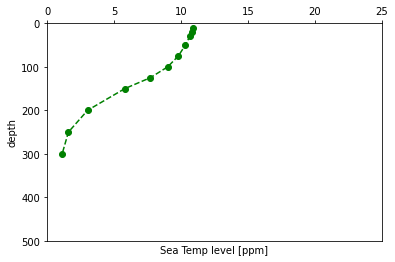

0


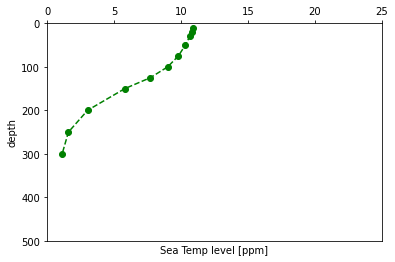

0


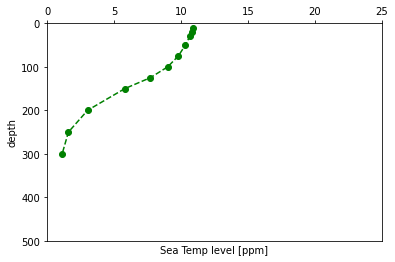

0


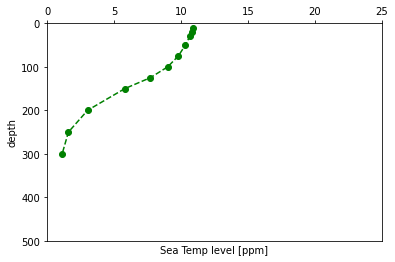

0


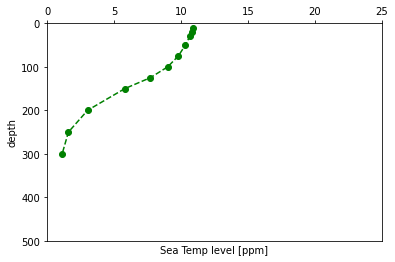

1


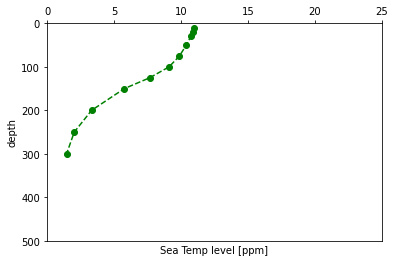

1


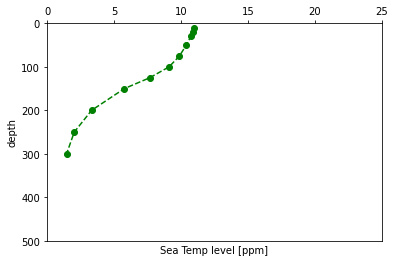

1


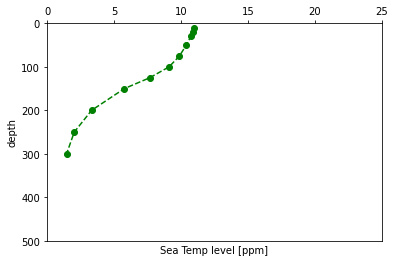

1


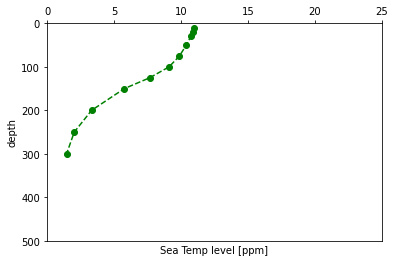

1


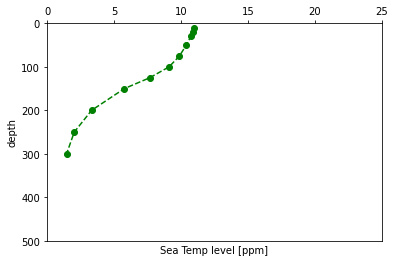

2


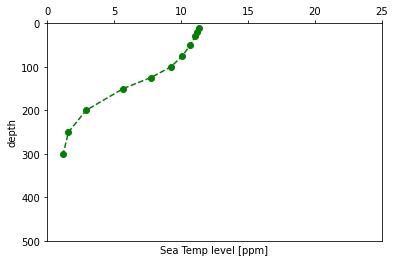

2


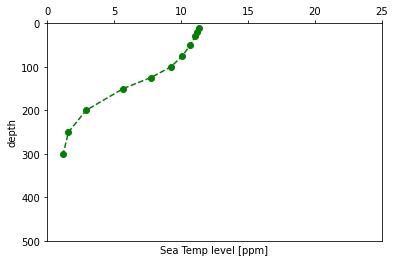

2


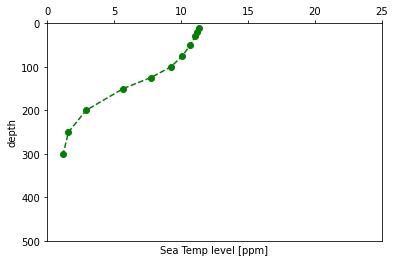

2


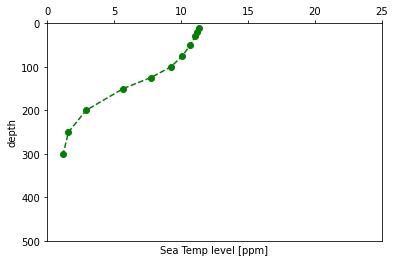

2


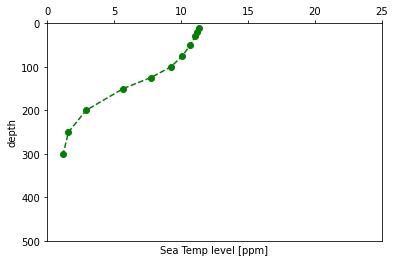

3


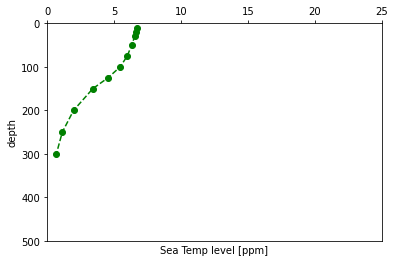

3


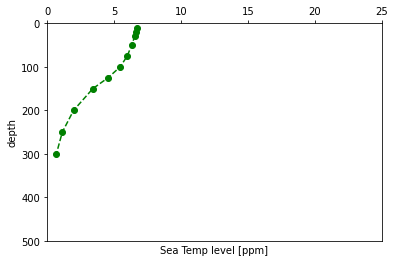

3


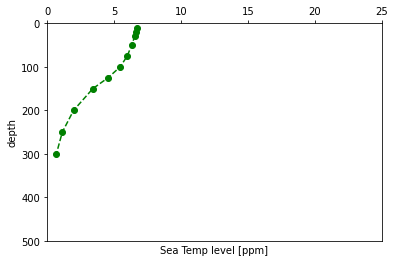

3


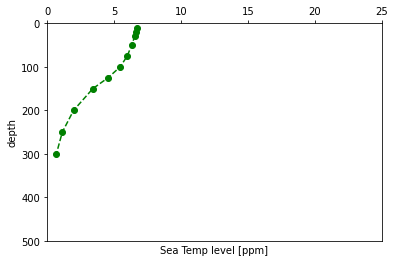

3


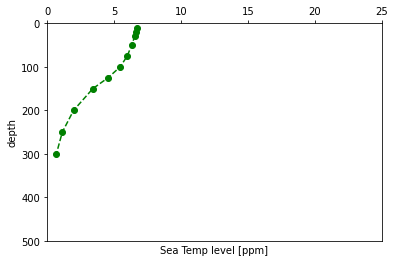

4


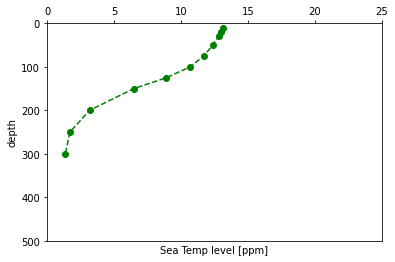

4


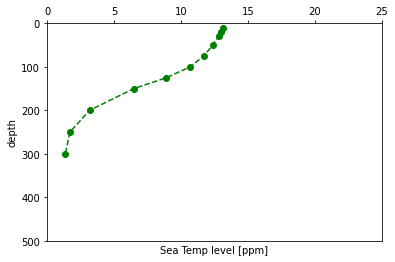

4


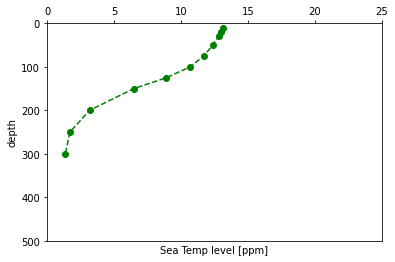

4


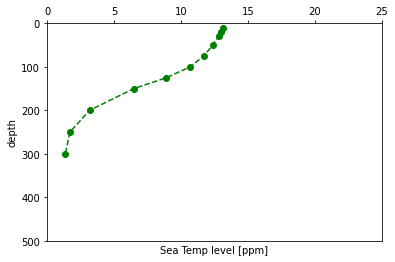

4


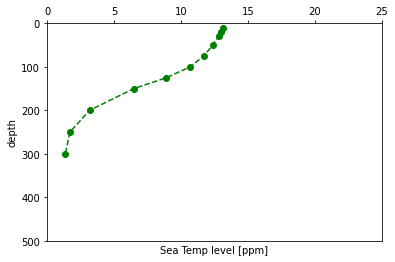

5


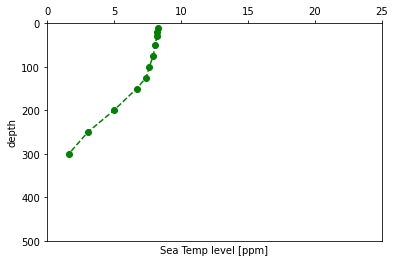

5


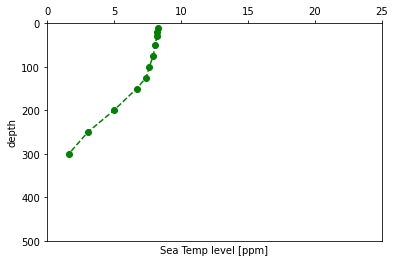

5


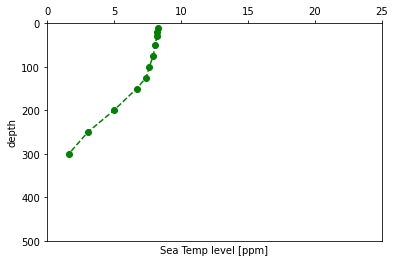

5


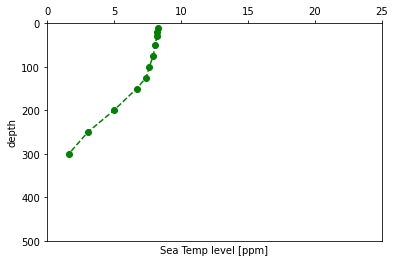

5


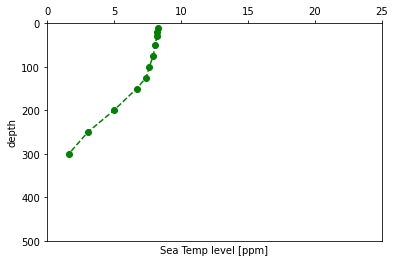

In [132]:
import matplotlib.pyplot as plt

# define data

#temp = [ 0.1 , 0.5, 1, 10, 15, 20, 15, 10, 1, 0.5, 0.5]

#thislist.extend(thistuple)

height_list=[0,1,2,3,4]
weight_list=[0,1,2]
list=[0,1,2,3,4,5]
for case in list:
    for height in height_list:
        for weight in weight_list:
            temp_list=[]
            for depth in depth_list:
                temp=globals()['predicted_value'+str(depth)][case,0,0,:]
                temp_list.append(temp)
        
    #print(temp_list)
        print(case)
        Depth  = [ 10,  20,  30,  50, 75, 100, 125, 150, 200, 250, 300 ]
        fig = plt.figure()
        ax = fig.add_subplot(111)
        ax.plot(temp_list, Depth, 'go--')
        ax.xaxis.tick_top()
        ax.set_ylabel('depth')
        ax.set_ylim(500, 0)
        ax.set_xlim(0, 25)
        ax.set_xlabel('Sea Temp level [ppm]')
        plt.show()

In [122]:
predicted_value300.shape

(11, 3, 5, 1)